In [2]:
import sys
import numpy as np
import pandas as pd
import csv
import matplotlib.pyplot as plt
import pylab as pl
from sklearn.linear_model import LinearRegression
%matplotlib inline

In [3]:
columns = ['ID','Date','Block','Primary Type','Location Description','Community Area','Year']

In [4]:
#nrows =1000
data = pd.read_csv('Crimes.csv', usecols=columns)

In [5]:
df = pd.DataFrame(data)

In [6]:
print(data)

               ID                    Date                 Block  \
0        11034701  01/01/2001 11:00:00 AM       016XX E 86TH PL   
1        11227287  10/08/2017 03:00:00 AM    092XX S RACINE AVE   
2        11227583  03/28/2017 02:00:00 PM       026XX W 79TH ST   
3        11227293  09/09/2017 08:17:00 PM  060XX S EBERHART AVE   
4        11227634  08/26/2017 10:00:00 AM   001XX W RANDOLPH ST   
...           ...                     ...                   ...   
7048304  11700926  05/26/2019 05:13:00 PM  036XX W DOUGLAS BLVD   
7048305     24560  05/26/2019 06:48:00 AM   013XX W HASTINGS ST   
7048306     24559  05/26/2019 02:11:00 AM   013XX W HASTINGS ST   
7048307  11707734  07/01/2014 07:30:00 AM   063XX S NORMAL BLVD   
7048308  11707239  11/30/2017 09:00:00 AM   022XX S KOSTNER AVE   

                Primary Type Location Description  Community Area  Year  
0         DECEPTIVE PRACTICE            RESIDENCE            45.0  2001  
1        CRIM SEXUAL ASSAULT            RESIDEN

In [7]:
type(data)

pandas.core.frame.DataFrame

In [8]:
greaterThan2014 = data[data['Year']>2014]

In [9]:
from2015to2018 = greaterThan2014[greaterThan2014['Year']<2019]

In [10]:
from2015to2018.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1069776 entries, 1 to 7048308
Data columns (total 7 columns):
 #   Column                Non-Null Count    Dtype  
---  ------                --------------    -----  
 0   ID                    1069776 non-null  int64  
 1   Date                  1069776 non-null  object 
 2   Block                 1069776 non-null  object 
 3   Primary Type          1069776 non-null  object 
 4   Location Description  1066027 non-null  object 
 5   Community Area        1069774 non-null  float64
 6   Year                  1069776 non-null  int64  
dtypes: float64(1), int64(2), object(4)
memory usage: 65.3+ MB


In [11]:
from2015to2018

,ID,Date,Block,Primary Type,Location Description,Community Area,Year
1,11227287,10/08/2017 03:00:00 AM,092XX S RACINE AVE,CRIM SEXUAL ASSAULT,RESIDENCE,73.0,2017
2,11227583,03/28/2017 02:00:00 PM,026XX W 79TH ST,BURGLARY,OTHER,70.0,2017
3,11227293,09/09/2017 08:17:00 PM,060XX S EBERHART AVE,THEFT,RESIDENCE,42.0,2017
4,11227634,08/26/2017 10:00:00 AM,001XX W RANDOLPH ST,CRIM SEXUAL ASSAULT,HOTEL/MOTEL,32.0,2017
6,11227503,01/01/2015 12:01:00 AM,061XX S KILBOURN AVE,OFFENSE INVOLVING CHILDREN,RESIDENCE,65.0,2015
...,...,...,...,...,...,...,...
7048299,9999996,03/17/2015 11:15:00 PM,011XX E 46TH ST,ROBBERY,APARTMENT,39.0,2015
7048300,9999997,03/18/2015 07:55:00 PM,032XX W HURON ST,BATTERY,RESIDENCE PORCH/HALLWAY,23.0,2015
7048301,9999998,03/18/2015 04:00:00 AM,036XX W BELMONT AVE,BATTERY,RESIDENCE,21.0,2015
7048302,9999999,03/18/2015 05:08:00 PM,043XX N CENTRAL AVE,ASSAULT,RESTAURANT,15.0,2015


In [12]:
type(from2015to2018['Date'])

pandas.core.series.Series

In [13]:
#from2015to2018['Date']

In [14]:
for a in from2015to2018['Date']:
    print(a[-11:])

03:00:00 AM
02:00:00 PM
08:17:00 PM
10:00:00 AM
12:01:00 AM
12:01:00 AM
10:10:00 AM
03:55:00 PM
12:00:00 PM
02:42:00 AM
03:40:00 PM
12:01:00 AM
12:01:00 AM
12:00:00 AM
12:00:00 AM
10:00:00 AM
01:00:00 AM
12:01:00 AM
12:01:00 AM
12:01:00 AM
12:01:00 AM
12:01:00 AM
12:01:00 AM
12:01:00 AM
07:00:00 PM
12:00:00 AM
09:00:00 AM
03:25:00 PM
07:00:00 AM
12:01:00 AM
09:00:00 AM
12:00:00 AM
11:00:00 PM
12:15:00 PM
04:21:00 PM
02:00:00 PM
08:00:00 AM
12:01:00 AM
03:18:00 PM
10:00:00 AM
12:01:00 AM
12:00:00 AM
11:00:00 AM
03:45:00 PM
04:00:00 AM
09:00:00 AM
12:00:00 AM
02:30:00 PM
07:45:00 PM
08:40:00 PM
12:01:00 AM
06:00:00 PM
03:00:00 PM
03:00:00 PM
12:00:00 PM
06:00:00 PM
12:00:00 AM
07:27:00 PM
12:00:00 AM
10:00:00 PM
09:00:00 AM
02:00:00 PM
03:00:00 PM
08:05:00 AM
12:00:00 PM
07:15:00 AM
09:00:00 AM
01:00:00 PM
07:16:00 PM
12:00:00 PM
02:25:00 PM
06:00:00 PM
12:00:00 PM
12:00:00 AM
06:00:00 AM
12:01:00 AM
12:00:00 AM
06:30:00 PM
06:00:00 AM
08:00:00 AM
12:30:00 PM
10:55:00 PM
01:40:00 PM
12:0

06:59:04 PM
07:50:00 PM
06:25:00 PM
10:10:57 PM
06:38:00 PM
02:22:00 PM
06:19:56 PM
12:01:00 AM
04:25:00 PM
01:00:00 AM
06:00:00 PM
10:00:00 AM
08:35:00 AM
10:30:00 PM
12:00:00 AM
02:30:00 PM
12:00:00 AM
05:30:00 PM
01:05:00 AM
09:00:00 PM
08:45:00 PM
07:15:00 AM
12:00:00 AM
01:10:00 AM
10:00:00 PM
10:25:00 AM
09:25:00 PM
09:30:00 PM
01:00:00 PM
11:25:00 AM
12:30:00 AM
01:30:00 PM
11:00:00 PM
07:15:00 PM
12:45:00 AM
12:00:00 PM
08:00:00 PM
07:30:00 PM
11:00:00 AM
07:30:00 AM
07:05:00 AM
02:00:00 PM
02:45:00 PM
09:00:00 AM
09:00:00 AM
06:45:00 PM
03:30:00 PM
11:35:00 PM
07:00:00 PM
12:01:00 AM
01:00:00 PM
12:01:00 AM
02:30:00 PM
11:00:00 AM
04:30:00 PM
03:10:00 PM
06:17:00 AM
12:00:00 AM
06:39:41 PM
11:30:00 AM
09:15:00 AM
12:00:00 PM
08:00:00 AM
09:00:00 AM
08:37:00 AM
04:28:00 AM
12:15:00 PM
08:00:00 PM
03:05:00 AM
05:05:00 PM
07:30:00 PM
12:30:00 AM
12:01:00 AM
11:00:00 AM
11:35:00 AM
01:40:00 PM
10:03:25 PM
12:00:00 PM
12:00:00 AM
10:39:00 AM
07:55:00 PM
11:09:00 AM
08:00:00 AM
04:3

08:35:00 AM
03:00:00 PM
12:00:00 PM
12:01:00 PM
10:00:00 AM
04:00:00 PM
12:00:00 AM
12:01:00 AM
05:00:00 PM
09:00:00 AM
08:00:00 AM
11:00:00 AM
12:00:00 PM
11:05:00 AM
12:01:00 AM
08:00:00 AM
09:00:00 AM
04:50:00 PM
05:05:00 PM
06:55:00 PM
12:00:00 PM
04:00:00 PM
02:15:00 PM
03:40:00 PM
05:00:00 PM
04:00:00 PM
12:00:00 PM
02:33:00 PM
02:00:00 PM
05:50:00 PM
06:40:00 PM
12:00:00 PM
12:05:00 PM
01:04:00 PM
12:20:00 PM
07:30:00 PM
12:00:00 AM
02:00:00 PM
06:01:00 AM
09:00:00 AM
07:25:00 PM
05:00:00 PM
02:35:00 PM
12:00:00 PM
02:00:00 PM
07:30:00 PM
01:00:00 PM
10:55:00 AM
04:42:11 PM
12:00:00 AM
09:22:00 AM
12:00:00 AM
06:58:00 PM
08:12:00 PM
05:56:00 PM
12:45:00 PM
12:10:00 AM
01:35:00 PM
03:30:00 PM
12:01:00 AM
12:00:00 AM
01:00:00 AM
06:30:00 PM
12:00:00 PM
01:00:00 AM
08:09:00 PM
08:00:00 AM
07:45:00 AM
02:00:00 AM
08:05:00 PM
03:00:00 PM
03:55:00 PM
01:00:00 AM
09:00:00 AM
09:00:00 AM
01:45:00 PM
10:15:00 AM
07:30:00 AM
12:00:00 PM
12:00:00 AM
07:27:00 PM
02:30:59 PM
01:38:00 PM
09:1

05:30:00 PM
12:01:00 AM
08:00:00 AM
10:55:00 AM
12:00:00 AM
06:00:00 AM
12:00:00 PM
03:12:00 PM
02:00:00 PM
09:00:00 PM
03:30:00 PM
08:30:00 AM
09:00:00 AM
01:00:00 AM
07:40:00 PM
09:00:00 AM
06:00:00 PM
08:54:00 PM
04:30:00 AM
08:00:00 AM
01:00:00 PM
04:26:00 PM
04:00:00 PM
06:30:00 PM
04:35:00 PM
06:30:00 AM
08:05:00 AM
10:00:00 AM
12:00:00 PM
12:01:00 AM
12:00:00 AM
06:00:00 PM
11:00:00 AM
07:00:00 PM
04:30:00 PM
06:00:00 AM
12:30:00 PM
10:35:00 AM
12:00:00 PM
03:00:00 PM
08:40:00 PM
03:50:00 PM
12:45:00 PM
12:00:00 AM
12:00:00 AM
05:40:00 PM
08:40:00 AM
09:00:00 AM
06:30:00 PM
02:00:00 PM
12:00:00 PM
02:15:00 PM
02:47:00 PM
12:00:00 AM
12:11:00 AM
12:00:00 AM
12:00:00 AM
09:20:00 AM
12:00:00 AM
02:00:00 AM
08:00:00 AM
12:01:00 AM
08:15:00 PM
09:00:00 AM
08:00:00 AM
12:00:00 PM
09:00:00 AM
10:00:00 AM
09:00:00 AM
07:15:00 AM
10:35:00 AM
04:45:00 PM
12:00:00 PM
08:00:00 AM
06:00:00 PM
07:35:00 PM
12:00:00 PM
09:00:00 AM
04:00:00 PM
05:00:00 PM
11:20:00 AM
08:00:00 PM
10:00:00 AM
11:2

08:40:00 PM
06:17:04 PM
07:05:00 PM
12:28:00 PM
06:00:00 AM
12:19:32 PM
12:22:58 PM
01:53:00 PM
08:15:00 PM
07:35:00 PM
09:23:00 AM
08:05:00 PM
10:00:00 AM
10:33:00 AM
06:00:00 AM
05:21:40 PM
07:05:00 PM
12:00:00 PM
07:01:00 PM
07:13:42 PM
06:00:00 AM
04:58:00 PM
06:20:00 PM
08:40:00 PM
02:45:00 PM
12:20:00 PM
06:00:00 AM
06:00:00 AM
06:00:00 AM
06:00:00 AM
02:40:00 PM
11:35:00 AM
03:45:00 PM
09:00:00 AM
10:45:00 AM
10:30:00 AM
06:00:00 AM
06:00:00 AM
05:59:00 PM
01:00:00 AM
05:45:00 PM
07:30:00 PM
11:00:00 AM
09:15:00 AM
12:11:00 PM
11:11:00 AM
03:10:00 PM
06:40:00 PM
08:12:00 PM
06:37:00 PM
11:16:00 AM
05:01:00 PM
11:25:00 AM
05:45:20 AM
06:31:00 PM
11:55:00 AM
02:29:00 PM
01:07:00 PM
04:30:51 PM
12:44:00 PM
11:40:00 AM
04:08:02 PM
07:30:00 PM
01:30:00 PM
11:49:00 AM
12:35:00 PM
06:00:00 AM
07:07:00 PM
04:10:13 PM
04:19:02 PM
04:51:00 PM
06:00:00 AM
06:42:00 PM
01:42:00 PM
04:18:16 PM
12:25:00 PM
12:23:03 PM
02:00:00 PM
11:59:00 AM
10:20:00 AM
03:35:00 PM
06:00:00 AM
08:20:00 PM
08:4

06:21:00 PM
09:00:00 AM
12:00:00 PM
06:00:00 PM
10:00:00 AM
10:45:00 PM
09:00:00 AM
12:01:00 AM
12:01:00 AM
04:00:00 PM
12:00:00 AM
12:00:00 AM
12:01:00 AM
12:00:00 PM
05:30:00 PM
01:15:00 PM
12:00:00 AM
12:01:00 AM
12:00:00 AM
03:00:00 PM
10:25:00 AM
09:00:00 AM
08:00:00 AM
07:00:00 AM
08:00:00 AM
02:28:00 PM
11:00:00 PM
09:00:00 AM
09:00:00 AM
08:00:00 AM
12:01:00 AM
07:00:00 PM
11:25:00 AM
10:00:00 AM
09:00:00 AM
07:00:00 PM
09:00:00 AM
09:00:00 AM
09:00:00 AM
08:00:00 AM
04:30:00 AM
07:30:00 PM
12:00:00 AM
12:00:00 PM
03:00:00 PM
03:41:00 PM
09:00:00 AM
12:01:00 AM
12:00:00 AM
12:00:00 PM
10:00:00 PM
10:00:00 AM
09:00:00 AM
12:00:00 AM
05:00:00 PM
09:00:00 AM
10:00:00 AM
04:00:00 PM
12:01:00 AM
06:00:00 PM
11:00:00 AM
04:30:00 PM
12:00:00 PM
12:01:00 AM
10:00:00 AM
04:00:00 AM
09:06:00 AM
10:43:00 AM
12:00:00 PM
07:00:00 PM
12:00:00 AM
12:00:00 AM
06:00:00 AM
09:00:00 AM
09:00:00 AM
08:00:00 AM
09:00:00 AM
08:00:00 AM
09:00:00 AM
12:01:00 AM
09:00:00 AM
10:00:00 AM
08:00:00 AM
12:0

01:00:00 AM
05:00:00 PM
03:30:00 PM
08:00:00 PM
01:30:00 AM
01:30:00 AM
09:00:00 PM
04:00:00 AM
09:30:00 AM
03:00:00 PM
09:30:00 PM
02:00:00 AM
10:40:00 AM
12:30:00 PM
09:00:00 AM
12:00:00 AM
08:00:00 PM
10:00:00 PM
06:45:00 PM
12:00:00 AM
12:00:00 AM
12:00:00 AM
12:00:00 AM
12:00:00 AM
12:00:00 AM
12:00:00 AM
10:00:00 AM
09:45:00 PM
10:20:00 AM
10:00:00 AM
06:30:00 PM
01:45:00 AM
03:10:00 PM
10:00:00 PM
09:30:00 PM
12:01:00 AM
03:45:00 AM
12:00:00 AM
07:30:00 PM
02:30:00 PM
08:00:00 PM
01:00:00 PM
10:54:00 AM
12:01:00 AM
12:01:00 AM
12:01:00 AM
01:00:00 AM
01:30:00 AM
09:35:00 AM
10:25:00 PM
05:45:00 PM
06:19:00 PM
09:00:00 AM
02:15:00 PM
12:00:00 PM
07:15:00 PM
02:15:00 AM
12:00:00 AM
10:00:00 AM
09:00:00 AM
08:30:00 PM
10:30:00 AM
12:01:00 AM
08:05:00 PM
12:50:00 PM
03:55:00 AM
05:00:00 PM
05:25:00 PM
10:00:00 AM
08:42:00 AM
06:00:00 PM
12:00:00 PM
08:06:00 PM
12:00:00 PM
11:00:00 PM
12:00:00 AM
12:01:00 AM
02:20:00 PM
07:50:00 PM
07:30:00 AM
09:30:00 PM
11:00:00 PM
03:10:00 PM
08:3

12:00:00 PM
06:00:00 AM
09:00:00 AM
10:00:00 AM
04:45:00 PM
12:00:00 AM
05:30:00 PM
12:01:00 AM
06:00:00 AM
09:00:00 PM
05:30:00 AM
04:06:00 PM
03:45:00 PM
11:25:00 AM
12:20:00 PM
09:00:00 PM
08:00:00 PM
12:01:00 AM
12:01:00 AM
11:30:00 AM
04:50:00 PM
05:00:00 PM
12:00:00 PM
08:30:00 PM
04:45:00 PM
12:00:00 PM
12:00:00 AM
11:20:00 AM
06:05:00 PM
12:00:00 AM
03:25:00 PM
12:00:00 AM
12:51:00 AM
12:00:00 AM
04:10:00 PM
12:01:00 AM
06:15:00 AM
12:00:00 PM
05:00:00 PM
01:00:00 PM
09:00:00 AM
12:00:00 AM
06:30:00 PM
02:00:00 PM
10:30:00 AM
12:10:00 AM
05:30:00 PM
06:00:00 AM
04:10:00 PM
12:00:00 PM
12:00:00 AM
04:32:00 PM
12:01:00 AM
08:47:00 PM
12:00:00 PM
09:00:00 AM
09:00:00 AM
06:00:00 AM
01:58:00 PM
04:30:00 PM
12:01:00 AM
04:58:00 PM
09:00:00 AM
01:00:00 AM
11:00:00 AM
11:20:00 PM
12:00:00 PM
08:00:00 AM
12:00:00 AM
03:00:00 PM
12:00:00 PM
11:00:00 PM
10:30:00 AM
11:40:00 AM
08:19:00 PM
02:00:00 PM
11:29:00 AM
08:41:00 PM
07:45:00 PM
01:45:00 AM
12:01:00 AM
08:00:00 AM
04:45:00 PM
09:0

10:36:00 PM
07:26:00 PM
04:55:00 PM
09:05:00 PM
01:02:00 AM
06:00:00 PM
01:05:00 PM
10:00:00 AM
08:40:00 AM
11:25:00 AM
03:00:00 PM
03:45:00 PM
09:00:00 AM
12:00:00 AM
04:50:00 PM
01:10:00 PM
10:00:00 PM
07:45:00 AM
10:55:00 PM
09:55:00 PM
10:00:00 AM
12:00:00 AM
12:00:00 PM
01:00:00 AM
10:00:00 AM
02:20:00 PM
01:00:00 AM
03:00:00 PM
09:00:00 AM
08:00:00 AM
08:50:00 AM
12:01:00 AM
12:00:00 AM
12:00:00 AM
12:00:00 AM
11:10:00 AM
07:25:00 PM
12:00:00 AM
02:15:00 PM
12:00:00 AM
10:30:00 PM
12:35:00 PM
04:00:00 PM
08:00:00 AM
12:00:00 AM
12:00:00 PM
08:00:00 AM
09:00:00 AM
11:15:00 PM
03:25:00 PM
12:00:00 PM
09:00:00 AM
12:00:00 AM
05:00:00 AM
03:28:00 PM
11:30:00 AM
02:30:00 AM
04:55:00 PM
12:01:00 AM
06:25:00 PM
11:09:00 AM
08:00:00 PM
10:43:00 AM
05:25:00 PM
10:25:00 AM
09:55:00 AM
01:40:00 PM
11:15:00 AM
10:00:00 AM
12:00:00 AM
09:00:00 AM
11:30:00 AM
11:05:00 AM
12:00:00 AM
11:00:00 AM
07:10:00 PM
11:30:00 AM
09:00:00 AM
08:00:00 AM
11:55:00 AM
12:00:00 AM
12:01:00 AM
12:00:00 AM
04:1

12:00:00 PM
10:00:00 AM
04:45:00 PM
08:00:00 AM
06:35:00 PM
11:36:00 AM
12:00:00 AM
12:00:00 AM
08:00:00 AM
10:00:00 AM
01:00:00 PM
01:36:00 PM
12:05:00 PM
02:00:00 PM
01:30:00 AM
02:00:00 PM
12:01:00 AM
12:00:00 PM
09:35:00 AM
11:50:00 AM
02:06:00 PM
09:01:00 AM
02:34:00 PM
11:55:00 AM
12:00:00 PM
10:00:00 AM
11:04:00 PM
09:24:00 AM
10:35:00 AM
10:00:00 AM
12:00:00 PM
06:23:00 PM
11:00:00 AM
12:00:00 PM
12:00:00 PM
10:00:00 AM
12:00:00 PM
01:55:00 PM
12:00:00 PM
06:00:00 PM
12:00:00 PM
12:51:00 PM
12:00:00 PM
08:00:00 AM
09:45:00 AM
01:38:00 PM
06:30:00 PM
11:25:00 AM
02:23:00 PM
03:27:30 PM
06:36:00 PM
08:01:00 AM
03:48:25 PM
10:45:00 AM
09:24:00 AM
12:00:00 AM
01:20:00 PM
09:00:00 AM
01:30:00 PM
08:00:00 AM
09:37:00 AM
11:59:00 AM
02:20:00 PM
10:05:00 AM
10:00:00 AM
10:26:00 AM
08:00:00 AM
09:00:00 AM
09:15:00 AM
12:00:00 AM
08:00:00 AM
09:00:00 AM
12:00:00 AM
09:00:00 AM
09:00:00 AM
09:00:00 AM
12:00:00 AM
08:00:00 AM
08:00:00 AM
12:00:00 PM
02:01:00 PM
12:00:00 PM
06:00:00 PM
05:2

12:01:00 AM
12:01:00 AM
12:01:00 AM
09:00:00 AM
12:01:00 AM
07:00:00 AM
12:01:00 AM
12:00:00 AM
05:24:00 PM
12:00:00 AM
12:00:00 AM
12:01:00 AM
09:00:00 PM
12:00:00 AM
12:00:00 AM
11:00:00 PM
03:29:00 PM
05:20:00 AM
11:00:00 PM
06:30:00 AM
03:50:00 PM
03:20:00 AM
04:45:00 PM
08:13:00 AM
02:15:00 PM
07:14:00 PM
12:00:00 AM
09:50:00 AM
07:40:00 AM
08:37:00 PM
12:01:00 AM
09:00:00 AM
12:01:00 AM
01:45:00 PM
03:55:00 PM
09:00:00 AM
08:45:00 AM
04:35:00 PM
10:06:00 AM
02:00:00 AM
04:00:00 PM
12:00:00 AM
11:05:00 AM
02:00:00 PM
02:00:00 PM
09:00:00 AM
03:34:00 PM
03:23:00 PM
06:14:00 PM
04:00:00 PM
07:00:00 PM
12:15:00 AM
11:50:00 AM
09:40:00 AM
03:45:00 PM
04:59:00 PM
01:30:00 AM
10:00:00 PM
01:46:00 PM
08:00:00 AM
11:51:00 AM
12:01:00 AM
09:00:00 AM
07:00:00 AM
06:50:00 PM
10:45:00 AM
12:00:00 PM
02:10:00 PM
10:35:00 AM
09:00:00 AM
12:00:00 AM
05:00:00 PM
05:13:00 PM
01:50:00 AM
10:45:00 PM
07:41:00 PM
04:30:00 PM
10:00:00 PM
06:40:00 AM
10:00:00 PM
01:02:00 AM
09:50:00 AM
12:30:00 AM
12:4

10:55:00 AM
02:30:00 AM
04:39:00 AM
10:00:00 PM
12:00:00 PM
10:00:00 PM
12:00:00 PM
11:10:00 AM
04:05:00 AM
09:00:00 AM
11:47:00 AM
12:00:00 PM
03:01:00 AM
12:00:00 AM
03:30:00 PM
03:00:00 PM
10:00:00 AM
12:01:00 AM
11:14:00 AM
10:05:00 AM
12:01:00 AM
12:00:00 AM
12:30:00 PM
12:00:00 PM
12:00:00 PM
10:50:00 PM
12:00:00 AM
02:00:00 AM
09:23:00 PM
08:03:00 PM
12:01:00 AM
11:15:00 AM
12:00:00 AM
11:07:00 AM
03:38:00 PM
03:05:00 AM
10:35:00 PM
10:42:00 AM
05:50:00 AM
12:00:00 AM
09:40:00 PM
07:30:00 PM
02:50:00 AM
08:45:00 PM
03:35:00 PM
12:00:00 AM
01:39:00 PM
12:00:00 AM
12:00:00 AM
08:02:55 PM
12:01:00 AM
12:01:00 AM
12:01:00 AM
11:30:00 AM
08:00:00 AM
03:55:00 PM
09:00:00 AM
12:00:00 AM
08:00:00 AM
08:00:00 AM
05:40:00 PM
11:15:00 PM
01:15:00 PM
06:07:00 PM
12:01:00 AM
10:22:00 AM
02:08:00 PM
02:00:00 AM
12:00:00 AM
05:21:00 AM
12:00:00 PM
12:00:00 PM
01:35:00 PM
02:00:00 PM
11:45:00 AM
06:00:00 PM
06:22:46 PM
11:23:00 AM
12:00:00 AM
10:00:00 AM
07:59:57 AM
05:53:00 PM
08:00:00 AM
02:0

02:40:00 PM
09:41:00 PM
09:30:00 AM
05:55:00 PM
12:00:00 PM
01:06:00 PM
07:24:00 PM
02:50:00 PM
10:00:00 PM
03:56:00 PM
09:00:00 AM
02:00:00 PM
10:05:00 AM
03:00:00 AM
08:00:00 AM
12:00:00 PM
08:00:00 PM
12:25:00 AM
10:08:00 AM
03:25:00 AM
08:22:00 PM
04:32:00 AM
02:12:00 AM
09:00:00 AM
12:15:00 PM
03:00:00 PM
07:20:00 PM
09:00:00 PM
08:55:00 PM
12:00:00 PM
09:30:00 PM
11:00:00 AM
09:00:00 AM
12:01:00 AM
08:30:00 PM
06:05:00 PM
01:35:00 AM
08:00:00 AM
12:00:00 PM
09:00:00 AM
09:00:00 AM
02:50:00 PM
12:00:00 AM
07:35:00 PM
01:30:00 PM
12:49:00 AM
10:00:00 PM
12:33:00 PM
06:27:00 PM
10:00:00 PM
12:00:00 AM
12:00:00 AM
10:40:00 AM
08:00:00 AM
04:30:00 PM
02:00:00 PM
10:30:00 AM
10:30:00 PM
03:15:00 AM
02:00:00 AM
11:46:00 AM
10:00:00 PM
02:08:00 PM
08:21:00 PM
12:00:00 AM
02:57:00 AM
12:00:00 AM
12:01:00 AM
05:41:00 PM
12:00:00 AM
01:40:00 PM
12:00:00 AM
09:46:00 AM
05:15:00 PM
12:45:00 AM
07:30:00 PM
12:00:00 AM
03:04:00 AM
04:25:00 PM
07:00:00 AM
12:00:00 AM
12:01:00 AM
10:00:00 AM
06:0

02:00:00 AM
07:00:00 PM
08:00:00 AM
08:00:00 PM
10:30:00 AM
12:47:00 PM
05:50:00 PM
12:03:00 AM
04:00:00 AM
11:52:00 AM
01:45:00 PM
11:30:00 PM
07:40:00 AM
07:15:00 PM
02:25:00 PM
11:40:00 AM
05:55:00 AM
10:00:00 PM
06:00:00 PM
05:11:00 AM
06:55:00 AM
01:45:00 PM
01:00:00 PM
01:50:00 AM
02:30:00 PM
01:00:00 PM
11:00:00 AM
12:05:00 PM
01:45:00 PM
08:00:00 AM
10:00:00 AM
12:00:00 PM
09:45:00 AM
03:30:00 PM
08:15:00 PM
01:25:00 AM
02:00:00 PM
05:45:00 PM
08:22:00 AM
10:00:00 AM
06:40:00 PM
09:45:00 PM
05:24:00 PM
12:53:00 AM
11:45:00 AM
05:33:00 PM
11:20:00 AM
05:00:00 PM
07:00:00 PM
04:19:00 PM
06:50:00 PM
12:11:00 AM
01:30:00 PM
07:30:00 PM
09:00:00 AM
07:00:00 PM
06:15:00 PM
09:00:00 AM
12:20:00 PM
08:30:00 PM
12:00:00 AM
10:34:00 PM
10:00:00 AM
05:00:00 AM
02:30:00 AM
02:06:00 PM
10:00:00 PM
02:19:00 AM
08:15:00 AM
06:30:00 PM
09:00:00 PM
07:00:00 PM
02:39:00 PM
11:09:00 PM
03:15:00 AM
03:55:00 PM
03:00:00 PM
06:00:00 PM
02:10:00 PM
08:00:00 PM
08:00:00 PM
05:00:00 PM
07:30:00 PM
09:0

08:30:00 PM
03:45:00 PM
01:00:00 PM
10:00:00 AM
05:45:00 PM
03:45:00 PM
04:55:00 PM
06:00:00 PM
06:30:00 PM
02:50:00 PM
04:20:00 PM
05:00:00 AM
12:00:00 PM
04:45:00 PM
04:29:00 PM
12:00:00 PM
08:00:00 PM
05:22:00 PM
06:05:00 PM
06:00:00 PM
03:55:00 PM
04:27:00 PM
05:00:00 PM
06:10:00 PM
06:00:00 PM
05:30:00 PM
05:42:00 PM
05:15:00 PM
09:00:00 AM
03:51:00 PM
05:49:00 PM
02:22:00 PM
04:30:00 PM
04:30:00 PM
03:00:00 PM
04:00:00 PM
05:12:00 PM
05:25:00 PM
07:15:00 PM
01:30:00 PM
08:30:00 AM
11:30:00 PM
06:40:00 PM
06:00:00 AM
07:10:00 PM
07:00:00 PM
05:30:00 PM
06:00:00 AM
03:39:00 PM
06:00:00 PM
06:00:00 AM
01:00:00 PM
06:10:00 PM
05:40:00 PM
12:00:00 AM
02:15:00 PM
07:25:00 PM
05:30:00 PM
06:00:00 PM
05:28:00 PM
12:00:00 PM
06:30:00 PM
08:48:00 PM
05:35:00 PM
06:59:00 PM
04:43:00 PM
08:00:00 AM
02:00:00 PM
06:55:00 PM
06:30:00 PM
06:05:00 PM
03:19:00 PM
06:00:00 PM
06:12:00 PM
07:25:00 PM
06:00:00 AM
01:30:00 PM
07:00:00 AM
02:45:00 PM
02:30:00 PM
06:00:00 PM
12:00:00 PM
01:00:00 PM
07:1

06:45:00 PM
07:30:00 PM
08:15:00 PM
07:10:00 PM
12:00:00 AM
08:47:00 PM
06:25:00 PM
07:20:00 PM
09:00:00 AM
04:40:00 PM
08:32:00 PM
05:00:00 PM
02:50:00 PM
07:47:00 PM
08:25:00 PM
06:20:00 PM
08:30:00 PM
07:53:00 PM
06:00:00 PM
07:45:00 PM
07:30:00 PM
07:15:00 PM
07:52:00 PM
08:00:00 PM
01:42:00 PM
07:55:00 PM
09:07:00 PM
09:02:00 PM
07:02:00 PM
08:44:00 PM
02:00:00 PM
09:20:00 PM
09:10:00 PM
08:48:00 PM
09:00:00 PM
09:00:00 PM
06:45:00 PM
08:29:00 PM
09:30:00 PM
08:15:00 PM
04:00:00 AM
07:10:00 PM
03:00:00 PM
02:40:00 PM
09:15:00 PM
08:45:00 PM
08:52:00 PM
08:39:00 PM
09:00:00 PM
10:20:00 AM
01:23:00 PM
09:35:00 PM
09:40:00 PM
12:00:00 AM
08:02:00 PM
08:00:00 PM
09:55:00 PM
08:50:00 PM
09:15:00 PM
10:15:00 PM
09:52:00 PM
08:00:00 PM
12:00:00 PM
07:45:00 PM
10:25:00 PM
10:15:00 PM
09:10:00 PM
10:09:00 PM
10:07:00 PM
02:06:00 AM
09:45:00 PM
09:50:00 PM
07:45:00 PM
09:20:00 PM
11:20:00 PM
09:40:00 PM
10:12:00 PM
09:44:00 PM
10:38:00 PM
10:44:00 PM
07:00:00 PM
10:33:00 PM
11:10:00 PM
10:0

09:40:00 PM
10:36:00 PM
07:04:00 PM
07:30:00 PM
07:40:00 PM
10:50:00 PM
11:00:00 PM
02:55:00 PM
09:47:00 PM
10:55:00 PM
09:17:00 PM
09:45:00 PM
08:08:00 PM
09:00:00 PM
04:41:00 PM
10:05:00 PM
08:20:00 PM
01:00:00 AM
09:00:00 PM
12:00:00 PM
12:00:00 PM
06:36:00 PM
09:21:00 PM
12:00:00 PM
10:15:00 PM
09:45:00 PM
02:35:00 PM
09:45:00 PM
08:15:00 PM
10:00:00 PM
09:44:00 PM
04:40:00 PM
11:45:00 PM
10:20:00 PM
11:10:00 PM
11:47:00 PM
10:50:00 PM
12:01:00 AM
10:15:00 PM
11:55:00 PM
11:12:00 PM
10:55:00 PM
11:00:00 AM
10:34:00 PM
11:11:00 PM
11:20:00 AM
10:30:00 PM
11:07:00 PM
12:00:00 AM
12:50:00 AM
10:48:00 PM
12:02:00 AM
11:35:00 PM
12:26:00 AM
08:05:00 PM
10:00:00 PM
12:15:00 AM
09:00:00 PM
11:30:00 PM
05:00:00 PM
01:16:00 AM
11:30:00 PM
06:53:00 PM
12:45:00 AM
12:10:00 AM
12:08:00 AM
05:45:00 AM
09:20:00 PM
01:35:00 AM
06:30:00 PM
12:30:00 AM
01:37:00 AM
09:53:00 PM
02:10:00 AM
02:19:00 AM
11:00:00 AM
03:40:00 AM
10:30:00 AM
11:00:00 PM
11:00:00 PM
01:33:00 AM
12:27:00 AM
12:30:00 AM
03:1

10:00:00 PM
10:15:00 PM
03:25:00 PM
09:57:00 PM
10:06:00 PM
10:27:00 PM
09:30:00 PM
04:57:00 PM
08:40:00 PM
09:42:00 PM
07:00:00 AM
09:15:00 PM
09:00:00 PM
10:10:00 PM
10:06:00 AM
08:00:00 PM
10:09:00 PM
09:15:00 PM
08:35:00 PM
06:13:00 PM
12:00:00 PM
10:27:00 PM
12:01:00 AM
09:50:00 PM
10:40:00 PM
10:45:00 PM
05:00:00 AM
03:50:00 PM
09:00:00 PM
11:00:00 PM
10:29:00 PM
11:00:00 PM
08:15:00 PM
10:08:00 PM
09:45:00 PM
11:19:00 PM
09:43:00 PM
10:56:00 PM
08:56:00 PM
09:30:00 PM
08:42:00 PM
09:08:00 PM
09:13:00 PM
10:00:00 AM
08:00:00 PM
12:01:00 AM
12:00:00 PM
05:15:00 PM
09:30:00 PM
11:22:00 PM
10:00:00 PM
09:00:00 PM
11:19:00 PM
10:37:00 PM
09:01:00 PM
10:25:00 PM
11:15:00 PM
10:20:00 PM
10:33:00 PM
12:30:00 AM
12:06:00 AM
10:40:00 PM
11:40:00 PM
11:22:00 PM
07:00:00 AM
10:50:00 PM
01:15:00 AM
10:10:00 PM
12:05:00 AM
11:26:00 PM
10:59:00 PM
11:48:00 PM
05:30:00 PM
10:51:00 PM
12:10:00 AM
09:39:00 PM
11:00:00 PM
12:30:00 AM
11:30:00 PM
01:45:00 AM
01:17:00 AM
01:19:00 AM
12:58:00 AM
09:4

07:00:00 AM
03:00:00 PM
10:00:00 AM
05:15:00 PM
09:40:00 PM
06:00:00 PM
12:50:00 PM
10:20:00 AM
09:00:00 AM
12:35:00 PM
02:00:00 AM
12:20:00 PM
11:30:00 AM
09:00:00 AM
12:55:00 PM
01:13:00 PM
08:30:00 AM
01:00:00 PM
01:35:00 PM
10:37:00 AM
01:20:00 PM
01:35:00 PM
03:30:00 PM
01:30:00 PM
01:15:00 PM
12:15:00 PM
09:40:00 AM
11:45:00 AM
11:30:00 AM
02:00:00 PM
08:53:00 PM
08:15:00 PM
11:40:00 AM
08:00:00 PM
01:24:00 PM
11:45:00 AM
12:45:00 PM
11:45:00 AM
04:00:00 PM
06:00:00 AM
10:00:00 PM
01:55:00 PM
01:20:00 PM
12:00:00 PM
02:30:00 PM
10:33:00 AM
01:03:00 PM
02:24:00 PM
02:00:00 PM
03:00:00 PM
07:30:00 AM
02:00:00 PM
02:10:00 PM
02:00:00 PM
10:50:00 AM
03:45:00 PM
01:35:00 PM
09:00:00 PM
01:15:00 PM
01:30:00 PM
10:34:00 AM
02:40:00 PM
12:00:00 PM
12:45:00 PM
05:30:00 PM
09:00:00 AM
05:00:00 PM
11:23:00 PM
09:35:00 PM
01:25:00 PM
02:00:00 PM
01:10:00 PM
01:25:00 PM
11:10:00 AM
01:00:00 PM
06:22:00 AM
09:00:00 AM
09:40:00 AM
10:00:00 AM
09:45:00 PM
07:32:00 AM
02:22:00 PM
09:00:00 AM
04:3

12:01:00 AM
04:00:00 AM
04:40:00 AM
04:30:00 AM
01:30:00 AM
04:20:00 AM
12:20:00 AM
04:00:00 AM
02:28:00 AM
03:00:00 AM
04:15:00 AM
03:25:00 AM
12:01:00 AM
05:14:00 AM
05:42:00 PM
05:00:00 PM
04:30:00 AM
05:15:00 AM
09:50:00 PM
09:00:00 PM
04:40:00 AM
04:40:00 AM
04:00:00 AM
06:00:00 AM
05:21:00 AM
04:40:00 AM
05:00:00 AM
04:58:00 AM
02:45:00 AM
05:25:00 AM
12:14:00 AM
01:00:00 AM
03:20:00 AM
07:30:00 AM
08:09:00 PM
03:30:00 AM
09:00:00 PM
12:30:00 PM
01:00:00 AM
08:45:00 AM
08:55:00 PM
05:00:00 PM
07:05:00 AM
06:00:00 PM
08:15:00 AM
04:30:00 AM
03:00:00 PM
08:10:00 AM
04:00:00 AM
12:15:00 PM
10:12:00 AM
09:17:00 AM
12:00:00 AM
11:00:00 PM
04:00:00 AM
11:00:00 PM
10:30:00 PM
07:34:00 AM
09:30:00 PM
02:00:00 AM
03:00:00 PM
04:00:00 AM
08:00:00 PM
08:00:00 AM
01:30:00 AM
03:43:00 AM
03:00:00 AM
10:45:00 AM
04:30:00 PM
10:00:00 PM
06:30:00 AM
03:00:00 PM
06:10:00 AM
09:00:00 AM
05:00:00 PM
09:30:00 PM
12:10:00 AM
11:00:00 PM
10:03:00 AM
10:10:00 AM
01:40:00 AM
10:15:00 AM
09:45:00 AM
04:0

12:30:00 PM
06:44:00 PM
07:00:00 PM
08:20:00 PM
08:10:00 PM
07:45:00 PM
08:55:00 PM
08:20:00 PM
08:30:00 PM
08:10:00 PM
07:30:00 PM
07:10:00 PM
12:30:00 PM
07:53:00 PM
09:10:00 PM
07:49:00 PM
11:00:00 PM
10:00:00 PM
08:50:00 PM
06:00:00 PM
08:15:00 PM
09:00:00 PM
08:45:00 PM
08:15:00 PM
08:18:00 PM
07:30:00 PM
08:48:00 PM
08:00:00 AM
09:30:00 AM
03:00:00 AM
06:01:00 PM
12:00:00 PM
10:30:00 AM
07:30:00 PM
08:50:00 PM
07:30:00 AM
08:30:00 PM
08:05:00 PM
09:10:00 PM
06:19:00 PM
04:30:00 PM
09:45:00 PM
05:00:00 PM
02:00:00 PM
08:30:00 PM
07:30:00 PM
03:00:00 PM
06:50:00 PM
08:55:00 PM
07:30:00 PM
09:11:00 PM
09:20:00 PM
07:45:00 PM
06:00:00 PM
09:46:00 PM
09:45:00 PM
09:10:00 PM
09:45:00 PM
08:40:00 PM
05:00:00 PM
06:32:00 PM
02:19:00 PM
03:30:00 PM
09:48:00 PM
07:55:00 PM
10:05:00 PM
09:23:00 PM
08:45:00 PM
05:50:00 PM
10:55:00 PM
09:44:00 PM
08:04:00 PM
10:06:00 PM
06:30:00 PM
10:00:00 PM
08:00:00 PM
09:10:00 PM
06:30:00 PM
10:50:00 PM
06:33:00 PM
11:18:00 PM
09:42:00 PM
03:45:00 PM
09:3

03:05:00 PM
01:15:00 PM
03:10:00 PM
04:29:00 PM
10:00:00 AM
12:00:00 PM
08:00:00 PM
02:45:00 PM
03:30:00 PM
12:44:00 PM
03:40:00 PM
12:00:00 AM
03:45:00 PM
10:00:00 PM
03:30:00 PM
02:00:00 PM
02:19:00 PM
01:00:00 PM
02:00:00 PM
08:19:00 PM
08:19:00 AM
03:31:00 PM
06:44:00 PM
01:55:00 PM
03:07:00 PM
02:59:00 PM
02:30:00 PM
02:08:00 PM
03:15:00 PM
03:00:00 PM
02:00:00 PM
12:00:00 PM
04:00:00 AM
03:42:00 PM
01:49:00 PM
09:00:00 PM
02:00:00 PM
03:15:00 PM
04:20:00 PM
06:30:00 AM
08:00:00 AM
01:15:00 PM
04:35:00 PM
04:10:00 PM
01:15:00 PM
02:19:00 PM
03:10:00 PM
02:00:00 PM
07:00:00 PM
12:45:00 PM
03:50:00 PM
12:30:00 AM
07:45:00 PM
03:30:00 PM
04:15:00 PM
12:00:00 PM
02:30:00 PM
10:00:00 AM
05:00:00 PM
09:00:00 AM
09:30:00 PM
04:30:00 PM
08:00:00 AM
04:30:00 PM
08:00:00 AM
12:00:00 PM
09:00:00 PM
10:30:00 AM
06:00:00 AM
03:05:00 PM
05:15:00 PM
04:39:00 PM
04:00:00 PM
07:00:00 PM
03:41:00 PM
04:13:00 PM
04:50:00 PM
04:20:00 PM
02:19:00 AM
12:00:00 AM
07:45:00 AM
05:28:00 PM
04:31:00 PM
09:3

01:00:00 AM
02:00:00 AM
10:30:00 PM
08:00:00 PM
12:01:00 AM
04:50:00 AM
03:00:00 AM
05:30:00 AM
05:16:00 AM
08:53:00 PM
04:10:00 AM
06:15:00 AM
03:50:00 AM
03:00:00 AM
03:20:00 AM
04:45:00 AM
04:40:00 AM
12:07:00 AM
06:40:00 AM
01:00:00 AM
05:22:00 AM
12:01:00 AM
06:45:00 AM
11:20:00 AM
07:50:00 AM
03:00:00 AM
05:30:00 AM
01:00:00 AM
09:50:00 AM
07:30:00 AM
12:40:00 AM
02:00:00 PM
08:00:00 AM
11:00:00 AM
08:31:00 AM
09:56:00 PM
08:00:00 AM
07:20:00 AM
02:00:00 AM
03:00:00 AM
08:55:00 AM
01:00:00 AM
07:15:00 AM
11:30:00 PM
08:50:00 AM
09:00:00 PM
08:30:00 AM
08:34:00 AM
09:00:00 PM
10:00:00 AM
12:00:00 PM
12:00:00 PM
10:30:00 AM
08:30:00 AM
10:45:00 PM
10:00:00 PM
08:30:00 PM
09:50:00 AM
05:57:00 AM
06:00:00 PM
10:00:00 PM
12:01:00 AM
10:00:00 AM
10:00:00 PM
09:00:00 AM
09:00:00 AM
08:30:00 AM
06:00:00 AM
05:00:00 AM
10:00:00 AM
06:10:00 AM
02:00:00 AM
12:01:00 AM
09:00:00 AM
09:00:00 PM
08:30:00 PM
08:00:00 AM
06:40:00 AM
07:55:00 AM
08:45:00 PM
08:30:00 PM
01:46:00 AM
01:05:00 AM
03:0

12:08:00 PM
01:15:00 PM
03:00:00 PM
03:00:00 PM
12:15:00 PM
01:40:00 PM
02:15:00 PM
01:49:00 PM
07:15:00 AM
09:00:00 AM
01:08:00 PM
05:54:00 PM
07:00:00 AM
10:00:00 PM
01:59:00 PM
01:40:00 PM
12:00:00 AM
01:30:00 PM
11:00:00 AM
09:00:00 AM
07:00:00 PM
08:00:00 AM
01:15:00 PM
01:25:00 PM
01:25:00 PM
01:00:00 PM
01:45:00 PM
03:00:00 PM
11:30:00 AM
01:40:00 PM
02:00:00 PM
02:15:00 PM
02:30:00 PM
02:05:00 PM
12:00:00 PM
01:30:00 PM
11:30:00 AM
01:10:00 PM
05:00:00 PM
02:00:00 PM
02:20:00 PM
02:11:00 PM
12:49:00 PM
05:00:00 PM
12:55:00 PM
08:00:00 AM
03:30:00 PM
01:14:00 PM
02:50:00 PM
12:00:00 PM
10:00:00 AM
01:00:00 PM
03:00:00 PM
09:00:00 AM
01:45:00 PM
08:00:00 AM
01:00:00 PM
11:50:00 AM
02:05:00 PM
04:30:00 AM
01:00:00 PM
03:00:00 AM
03:27:00 PM
03:05:00 PM
02:00:00 PM
11:32:00 AM
02:00:00 PM
03:30:00 PM
04:20:00 PM
04:30:00 PM
12:30:00 PM
04:45:00 PM
08:00:00 AM
12:00:00 PM
12:01:00 AM
03:13:00 PM
03:30:00 PM
04:00:00 PM
04:18:00 PM
08:00:00 AM
10:00:00 PM
03:30:00 PM
03:00:00 PM
03:2

01:30:00 PM
09:00:00 PM
07:15:00 AM
04:30:00 PM
05:30:00 AM
04:00:00 AM
10:30:00 PM
12:20:00 PM
06:26:00 AM
05:20:00 AM
01:45:00 PM
11:59:00 AM
09:25:00 AM
01:00:00 PM
01:10:00 PM
02:15:00 AM
08:30:00 PM
10:07:00 AM
10:00:00 PM
10:15:00 AM
11:00:00 PM
02:35:00 AM
09:10:00 AM
11:00:00 AM
12:00:00 PM
10:00:00 AM
07:35:00 AM
08:45:00 AM
12:40:00 AM
07:20:00 AM
08:00:00 AM
08:30:00 AM
10:00:00 AM
09:20:00 AM
09:45:00 AM
05:00:00 PM
08:40:00 AM
11:20:00 PM
10:20:00 AM
02:00:00 PM
09:00:00 AM
10:55:00 AM
02:00:00 AM
09:38:00 PM
05:00:00 PM
10:30:00 AM
07:30:00 PM
05:00:00 PM
11:30:00 PM
12:01:00 AM
07:30:00 PM
10:00:00 AM
09:55:00 AM
10:30:00 AM
06:00:00 PM
04:34:00 AM
09:56:00 PM
12:00:00 PM
10:00:00 PM
11:30:00 PM
12:05:00 AM
07:00:00 PM
01:00:00 PM
11:14:00 AM
07:00:00 PM
10:30:00 AM
02:00:00 PM
10:00:00 AM
06:00:00 PM
12:01:00 AM
10:08:00 AM
10:00:00 AM
02:00:00 PM
06:00:00 PM
10:00:00 PM
11:40:00 PM
10:00:00 AM
02:00:00 PM
08:00:00 AM
11:00:00 PM
05:10:00 PM
07:00:00 AM
02:00:00 PM
11:0

09:00:00 PM
08:00:00 AM
10:00:00 PM
03:30:00 PM
11:55:00 PM
10:00:00 AM
10:00:00 PM
01:30:00 AM
08:00:00 PM
03:00:00 AM
05:00:00 AM
08:50:00 AM
09:45:00 AM
01:00:00 AM
07:00:00 PM
06:00:00 PM
12:00:00 PM
12:30:00 AM
09:00:00 AM
10:00:00 AM
03:30:00 PM
11:00:00 PM
01:45:00 AM
06:30:00 AM
09:19:00 AM
05:00:00 PM
06:50:00 AM
10:00:00 PM
10:55:00 AM
10:30:00 AM
12:01:00 AM
02:00:00 AM
02:00:00 AM
10:30:00 AM
02:00:00 AM
10:55:00 AM
06:50:00 AM
09:15:00 AM
08:00:00 AM
10:40:00 AM
10:45:00 AM
09:30:00 AM
11:17:00 AM
08:00:00 AM
03:00:00 PM
10:30:00 AM
10:30:00 AM
03:00:00 AM
08:20:00 AM
11:00:00 AM
03:35:00 PM
03:40:00 AM
01:00:00 AM
07:05:00 AM
03:00:00 PM
10:00:00 PM
01:00:00 PM
09:36:00 AM
06:00:00 AM
10:05:00 AM
01:47:00 PM
09:45:00 AM
03:00:00 AM
10:20:00 AM
10:25:00 AM
11:20:00 AM
08:40:00 AM
10:55:00 AM
10:50:00 AM
09:35:00 AM
10:20:00 AM
10:30:00 AM
12:30:00 AM
09:00:00 PM
12:00:00 PM
11:09:00 AM
02:30:00 PM
12:00:00 PM
08:48:00 AM
10:23:00 AM
10:53:00 AM
11:00:00 AM
11:30:00 AM
11:1

05:00:00 PM
06:56:00 PM
06:40:00 PM
08:00:00 PM
06:13:00 PM
03:00:00 PM
04:30:00 PM
07:35:00 PM
05:30:00 PM
08:00:00 AM
06:38:00 PM
07:30:00 PM
08:03:00 PM
08:00:00 AM
07:07:00 PM
08:50:00 PM
07:27:00 PM
08:30:00 PM
08:50:00 PM
05:34:00 PM
07:00:00 PM
07:00:00 AM
09:00:00 AM
06:40:00 PM
05:00:00 PM
08:35:00 PM
08:15:00 PM
11:00:00 AM
07:00:00 PM
08:21:00 PM
05:25:00 PM
07:25:00 PM
12:00:00 AM
08:45:00 PM
06:20:00 PM
08:45:00 PM
07:45:00 PM
08:15:00 PM
07:16:00 PM
05:15:00 PM
08:45:00 PM
08:16:00 PM
06:45:00 PM
07:30:00 PM
06:20:00 PM
07:34:00 PM
08:40:00 PM
08:55:00 PM
08:55:00 PM
08:45:00 PM
05:00:00 AM
05:20:00 PM
08:00:00 PM
01:30:00 PM
08:34:00 PM
06:57:00 PM
05:00:00 PM
07:22:00 PM
06:40:00 PM
09:11:00 PM
10:00:00 PM
07:16:00 PM
08:30:00 PM
09:52:00 PM
09:00:00 AM
09:30:00 PM
08:38:00 PM
08:40:00 PM
09:00:00 PM
01:00:00 AM
08:00:00 PM
01:00:00 AM
09:06:00 PM
10:31:00 PM
10:15:00 PM
10:40:00 PM
07:15:00 PM
10:35:00 PM
10:45:00 PM
10:30:00 PM
11:00:00 AM
12:00:00 AM
07:00:00 AM
08:5

11:20:00 AM
02:00:00 AM
04:03:00 PM
10:38:00 AM
01:50:00 PM
02:27:00 PM
04:41:00 PM
09:00:00 PM
03:30:00 PM
09:00:00 AM
05:00:00 PM
05:00:00 PM
06:11:00 PM
04:05:00 PM
05:45:00 PM
02:00:00 AM
11:00:00 AM
05:03:00 PM
08:00:00 AM
09:00:00 AM
05:00:00 PM
06:44:00 PM
08:00:00 PM
02:00:00 PM
11:00:00 AM
09:00:00 AM
09:00:00 PM
01:00:00 PM
12:00:00 AM
07:00:00 PM
05:41:00 PM
08:00:00 AM
03:00:00 PM
09:00:00 AM
02:00:00 PM
06:40:00 PM
10:25:00 PM
04:00:00 PM
12:00:00 AM
10:00:00 AM
09:00:00 AM
04:32:00 PM
06:28:00 PM
10:13:00 AM
03:30:00 PM
02:37:00 PM
06:25:00 PM
05:00:00 PM
09:06:00 PM
06:55:00 PM
12:39:00 PM
03:00:00 PM
01:30:00 PM
09:00:00 PM
03:30:00 PM
06:14:00 PM
06:36:00 PM
10:30:00 PM
11:06:00 AM
04:00:00 PM
04:10:00 PM
11:00:00 AM
06:59:00 PM
02:37:00 PM
03:00:00 PM
03:40:00 PM
06:20:00 PM
08:00:00 PM
06:00:00 PM
12:00:00 PM
12:45:00 PM
03:00:00 PM
06:45:00 PM
02:00:00 AM
06:22:00 PM
06:00:00 PM
03:00:00 PM
05:00:00 PM
08:00:00 AM
10:17:00 AM
07:45:00 PM
10:17:00 AM
03:30:00 PM
06:0

08:00:00 AM
10:40:00 AM
04:45:00 AM
09:00:00 AM
10:35:00 AM
11:00:00 AM
10:45:00 AM
09:20:00 AM
10:45:00 AM
10:45:00 AM
11:50:00 AM
09:30:00 AM
03:30:00 AM
04:45:00 AM
10:55:00 AM
11:05:00 AM
10:56:00 AM
11:35:00 AM
05:30:00 AM
11:20:00 AM
04:00:00 PM
10:10:00 AM
11:35:00 PM
07:20:00 AM
08:01:00 AM
10:15:00 AM
09:30:00 AM
10:16:00 AM
07:10:00 AM
02:00:00 PM
06:00:00 AM
10:00:00 AM
02:00:00 PM
09:15:00 AM
03:00:00 AM
10:00:00 AM
10:30:00 PM
09:00:00 AM
11:45:00 AM
11:14:00 AM
11:00:00 AM
01:00:00 AM
10:30:00 AM
11:05:00 AM
10:02:00 AM
10:30:00 PM
11:00:00 AM
11:55:00 AM
09:30:00 PM
10:00:00 AM
11:51:00 AM
10:00:00 AM
02:30:00 AM
10:40:00 AM
12:15:00 PM
11:15:00 AM
12:00:00 PM
10:53:00 AM
10:15:00 AM
09:00:00 AM
07:00:00 AM
10:15:00 AM
11:00:00 PM
12:40:00 PM
12:56:00 PM
10:00:00 PM
12:17:00 PM
03:00:00 AM
09:00:00 AM
08:29:00 AM
09:00:00 AM
11:00:00 PM
12:30:00 AM
11:50:00 AM
11:20:00 AM
02:30:00 AM
08:00:00 PM
08:00:00 AM
12:50:00 PM
09:30:00 AM
09:55:00 AM
01:00:00 PM
07:00:00 AM
10:0

08:00:00 AM
10:00:00 AM
12:37:00 PM
01:00:00 PM
02:19:00 PM
07:00:00 AM
03:01:00 PM
01:30:00 AM
05:00:00 PM
01:20:00 PM
08:00:00 PM
02:45:00 PM
02:08:00 PM
01:53:00 PM
11:00:00 AM
02:00:00 AM
02:36:00 PM
03:32:00 PM
08:25:00 PM
03:36:00 PM
03:55:00 PM
10:00:00 AM
04:00:00 PM
02:00:00 AM
01:30:00 AM
10:00:00 AM
02:15:00 AM
08:00:00 AM
12:00:00 AM
05:00:00 PM
03:20:00 PM
07:30:00 PM
01:45:00 PM
06:00:00 PM
01:04:00 PM
03:17:00 PM
03:40:00 PM
01:30:00 PM
03:39:00 PM
01:48:00 PM
04:43:00 PM
12:00:00 PM
12:00:00 PM
03:24:00 PM
03:20:00 PM
07:54:00 AM
04:12:00 PM
01:45:00 PM
02:45:00 PM
03:55:00 PM
02:31:00 PM
12:00:00 PM
02:30:00 PM
02:00:00 PM
03:12:00 PM
02:00:00 AM
04:00:00 PM
02:00:00 PM
02:16:00 PM
04:28:00 PM
10:40:00 PM
03:45:00 PM
06:30:00 PM
09:20:00 PM
06:00:00 AM
03:20:00 PM
02:40:00 PM
07:00:00 PM
01:00:00 AM
03:30:00 PM
04:30:00 PM
05:30:00 PM
05:16:00 PM
04:35:00 PM
03:30:00 PM
01:52:00 PM
06:00:00 AM
04:43:00 PM
03:42:00 PM
03:01:00 PM
02:25:00 PM
12:00:00 PM
01:30:00 PM
02:0

01:15:00 PM
03:05:00 PM
04:10:00 PM
10:00:00 AM
08:15:00 AM
05:40:00 PM
12:00:00 PM
06:37:00 PM
12:00:00 PM
04:15:00 PM
04:54:00 PM
12:30:00 PM
04:12:00 PM
10:25:00 AM
01:30:00 AM
06:40:00 PM
07:20:00 AM
07:35:00 PM
04:15:00 PM
05:00:00 PM
04:00:00 PM
02:50:00 PM
07:37:00 PM
09:00:00 AM
11:30:00 AM
03:00:00 PM
08:50:00 AM
07:30:00 PM
05:07:00 PM
05:30:00 PM
07:10:00 PM
08:00:00 AM
02:00:00 PM
05:30:00 AM
04:45:00 PM
12:00:00 AM
04:00:00 AM
05:00:00 PM
09:00:00 AM
07:00:00 PM
06:15:00 PM
05:29:00 PM
06:09:00 PM
09:30:00 PM
09:00:00 PM
10:00:00 PM
05:30:00 PM
02:00:00 PM
10:00:00 PM
12:00:00 PM
08:15:00 PM
12:01:00 AM
06:00:00 AM
07:00:00 PM
09:00:00 AM
06:40:00 PM
08:25:00 PM
08:15:00 PM
07:00:00 PM
05:00:00 PM
07:00:00 PM
07:00:00 PM
05:00:00 PM
06:30:00 PM
03:00:00 AM
04:00:00 PM
12:00:00 AM
06:45:00 PM
03:20:00 PM
12:00:00 AM
08:15:00 PM
04:00:00 PM
06:50:00 PM
07:13:00 PM
07:57:00 PM
03:00:00 PM
03:35:00 PM
08:00:00 PM
08:12:00 PM
06:05:00 PM
08:00:00 AM
08:00:00 PM
09:10:00 PM
06:1

06:00:00 AM
06:25:00 AM
08:30:00 PM
05:00:00 AM
07:00:00 AM
01:00:00 PM
08:55:00 AM
08:30:00 AM
12:20:00 PM
01:00:00 PM
03:00:00 PM
10:30:00 AM
07:40:00 PM
07:20:00 AM
02:10:00 AM
12:00:00 PM
07:00:00 PM
07:30:00 PM
12:55:00 PM
08:55:00 AM
11:00:00 AM
05:41:00 PM
06:00:00 PM
09:00:00 AM
07:44:00 AM
08:30:00 AM
08:20:00 AM
05:00:00 PM
01:00:00 AM
08:00:00 AM
12:45:00 PM
06:35:00 PM
09:00:00 AM
03:00:00 AM
07:00:00 PM
08:56:00 AM
03:00:00 AM
05:35:00 AM
01:50:00 PM
07:15:00 AM
08:00:00 AM
05:47:00 PM
08:30:00 AM
03:00:00 PM
03:15:00 PM
01:00:00 PM
01:00:00 PM
11:00:24 AM
07:45:00 AM
08:30:00 PM
12:01:00 AM
08:00:00 PM
07:00:00 PM
09:15:00 AM
12:00:00 AM
03:00:00 PM
09:00:00 AM
09:30:00 AM
05:00:00 PM
10:45:00 AM
02:00:00 PM
10:43:53 AM
09:10:00 AM
08:00:00 AM
08:25:00 AM
04:00:00 AM
11:30:00 PM
09:00:00 AM
09:00:00 PM
10:36:00 AM
06:00:00 AM
09:00:00 AM
07:00:00 PM
07:43:59 AM
05:00:00 AM
10:15:00 AM
08:45:00 AM
05:30:00 PM
09:40:00 AM
08:00:00 PM
12:01:00 AM
10:48:00 AM
01:00:00 PM
06:0

10:52:00 PM
10:00:00 PM
11:00:00 PM
10:25:00 PM
05:00:00 PM
02:00:00 PM
03:00:00 PM
11:35:00 PM
11:58:00 PM
01:21:00 PM
08:51:00 PM
11:27:00 PM
11:15:00 PM
09:45:00 PM
02:15:00 AM
12:26:00 AM
04:00:00 PM
12:01:00 AM
04:00:00 PM
09:00:00 PM
12:42:00 AM
11:00:00 PM
10:45:00 PM
12:22:00 AM
07:00:00 PM
02:12:00 AM
11:30:00 PM
08:55:00 PM
10:25:00 PM
10:45:00 PM
09:43:00 PM
01:00:00 AM
01:30:00 AM
02:50:00 AM
02:20:00 AM
09:00:00 PM
11:40:00 PM
01:30:00 AM
03:00:00 AM
01:16:00 PM
12:05:00 PM
02:25:00 AM
06:15:00 PM
09:00:00 AM
11:15:00 PM
10:03:00 PM
11:13:00 PM
01:45:00 PM
04:51:00 AM
02:30:00 AM
02:37:00 AM
08:24:00 PM
07:00:00 PM
01:00:00 AM
01:40:00 AM
03:49:00 AM
04:30:00 AM
12:57:00 AM
04:15:00 AM
01:24:00 AM
10:45:00 PM
04:00:00 AM
03:15:00 PM
06:50:00 PM
02:30:00 AM
01:00:00 PM
04:22:00 AM
03:45:00 AM
03:10:00 AM
12:00:00 PM
10:00:00 PM
03:49:00 AM
09:00:00 PM
07:00:00 AM
03:30:00 AM
11:37:00 PM
06:45:00 PM
06:30:00 AM
08:00:00 PM
08:30:00 PM
05:30:00 PM
11:00:00 AM
09:30:00 PM
12:3

01:45:00 PM
01:30:00 AM
12:51:00 PM
02:41:00 PM
09:00:00 AM
01:10:00 PM
07:02:00 PM
11:40:00 AM
10:30:00 AM
02:00:00 PM
10:26:00 PM
01:10:00 PM
03:35:00 PM
06:00:00 PM
01:00:00 PM
10:30:00 PM
01:00:00 AM
12:00:00 PM
06:30:00 PM
06:00:00 AM
03:30:00 PM
04:00:00 PM
01:15:00 PM
09:00:00 AM
02:25:00 PM
12:46:00 PM
01:00:00 PM
02:30:00 PM
03:20:00 PM
04:00:00 PM
01:30:00 PM
12:01:00 AM
11:30:00 AM
02:21:00 PM
02:20:00 PM
10:30:00 AM
01:30:00 PM
01:15:00 PM
11:45:00 AM
01:00:00 PM
05:50:00 AM
05:00:00 PM
12:00:00 PM
08:41:00 AM
03:05:00 PM
03:00:00 PM
04:35:00 PM
03:00:00 PM
12:00:00 PM
02:30:00 PM
02:00:00 PM
08:08:00 PM
04:00:00 PM
04:21:00 PM
03:24:00 PM
03:00:00 AM
12:00:00 AM
02:56:00 PM
04:20:00 PM
03:55:00 PM
03:00:00 PM
01:30:00 PM
04:37:00 PM
07:00:00 AM
11:00:00 AM
07:05:00 PM
10:00:00 PM
03:00:00 PM
04:00:00 PM
04:15:00 PM
03:00:00 PM
07:40:00 AM
09:20:00 AM
03:30:00 PM
05:04:00 PM
02:00:00 PM
04:45:00 PM
11:30:00 AM
05:02:00 PM
07:00:00 PM
01:30:00 PM
01:20:00 PM
01:00:00 AM
12:1

04:43:00 PM
09:30:00 PM
05:00:00 AM
05:27:00 AM
04:00:00 PM
11:24:00 PM
08:40:00 PM
02:00:00 PM
12:14:00 AM
02:50:00 AM
09:55:00 PM
12:05:00 AM
01:00:00 PM
08:05:00 PM
12:22:00 AM
09:30:00 PM
10:10:00 PM
11:45:00 PM
12:01:00 AM
06:00:00 PM
01:00:00 AM
09:43:00 PM
09:00:00 AM
08:00:00 PM
12:45:00 AM
12:50:00 AM
12:00:00 PM
11:10:00 PM
02:40:00 AM
09:00:00 AM
11:59:00 PM
02:15:00 AM
03:00:00 PM
08:15:00 PM
12:10:00 AM
01:00:00 PM
02:05:00 AM
12:06:00 AM
10:30:00 AM
12:00:00 AM
08:45:00 PM
03:00:00 PM
02:20:00 AM
01:20:00 AM
02:06:00 AM
02:04:00 AM
12:31:00 AM
03:20:00 AM
10:36:00 PM
03:17:00 AM
03:30:00 PM
12:00:00 AM
10:05:00 PM
03:08:00 AM
03:10:00 AM
12:11:00 AM
01:20:00 AM
10:29:00 PM
12:50:00 AM
03:30:00 AM
12:42:00 AM
07:00:00 PM
03:45:00 AM
12:42:00 AM
08:40:00 PM
03:48:00 AM
03:30:00 AM
03:17:00 AM
11:20:00 PM
02:30:00 AM
10:00:00 PM
03:45:00 AM
12:15:00 AM
08:45:00 AM
03:48:00 AM
09:30:00 AM
03:25:00 AM
12:01:00 AM
01:00:00 AM
04:31:00 AM
11:30:00 AM
10:30:00 PM
04:18:00 AM
05:1

01:35:00 PM
02:10:00 PM
12:38:00 PM
04:00:00 PM
03:00:00 PM
01:50:00 PM
02:40:00 PM
02:10:00 PM
08:30:00 AM
01:00:00 AM
02:45:00 PM
12:00:00 PM
11:31:00 AM
09:12:00 AM
03:00:00 PM
01:16:00 PM
12:51:00 PM
12:00:00 AM
02:30:00 PM
10:00:00 AM
02:40:00 PM
11:47:00 AM
11:47:00 AM
11:20:00 AM
10:00:00 PM
01:00:00 PM
09:00:00 AM
01:58:00 PM
10:00:00 PM
12:45:00 PM
05:20:00 AM
04:00:00 PM
02:30:00 PM
12:01:00 AM
03:10:00 PM
01:58:00 PM
09:00:00 AM
08:00:00 AM
09:00:00 AM
02:40:00 PM
12:48:00 PM
08:00:00 AM
12:00:00 AM
01:27:00 PM
02:00:00 PM
03:15:00 PM
02:55:00 PM
03:50:00 PM
02:00:00 PM
02:17:00 PM
02:20:00 PM
03:00:00 AM
06:30:00 PM
02:00:00 PM
12:00:00 PM
02:30:00 PM
12:17:00 PM
12:01:00 AM
12:00:00 PM
03:00:00 AM
12:00:00 PM
02:50:00 PM
12:00:00 PM
12:58:00 PM
09:00:00 PM
04:10:00 PM
02:00:00 PM
03:00:00 PM
06:00:00 AM
01:00:00 PM
02:30:00 PM
09:15:00 PM
10:31:00 AM
10:20:00 AM
01:00:00 AM
03:00:00 PM
12:20:00 PM
04:30:00 PM
05:30:00 AM
11:00:00 PM
01:00:00 PM
08:30:00 PM
12:00:00 PM
04:0

07:10:00 PM
08:30:00 AM
03:10:00 AM
03:00:00 AM
10:15:00 PM
08:30:00 PM
01:48:00 AM
08:00:00 PM
04:30:00 PM
09:45:00 PM
09:50:00 PM
01:10:00 AM
11:10:00 PM
02:14:00 AM
01:45:00 AM
09:05:00 AM
11:30:00 PM
06:34:00 PM
01:40:00 AM
03:05:00 AM
12:10:00 AM
03:04:00 AM
10:05:00 PM
03:40:00 AM
03:00:00 AM
02:14:00 AM
12:10:00 AM
08:00:00 PM
06:00:00 AM
04:30:00 AM
09:30:00 PM
09:13:00 PM
02:00:00 AM
01:30:00 AM
03:00:00 AM
10:15:00 PM
04:10:00 AM
09:15:00 PM
02:28:00 AM
09:00:00 PM
04:50:00 AM
02:33:00 AM
11:10:00 PM
05:30:00 AM
12:27:00 AM
01:20:00 PM
02:25:00 PM
03:33:00 AM
01:55:00 AM
11:45:00 PM
03:25:00 AM
05:00:00 AM
10:58:00 PM
12:00:00 PM
06:00:00 AM
05:47:00 AM
04:45:00 AM
08:30:00 PM
06:30:00 AM
06:30:00 AM
06:30:00 AM
04:50:00 AM
04:00:00 AM
03:00:00 AM
06:45:00 AM
04:30:00 AM
02:00:00 AM
05:00:00 AM
10:00:00 PM
11:17:00 AM
06:45:00 AM
05:00:00 AM
04:00:00 PM
09:00:00 PM
12:20:00 PM
06:45:00 AM
11:30:00 AM
06:15:00 AM
07:50:00 AM
11:00:00 PM
09:00:00 PM
12:01:00 AM
05:00:00 PM
06:3

02:00:00 PM
01:40:00 PM
11:34:00 AM
11:45:00 PM
08:00:00 AM
02:05:00 PM
10:40:00 AM
08:17:00 PM
07:00:00 PM
07:30:00 PM
08:00:00 AM
03:00:00 PM
07:37:00 PM
06:00:00 AM
08:30:00 AM
02:29:00 PM
02:53:00 PM
01:00:00 PM
09:00:00 AM
04:32:00 PM
10:00:00 AM
04:00:00 PM
02:26:00 PM
02:00:00 PM
08:00:00 AM
08:30:00 AM
01:05:00 PM
03:00:00 PM
12:30:00 PM
01:00:00 PM
12:00:00 AM
02:45:00 PM
09:30:00 AM
07:30:00 AM
03:00:00 PM
11:00:00 AM
12:00:00 PM
11:40:00 AM
03:00:00 PM
09:00:00 PM
03:45:00 PM
02:00:00 PM
12:01:00 AM
04:00:00 AM
12:40:00 PM
06:00:00 AM
09:00:00 AM
06:00:00 AM
10:00:00 AM
11:00:00 PM
10:00:00 PM
01:30:00 PM
02:00:00 AM
09:00:00 AM
02:00:00 PM
08:00:00 AM
03:00:00 PM
11:49:00 AM
04:00:00 PM
04:00:00 PM
07:29:00 PM
03:35:00 PM
01:30:00 PM
04:06:00 PM
10:00:00 AM
05:30:00 PM
01:55:00 PM
03:32:00 PM
02:59:00 PM
04:40:00 PM
01:50:00 PM
02:30:00 PM
11:00:00 AM
04:30:00 PM
11:41:00 AM
11:00:00 PM
04:21:00 PM
12:45:00 PM
03:00:00 PM
12:00:00 PM
04:45:00 PM
10:00:00 PM
03:25:00 PM
03:3

08:19:00 PM
09:00:00 PM
03:00:00 PM
08:30:00 PM
03:42:00 PM
07:00:00 PM
07:37:00 PM
08:22:00 PM
03:45:00 PM
08:25:00 PM
12:00:00 PM
03:11:00 PM
06:00:00 PM
08:51:00 PM
02:30:00 PM
06:30:00 PM
08:45:00 PM
09:53:00 PM
07:35:00 PM
08:09:00 PM
03:00:00 PM
05:40:00 PM
01:00:00 AM
07:30:00 PM
05:40:00 PM
07:40:00 PM
08:05:00 PM
07:49:00 PM
09:08:00 PM
08:20:00 PM
10:05:00 PM
08:00:00 PM
09:49:00 PM
11:30:00 PM
07:00:00 PM
08:00:00 AM
09:04:00 PM
07:50:00 PM
09:45:00 PM
07:30:00 PM
06:30:00 PM
10:10:00 PM
08:30:00 PM
10:10:00 PM
04:10:00 PM
09:26:00 PM
07:05:00 PM
07:00:00 PM
10:10:00 PM
10:32:00 PM
10:01:00 PM
09:10:00 PM
05:00:00 AM
05:00:00 PM
09:09:00 PM
09:56:00 PM
09:55:00 PM
09:00:00 PM
09:05:00 PM
11:00:00 PM
09:35:00 PM
12:00:00 PM
10:20:00 PM
09:55:00 PM
11:11:00 PM
09:20:00 PM
07:57:00 PM
10:00:00 AM
08:00:00 PM
10:15:00 PM
10:18:00 PM
10:02:00 PM
02:00:00 PM
11:00:00 PM
09:00:00 AM
09:15:00 PM
05:57:00 PM
08:47:00 PM
07:30:00 PM
08:45:00 PM
10:55:00 PM
09:45:00 PM
09:25:00 PM
03:3

06:50:00 AM
10:00:00 PM
03:45:00 AM
03:00:00 PM
07:10:00 AM
10:00:00 AM
08:00:00 PM
06:00:00 PM
08:30:00 AM
08:00:00 PM
07:35:00 AM
08:50:00 AM
02:00:00 PM
08:00:00 AM
06:00:00 PM
09:20:00 AM
04:00:00 PM
06:30:00 PM
06:00:00 PM
11:00:00 PM
02:05:00 AM
08:10:00 AM
11:30:00 PM
07:00:00 AM
09:00:00 AM
11:55:00 AM
08:00:00 AM
05:19:00 PM
07:30:00 PM
07:06:00 AM
05:00:00 PM
08:30:00 AM
07:30:00 AM
09:00:00 PM
05:26:00 AM
06:30:00 PM
09:20:00 AM
11:00:00 AM
04:48:00 AM
05:00:00 PM
11:25:00 AM
07:00:00 AM
03:00:00 PM
09:00:00 AM
01:00:00 PM
06:22:00 PM
08:45:00 AM
07:30:00 AM
12:10:00 PM
04:00:00 PM
12:45:00 PM
07:00:00 AM
08:00:00 AM
07:49:00 AM
09:00:00 PM
08:30:00 AM
07:00:00 PM
11:52:00 AM
02:30:00 PM
07:00:00 AM
02:00:00 PM
09:00:00 AM
09:00:00 AM
01:00:00 PM
05:00:00 PM
05:00:00 AM
08:58:00 AM
09:00:00 AM
09:15:00 AM
10:00:00 AM
08:15:00 AM
12:00:00 PM
10:00:00 AM
09:45:00 AM
08:55:00 AM
10:15:00 AM
08:45:00 AM
10:45:00 AM
12:30:00 AM
09:06:00 AM
09:00:00 AM
10:20:00 AM
05:00:00 PM
04:0

11:42:00 PM
09:00:00 PM
08:00:00 AM
12:00:00 AM
10:00:00 AM
10:42:00 AM
08:45:00 AM
12:00:00 PM
01:00:00 PM
10:10:00 AM
11:30:00 PM
06:00:00 AM
01:00:00 AM
05:00:00 PM
12:01:00 AM
12:10:00 AM
10:16:00 AM
08:15:00 AM
07:32:00 AM
09:00:00 AM
10:25:00 AM
02:00:00 AM
08:00:00 AM
11:30:00 PM
10:00:00 AM
10:30:00 AM
04:00:00 AM
07:30:00 PM
10:53:00 AM
01:30:00 AM
06:00:00 AM
08:00:00 PM
09:00:00 AM
09:00:00 AM
08:13:00 AM
02:17:00 PM
11:32:00 AM
06:40:00 PM
10:00:00 AM
07:00:00 AM
11:10:00 AM
10:15:00 AM
10:49:00 AM
09:05:00 PM
09:00:00 AM
10:00:00 AM
11:00:00 AM
12:20:00 PM
10:10:00 AM
10:00:00 AM
11:05:00 AM
10:36:00 AM
10:00:00 AM
08:30:00 AM
10:00:00 AM
11:50:00 AM
12:00:00 PM
11:05:00 AM
08:00:00 PM
11:30:00 AM
08:00:00 PM
03:10:00 PM
10:00:00 PM
04:00:00 PM
11:22:00 AM
12:30:00 PM
10:30:00 AM
01:00:00 PM
10:30:00 PM
09:55:00 AM
12:00:00 PM
11:15:00 AM
09:00:00 AM
02:00:00 PM
11:08:00 AM
09:30:00 PM
11:14:00 AM
12:20:00 PM
07:00:00 AM
10:30:00 AM
10:10:00 AM
12:10:00 PM
12:20:00 PM
07:0

05:00:00 AM
03:30:00 PM
03:30:00 PM
08:30:00 PM
10:30:00 PM
10:00:00 PM
09:00:00 AM
06:00:00 PM
01:57:00 PM
08:30:00 AM
07:00:00 PM
10:00:00 AM
04:00:00 PM
02:00:00 PM
01:00:00 AM
08:30:00 AM
11:30:00 PM
03:00:00 PM
09:00:00 PM
12:30:00 AM
05:57:00 AM
07:00:00 AM
07:33:00 AM
05:30:00 PM
10:00:00 PM
08:10:00 AM
12:01:00 AM
10:00:00 AM
08:11:00 AM
11:00:00 AM
06:00:00 PM
11:00:00 PM
08:30:00 AM
05:00:00 PM
07:45:00 AM
07:40:00 AM
07:00:00 AM
09:00:00 AM
12:00:00 PM
08:30:00 AM
08:19:00 AM
08:45:00 AM
12:30:00 AM
10:20:00 AM
03:30:00 PM
10:00:00 AM
08:45:00 AM
06:00:00 AM
08:00:00 AM
09:49:00 AM
01:00:00 AM
10:00:00 AM
10:15:00 AM
10:00:00 AM
08:05:00 AM
08:59:00 AM
05:00:00 PM
10:30:00 AM
04:00:00 PM
06:30:00 PM
09:00:00 AM
12:00:00 AM
09:00:00 PM
11:37:00 AM
06:00:00 PM
03:30:00 PM
10:00:00 AM
05:00:00 PM
10:00:00 AM
10:00:00 PM
06:45:00 AM
09:10:00 AM
08:30:00 AM
03:00:00 PM
08:30:00 PM
11:30:00 PM
06:00:00 AM
10:30:00 PM
09:30:00 PM
06:00:00 PM
04:00:00 AM
05:00:00 PM
04:00:00 PM
05:4

07:00:00 AM
07:30:00 PM
05:50:00 AM
03:30:00 PM
10:30:00 PM
05:00:00 PM
06:30:00 AM
03:30:00 PM
07:30:00 PM
12:30:00 AM
02:30:00 AM
12:00:00 PM
06:00:00 AM
08:00:00 PM
04:00:00 PM
08:00:00 PM
08:00:00 AM
12:00:00 PM
01:00:00 AM
05:00:00 PM
12:10:00 AM
04:30:00 PM
10:00:00 PM
03:00:00 PM
10:30:00 PM
11:00:00 PM
08:00:00 PM
10:00:00 PM
07:10:00 PM
06:30:00 PM
06:00:00 PM
08:20:00 PM
01:00:00 AM
07:53:00 AM
07:15:00 AM
04:00:00 PM
05:30:00 PM
11:30:00 PM
11:00:00 PM
06:00:00 PM
01:00:00 AM
12:30:00 PM
08:00:00 AM
08:30:00 AM
12:36:00 AM
08:00:00 AM
06:15:00 PM
06:00:00 PM
09:00:00 PM
08:30:00 AM
02:00:00 PM
09:00:00 PM
06:30:00 PM
06:00:00 PM
04:40:00 AM
11:00:00 PM
10:00:00 AM
06:30:00 PM
08:00:00 AM
12:01:00 AM
01:20:00 PM
12:30:00 AM
09:00:00 PM
06:00:00 AM
01:00:00 AM
09:20:00 AM
08:25:00 AM
02:00:00 AM
03:30:00 PM
12:58:00 PM
01:42:00 PM
08:12:00 AM
09:40:00 AM
06:45:00 PM
11:00:00 PM
07:48:00 AM
11:30:00 PM
12:01:00 AM
09:15:00 AM
09:56:00 AM
07:30:00 PM
09:00:00 AM
12:00:00 AM
10:0

09:30:00 AM
03:00:00 AM
09:00:00 AM
10:00:00 AM
11:58:00 AM
11:55:00 AM
11:05:00 AM
12:14:00 PM
08:00:00 AM
12:45:00 PM
10:00:00 PM
02:00:00 PM
06:00:00 PM
12:30:00 PM
09:45:00 AM
12:10:00 PM
12:15:00 PM
08:00:00 AM
11:45:00 AM
10:30:00 PM
04:30:00 PM
12:46:00 PM
12:37:00 PM
12:15:00 PM
04:00:00 PM
12:00:00 PM
12:00:00 PM
01:00:00 PM
12:35:00 PM
12:00:00 AM
10:20:00 AM
01:00:00 AM
02:00:00 AM
12:00:00 PM
10:15:00 AM
09:00:00 AM
01:01:00 PM
05:00:00 AM
12:01:00 AM
12:01:00 AM
09:00:00 PM
10:30:00 AM
12:09:00 PM
12:30:00 AM
09:00:00 AM
12:00:00 PM
02:00:00 PM
09:15:00 AM
12:21:00 PM
02:14:00 AM
07:00:00 PM
12:55:00 PM
02:00:00 PM
01:10:00 PM
11:00:00 AM
12:30:00 AM
01:07:00 PM
04:26:00 AM
01:00:00 PM
09:00:00 AM
12:26:00 PM
12:00:00 PM
12:00:00 PM
12:00:00 PM
09:30:00 AM
11:30:00 PM
02:17:00 PM
10:35:00 AM
01:11:00 PM
02:00:00 PM
01:03:00 PM
01:33:00 PM
01:00:00 PM
06:00:00 AM
02:05:00 PM
10:00:00 AM
01:35:00 PM
02:15:00 PM
12:00:00 PM
02:17:00 PM
02:30:00 PM
02:00:00 PM
02:45:00 PM
10:0

05:15:00 PM
05:00:00 PM
05:00:00 PM
09:00:00 AM
05:35:00 PM
12:01:00 AM
12:00:00 PM
03:00:00 PM
06:30:00 PM
03:48:00 PM
01:15:00 PM
09:00:00 PM
12:00:00 PM
05:00:00 AM
09:00:00 AM
07:25:00 AM
01:00:00 PM
12:00:00 AM
02:00:00 PM
04:00:00 PM
04:30:00 PM
01:55:00 PM
09:00:00 PM
04:15:00 PM
03:00:00 PM
03:30:00 PM
04:00:00 PM
10:31:00 AM
06:20:00 PM
10:00:00 PM
05:00:00 PM
05:10:00 PM
12:13:00 AM
09:00:00 PM
04:40:00 PM
11:45:00 AM
04:30:00 PM
03:25:00 PM
12:15:00 PM
01:44:00 PM
01:30:00 PM
04:17:00 PM
05:44:00 PM
04:15:00 PM
09:30:00 PM
05:00:00 PM
02:15:00 PM
06:00:00 PM
01:50:00 PM
04:50:00 PM
06:00:00 PM
02:45:00 PM
01:50:00 PM
08:00:00 AM
10:00:00 AM
05:40:00 PM
03:45:00 PM
05:00:00 PM
02:50:00 PM
04:00:00 PM
02:15:00 PM
03:28:00 PM
05:18:00 PM
06:40:00 PM
09:00:00 AM
04:00:00 PM
06:50:00 PM
04:45:00 PM
07:40:00 AM
02:10:00 PM
10:00:00 AM
04:20:00 PM
12:01:00 AM
05:06:00 PM
11:18:00 AM
12:00:00 PM
11:00:00 AM
11:00:00 AM
12:00:00 PM
10:00:00 PM
05:40:00 PM
06:55:00 PM
06:15:00 PM
05:3

04:00:00 PM
02:15:00 PM
12:00:00 PM
12:00:00 PM
11:50:00 AM
04:38:00 PM
05:35:00 PM
04:45:00 PM
05:30:00 PM
10:00:00 PM
03:35:00 PM
07:00:00 PM
09:00:00 AM
09:00:00 AM
10:00:00 AM
03:35:00 PM
06:00:00 PM
05:47:00 PM
10:00:00 AM
10:30:00 AM
12:00:00 PM
02:12:00 PM
09:46:00 AM
05:37:00 PM
04:00:00 PM
05:00:00 PM
09:30:00 PM
05:46:00 PM
10:15:00 PM
06:55:00 AM
05:30:00 PM
02:53:00 PM
06:00:00 PM
04:35:00 PM
07:00:00 PM
06:20:00 PM
12:00:00 AM
03:51:00 PM
06:20:00 PM
12:00:00 PM
07:30:00 PM
05:30:00 PM
06:50:00 AM
05:40:00 PM
05:35:00 AM
06:30:00 PM
05:54:00 PM
03:30:00 PM
08:10:00 PM
12:00:00 PM
05:26:00 PM
06:30:00 PM
04:20:00 PM
06:15:00 PM
08:00:00 PM
05:37:00 PM
12:00:00 PM
08:15:00 AM
06:36:00 PM
05:20:00 PM
06:34:00 PM
06:40:00 PM
05:00:00 PM
06:20:00 PM
01:50:00 PM
06:45:00 PM
06:45:00 PM
04:49:00 PM
12:30:00 AM
05:00:00 PM
07:10:00 PM
01:00:00 PM
02:00:00 PM
02:15:00 PM
06:45:00 PM
09:52:00 AM
07:25:00 PM
03:30:00 PM
07:30:00 PM
08:15:00 AM
04:34:00 PM
07:15:00 PM
04:55:00 PM
07:0

04:21:00 PM
12:00:00 PM
04:23:00 PM
02:55:00 PM
02:00:00 PM
12:00:00 AM
09:00:00 AM
01:30:00 PM
03:00:00 PM
08:00:00 PM
01:30:00 PM
05:00:00 PM
01:40:00 PM
12:00:00 PM
03:30:00 PM
03:35:00 PM
02:45:00 PM
10:00:00 AM
03:00:00 PM
03:04:00 PM
03:00:00 PM
03:30:00 PM
02:00:00 PM
04:16:00 PM
04:34:00 PM
07:15:00 AM
02:30:00 PM
04:40:00 PM
02:45:00 PM
10:00:00 PM
11:00:00 AM
10:30:00 AM
03:20:00 PM
03:40:00 PM
04:40:00 PM
03:49:00 PM
05:00:00 PM
08:22:00 PM
02:25:00 AM
04:15:00 AM
04:30:00 PM
05:00:00 PM
04:05:00 PM
11:25:00 AM
08:30:00 PM
05:15:00 PM
05:11:00 PM
12:01:00 AM
06:00:00 PM
05:00:00 PM
05:00:00 PM
04:30:00 PM
04:00:00 PM
07:25:00 PM
02:24:00 AM
05:46:00 PM
09:00:00 AM
12:30:00 PM
09:00:00 AM
03:22:00 PM
03:00:00 PM
12:00:00 PM
05:30:00 PM
09:00:00 AM
04:55:00 PM
06:25:00 PM
06:01:00 PM
05:00:00 PM
03:26:00 PM
06:00:00 PM
04:45:00 PM
03:55:00 PM
01:00:00 PM
03:15:00 PM
06:36:00 PM
09:00:00 PM
07:30:00 AM
09:00:00 AM
03:30:00 PM
05:00:00 AM
03:49:00 PM
02:15:00 PM
04:50:00 PM
11:0

09:53:00 PM
05:00:00 PM
10:00:00 AM
02:12:00 AM
07:00:00 PM
12:13:00 AM
06:43:00 PM
02:15:00 AM
01:45:00 AM
01:30:00 AM
12:03:00 AM
05:30:00 PM
02:42:00 AM
03:05:00 AM
01:45:00 AM
06:30:00 PM
11:15:00 PM
11:15:00 PM
02:50:00 AM
09:00:00 AM
02:08:00 AM
12:45:00 AM
03:58:00 AM
02:30:00 AM
02:08:00 AM
03:22:00 AM
09:28:00 PM
04:00:00 AM
03:35:00 AM
10:50:00 PM
12:00:00 PM
04:50:00 AM
12:00:00 PM
09:35:00 PM
11:30:00 PM
12:01:00 AM
12:30:00 AM
05:00:00 AM
12:20:00 AM
03:00:00 AM
02:15:00 AM
02:15:00 AM
02:50:00 AM
03:28:00 AM
01:50:00 AM
01:38:00 AM
05:30:00 PM
03:04:00 AM
03:30:00 AM
05:10:00 AM
03:03:00 AM
05:05:00 AM
11:10:00 PM
05:00:00 AM
01:25:00 AM
02:30:00 PM
11:00:00 AM
02:00:00 AM
12:30:00 AM
06:00:00 PM
02:15:00 AM
10:30:00 AM
02:00:00 AM
11:00:00 PM
10:30:00 PM
06:10:00 AM
01:45:00 PM
02:30:00 PM
06:25:00 AM
03:06:00 AM
11:25:00 AM
01:40:00 PM
10:30:00 AM
11:58:00 PM
04:20:00 AM
06:11:00 AM
03:00:00 PM
11:57:00 PM
10:00:00 PM
10:30:00 PM
01:30:00 AM
06:00:00 PM
02:00:00 PM
06:4

07:34:00 AM
05:20:00 AM
07:00:00 AM
07:19:00 AM
08:15:00 AM
12:01:00 AM
08:00:00 AM
11:00:00 PM
02:25:00 PM
06:59:00 PM
07:50:00 PM
08:30:00 AM
07:45:00 AM
05:30:00 AM
04:40:00 AM
11:00:00 PM
08:30:00 AM
09:00:00 PM
12:50:00 PM
08:00:00 PM
09:00:00 PM
03:30:00 PM
08:28:00 AM
04:30:00 PM
06:00:00 PM
03:40:00 PM
08:00:00 PM
09:30:00 AM
09:00:00 AM
12:15:00 AM
04:33:00 PM
06:00:00 PM
08:57:00 AM
04:00:00 AM
05:15:00 PM
07:00:00 PM
01:00:00 PM
09:00:00 AM
08:40:00 AM
08:30:00 PM
12:00:00 PM
01:00:00 PM
07:00:00 PM
08:00:00 PM
07:45:00 AM
07:05:00 AM
07:30:00 AM
09:18:00 AM
07:04:00 AM
11:00:00 PM
09:43:00 AM
07:00:00 PM
06:00:00 AM
08:15:00 AM
10:00:00 AM
09:30:00 AM
09:15:00 AM
09:00:00 AM
11:28:00 AM
04:30:00 PM
01:30:00 PM
10:25:00 AM
09:45:00 AM
06:30:00 PM
09:30:00 AM
01:20:00 AM
06:00:00 PM
03:00:00 PM
09:38:00 AM
07:15:00 PM
09:50:00 AM
09:00:00 AM
10:00:00 PM
09:00:00 PM
06:30:00 PM
09:15:00 AM
06:30:00 PM
08:45:00 AM
10:00:00 PM
12:00:00 AM
09:10:00 AM
11:20:00 AM
01:56:00 PM
12:0

07:30:00 PM
05:00:00 AM
10:30:00 PM
09:10:00 PM
09:30:00 PM
08:30:00 PM
08:40:00 PM
05:40:00 PM
09:20:00 PM
04:00:00 PM
01:15:00 PM
10:05:00 PM
07:30:00 PM
10:13:00 PM
09:05:00 PM
02:00:00 PM
08:13:00 PM
10:30:00 PM
09:32:00 PM
09:28:00 PM
08:45:00 PM
09:11:00 PM
03:50:00 PM
08:35:00 PM
11:05:00 PM
10:23:00 PM
08:52:00 PM
09:07:00 PM
10:30:00 PM
02:00:00 AM
09:10:00 PM
10:00:00 PM
10:43:00 PM
09:00:00 AM
09:56:00 PM
09:41:00 PM
09:43:00 PM
10:42:00 PM
09:59:00 PM
05:50:00 PM
10:20:00 PM
12:00:00 PM
09:55:00 PM
08:30:00 PM
07:22:00 PM
08:00:00 PM
07:27:00 AM
10:32:00 PM
09:20:00 PM
09:42:00 PM
09:20:00 PM
10:00:00 AM
10:25:00 PM
03:00:00 AM
09:19:00 PM
10:40:00 PM
05:30:00 PM
07:30:00 PM
03:00:00 PM
09:00:00 AM
10:10:00 PM
10:16:00 PM
10:30:00 PM
10:00:00 PM
11:30:00 PM
08:45:00 PM
10:11:00 PM
10:47:00 AM
10:15:00 PM
09:15:00 PM
07:40:00 PM
03:00:00 PM
10:15:00 PM
10:30:00 PM
11:15:00 PM
11:51:00 PM
10:00:00 PM
11:00:00 PM
08:45:00 PM
03:00:00 PM
06:45:00 PM
06:45:00 PM
01:00:00 AM
09:4

08:00:00 PM
08:15:00 PM
05:30:00 AM
07:00:00 PM
08:30:00 AM
02:15:00 PM
08:00:00 PM
01:45:00 PM
03:00:00 PM
10:00:00 AM
06:30:00 PM
08:30:00 PM
08:25:00 AM
06:00:00 PM
08:21:00 AM
09:07:00 PM
10:00:00 PM
07:30:00 PM
01:00:00 AM
11:30:00 AM
02:30:00 AM
11:00:00 PM
08:33:00 PM
05:00:00 PM
04:00:00 PM
09:50:00 AM
09:15:00 AM
06:09:00 AM
02:00:00 AM
10:00:00 AM
12:00:00 PM
09:00:00 PM
08:00:00 PM
04:45:00 PM
12:01:00 AM
08:04:00 AM
08:30:00 AM
07:30:00 PM
02:00:00 AM
12:00:00 PM
08:00:00 AM
04:30:00 AM
08:00:00 AM
11:00:00 PM
12:05:00 PM
10:00:00 AM
11:14:00 AM
06:47:00 AM
03:00:00 AM
05:30:00 PM
09:50:00 AM
09:00:00 AM
10:30:00 AM
09:30:00 AM
08:00:00 PM
08:00:00 AM
10:15:00 AM
07:00:00 PM
12:01:00 AM
10:30:00 PM
05:35:00 PM
08:30:00 PM
10:40:00 AM
12:30:00 AM
11:30:00 AM
08:00:00 AM
01:00:00 PM
08:30:00 PM
09:00:00 PM
07:20:00 AM
08:00:00 PM
05:45:00 AM
09:30:00 PM
12:01:00 AM
08:00:00 PM
05:45:00 AM
07:00:00 AM
10:30:00 PM
10:30:00 PM
08:44:00 AM
08:40:00 AM
07:00:00 AM
09:00:00 AM
07:0

12:00:00 PM
08:42:00 PM
04:14:00 PM
05:15:00 PM
06:05:00 PM
12:00:00 AM
04:10:00 PM
05:00:00 PM
04:35:00 PM
02:45:00 PM
03:42:00 PM
04:15:00 PM
05:39:00 PM
05:30:00 PM
05:10:00 PM
03:00:00 PM
06:15:00 PM
05:30:00 PM
07:45:00 PM
04:37:00 PM
03:00:00 AM
05:00:00 PM
06:30:00 PM
07:30:00 PM
05:45:00 PM
07:30:00 PM
03:30:00 PM
05:00:00 PM
03:57:00 PM
05:24:00 PM
06:29:00 PM
06:32:00 PM
06:20:00 PM
06:00:00 PM
07:00:00 PM
03:30:00 AM
05:03:00 PM
11:08:00 PM
11:00:00 AM
10:00:00 PM
09:00:00 AM
06:50:00 PM
03:00:00 PM
01:00:00 PM
06:00:00 PM
10:00:00 PM
03:40:00 PM
06:58:00 PM
04:59:00 PM
02:30:00 PM
05:00:00 PM
07:00:00 PM
06:24:00 PM
02:00:00 PM
07:24:00 PM
10:00:00 PM
09:50:00 PM
06:30:00 PM
05:25:00 PM
03:00:00 PM
05:43:00 PM
04:54:00 PM
06:35:00 PM
09:45:00 PM
01:50:00 PM
08:15:00 PM
11:00:00 AM
04:35:00 PM
07:27:00 PM
04:35:00 PM
01:00:00 AM
06:25:00 PM
05:25:00 PM
12:00:00 AM
11:30:00 AM
08:00:00 AM
06:53:00 PM
04:36:00 PM
04:00:00 PM
09:30:00 PM
05:00:00 PM
04:36:00 PM
06:26:00 PM
05:4

11:45:00 PM
12:01:00 AM
07:00:00 PM
09:49:00 AM
02:30:00 AM
08:00:00 AM
01:00:00 PM
09:00:00 AM
10:00:00 AM
05:00:00 AM
12:35:00 PM
03:45:00 AM
08:00:00 PM
05:00:00 PM
11:15:00 AM
12:15:00 PM
08:00:00 PM
07:00:00 PM
12:30:00 PM
10:00:00 PM
10:00:00 AM
12:00:00 PM
11:30:00 AM
10:30:00 PM
01:00:00 AM
09:30:00 AM
12:00:00 PM
08:00:00 PM
12:30:00 AM
10:00:00 PM
09:30:00 AM
12:15:00 PM
02:00:00 AM
12:35:00 PM
12:45:00 AM
09:00:00 AM
10:00:00 PM
08:30:00 AM
11:21:00 AM
12:30:00 PM
06:00:00 PM
10:30:00 AM
10:00:00 AM
07:30:00 PM
10:00:00 PM
04:00:00 AM
09:00:00 PM
11:26:00 AM
12:15:00 PM
12:00:00 PM
09:30:00 PM
01:00:00 PM
07:00:00 PM
12:30:00 AM
03:30:00 PM
12:07:00 PM
10:00:00 PM
12:07:00 PM
09:00:00 PM
01:35:00 PM
01:00:00 AM
01:00:00 PM
12:00:00 PM
10:00:00 PM
09:00:00 AM
01:15:00 PM
11:10:00 AM
12:00:00 AM
01:00:00 AM
09:33:00 PM
11:55:00 AM
01:00:00 PM
11:29:00 AM
01:00:00 PM
11:00:00 AM
01:24:00 PM
05:00:00 AM
12:45:00 PM
01:15:00 PM
10:33:00 AM
03:00:00 AM
01:15:00 PM
01:30:00 PM
12:2

03:20:00 PM
06:30:00 PM
03:45:00 PM
11:00:00 PM
12:00:00 PM
04:15:00 PM
11:00:00 PM
12:00:00 PM
06:00:00 PM
12:30:00 PM
05:10:00 PM
06:05:00 PM
04:00:00 AM
02:00:00 PM
04:45:00 PM
03:45:00 PM
03:00:00 PM
07:35:00 PM
12:00:00 PM
06:00:00 PM
07:15:00 PM
08:30:00 AM
04:00:00 PM
06:30:00 PM
05:00:00 PM
06:59:00 PM
07:22:00 PM
07:24:00 PM
06:00:00 PM
04:03:00 PM
10:00:00 AM
08:09:00 PM
03:50:00 PM
06:20:00 PM
05:30:00 AM
07:53:00 PM
05:45:00 PM
07:50:00 PM
03:10:00 PM
06:25:00 PM
07:25:00 PM
01:00:00 PM
07:15:00 PM
08:05:00 PM
06:42:00 PM
07:40:00 PM
08:20:00 PM
05:00:00 PM
06:00:00 PM
08:30:00 PM
02:40:00 AM
07:45:00 PM
11:00:00 AM
06:50:00 PM
07:00:00 PM
09:00:00 AM
04:00:00 PM
07:55:00 PM
05:12:00 PM
07:24:00 PM
07:45:00 PM
06:30:00 PM
08:50:00 PM
03:00:00 PM
08:00:00 PM
06:20:00 PM
07:36:00 PM
07:10:00 PM
06:10:00 PM
08:55:00 PM
08:22:00 PM
07:12:00 PM
03:30:00 PM
05:00:00 AM
06:15:00 PM
05:40:00 PM
03:00:00 AM
09:45:00 PM
03:30:00 PM
05:25:00 PM
07:00:00 AM
07:13:00 PM
07:00:00 PM
07:0

08:00:00 PM
12:00:00 PM
07:20:00 PM
03:30:00 AM
03:45:00 AM
11:09:00 PM
02:10:00 AM
03:00:00 PM
02:10:00 AM
10:15:00 PM
12:34:00 AM
09:30:00 PM
10:00:00 PM
12:45:00 AM
01:30:00 AM
03:50:00 AM
09:20:00 PM
12:00:00 AM
11:46:00 PM
09:24:00 PM
02:16:00 AM
01:00:00 AM
11:45:00 PM
11:30:00 PM
04:17:00 AM
11:19:00 PM
04:00:00 AM
11:55:00 AM
03:35:00 AM
11:00:00 PM
10:00:00 PM
07:00:00 PM
03:25:00 AM
05:15:00 AM
04:30:00 AM
11:30:00 PM
04:50:00 AM
02:55:00 AM
02:45:00 AM
04:00:00 AM
11:00:00 PM
10:15:00 PM
01:30:00 AM
02:05:00 AM
10:30:00 AM
11:50:00 AM
11:20:00 PM
12:09:00 AM
03:30:00 AM
02:30:00 AM
04:35:00 AM
03:22:00 AM
03:50:00 AM
03:50:00 AM
04:05:00 AM
04:03:00 AM
02:25:00 AM
09:20:00 PM
02:30:00 AM
02:22:00 AM
02:35:00 AM
04:38:00 AM
04:50:00 AM
06:46:00 AM
06:45:00 AM
04:00:00 AM
06:00:00 AM
06:10:00 AM
10:20:00 PM
09:30:00 PM
11:13:00 PM
11:45:00 PM
06:01:00 AM
10:00:00 PM
10:20:00 PM
05:40:00 AM
06:30:00 PM
10:00:00 PM
07:30:00 PM
05:50:00 AM
07:34:00 AM
10:12:00 AM
10:00:00 PM
06:2

10:50:00 AM
11:15:00 AM
11:00:00 PM
05:45:00 AM
12:20:00 AM
05:00:00 PM
10:00:00 PM
07:30:00 AM
02:00:00 AM
09:00:00 AM
02:30:00 PM
07:00:00 AM
08:17:00 AM
11:50:00 AM
10:00:00 PM
11:30:00 AM
06:00:00 PM
07:45:00 AM
10:50:00 AM
11:20:00 AM
10:35:00 AM
11:45:00 AM
12:01:00 AM
10:55:00 AM
11:30:00 PM
11:20:00 AM
05:00:00 PM
10:00:00 AM
08:00:00 AM
03:00:00 PM
01:00:00 AM
11:45:00 AM
07:00:00 PM
04:00:00 PM
11:00:00 PM
09:29:00 PM
11:00:00 AM
10:30:00 AM
10:40:00 AM
12:00:00 PM
02:10:00 AM
05:00:00 PM
03:30:00 PM
08:00:00 AM
10:00:00 PM
12:00:00 PM
01:00:00 PM
10:00:00 PM
04:00:00 PM
12:10:00 PM
09:00:00 AM
01:51:00 PM
09:00:00 AM
05:15:00 AM
01:00:00 AM
09:30:00 PM
08:00:00 PM
10:45:00 AM
11:30:00 AM
09:30:00 PM
11:42:00 AM
12:20:00 PM
02:00:00 PM
05:00:00 PM
07:30:00 AM
11:00:00 AM
08:00:00 AM
10:15:00 AM
08:49:00 AM
06:00:00 AM
11:00:00 PM
12:00:00 PM
03:00:00 AM
10:46:00 AM
12:30:00 PM
01:00:00 PM
09:00:00 PM
11:51:00 AM
08:00:00 AM
12:39:00 PM
10:15:00 AM
10:00:00 AM
10:00:00 PM
11:0

05:45:00 PM
10:00:00 PM
09:00:00 AM
11:00:00 PM
10:00:00 AM
08:30:00 AM
01:04:00 AM
04:00:00 PM
12:39:00 AM
03:30:00 AM
11:00:00 AM
09:00:00 AM
10:30:00 PM
09:00:00 PM
08:30:00 AM
09:30:00 AM
12:00:00 PM
01:15:00 PM
11:44:00 AM
08:00:00 PM
03:00:00 AM
06:00:00 PM
06:00:00 PM
11:40:00 AM
04:00:00 PM
11:00:00 AM
12:16:00 PM
11:05:00 AM
10:00:00 AM
11:30:00 AM
06:00:00 PM
01:36:00 AM
12:00:00 PM
11:45:00 AM
12:15:00 AM
12:00:00 PM
04:00:00 PM
12:00:00 PM
11:00:00 AM
11:30:00 AM
11:00:00 AM
10:15:00 AM
10:15:00 AM
12:00:00 PM
03:30:00 PM
11:05:00 AM
10:30:00 AM
10:50:00 AM
11:45:00 AM
01:00:00 AM
04:45:00 AM
10:00:00 AM
10:00:00 AM
12:15:00 PM
10:00:00 AM
11:19:00 AM
02:00:00 AM
12:00:00 PM
12:00:00 PM
11:54:00 AM
12:00:00 PM
01:00:00 PM
06:00:00 PM
11:55:00 AM
12:24:00 PM
12:15:00 PM
08:00:00 AM
10:00:00 AM
12:00:00 PM
11:30:00 AM
12:12:00 PM
12:45:00 PM
10:31:00 AM
11:42:00 AM
03:00:00 AM
12:17:00 PM
09:00:00 AM
03:00:00 AM
12:45:00 PM
09:00:00 AM
12:39:00 PM
01:00:00 PM
11:20:00 AM
01:0

04:20:00 PM
04:09:00 PM
02:34:00 PM
12:17:00 PM
02:30:00 PM
01:00:00 AM
12:00:00 PM
03:31:00 PM
02:32:00 PM
03:00:00 PM
11:00:00 AM
04:35:00 PM
04:13:00 PM
02:00:00 PM
10:45:00 AM
03:37:00 PM
05:11:00 PM
11:00:00 PM
04:50:00 AM
02:30:00 PM
04:21:00 PM
05:10:00 PM
04:26:00 PM
04:15:00 PM
03:45:00 PM
04:00:00 PM
07:30:00 PM
04:00:00 PM
09:00:00 AM
04:00:00 PM
05:00:00 AM
07:00:00 AM
07:00:00 AM
05:06:00 PM
05:00:00 PM
04:15:00 PM
05:45:00 PM
01:30:00 PM
03:30:00 PM
05:21:00 PM
02:00:00 PM
07:00:00 PM
02:30:00 PM
04:20:00 PM
08:30:00 AM
04:10:00 PM
06:03:00 PM
04:00:00 PM
04:55:00 PM
05:00:00 PM
05:57:00 PM
04:00:00 PM
05:55:00 PM
06:00:00 PM
03:45:00 PM
04:30:00 PM
12:00:00 PM
02:25:00 PM
03:00:00 PM
05:43:00 PM
02:45:00 PM
05:10:00 PM
02:55:00 PM
03:49:00 PM
06:16:00 PM
09:15:00 AM
01:00:00 PM
05:45:00 PM
03:00:00 PM
06:45:00 PM
03:45:00 PM
08:00:00 AM
05:00:00 PM
03:00:00 AM
05:50:00 PM
07:25:00 PM
05:39:00 PM
04:15:00 PM
03:47:00 PM
02:45:00 PM
11:58:00 AM
07:00:00 PM
07:00:00 AM
01:2

11:45:00 AM
11:00:00 AM
10:00:00 AM
11:00:00 AM
11:30:00 AM
07:45:00 AM
11:12:00 AM
03:00:00 PM
08:00:00 AM
12:00:00 PM
07:00:00 PM
07:00:00 AM
07:00:00 PM
12:10:00 PM
12:02:00 AM
08:00:00 PM
03:00:00 AM
09:00:00 PM
08:00:00 AM
10:00:00 AM
08:00:00 PM
06:00:00 PM
12:05:00 PM
07:00:00 PM
11:00:00 AM
12:00:00 PM
12:30:00 PM
06:30:00 PM
01:40:00 PM
10:00:00 AM
12:35:00 PM
12:15:00 PM
11:21:00 AM
10:55:00 AM
12:07:00 PM
01:00:00 PM
11:30:00 AM
11:30:00 AM
11:38:00 AM
10:20:00 AM
12:00:00 PM
10:15:00 AM
09:00:00 AM
10:00:00 PM
05:00:00 AM
12:40:00 PM
01:35:00 PM
05:30:00 PM
09:00:00 PM
11:30:00 AM
11:20:00 AM
09:00:00 PM
01:00:00 PM
12:45:00 PM
12:40:00 PM
12:00:00 PM
11:00:00 AM
01:00:00 PM
07:30:00 PM
01:15:00 PM
10:00:00 AM
09:10:00 PM
11:30:00 AM
07:45:00 AM
12:33:00 PM
10:56:00 AM
03:00:00 PM
12:00:00 PM
11:30:00 AM
09:20:00 AM
07:22:00 AM
03:00:00 AM
02:00:00 PM
04:00:00 PM
10:30:00 PM
02:45:00 PM
12:40:00 PM
01:00:00 PM
09:00:00 AM
04:00:00 AM
11:30:00 PM
08:00:00 AM
10:00:00 AM
03:0

06:30:00 AM
05:17:00 PM
05:30:00 PM
05:30:00 PM
02:00:00 AM
08:00:00 PM
08:05:00 PM
09:30:00 AM
10:18:00 AM
03:31:00 PM
05:10:00 PM
04:00:00 AM
05:42:00 PM
04:15:00 PM
05:45:00 PM
04:10:00 PM
06:00:00 PM
12:00:00 PM
06:57:00 PM
05:01:00 PM
06:00:00 PM
04:45:00 PM
12:00:00 PM
07:30:00 PM
04:32:00 PM
03:00:00 AM
10:00:00 AM
04:00:00 PM
05:45:00 PM
12:00:00 PM
03:40:00 PM
12:01:00 AM
04:15:00 PM
03:00:00 PM
03:30:00 PM
03:50:00 PM
05:45:00 PM
06:20:00 PM
02:45:00 PM
06:00:00 PM
06:40:00 PM
06:03:00 PM
05:15:00 PM
05:45:00 PM
06:20:00 PM
05:30:00 PM
01:00:00 PM
10:00:00 PM
02:00:00 PM
06:35:00 PM
02:00:00 PM
03:30:00 PM
06:06:00 PM
11:00:00 AM
06:45:00 PM
06:00:00 PM
06:37:00 PM
04:00:00 AM
02:00:00 AM
04:22:00 PM
04:36:00 PM
08:30:00 PM
02:30:00 PM
06:49:00 PM
06:05:00 PM
06:08:00 PM
07:10:00 PM
06:11:00 PM
06:02:00 PM
07:10:00 PM
06:51:00 PM
06:50:00 PM
06:12:00 PM
05:09:00 PM
04:38:00 PM
03:00:00 PM
05:25:00 PM
04:15:00 AM
03:00:00 PM
06:50:00 PM
06:16:00 PM
06:35:00 PM
12:00:00 PM
08:0

08:30:00 PM
11:30:00 AM
06:00:00 PM
07:20:00 PM
08:40:00 PM
08:30:00 PM
07:30:00 PM
05:43:00 PM
01:30:00 PM
08:30:00 PM
07:20:00 PM
08:45:00 PM
08:15:00 PM
08:15:00 PM
05:00:00 PM
05:00:00 PM
09:01:00 PM
09:45:00 PM
09:00:00 PM
07:00:00 PM
07:26:00 PM
09:00:00 PM
09:30:00 PM
06:30:00 AM
09:15:00 PM
12:01:00 AM
07:00:00 PM
07:16:00 PM
09:00:00 PM
09:01:00 PM
10:10:00 PM
10:02:00 PM
10:15:00 PM
09:30:00 PM
10:00:00 AM
10:15:00 PM
03:00:00 PM
10:05:00 PM
10:00:00 PM
06:10:00 PM
07:35:00 PM
10:10:00 PM
09:20:00 PM
10:05:00 PM
06:00:00 AM
07:30:00 PM
10:05:00 PM
07:00:00 PM
10:00:00 PM
11:06:00 PM
07:47:00 PM
06:15:00 PM
09:57:00 PM
08:13:00 PM
09:00:00 PM
10:40:00 PM
04:00:00 PM
03:30:00 PM
10:00:00 AM
10:59:00 PM
10:04:00 PM
09:20:00 PM
09:50:00 PM
03:00:00 AM
09:30:00 PM
05:12:00 PM
10:30:00 PM
11:15:00 PM
10:56:00 PM
12:00:00 PM
10:39:00 PM
10:57:00 PM
08:00:00 PM
09:32:00 PM
11:15:00 PM
08:40:00 PM
11:30:00 PM
10:57:00 PM
10:48:00 PM
10:46:00 PM
10:55:00 PM
11:00:00 PM
09:00:00 PM
11:3

08:30:00 AM
05:20:00 AM
07:30:00 PM
07:00:00 PM
07:00:00 PM
09:00:00 PM
04:00:00 PM
10:00:00 AM
06:45:00 AM
04:00:00 PM
02:00:00 AM
04:00:00 PM
09:00:00 PM
08:00:00 AM
12:00:00 AM
11:00:00 PM
06:44:00 AM
06:00:00 AM
07:30:00 AM
04:22:00 PM
08:30:00 PM
09:00:00 PM
09:45:00 PM
09:30:00 PM
02:00:00 PM
11:00:00 PM
09:00:00 PM
06:45:00 AM
06:55:00 AM
09:30:00 PM
08:20:00 AM
04:41:00 PM
11:00:00 AM
03:00:00 PM
05:45:00 AM
09:00:00 PM
05:10:00 AM
06:00:00 PM
01:00:00 AM
10:00:00 PM
08:00:00 AM
11:00:00 PM
03:30:00 AM
06:57:00 AM
03:30:00 AM
12:18:00 AM
03:20:00 PM
07:06:00 PM
08:00:00 PM
09:00:00 AM
11:30:00 PM
08:50:00 AM
11:00:00 AM
09:00:00 AM
08:30:00 AM
09:00:00 AM
04:27:00 PM
11:15:00 PM
10:00:00 PM
03:00:00 PM
08:23:00 AM
03:00:00 PM
07:00:00 PM
09:30:00 AM
08:00:00 PM
08:43:00 AM
08:15:00 AM
05:30:00 AM
08:30:00 PM
01:00:00 AM
11:00:00 AM
04:20:00 AM
04:00:00 PM
09:42:00 AM
07:43:00 AM
05:00:00 PM
09:35:00 AM
11:30:00 AM
11:00:00 PM
10:30:00 AM
09:28:00 AM
07:46:00 PM
04:00:00 AM
08:3

06:30:00 PM
05:40:00 PM
01:00:00 AM
07:06:00 PM
08:37:00 PM
08:05:00 PM
09:00:00 PM
09:15:00 PM
01:58:00 PM
06:00:00 PM
01:30:00 PM
08:50:00 PM
08:43:00 PM
07:00:00 PM
07:30:00 PM
08:36:00 PM
03:15:00 AM
07:00:00 AM
05:30:00 PM
10:00:00 PM
08:00:00 PM
09:25:00 PM
07:00:00 PM
05:40:00 PM
06:50:00 AM
07:15:00 PM
06:00:00 PM
08:45:00 PM
09:35:00 PM
11:31:00 AM
11:00:00 PM
07:15:00 PM
05:00:00 AM
07:08:00 PM
09:30:00 PM
04:00:00 PM
08:45:00 PM
06:21:00 PM
08:52:00 PM
11:00:00 AM
05:30:00 PM
09:37:00 PM
10:15:00 AM
08:35:00 PM
06:30:00 PM
09:55:00 PM
08:50:00 PM
08:30:00 PM
10:00:00 PM
03:58:00 PM
09:34:00 PM
09:00:00 PM
07:53:00 PM
08:30:00 PM
09:32:00 PM
08:30:00 PM
09:13:00 PM
07:15:00 PM
10:07:00 PM
10:01:00 PM
10:25:00 PM
10:30:00 PM
10:30:00 PM
09:40:00 PM
10:05:00 PM
11:05:00 PM
09:54:00 PM
09:25:00 PM
02:35:00 PM
10:17:00 PM
10:41:00 PM
10:30:00 PM
09:15:00 PM
11:04:00 PM
06:45:00 PM
04:59:00 PM
08:25:00 PM
09:34:00 PM
02:00:00 PM
04:51:00 PM
10:28:00 PM
10:13:00 PM
10:30:00 PM
10:5

12:00:00 AM
02:39:00 AM
03:00:00 AM
02:50:00 AM
11:00:00 PM
02:04:00 AM
03:30:00 AM
02:33:00 AM
01:45:00 AM
02:30:00 AM
03:35:00 AM
02:00:00 AM
01:00:00 PM
03:58:00 AM
12:30:00 PM
03:30:00 AM
03:15:00 AM
01:00:00 AM
01:30:00 AM
04:00:00 AM
09:00:00 AM
02:07:00 AM
01:30:00 AM
02:21:00 AM
03:05:00 AM
08:30:00 PM
12:45:00 AM
01:53:00 AM
01:35:00 AM
04:30:00 PM
02:00:00 AM
04:00:00 AM
01:55:00 AM
04:00:00 AM
03:35:00 AM
01:15:00 AM
03:30:00 AM
04:55:00 AM
03:25:00 AM
04:15:00 AM
03:25:00 AM
03:00:00 AM
01:35:00 AM
03:18:00 AM
03:10:00 AM
04:50:00 AM
03:18:00 AM
03:48:00 AM
01:00:00 AM
04:00:00 PM
02:30:00 AM
02:00:00 PM
04:30:00 AM
01:14:00 AM
04:35:00 AM
01:00:00 AM
01:45:00 AM
04:46:00 AM
01:40:00 AM
04:18:00 AM
05:47:00 AM
11:45:00 AM
01:15:00 AM
02:30:00 AM
05:00:00 AM
07:00:00 PM
03:12:00 AM
12:30:00 AM
12:15:00 AM
02:00:00 PM
10:00:00 PM
07:30:00 PM
11:00:00 PM
05:30:00 PM
05:50:00 AM
03:25:00 AM
05:15:00 AM
03:50:00 AM
04:03:00 AM
05:00:00 AM
04:50:00 AM
11:38:00 AM
07:00:00 PM
02:0

05:55:00 PM
12:01:00 AM
04:30:00 PM
12:01:00 AM
06:00:00 AM
06:30:00 PM
12:01:00 AM
06:25:00 PM
02:00:00 PM
05:30:00 PM
05:40:00 PM
05:35:00 PM
05:00:00 PM
05:10:00 PM
06:30:00 PM
09:00:00 PM
06:00:00 PM
07:01:00 PM
04:30:00 PM
03:00:00 PM
04:40:00 PM
04:30:00 PM
05:39:00 PM
12:00:00 AM
06:00:00 PM
06:15:00 PM
01:30:00 AM
06:55:00 AM
12:00:00 PM
05:15:00 PM
07:30:00 AM
02:00:00 PM
06:00:00 PM
06:30:00 PM
12:00:00 PM
05:30:00 PM
04:30:00 PM
06:47:00 PM
05:30:00 PM
12:00:00 PM
04:45:00 PM
05:40:00 PM
01:27:00 AM
05:30:00 PM
07:15:00 PM
01:00:00 PM
08:00:00 PM
07:00:00 PM
06:03:00 PM
07:13:00 PM
01:00:00 PM
08:15:00 PM
05:42:00 PM
07:00:00 PM
06:21:00 PM
05:00:00 PM
06:19:00 PM
07:15:00 PM
08:40:00 PM
03:45:00 PM
06:40:00 PM
07:51:00 PM
10:15:00 AM
05:46:00 PM
03:20:00 PM
07:10:00 PM
09:00:00 AM
08:15:00 PM
03:15:00 PM
07:00:00 PM
01:00:00 PM
04:00:00 PM
07:33:00 PM
05:30:00 PM
04:00:00 PM
01:00:00 PM
07:00:00 PM
05:30:00 PM
06:24:00 PM
11:30:00 AM
02:00:00 PM
06:58:00 PM
06:00:00 PM
08:1

05:10:00 PM
01:30:00 PM
06:24:00 PM
10:00:00 PM
03:30:00 PM
05:00:00 PM
02:45:00 PM
05:15:00 AM
04:30:00 PM
05:00:00 PM
01:30:00 PM
09:30:00 PM
04:10:00 PM
03:44:00 PM
09:10:00 AM
05:57:00 PM
09:00:00 AM
01:30:00 PM
05:39:00 PM
05:00:00 PM
04:15:00 PM
07:40:00 AM
06:00:00 PM
05:00:00 PM
04:08:00 PM
12:20:00 PM
11:45:00 AM
07:00:00 PM
10:00:00 PM
01:00:00 PM
02:14:00 PM
05:00:00 PM
04:30:00 PM
05:50:00 PM
02:14:00 PM
04:00:00 PM
11:00:00 PM
06:00:00 PM
02:00:00 PM
12:00:00 PM
06:32:00 PM
07:00:00 PM
07:40:00 AM
06:00:00 PM
02:00:00 PM
12:00:00 PM
07:10:00 PM
04:00:00 PM
02:30:00 PM
12:15:00 PM
06:05:00 PM
03:30:00 PM
05:40:00 PM
05:00:00 PM
04:30:00 PM
11:30:00 PM
04:15:00 PM
06:00:00 PM
08:30:00 PM
02:40:00 PM
05:28:00 PM
09:00:00 PM
07:15:00 PM
06:06:00 PM
05:45:00 PM
04:10:00 PM
03:00:00 PM
07:30:00 PM
11:45:00 AM
05:30:00 PM
07:00:00 PM
07:00:00 PM
08:15:00 PM
04:45:00 PM
05:53:00 PM
10:00:00 AM
08:01:00 AM
04:00:00 PM
07:00:00 PM
01:30:00 PM
12:00:00 PM
05:30:00 AM
05:29:00 PM
04:5

01:00:00 PM
06:00:00 AM
04:43:00 PM
04:30:00 PM
09:00:00 PM
06:00:00 PM
05:27:00 PM
03:40:00 PM
06:10:00 PM
06:40:00 PM
05:54:00 PM
04:00:00 AM
05:48:00 PM
06:15:00 PM
04:45:00 PM
03:52:00 PM
05:15:00 PM
06:20:00 PM
02:40:00 PM
04:00:00 PM
02:20:00 PM
06:00:00 PM
12:00:00 AM
04:59:00 PM
03:00:00 PM
11:59:00 PM
05:25:00 PM
02:00:00 PM
06:45:00 PM
03:00:00 PM
08:00:00 AM
02:30:00 PM
02:00:00 PM
06:10:00 PM
03:47:00 PM
01:00:00 AM
05:15:00 PM
05:14:00 PM
01:00:00 PM
06:04:00 PM
11:30:00 AM
05:20:00 PM
08:00:00 AM
03:05:00 PM
11:30:00 AM
12:00:00 AM
03:45:00 PM
08:00:00 AM
08:30:00 PM
06:20:00 PM
06:30:00 PM
12:45:00 PM
11:00:00 PM
11:30:00 PM
01:25:00 AM
02:00:00 AM
12:00:00 PM
05:39:00 PM
12:15:00 PM
06:20:00 PM
08:00:00 AM
05:08:00 PM
06:55:00 PM
12:01:00 AM
07:35:00 PM
12:00:00 PM
07:13:00 PM
07:55:00 PM
07:00:00 PM
06:10:00 PM
07:15:00 PM
06:42:00 PM
08:30:00 AM
04:00:00 PM
07:06:00 PM
07:20:00 PM
05:53:00 PM
04:00:00 AM
08:00:00 AM
10:00:00 AM
07:56:00 PM
06:23:00 PM
12:01:00 AM
05:4

12:00:00 PM
04:25:00 AM
01:00:00 PM
04:30:00 PM
04:28:00 PM
04:19:00 PM
07:44:00 PM
10:00:00 AM
04:35:00 PM
03:18:00 PM
12:00:00 PM
03:00:00 PM
05:00:00 PM
04:45:00 PM
09:00:00 AM
08:00:00 AM
08:15:00 AM
04:00:00 PM
10:30:00 AM
05:00:00 PM
05:26:00 PM
01:30:00 AM
12:00:00 PM
06:10:00 PM
03:00:00 PM
06:00:00 PM
01:00:00 PM
11:00:00 AM
04:42:00 PM
02:30:00 PM
03:48:00 PM
01:40:00 PM
04:20:00 PM
02:15:00 PM
10:00:00 AM
11:00:00 AM
10:00:00 AM
03:15:00 PM
10:00:00 AM
06:03:00 PM
03:50:00 PM
06:13:00 PM
04:00:00 PM
03:55:00 PM
04:55:00 PM
06:19:00 PM
05:40:00 PM
12:01:00 AM
05:40:00 PM
12:00:00 PM
06:00:00 PM
04:58:00 PM
05:00:00 PM
04:02:00 PM
03:10:00 PM
02:16:38 PM
06:27:00 PM
04:15:00 PM
06:15:00 PM
06:30:00 PM
04:00:00 AM
05:04:00 PM
04:30:00 PM
06:00:00 PM
01:00:00 AM
06:30:00 PM
04:30:00 PM
09:00:00 AM
06:35:00 PM
06:15:00 PM
04:30:00 PM
06:30:00 PM
06:54:00 PM
08:00:00 AM
06:40:00 PM
04:30:00 PM
05:19:00 PM
05:46:00 PM
06:50:00 PM
06:24:00 PM
07:00:00 PM
08:00:00 PM
04:30:00 PM
06:4

06:00:00 PM
12:30:00 AM
12:30:00 AM
08:00:00 PM
05:10:00 PM
04:00:00 PM
08:00:00 AM
10:50:00 AM
10:00:00 PM
06:00:00 AM
03:00:00 AM
01:00:00 AM
07:45:00 AM
07:50:00 AM
02:00:00 PM
09:00:00 AM
09:00:00 PM
03:40:00 AM
03:40:00 AM
07:00:00 PM
09:30:00 AM
05:00:00 PM
08:00:00 AM
09:00:00 PM
06:00:00 PM
09:00:00 AM
05:30:00 PM
10:30:00 AM
03:00:00 AM
10:10:00 PM
10:00:00 AM
03:30:00 PM
01:30:00 AM
08:00:00 PM
10:00:00 AM
03:30:00 PM
07:00:00 PM
09:53:00 AM
10:42:00 AM
10:15:00 AM
10:15:00 AM
07:00:00 PM
10:00:00 PM
11:00:00 PM
08:00:00 AM
09:00:00 AM
07:05:00 AM
06:00:00 PM
09:00:00 AM
08:30:00 PM
05:30:00 AM
12:01:00 PM
02:00:00 PM
06:00:00 PM
09:15:00 AM
09:52:00 AM
11:00:00 PM
09:30:00 PM
11:00:00 PM
10:20:00 AM
02:00:00 PM
10:40:00 AM
08:00:00 PM
10:00:00 AM
11:15:00 AM
09:00:00 PM
09:42:00 AM
08:30:00 AM
05:00:00 PM
07:30:00 PM
02:00:00 PM
08:00:00 AM
04:30:00 PM
03:30:00 PM
11:30:00 AM
09:30:00 PM
12:00:00 PM
09:33:00 AM
06:00:00 PM
10:32:00 AM
04:30:00 AM
05:50:00 PM
03:00:00 PM
09:1

10:40:00 AM
10:00:00 PM
10:30:00 AM
03:00:00 PM
12:01:00 AM
09:00:00 PM
11:05:00 AM
09:15:00 AM
10:00:00 AM
08:00:00 AM
08:15:00 AM
10:37:00 AM
10:27:00 AM
10:36:00 AM
11:15:00 AM
10:45:00 AM
06:51:00 AM
11:05:00 AM
10:45:00 AM
10:45:00 AM
02:58:00 AM
10:00:00 AM
11:00:00 PM
10:00:00 AM
10:50:00 AM
12:01:00 AM
11:00:00 AM
10:12:00 PM
10:00:00 PM
03:45:00 PM
09:00:00 AM
06:00:00 PM
12:00:00 AM
02:30:00 PM
02:20:00 PM
06:30:00 PM
10:30:00 PM
11:15:00 AM
02:00:00 AM
08:00:00 PM
09:00:00 PM
01:00:00 PM
09:30:00 AM
10:45:00 AM
10:10:00 AM
01:30:00 PM
11:30:00 AM
10:30:00 AM
07:30:00 PM
11:30:00 AM
11:20:00 AM
10:55:00 AM
10:00:00 PM
01:00:00 PM
02:00:00 PM
12:30:00 PM
12:00:00 PM
12:32:00 PM
09:00:00 AM
11:37:00 PM
09:00:00 AM
07:00:00 PM
11:30:00 AM
12:00:00 PM
09:30:00 AM
12:25:00 PM
11:58:00 AM
11:40:00 AM
10:00:00 PM
02:00:00 PM
04:00:00 PM
07:00:00 AM
12:40:00 PM
01:00:00 PM
09:00:00 AM
12:15:00 PM
11:34:00 AM
03:00:00 PM
07:25:00 AM
07:00:00 AM
12:40:00 PM
11:00:00 AM
11:45:00 AM
07:3

09:40:00 PM
08:45:00 PM
10:54:00 PM
09:15:00 PM
07:47:00 PM
09:30:00 PM
10:00:00 PM
09:56:00 PM
07:00:00 PM
03:37:00 AM
09:40:00 PM
10:29:00 PM
10:30:00 PM
10:08:00 PM
09:27:00 PM
11:02:00 PM
09:09:00 PM
11:00:00 PM
11:40:00 PM
10:00:00 PM
11:00:00 PM
11:00:00 PM
12:19:00 AM
09:30:00 PM
12:15:00 AM
12:04:00 AM
08:50:00 PM
10:45:00 PM
11:20:00 PM
10:45:00 PM
12:10:00 AM
08:03:00 PM
08:50:00 PM
10:50:00 PM
09:00:00 PM
10:45:00 PM
10:15:00 PM
11:15:00 PM
10:59:00 PM
12:15:00 AM
12:32:00 AM
12:27:00 AM
10:15:00 PM
11:15:00 PM
11:30:00 AM
11:30:00 PM
10:54:00 PM
09:50:00 PM
09:08:00 PM
11:00:00 PM
04:00:00 AM
01:00:00 PM
01:00:00 AM
01:25:00 AM
07:55:00 PM
08:30:00 PM
10:45:00 PM
10:00:00 PM
12:45:00 PM
01:20:00 AM
12:07:00 AM
10:00:00 PM
12:01:00 AM
12:37:00 AM
12:00:00 AM
11:45:00 PM
11:30:00 PM
12:32:00 AM
12:30:00 AM
01:55:00 AM
12:01:00 AM
12:15:00 AM
06:30:00 PM
12:52:00 AM
01:20:00 AM
10:50:00 PM
12:15:00 AM
08:30:00 PM
11:20:00 PM
11:16:00 PM
11:30:00 PM
01:00:00 PM
09:39:00 PM
05:0

02:00:00 PM
01:35:00 PM
09:00:00 AM
01:45:00 PM
02:05:00 PM
09:45:00 AM
05:30:00 AM
11:00:00 AM
06:00:00 PM
02:30:00 PM
08:00:00 AM
01:15:00 PM
12:00:00 PM
01:55:00 PM
10:30:00 AM
03:17:00 PM
01:00:00 PM
02:15:00 PM
03:54:00 PM
12:10:00 PM
12:15:00 PM
02:00:00 PM
01:06:00 PM
12:15:00 PM
10:00:00 AM
01:40:00 PM
01:45:00 PM
08:00:00 AM
09:00:00 AM
02:45:00 PM
02:00:00 PM
12:00:00 PM
01:30:00 PM
11:30:00 AM
10:00:00 PM
02:03:00 PM
03:00:00 PM
12:01:00 AM
02:15:00 PM
01:30:00 PM
01:00:00 PM
03:00:00 PM
07:35:00 PM
02:30:00 PM
02:22:00 PM
10:00:00 AM
10:30:00 PM
01:30:00 PM
01:35:00 PM
01:05:00 PM
01:00:00 PM
11:00:00 AM
03:20:00 PM
04:00:00 PM
03:15:00 PM
12:30:00 AM
06:30:00 PM
08:30:00 AM
04:07:00 PM
04:00:00 AM
09:46:00 PM
01:50:00 PM
09:30:00 PM
05:00:00 PM
05:30:00 PM
09:00:00 AM
02:30:00 PM
02:20:00 PM
03:30:00 PM
01:35:00 PM
01:50:00 PM
04:36:00 AM
03:30:00 PM
02:52:00 PM
02:00:00 PM
02:08:00 PM
08:00:00 PM
11:00:00 AM
07:00:00 PM
03:40:00 PM
03:00:00 AM
09:00:00 PM
03:17:00 PM
02:0

05:00:00 PM
12:00:00 AM
10:10:00 AM
06:06:00 PM
02:00:00 PM
07:00:00 PM
05:35:00 PM
07:50:00 PM
04:30:00 PM
11:00:00 AM
05:25:00 PM
09:00:00 AM
06:20:00 PM
11:00:00 AM
11:15:00 AM
06:43:00 PM
07:41:00 PM
05:21:00 PM
05:50:00 PM
07:50:00 PM
01:30:00 PM
06:00:00 PM
08:20:00 PM
05:21:00 PM
06:09:00 PM
05:55:00 PM
06:30:00 PM
11:00:00 AM
01:40:00 PM
06:00:00 AM
06:40:00 PM
04:21:00 PM
08:00:00 PM
04:15:00 PM
07:00:00 PM
05:00:00 AM
12:00:00 PM
11:59:00 PM
11:00:00 AM
07:35:00 PM
01:45:00 PM
01:20:00 PM
06:45:00 PM
08:35:00 PM
07:40:00 PM
09:30:00 PM
11:10:00 AM
10:20:00 AM
02:40:00 PM
01:00:00 PM
06:30:00 AM
07:55:00 PM
07:00:00 PM
08:40:00 PM
01:00:00 AM
08:44:00 PM
08:08:00 PM
08:16:00 PM
03:00:00 AM
04:15:00 PM
08:27:00 AM
04:30:00 PM
03:30:00 PM
11:30:00 PM
06:45:00 PM
04:20:00 PM
02:15:00 AM
11:50:00 PM
05:10:00 PM
01:00:00 PM
09:00:00 AM
09:00:00 PM
05:40:00 PM
08:40:00 PM
05:00:00 PM
05:00:00 PM
04:22:00 AM
12:01:00 AM
09:10:00 PM
08:03:00 PM
08:39:00 PM
10:00:00 AM
09:19:00 PM
08:1

09:30:00 PM
05:30:00 PM
01:00:00 PM
07:10:00 AM
02:30:00 PM
10:45:00 AM
01:16:00 AM
01:30:00 PM
09:30:00 AM
12:01:00 AM
11:21:00 PM
09:00:00 AM
07:02:00 PM
09:00:00 AM
01:10:00 AM
09:00:00 PM
09:30:00 AM
09:00:00 AM
05:53:00 AM
08:36:00 AM
11:08:00 AM
02:00:00 PM
06:56:00 AM
10:34:00 AM
07:05:00 AM
08:00:00 AM
09:40:00 AM
01:30:00 AM
10:00:00 AM
11:32:00 AM
10:45:00 PM
04:30:00 AM
06:00:00 PM
03:00:00 PM
09:45:00 AM
05:30:00 PM
09:40:00 AM
10:10:00 AM
09:00:00 PM
05:45:00 PM
01:45:00 PM
05:00:00 PM
12:01:00 AM
10:57:00 AM
11:45:00 AM
11:00:00 AM
07:00:00 PM
09:00:00 AM
09:00:00 AM
01:45:00 PM
12:00:00 PM
03:00:00 AM
10:00:00 PM
08:30:00 PM
10:30:00 AM
10:20:00 PM
10:10:00 AM
12:00:00 PM
06:00:00 PM
05:50:00 PM
09:30:00 PM
06:00:00 PM
11:00:00 AM
01:20:00 AM
12:00:00 PM
10:00:00 PM
08:00:00 PM
03:00:00 PM
09:00:00 PM
03:05:00 PM
01:30:00 PM
12:40:00 PM
05:00:00 PM
10:00:00 PM
01:35:00 PM
03:55:00 PM
10:35:00 AM
10:45:00 AM
02:37:00 PM
11:23:00 AM
08:00:00 AM
09:50:00 AM
10:40:00 AM
09:4

05:00:00 PM
08:06:00 AM
04:05:00 AM
07:00:00 AM
08:30:00 AM
02:55:00 AM
04:11:00 PM
10:00:00 PM
12:01:00 AM
09:00:00 AM
08:00:00 AM
09:00:00 PM
12:00:00 PM
07:20:00 AM
03:35:00 AM
07:00:00 AM
05:00:00 PM
05:30:00 PM
09:00:00 AM
01:00:00 AM
08:00:00 AM
08:15:00 AM
01:45:00 AM
07:45:00 AM
10:00:00 AM
08:20:00 AM
05:20:00 PM
10:30:00 AM
08:15:00 AM
01:00:00 PM
08:15:00 AM
12:00:00 PM
08:57:00 AM
07:51:00 AM
08:15:00 PM
06:04:00 AM
03:30:00 AM
12:01:00 AM
11:00:00 AM
08:57:00 AM
06:30:00 AM
04:18:00 PM
09:42:00 AM
09:00:00 PM
09:00:00 AM
02:05:00 PM
10:30:00 AM
01:05:00 PM
03:30:00 PM
10:50:00 AM
08:58:00 PM
06:00:00 AM
01:30:00 AM
10:30:00 PM
10:00:00 AM
07:30:00 AM
12:00:00 AM
10:40:00 AM
12:00:00 AM
07:00:00 AM
07:00:00 AM
09:30:00 PM
06:00:00 PM
09:50:00 AM
09:30:00 AM
07:40:00 AM
07:20:00 AM
08:45:00 AM
02:50:00 AM
08:30:00 AM
11:30:00 AM
11:25:00 AM
08:00:00 AM
09:45:00 AM
07:14:00 AM
12:00:00 PM
10:20:00 AM
08:00:00 AM
08:00:00 PM
04:00:00 PM
06:00:00 PM
12:01:00 AM
04:00:00 PM
05:3

09:00:00 PM
04:00:00 PM
05:00:00 PM
04:45:00 PM
04:22:00 PM
07:00:00 PM
05:00:00 PM
04:45:00 PM
06:15:00 PM
05:55:00 PM
08:00:00 AM
09:00:00 AM
07:00:00 AM
05:10:00 PM
05:00:00 PM
06:30:00 AM
03:00:00 AM
08:30:00 AM
05:00:00 PM
08:00:00 PM
05:35:00 PM
06:15:00 PM
05:20:00 PM
01:30:00 PM
04:30:00 PM
09:45:00 PM
08:00:00 AM
04:00:00 PM
01:00:00 PM
06:20:00 PM
03:20:00 PM
07:00:00 AM
06:30:00 PM
04:00:00 PM
09:00:00 AM
04:54:00 PM
03:15:00 PM
03:45:00 PM
07:30:00 AM
06:30:00 PM
05:58:00 PM
06:45:00 PM
06:00:00 PM
04:08:00 PM
01:30:00 PM
06:00:00 PM
06:30:00 PM
07:00:00 PM
05:25:00 PM
07:00:00 PM
07:45:00 AM
03:45:00 PM
06:50:00 AM
12:00:00 PM
06:18:00 PM
05:50:00 AM
05:50:00 PM
08:20:00 AM
05:30:00 PM
04:55:00 PM
06:30:00 PM
03:50:00 PM
03:15:00 PM
09:00:00 AM
06:30:00 PM
08:00:00 PM
05:37:00 PM
06:50:00 PM
04:09:00 PM
08:30:00 AM
05:38:00 PM
07:00:00 AM
06:35:00 PM
06:08:00 PM
06:00:00 PM
06:00:00 PM
08:45:00 AM
09:00:00 AM
12:00:00 PM
06:30:00 PM
03:30:00 PM
09:00:00 AM
03:02:00 PM
05:4

01:25:00 PM
12:05:00 AM
12:00:00 PM
09:00:00 PM
10:05:00 AM
05:30:00 PM
12:30:00 PM
06:00:00 PM
12:40:00 PM
04:15:00 PM
11:59:00 AM
11:30:00 AM
12:00:00 PM
01:15:00 PM
10:00:00 AM
04:00:00 AM
06:30:00 PM
06:00:00 PM
12:05:00 PM
08:00:00 AM
12:00:00 PM
12:00:00 PM
02:10:00 PM
09:00:00 PM
02:33:00 PM
11:40:00 AM
06:00:00 AM
02:00:00 AM
01:47:00 PM
09:00:00 AM
02:30:00 PM
02:42:00 PM
11:00:00 AM
07:30:00 PM
03:10:00 PM
11:29:00 AM
01:45:00 PM
11:10:00 AM
12:00:00 PM
10:15:00 AM
12:20:00 PM
11:30:00 AM
08:00:00 AM
02:36:00 PM
03:45:00 PM
09:53:00 AM
09:00:00 AM
01:32:00 PM
10:00:00 PM
02:50:00 AM
03:00:00 PM
12:00:00 AM
09:30:00 AM
02:00:00 PM
12:00:00 PM
11:00:00 PM
12:30:00 PM
02:46:00 PM
02:52:00 PM
01:30:00 PM
09:00:00 PM
11:00:00 AM
02:49:00 PM
02:26:00 PM
09:20:00 AM
01:00:00 PM
11:30:00 AM
01:28:00 PM
03:50:00 PM
02:15:00 PM
01:00:00 PM
07:00:00 AM
07:00:00 PM
03:34:00 PM
03:20:00 PM
12:00:00 PM
02:00:00 PM
01:58:00 PM
02:30:00 PM
03:15:00 PM
03:30:00 PM
06:24:00 AM
12:30:00 PM
04:0

07:00:00 PM
08:52:00 PM
10:30:00 PM
05:00:00 AM
09:09:00 PM
04:00:00 PM
12:50:00 AM
10:00:00 PM
01:00:00 AM
12:40:00 AM
12:10:00 AM
04:00:00 PM
11:38:00 PM
11:45:00 PM
12:21:00 AM
12:45:00 AM
12:40:00 AM
10:08:00 PM
08:56:00 PM
01:45:00 AM
02:00:00 AM
12:30:00 AM
08:50:00 PM
01:25:00 AM
11:50:00 PM
01:40:00 AM
09:15:00 PM
01:58:00 AM
12:52:00 AM
02:20:00 AM
02:29:00 AM
10:30:00 PM
12:01:00 AM
10:00:00 PM
12:20:00 AM
12:45:00 AM
02:15:00 AM
09:01:00 PM
09:30:00 PM
10:14:00 PM
12:30:00 AM
12:10:00 AM
12:38:00 AM
01:40:00 AM
02:00:00 AM
10:02:00 PM
01:00:00 AM
02:20:00 AM
03:23:00 AM
01:55:00 AM
11:20:00 PM
11:42:00 PM
02:10:00 AM
02:16:00 AM
02:29:00 AM
01:30:00 AM
01:34:00 AM
11:50:00 PM
03:28:00 AM
02:48:00 AM
03:45:00 AM
01:47:00 AM
11:56:00 PM
12:40:00 AM
02:30:00 AM
10:30:00 PM
01:12:00 AM
09:00:00 PM
10:30:00 PM
04:10:00 AM
11:00:00 PM
12:35:00 AM
09:30:00 PM
05:00:00 PM
12:45:00 AM
12:40:00 AM
02:56:00 AM
03:00:00 AM
02:00:00 AM
10:04:00 PM
03:30:00 PM
02:18:00 AM
02:15:00 AM
11:1

08:39:00 PM
10:00:00 PM
03:45:00 PM
05:15:00 PM
02:30:00 PM
11:19:00 AM
05:50:00 PM
03:00:00 PM
05:00:00 PM
12:00:00 AM
05:17:00 PM
05:10:00 PM
08:30:00 AM
04:00:00 PM
12:00:00 PM
10:00:00 AM
01:45:00 AM
04:07:00 PM
04:45:00 PM
05:30:00 PM
02:00:00 PM
04:30:00 PM
02:40:00 PM
05:30:00 PM
06:00:00 PM
11:55:00 AM
04:34:00 PM
04:06:00 PM
04:27:00 PM
08:10:00 AM
11:30:00 AM
03:15:00 PM
07:15:00 AM
06:30:00 AM
06:11:00 PM
09:00:00 AM
06:02:00 PM
05:15:00 PM
05:00:00 PM
08:00:00 AM
05:55:00 PM
04:50:00 PM
01:00:00 PM
05:20:00 PM
05:10:00 PM
06:00:00 PM
03:00:00 AM
06:30:00 PM
02:55:00 PM
05:00:00 PM
04:15:00 PM
05:50:00 PM
10:40:00 AM
06:46:00 PM
06:41:00 PM
03:30:00 PM
07:00:00 AM
12:54:00 PM
10:00:00 AM
03:00:00 PM
08:15:00 PM
03:06:00 PM
02:30:00 PM
03:15:00 PM
07:00:00 PM
07:35:00 PM
05:00:00 PM
04:00:00 PM
07:00:00 PM
06:20:00 PM
05:00:00 PM
04:01:00 PM
04:20:00 PM
05:35:00 PM
07:50:00 PM
09:00:00 AM
12:18:00 PM
03:35:00 PM
06:40:00 PM
07:19:00 PM
07:05:00 PM
05:20:00 PM
09:30:00 PM
08:0

07:30:00 AM
02:00:00 PM
12:14:00 PM
06:00:00 AM
01:00:00 PM
10:00:00 AM
01:03:00 PM
12:40:00 PM
01:15:00 PM
08:00:00 AM
09:00:00 PM
12:30:00 PM
12:00:00 AM
12:15:00 PM
12:09:00 PM
09:00:00 AM
12:00:00 PM
11:00:00 AM
01:13:00 PM
12:40:00 PM
05:00:00 PM
12:20:00 PM
01:00:00 AM
03:00:00 AM
02:00:00 PM
03:00:00 PM
04:30:00 AM
12:36:00 PM
01:57:00 PM
03:00:00 PM
02:10:00 PM
09:00:00 AM
01:30:00 PM
02:20:00 PM
08:00:00 PM
02:25:00 PM
12:00:00 PM
01:00:00 AM
12:10:00 PM
12:44:00 PM
01:20:00 PM
07:00:00 AM
01:38:00 PM
11:46:00 AM
02:30:00 PM
08:25:00 PM
09:00:00 PM
01:33:00 PM
01:55:00 PM
12:00:00 PM
02:15:00 PM
04:00:00 PM
09:00:00 AM
01:05:00 PM
01:09:00 PM
01:50:00 PM
01:52:00 PM
09:45:00 PM
06:35:00 PM
02:52:00 PM
02:09:00 PM
07:00:00 PM
12:00:00 PM
11:30:00 PM
01:40:00 PM
02:22:00 PM
12:00:00 PM
03:30:00 PM
02:39:00 PM
02:11:00 PM
02:20:00 PM
12:15:00 PM
03:30:00 PM
02:26:00 PM
10:30:00 AM
02:45:00 PM
02:30:00 PM
02:30:00 PM
01:20:00 PM
03:25:00 PM
03:20:00 PM
10:50:00 PM
02:50:00 PM
11:2

03:00:00 PM
01:00:00 PM
02:15:00 PM
11:20:00 AM
06:00:00 AM
01:00:00 PM
12:50:00 PM
10:00:00 AM
10:25:00 AM
09:00:00 PM
11:00:00 PM
12:13:00 AM
02:45:00 PM
12:00:00 PM
09:00:00 AM
12:01:00 AM
01:27:00 PM
12:00:00 PM
09:00:00 AM
01:15:00 PM
01:04:00 PM
02:50:00 PM
03:00:00 PM
02:35:00 PM
01:15:00 PM
09:00:00 AM
02:26:00 PM
01:24:00 PM
09:00:00 AM
02:10:00 PM
02:16:00 PM
02:15:00 PM
07:10:00 PM
03:17:00 PM
01:45:00 PM
01:13:00 PM
02:52:00 PM
01:40:00 PM
02:55:00 PM
12:15:00 PM
02:50:00 PM
03:30:00 PM
12:00:00 AM
10:00:00 AM
01:00:00 PM
08:00:00 PM
05:15:00 PM
01:00:00 PM
01:00:00 AM
03:45:00 PM
07:00:00 PM
10:00:00 AM
12:00:00 PM
03:50:00 PM
03:25:00 PM
03:30:00 PM
03:10:00 PM
04:00:00 PM
09:00:00 AM
02:45:00 PM
04:11:00 PM
02:10:00 PM
01:30:00 PM
03:50:00 PM
02:59:00 PM
03:18:00 PM
12:00:00 PM
02:25:00 PM
04:30:00 PM
04:30:00 PM
02:30:00 PM
04:00:00 AM
03:00:00 PM
12:35:00 PM
12:00:00 AM
10:00:00 PM
03:00:00 PM
12:01:00 AM
03:39:00 PM
12:30:00 PM
01:15:00 PM
12:00:00 AM
09:00:00 AM
03:4

07:19:00 PM
02:03:00 AM
11:15:00 PM
03:20:00 AM
02:20:00 AM
01:04:00 AM
07:00:00 AM
10:15:00 PM
11:15:00 PM
02:45:00 AM
03:50:00 AM
03:00:00 AM
02:41:00 AM
02:30:00 PM
02:10:00 AM
03:18:00 AM
11:00:00 PM
07:30:00 PM
03:39:00 AM
02:30:00 AM
11:15:00 PM
04:00:00 AM
04:07:00 AM
02:00:00 AM
03:15:00 AM
04:40:00 AM
03:15:00 AM
03:15:00 AM
09:30:00 PM
10:00:00 PM
08:50:00 AM
02:45:00 PM
10:00:00 AM
12:15:00 PM
06:00:00 PM
05:15:00 AM
03:15:00 AM
03:18:00 AM
05:15:00 AM
05:55:00 AM
02:00:00 AM
02:48:00 AM
05:22:00 AM
03:10:00 AM
01:09:00 AM
09:30:00 PM
10:15:00 PM
01:02:00 AM
02:20:00 AM
09:00:00 AM
04:30:00 AM
10:45:00 AM
06:00:00 AM
02:39:00 PM
12:00:00 AM
07:23:00 AM
01:00:00 AM
08:00:00 AM
08:00:00 PM
10:30:00 PM
07:15:00 AM
06:58:00 AM
02:50:00 PM
06:11:00 AM
03:00:00 PM
06:00:00 AM
05:19:00 PM
07:00:00 AM
12:00:00 AM
04:00:00 PM
04:30:00 PM
05:00:00 PM
12:00:00 AM
12:30:00 AM
12:00:00 AM
09:30:00 PM
10:00:00 PM
06:00:00 PM
04:00:00 AM
10:00:00 AM
02:30:00 AM
08:00:00 PM
04:30:00 PM
06:0

02:54:00 AM
02:31:00 AM
03:32:00 AM
02:01:00 AM
12:01:00 AM
03:43:00 AM
04:45:00 AM
04:10:00 AM
03:45:00 AM
04:45:00 AM
05:20:00 AM
11:30:00 PM
04:05:00 AM
04:00:00 AM
05:45:00 PM
04:30:00 AM
02:53:00 AM
05:17:00 AM
04:28:00 AM
03:00:00 AM
03:50:00 AM
06:00:00 AM
09:00:00 PM
05:00:00 AM
05:14:00 AM
04:34:00 AM
04:00:00 AM
11:00:00 PM
02:50:00 AM
03:45:00 AM
03:52:00 PM
03:43:00 PM
03:45:00 AM
06:14:00 AM
05:00:00 AM
05:48:00 AM
04:20:00 AM
11:30:00 PM
06:00:00 AM
09:30:00 PM
03:00:00 AM
04:00:00 PM
03:00:00 PM
11:00:00 PM
08:30:00 PM
07:02:00 AM
06:00:00 PM
03:00:00 AM
07:30:00 AM
05:00:00 PM
09:00:00 PM
03:45:00 AM
04:46:00 AM
04:30:00 PM
07:42:00 AM
10:15:00 AM
04:00:00 PM
01:40:00 PM
10:40:00 PM
06:00:00 AM
04:00:00 PM
02:00:00 PM
10:00:00 PM
07:28:00 AM
08:05:00 AM
11:00:00 PM
07:00:00 PM
01:45:00 AM
10:00:00 PM
12:30:00 AM
03:00:00 AM
10:20:00 PM
09:00:00 PM
02:00:00 AM
02:30:00 AM
06:40:00 AM
09:10:00 AM
08:00:00 AM
09:25:00 AM
08:00:00 PM
04:41:00 AM
01:00:00 AM
01:00:00 AM
09:2

01:12:00 PM
04:10:00 PM
04:56:00 PM
08:05:00 PM
04:45:00 PM
02:27:00 PM
09:00:00 AM
04:10:00 PM
02:15:00 PM
02:10:00 PM
03:00:00 PM
04:15:00 PM
04:56:00 PM
01:30:00 PM
05:15:00 PM
03:00:00 AM
01:50:00 PM
01:45:00 PM
04:00:00 PM
04:25:00 PM
12:00:00 PM
09:00:00 PM
04:45:00 PM
03:00:00 PM
08:00:00 PM
12:00:00 PM
01:25:00 PM
05:30:00 PM
05:10:00 PM
09:00:00 AM
02:00:00 PM
11:00:00 AM
06:10:00 PM
09:30:00 AM
04:00:00 PM
04:56:00 PM
01:00:00 PM
09:15:00 AM
04:18:00 PM
05:25:00 PM
04:30:00 PM
04:40:00 PM
06:06:00 PM
04:28:00 PM
06:00:00 PM
05:45:00 AM
04:15:00 PM
02:00:00 PM
04:20:00 PM
04:00:00 PM
12:30:00 PM
03:00:00 PM
09:15:00 AM
04:33:00 PM
08:30:00 AM
04:55:00 PM
02:00:00 PM
10:00:00 PM
05:00:00 PM
12:01:00 AM
06:30:00 AM
03:10:00 PM
02:20:00 PM
04:25:00 PM
05:33:00 PM
05:20:00 PM
02:20:00 PM
04:30:00 PM
06:22:00 PM
02:50:00 PM
05:00:00 PM
08:15:00 PM
04:00:00 PM
06:50:00 PM
12:01:00 AM
09:30:00 AM
04:34:00 PM
06:40:00 PM
04:00:00 PM
06:00:00 PM
12:00:00 AM
09:00:00 AM
12:10:00 PM
05:3

07:00:00 AM
02:15:00 PM
10:00:00 AM
09:00:00 AM
01:30:00 PM
07:45:00 AM
02:00:00 PM
11:32:00 AM
10:55:00 AM
01:25:00 PM
01:30:00 PM
01:37:00 PM
09:00:00 PM
02:00:00 PM
01:30:00 PM
09:00:00 AM
03:00:00 PM
01:48:00 PM
01:00:00 PM
03:00:00 PM
01:00:00 PM
05:30:00 PM
03:00:00 PM
09:00:00 AM
10:00:00 AM
09:00:00 PM
02:35:00 PM
11:00:00 AM
10:00:00 PM
12:00:00 AM
06:00:00 PM
08:00:00 AM
03:30:00 PM
01:33:00 PM
07:50:00 AM
02:00:00 PM
12:15:00 AM
08:00:00 PM
07:55:00 PM
02:45:00 PM
10:00:00 PM
09:30:00 PM
07:10:00 PM
12:30:00 PM
03:30:00 PM
03:41:00 PM
04:00:00 PM
03:30:00 PM
01:00:00 PM
12:12:00 PM
12:00:00 PM
08:00:00 AM
03:50:00 PM
01:06:00 PM
12:15:00 PM
12:00:00 AM
02:30:00 AM
02:00:00 PM
06:47:00 AM
06:30:00 AM
03:15:00 PM
07:00:00 AM
01:10:00 PM
12:00:00 AM
03:50:00 PM
07:30:00 AM
12:00:00 PM
02:00:00 PM
05:00:00 PM
04:30:00 PM
09:00:00 AM
06:00:00 PM
03:00:00 PM
02:00:00 PM
03:10:00 PM
03:10:00 PM
01:30:00 PM
12:01:00 AM
09:58:00 AM
04:21:00 PM
04:05:00 PM
09:00:00 PM
03:10:00 PM
04:4

04:15:00 PM
04:30:00 PM
03:45:00 PM
04:00:00 PM
11:00:00 PM
02:00:00 AM
03:00:00 PM
01:48:00 PM
03:00:00 PM
04:50:00 PM
02:15:00 PM
03:44:00 PM
03:00:00 PM
03:00:00 AM
03:00:00 PM
09:00:00 AM
08:30:00 AM
01:00:00 PM
12:30:00 PM
02:00:00 PM
02:00:00 PM
05:00:00 PM
04:00:00 PM
04:00:00 PM
11:00:00 AM
10:00:00 AM
04:05:00 PM
04:45:00 PM
09:00:00 AM
08:00:00 PM
05:00:00 PM
04:15:00 PM
06:00:00 AM
02:30:00 AM
12:00:00 PM
12:00:00 PM
07:00:00 PM
04:00:00 PM
03:15:00 PM
03:25:00 PM
06:12:00 PM
04:06:00 PM
03:15:00 PM
04:10:00 PM
07:53:00 PM
08:44:00 PM
09:22:00 PM
07:00:00 PM
07:00:00 AM
04:40:00 PM
05:35:00 PM
01:00:00 AM
03:00:00 PM
03:10:00 PM
05:00:00 PM
02:00:00 PM
02:00:00 PM
03:30:00 PM
03:00:00 PM
08:00:00 AM
12:00:00 PM
04:30:00 PM
05:08:00 PM
02:00:00 PM
03:30:00 PM
05:00:00 PM
04:33:00 PM
10:10:00 AM
10:30:00 AM
05:30:00 PM
02:14:00 PM
06:02:00 PM
06:32:00 PM
05:30:00 PM
10:26:00 AM
07:00:00 PM
04:26:00 PM
06:05:00 PM
05:50:00 PM
06:30:00 AM
06:00:00 PM
05:28:00 PM
02:30:00 PM
06:1

04:30:00 AM
08:00:00 AM
08:05:00 PM
08:50:00 PM
04:05:00 PM
08:44:00 PM
09:08:00 PM
08:45:00 PM
01:30:00 PM
06:40:00 PM
07:30:00 PM
08:30:00 PM
07:59:00 PM
08:35:00 PM
04:48:00 PM
09:00:00 PM
08:30:00 PM
08:27:00 PM
07:40:00 PM
05:45:00 PM
08:05:00 PM
11:00:00 AM
08:00:00 PM
09:25:00 AM
07:53:00 PM
03:05:00 PM
08:30:00 PM
09:13:00 PM
07:40:00 PM
09:00:00 PM
09:00:00 PM
08:02:00 PM
08:27:00 PM
09:20:00 PM
08:05:00 PM
10:56:00 AM
08:05:00 PM
09:35:00 PM
07:31:00 PM
08:50:00 PM
08:00:00 PM
07:52:00 PM
12:00:00 PM
06:00:00 AM
09:42:00 PM
09:23:00 PM
09:57:00 PM
09:00:00 PM
08:30:00 PM
10:05:00 PM
08:48:00 PM
09:05:00 PM
10:20:00 PM
08:30:00 PM
09:55:00 PM
09:40:00 PM
07:04:00 PM
10:00:00 PM
09:00:00 PM
09:20:00 PM
12:01:00 AM
08:00:00 PM
09:00:00 AM
10:00:00 AM
06:30:00 PM
01:30:00 PM
08:36:00 PM
10:45:00 PM
06:01:00 PM
06:15:00 PM
08:00:00 PM
10:56:00 PM
08:05:00 PM
09:20:00 PM
08:25:00 PM
06:30:00 PM
09:47:00 PM
12:01:00 AM
06:00:00 AM
10:15:00 PM
10:44:00 PM
07:55:00 PM
07:54:00 PM
11:0

10:48:00 PM
10:30:00 PM
12:15:00 PM
02:53:00 AM
12:20:00 AM
03:55:00 AM
12:00:00 PM
08:00:00 AM
04:35:00 AM
08:00:00 AM
07:00:00 PM
09:30:00 PM
03:45:00 AM
03:37:00 AM
04:15:00 AM
04:29:00 AM
06:40:00 PM
08:40:00 PM
06:35:00 AM
06:00:00 PM
09:00:00 AM
04:24:00 AM
06:00:00 AM
01:30:00 PM
11:30:00 AM
07:10:00 AM
12:30:00 PM
09:00:00 AM
10:00:00 PM
01:00:00 PM
04:30:00 AM
09:00:00 AM
03:30:00 PM
09:30:00 AM
07:00:00 AM
10:00:00 PM
08:00:00 AM
06:52:00 AM
09:00:00 AM
01:00:00 AM
12:00:00 AM
09:00:00 PM
09:00:00 AM
08:00:00 PM
12:30:00 AM
11:00:00 PM
07:00:00 PM
08:00:00 AM
08:00:00 AM
12:01:00 AM
07:00:00 PM
03:30:00 PM
06:00:00 PM
08:00:00 AM
07:45:00 AM
08:00:00 AM
05:00:00 PM
09:30:00 PM
07:00:00 PM
07:00:00 PM
09:30:00 PM
12:00:00 AM
06:30:00 PM
06:00:00 PM
10:00:00 PM
09:00:00 PM
06:40:00 PM
06:30:00 PM
08:20:00 AM
07:15:00 AM
08:00:00 AM
07:00:00 PM
09:00:00 AM
09:00:00 AM
08:06:00 AM
09:35:00 AM
04:00:00 AM
06:10:00 AM
05:15:00 PM
08:15:00 AM
01:45:00 PM
12:01:00 AM
08:30:00 AM
07:0

10:45:00 AM
12:15:00 PM
12:02:00 PM
10:59:00 AM
08:55:00 AM
08:38:00 AM
11:15:00 AM
11:05:00 AM
11:36:00 AM
11:45:00 AM
10:30:00 AM
11:00:00 AM
03:30:00 AM
06:30:00 PM
11:25:00 AM
11:00:00 AM
05:00:00 AM
07:23:00 PM
01:30:00 AM
09:30:00 PM
02:22:00 PM
01:05:00 PM
11:30:00 PM
12:47:00 PM
11:35:00 AM
10:00:00 AM
08:00:00 PM
07:30:00 PM
06:39:00 AM
11:51:00 AM
10:45:00 AM
01:05:00 PM
02:50:00 AM
10:49:00 AM
12:00:00 PM
11:52:00 AM
06:30:00 PM
12:35:00 PM
12:48:00 PM
11:53:00 AM
12:00:00 PM
05:30:00 AM
06:00:00 PM
08:30:00 PM
07:00:00 PM
01:29:00 PM
12:01:00 AM
11:09:00 AM
01:00:00 PM
01:10:00 PM
01:45:00 PM
01:40:00 PM
06:00:00 PM
04:00:00 PM
02:30:00 PM
12:00:00 PM
01:30:00 PM
12:01:00 AM
10:30:00 PM
06:00:00 AM
02:10:00 PM
12:40:00 PM
02:23:00 PM
08:00:00 AM
01:00:00 PM
10:00:00 PM
08:30:00 PM
06:45:00 PM
08:30:00 AM
02:07:00 PM
02:15:00 PM
01:45:00 PM
05:00:00 AM
03:00:00 PM
05:00:00 AM
07:45:00 AM
01:30:00 AM
02:00:00 PM
01:22:00 PM
12:00:00 PM
07:00:00 PM
01:00:00 AM
02:55:00 PM
01:3

12:15:00 PM
12:00:00 PM
01:30:00 PM
11:30:00 AM
12:03:00 PM
01:20:00 PM
02:15:00 PM
02:00:00 PM
01:30:00 PM
03:30:00 PM
01:22:00 PM
10:34:00 AM
01:15:00 PM
11:15:00 AM
01:30:00 PM
10:00:00 PM
12:30:00 PM
03:00:00 PM
01:00:00 PM
12:50:00 PM
01:30:00 PM
01:30:00 PM
01:00:00 PM
12:30:00 PM
12:30:00 PM
01:30:00 PM
05:00:00 AM
02:30:00 AM
02:00:00 PM
09:30:00 AM
02:25:00 PM
01:50:00 PM
10:36:00 AM
07:30:00 PM
08:30:00 AM
01:08:00 PM
12:18:00 PM
02:02:00 PM
01:41:00 PM
09:30:00 AM
12:01:00 AM
02:22:00 PM
02:50:00 PM
12:00:00 PM
01:00:00 PM
06:13:00 PM
10:30:00 AM
02:11:00 PM
09:37:00 AM
11:30:00 PM
08:45:00 AM
07:00:00 AM
01:15:00 PM
11:42:00 AM
02:25:00 PM
07:00:00 AM
12:01:00 AM
04:00:00 AM
02:37:00 PM
07:30:00 AM
01:00:00 PM
12:50:00 PM
02:00:00 PM
02:20:00 PM
03:19:00 PM
03:00:00 PM
02:23:00 PM
10:00:00 AM
03:18:00 PM
02:42:00 PM
09:11:00 AM
11:30:00 AM
05:45:00 PM
01:52:00 PM
09:00:00 PM
03:00:00 PM
10:17:00 AM
01:42:00 PM
02:00:00 PM
08:00:00 AM
03:00:00 PM
08:03:00 PM
08:00:00 AM
12:0

10:00:00 PM
01:00:00 PM
12:00:00 PM
01:00:00 PM
10:30:00 AM
10:36:00 AM
01:30:00 PM
10:00:00 AM
08:30:00 AM
10:00:00 AM
08:55:00 AM
12:15:00 PM
11:00:00 AM
11:00:00 AM
11:33:00 AM
08:20:00 AM
07:00:00 PM
11:59:00 PM
09:30:00 PM
01:17:00 PM
08:00:00 AM
08:00:00 AM
08:00:00 AM
07:00:00 PM
12:00:00 AM
12:30:00 PM
02:00:00 PM
04:30:00 AM
03:19:00 PM
12:45:00 PM
12:30:00 PM
01:00:00 PM
01:20:00 AM
12:00:00 PM
08:35:00 AM
01:44:00 PM
11:00:00 AM
01:30:00 PM
12:01:00 AM
01:40:00 PM
11:40:00 AM
12:00:00 PM
05:00:00 PM
04:30:00 AM
05:00:00 PM
12:20:00 PM
10:18:00 PM
12:05:00 PM
02:10:00 PM
06:45:00 PM
08:00:00 AM
06:02:00 PM
01:38:00 PM
02:10:00 PM
06:00:00 PM
08:00:00 PM
08:00:00 AM
02:00:00 PM
04:15:00 PM
12:00:00 AM
01:00:00 PM
08:00:00 AM
10:00:00 PM
11:30:00 AM
05:00:00 PM
12:20:00 PM
01:25:00 PM
12:55:00 PM
10:58:00 AM
10:00:00 PM
12:50:00 PM
12:00:00 PM
12:00:00 PM
11:30:00 PM
01:30:00 PM
12:00:00 PM
09:00:00 AM
01:30:00 PM
12:01:00 AM
03:18:00 AM
05:36:00 PM
12:00:00 PM
11:00:00 PM
01:2

06:00:00 PM
04:20:00 PM
08:30:00 PM
09:00:00 AM
02:30:00 PM
05:00:00 PM
12:00:00 AM
06:30:00 AM
05:53:00 AM
04:45:00 PM
07:00:00 PM
12:00:00 AM
01:50:00 PM
04:15:00 PM
05:00:00 PM
03:15:00 PM
01:15:00 PM
05:05:00 PM
02:35:00 PM
06:00:00 PM
02:40:00 PM
04:00:00 PM
02:35:00 PM
04:40:00 PM
04:40:00 PM
03:00:00 PM
09:00:00 AM
01:00:00 PM
02:50:00 PM
09:00:00 PM
05:00:00 PM
02:15:00 PM
05:37:00 PM
05:03:00 PM
09:00:00 AM
05:03:00 PM
02:30:00 PM
03:49:00 PM
04:55:00 PM
03:59:00 PM
01:00:00 PM
03:30:00 PM
05:22:00 PM
05:33:00 PM
03:30:00 PM
04:50:00 PM
04:10:00 PM
01:30:00 PM
05:09:00 PM
04:30:00 AM
05:05:00 PM
06:15:00 PM
04:10:00 PM
04:50:00 PM
04:04:00 PM
08:00:00 AM
05:18:00 PM
03:57:00 PM
05:55:00 PM
04:33:00 PM
03:00:00 PM
05:45:00 PM
06:05:00 PM
09:30:00 PM
05:13:00 PM
04:30:00 PM
06:00:00 PM
05:00:00 PM
03:48:00 PM
08:30:00 AM
07:05:00 PM
12:01:00 AM
05:27:00 PM
10:00:00 AM
06:29:00 PM
04:05:00 PM
06:15:00 PM
06:15:00 PM
03:22:00 PM
03:47:00 PM
08:00:00 AM
03:05:00 PM
06:40:00 PM
06:3

04:31:00 PM
04:03:00 PM
03:05:00 PM
12:00:00 PM
04:06:00 PM
04:30:00 PM
03:33:00 PM
04:25:00 PM
05:00:00 PM
03:45:00 PM
02:24:00 PM
04:10:00 PM
03:02:00 PM
06:30:00 AM
08:00:00 PM
04:39:00 PM
03:53:00 PM
03:00:00 PM
11:30:00 AM
04:38:00 PM
03:00:00 PM
03:55:00 PM
12:20:00 PM
04:45:00 PM
03:57:00 PM
04:49:00 PM
11:21:00 PM
05:20:00 PM
05:15:00 PM
05:22:00 PM
04:40:00 PM
04:41:00 PM
01:00:00 PM
04:00:00 PM
01:10:00 PM
12:00:00 PM
03:40:00 PM
12:48:00 PM
06:00:00 PM
02:20:00 PM
05:30:00 PM
07:00:00 PM
08:45:00 AM
03:40:00 PM
03:00:00 PM
05:20:00 PM
02:05:00 PM
02:10:00 PM
08:45:00 PM
05:31:00 PM
04:57:00 PM
06:30:00 PM
04:46:00 PM
05:13:00 PM
10:00:00 PM
02:56:00 PM
04:00:00 PM
06:45:00 PM
03:20:00 PM
01:00:00 PM
06:30:00 PM
11:00:00 PM
06:18:00 PM
10:28:00 AM
10:30:00 AM
05:00:00 PM
03:12:00 PM
07:10:00 PM
12:00:00 PM
07:00:00 PM
05:17:00 PM
03:00:00 PM
09:00:00 PM
10:22:00 PM
10:10:00 AM
06:13:00 PM
06:20:00 PM
01:45:00 PM
12:07:00 PM
03:00:00 PM
09:00:00 AM
08:00:00 AM
12:30:00 PM
09:0

10:00:00 AM
09:07:00 PM
08:55:00 PM
08:00:00 PM
07:00:00 PM
01:00:00 PM
08:40:00 PM
08:41:00 PM
01:30:00 PM
06:00:00 PM
03:30:00 PM
11:00:00 AM
08:45:00 PM
06:30:00 PM
08:30:00 PM
10:00:00 AM
09:00:00 AM
08:00:00 PM
08:35:00 PM
07:00:00 PM
11:15:00 AM
07:30:00 PM
04:00:00 PM
05:30:00 PM
04:20:00 PM
02:55:00 PM
07:30:00 PM
03:00:00 PM
12:00:00 PM
06:00:00 AM
08:27:00 PM
12:00:00 PM
07:15:00 PM
09:45:00 PM
07:00:00 PM
03:30:00 PM
08:10:00 PM
02:30:00 AM
06:22:00 PM
08:30:00 AM
08:56:00 PM
09:00:00 PM
07:00:00 PM
09:28:00 PM
07:55:00 PM
04:00:00 PM
09:00:00 PM
05:30:00 PM
07:40:00 PM
11:10:00 PM
09:00:00 PM
07:30:00 PM
05:57:00 PM
08:50:00 PM
08:28:00 PM
02:00:00 AM
09:46:00 PM
10:15:00 PM
07:20:00 PM
07:30:00 PM
04:00:00 PM
08:30:00 PM
09:57:00 PM
08:00:00 PM
02:14:00 PM
03:00:00 PM
05:50:00 PM
10:18:00 PM
05:00:00 PM
06:00:00 PM
09:39:00 PM
09:35:00 AM
10:10:00 PM
08:30:00 PM
09:30:00 PM
07:30:00 PM
07:21:00 PM
02:40:00 PM
08:15:00 PM
05:06:00 PM
08:00:00 PM
09:22:00 PM
01:00:00 PM
07:3

07:45:00 PM
05:53:00 PM
07:45:00 PM
06:30:00 PM
06:00:00 PM
07:00:00 PM
06:00:00 PM
08:05:00 PM
01:30:00 PM
12:00:00 PM
04:37:00 PM
08:15:00 PM
06:30:00 PM
06:47:00 PM
06:35:00 PM
06:10:00 PM
07:37:00 PM
08:10:00 PM
06:10:00 PM
07:30:00 PM
02:00:00 PM
06:30:00 PM
06:15:00 PM
12:35:00 AM
01:15:00 AM
07:10:00 PM
06:50:00 PM
06:10:00 PM
05:07:00 PM
04:00:00 PM
07:52:00 PM
03:15:00 PM
08:37:00 PM
07:00:00 PM
08:00:00 AM
04:00:00 PM
08:00:00 PM
08:28:00 PM
07:10:00 PM
08:45:00 PM
09:04:00 PM
07:17:00 PM
07:38:00 PM
08:11:00 PM
08:45:00 PM
10:00:00 AM
05:00:00 AM
07:51:00 PM
06:00:00 PM
02:30:00 PM
09:13:00 PM
02:55:00 PM
09:21:00 PM
07:52:00 PM
05:00:00 PM
08:00:00 PM
06:00:00 PM
05:00:00 PM
07:00:00 PM
01:30:00 PM
09:00:00 PM
09:24:00 PM
08:49:00 PM
07:53:00 PM
09:00:00 PM
08:45:00 PM
09:32:00 PM
10:00:00 PM
05:15:00 PM
08:30:00 PM
09:42:00 PM
08:35:00 PM
06:40:00 PM
04:30:00 PM
10:05:00 PM
07:02:00 PM
08:36:00 PM
10:50:00 PM
10:48:00 PM
09:15:00 PM
04:00:00 PM
04:35:00 PM
11:30:00 PM
10:4

04:00:00 PM
06:30:00 PM
07:00:00 AM
07:45:00 AM
01:00:00 AM
12:00:00 AM
07:45:00 AM
09:00:00 AM
03:14:00 PM
05:00:00 PM
06:47:00 PM
06:00:00 PM
06:00:00 AM
08:45:00 AM
09:00:00 PM
09:00:00 AM
01:45:00 PM
04:00:00 PM
01:00:00 PM
08:00:00 AM
09:30:00 PM
08:35:00 AM
04:45:00 AM
07:09:00 AM
09:10:00 AM
01:00:00 PM
02:00:00 PM
01:00:00 PM
12:00:00 AM
09:00:00 AM
03:00:00 PM
09:45:00 AM
07:30:00 AM
09:00:00 PM
09:00:00 AM
08:20:00 AM
05:00:00 PM
07:30:00 AM
06:25:00 AM
07:00:00 AM
05:00:00 PM
09:00:00 PM
08:20:00 AM
09:50:00 AM
01:00:00 PM
02:00:00 PM
11:00:00 PM
10:15:00 AM
06:40:00 AM
08:00:00 PM
09:20:00 AM
08:52:00 AM
06:20:00 PM
09:30:00 AM
09:30:00 PM
02:00:00 PM
02:00:00 PM
01:06:00 PM
09:00:00 AM
10:39:00 AM
10:00:00 AM
06:57:00 PM
05:00:00 PM
08:35:00 PM
11:00:00 PM
08:00:00 PM
08:00:00 PM
10:21:00 AM
01:50:00 PM
10:00:00 PM
05:59:00 AM
12:00:00 PM
08:00:00 AM
05:00:00 AM
11:00:00 AM
01:26:00 AM
07:05:00 PM
02:00:00 PM
06:00:00 AM
09:25:00 AM
04:00:00 PM
10:45:00 PM
11:00:00 PM
11:2

05:00:00 PM
03:35:00 AM
05:45:00 AM
05:30:00 AM
12:52:00 PM
02:06:00 AM
11:30:00 AM
01:00:00 AM
06:30:00 PM
03:46:00 AM
04:15:00 AM
03:23:00 AM
03:45:00 AM
03:30:00 AM
08:45:00 AM
04:00:00 AM
12:01:00 AM
06:00:00 PM
09:00:00 PM
10:30:00 PM
03:00:00 AM
02:45:00 AM
06:15:00 AM
07:30:00 PM
06:00:00 PM
05:00:00 PM
02:00:00 PM
05:30:00 AM
06:20:00 PM
08:00:00 PM
02:10:00 AM
05:00:00 PM
09:00:00 PM
06:55:00 AM
08:10:00 AM
08:00:00 PM
06:00:00 PM
07:39:00 AM
08:00:00 AM
02:30:00 PM
04:00:00 PM
08:30:00 AM
06:00:00 PM
10:00:00 PM
12:01:00 AM
06:00:00 PM
05:00:00 PM
11:07:00 PM
11:00:00 PM
07:55:00 PM
08:00:00 PM
08:30:00 AM
01:00:00 PM
11:20:00 AM
06:00:00 PM
12:15:00 PM
08:30:00 AM
08:30:00 AM
08:55:00 PM
03:45:00 AM
08:00:00 PM
05:00:00 PM
03:00:00 PM
08:00:00 AM
09:50:00 PM
08:40:00 AM
06:30:00 AM
09:10:00 AM
08:00:00 PM
08:00:00 AM
05:30:00 PM
02:45:00 PM
11:30:00 AM
07:00:00 AM
08:24:00 AM
08:30:00 AM
07:00:00 AM
09:10:00 AM
11:00:00 AM
07:15:00 AM
01:30:00 PM
01:45:00 PM
07:00:00 PM
09:1

06:30:00 PM
03:00:00 PM
12:00:00 PM
06:45:00 PM
02:00:00 PM
03:00:00 PM
08:00:00 PM
04:38:00 PM
05:30:00 AM
03:30:00 PM
07:30:00 PM
12:00:00 PM
05:57:00 PM
06:21:00 PM
07:50:00 PM
12:23:00 PM
02:30:00 PM
09:00:00 PM
12:00:00 PM
04:31:00 PM
06:00:00 PM
05:10:00 PM
07:26:00 PM
05:05:00 PM
05:30:00 PM
06:45:00 PM
10:00:00 PM
06:20:00 PM
05:07:00 PM
08:30:00 PM
04:35:00 PM
03:00:00 AM
07:40:00 PM
07:00:00 PM
07:30:00 PM
03:45:00 PM
10:00:00 PM
04:15:00 AM
07:45:00 PM
09:00:00 PM
07:10:00 PM
08:14:00 PM
06:20:00 PM
05:05:00 PM
02:57:00 PM
05:40:00 PM
06:35:00 PM
11:30:00 AM
12:00:00 PM
06:00:00 PM
11:30:00 AM
06:37:00 PM
12:30:00 PM
12:00:00 PM
08:26:00 PM
10:45:00 AM
03:30:00 PM
07:15:00 PM
08:07:00 PM
05:00:00 PM
04:00:00 PM
07:30:00 PM
08:00:00 AM
11:20:00 AM
07:47:00 PM
12:00:00 AM
06:30:00 PM
07:57:00 PM
05:30:00 PM
06:15:00 PM
05:00:00 PM
07:30:00 PM
01:40:00 PM
07:00:00 AM
08:10:00 PM
06:30:00 PM
06:00:00 PM
08:05:00 PM
05:43:00 PM
07:55:00 PM
07:32:00 PM
04:20:00 PM
11:00:00 PM
07:4

04:30:00 AM
02:30:00 PM
06:00:00 PM
01:30:00 PM
06:00:00 AM
09:00:00 PM
04:11:00 PM
06:15:00 PM
05:00:00 PM
06:00:00 PM
06:55:00 PM
06:28:00 PM
08:30:00 PM
07:16:00 PM
07:07:00 PM
12:45:00 PM
06:30:00 PM
03:20:00 AM
07:30:00 PM
07:30:00 PM
07:00:00 PM
04:30:00 PM
07:30:00 AM
08:20:00 PM
08:30:00 PM
08:16:00 PM
02:40:00 PM
05:30:00 PM
05:30:00 PM
04:00:00 PM
08:00:00 PM
07:15:00 PM
08:25:00 PM
06:00:00 AM
12:00:00 PM
01:06:00 PM
05:50:00 PM
06:30:00 AM
10:00:00 PM
02:30:00 PM
08:00:00 PM
05:10:00 PM
09:13:00 PM
03:15:00 PM
05:00:00 PM
08:45:00 PM
05:35:00 PM
09:10:00 PM
03:45:00 PM
03:00:00 PM
06:30:00 AM
08:00:00 PM
02:45:00 AM
08:48:00 PM
06:15:00 PM
09:12:00 PM
06:30:00 PM
08:19:00 PM
05:30:00 PM
06:00:00 PM
03:00:00 PM
06:00:00 PM
07:33:00 PM
06:30:00 PM
06:50:00 PM
03:35:00 PM
08:10:00 PM
08:40:00 PM
04:30:00 AM
06:30:00 PM
04:00:00 PM
09:50:00 PM
12:00:00 AM
03:08:00 AM
07:30:00 PM
08:55:00 PM
07:55:00 PM
08:40:00 PM
08:09:00 PM
09:25:00 PM
12:00:00 PM
01:04:00 PM
09:00:00 PM
08:3

06:06:00 PM
11:00:00 PM
08:43:00 PM
03:00:00 AM
09:00:00 PM
07:25:00 PM
10:40:00 PM
08:45:00 PM
08:40:00 PM
10:23:00 PM
09:00:00 AM
04:00:00 PM
08:00:00 AM
09:06:00 PM
05:55:00 PM
09:32:00 PM
09:06:00 PM
08:40:00 PM
10:10:00 PM
10:45:00 PM
10:30:00 PM
08:30:00 AM
07:10:00 PM
06:44:00 PM
08:35:00 PM
02:40:00 PM
02:00:00 PM
10:11:00 PM
10:45:00 PM
10:14:00 PM
09:25:00 PM
09:40:00 PM
09:30:00 PM
07:00:00 AM
09:30:00 PM
11:44:00 PM
10:40:00 PM
11:15:00 PM
12:22:00 AM
04:00:00 PM
12:20:00 AM
09:35:00 PM
10:25:00 PM
11:45:00 AM
11:50:00 PM
11:15:00 PM
01:25:00 AM
11:45:00 PM
10:23:00 PM
06:00:00 PM
12:50:00 AM
10:30:00 PM
11:35:00 PM
12:02:00 AM
12:25:00 AM
09:47:00 PM
11:00:00 AM
10:30:00 PM
09:00:00 PM
05:00:00 PM
10:30:00 PM
10:13:00 PM
10:30:00 PM
07:30:00 PM
12:30:00 AM
01:15:00 AM
09:20:00 PM
02:48:00 PM
10:00:00 PM
05:30:00 PM
11:00:00 PM
04:30:00 PM
11:30:00 PM
07:30:00 PM
06:00:00 PM
06:30:00 PM
10:00:00 PM
09:00:00 AM
10:15:00 PM
01:14:00 AM
09:45:00 PM
11:30:00 PM
11:26:00 PM
01:5

12:01:00 AM
01:36:00 PM
04:08:00 PM
02:45:00 PM
03:39:00 PM
05:27:00 PM
11:30:00 PM
04:30:00 PM
08:00:00 PM
10:00:00 AM
04:00:00 PM
04:40:00 PM
04:54:00 PM
01:00:00 PM
02:00:00 PM
03:25:00 PM
02:00:00 AM
04:55:00 PM
01:30:00 PM
01:05:00 PM
04:25:00 PM
02:45:00 PM
06:50:00 PM
04:30:00 PM
05:30:00 PM
05:00:00 AM
09:00:00 AM
06:00:00 PM
04:45:00 PM
04:00:00 PM
02:10:00 PM
04:19:00 PM
03:00:00 PM
05:25:00 PM
01:45:00 PM
03:30:00 PM
01:00:00 PM
06:05:00 PM
04:55:00 PM
04:30:00 PM
05:08:00 PM
08:00:00 PM
05:00:00 PM
05:37:00 PM
11:30:00 PM
03:30:00 PM
03:05:00 PM
01:00:00 PM
05:30:00 PM
09:00:00 AM
04:00:00 PM
01:00:00 PM
12:00:00 PM
08:00:00 PM
11:15:00 PM
08:29:00 PM
01:30:00 PM
05:58:00 PM
02:00:00 PM
02:10:00 PM
09:00:00 AM
11:00:00 AM
03:33:00 PM
07:00:00 PM
02:30:00 PM
01:20:00 PM
12:30:00 PM
02:00:00 PM
09:00:00 AM
03:00:00 PM
06:33:00 PM
01:00:00 PM
05:20:00 PM
07:00:00 AM
06:26:00 PM
07:15:00 AM
10:45:00 PM
04:48:00 PM
03:37:00 PM
09:00:00 AM
09:00:00 AM
03:20:00 PM
04:47:00 PM
05:2

01:15:00 PM
03:45:00 PM
03:00:00 PM
04:10:00 PM
07:00:00 AM
06:30:00 PM
04:30:00 PM
07:00:00 PM
05:47:00 PM
06:45:00 PM
07:02:00 PM
12:00:00 PM
08:00:00 AM
07:00:00 PM
06:40:00 PM
05:00:00 PM
05:15:00 PM
05:20:00 PM
07:05:00 PM
07:05:00 PM
03:15:00 PM
08:00:00 AM
07:00:00 PM
06:30:00 PM
02:00:00 PM
05:17:00 PM
06:00:00 AM
10:25:00 AM
08:00:00 AM
11:20:00 AM
02:22:00 PM
01:00:00 AM
01:55:00 AM
08:15:00 AM
04:55:00 AM
11:30:00 AM
09:00:00 PM
12:30:00 PM
12:00:00 PM
01:00:00 PM
11:20:00 AM
07:15:00 PM
07:50:00 PM
08:00:00 PM
06:30:00 PM
05:35:00 PM
04:59:00 PM
08:15:00 AM
03:05:00 PM
06:45:00 PM
06:31:00 PM
06:35:00 PM
06:45:00 PM
06:30:00 PM
09:00:00 PM
06:36:00 PM
06:05:00 AM
01:10:00 PM
05:15:00 PM
06:05:00 AM
07:15:00 PM
07:36:00 PM
02:00:00 PM
06:30:00 PM
05:25:00 PM
07:20:00 PM
03:30:00 PM
12:00:00 AM
06:15:00 PM
07:20:00 PM
01:00:00 PM
10:00:00 AM
05:00:00 PM
02:50:00 PM
07:35:00 PM
11:00:00 PM
11:45:00 AM
05:30:00 PM
04:30:00 PM
09:30:00 AM
07:40:00 AM
02:30:00 AM
08:01:00 PM
11:2

07:38:00 PM
10:00:00 PM
05:00:00 PM
07:40:00 PM
05:35:00 PM
07:55:00 PM
08:14:00 PM
08:30:00 PM
08:14:00 PM
07:53:00 PM
04:50:00 PM
03:00:00 PM
07:15:00 PM
05:50:00 PM
09:00:00 AM
03:30:00 PM
05:00:00 PM
08:10:00 PM
08:35:00 PM
08:05:00 PM
09:10:00 PM
08:30:00 PM
02:00:00 AM
02:00:00 PM
06:44:00 PM
08:26:00 PM
08:15:00 PM
07:53:00 PM
02:00:00 PM
09:20:00 PM
07:26:00 PM
07:17:00 PM
06:55:00 PM
03:00:00 PM
10:10:00 PM
08:06:00 PM
09:23:00 PM
08:50:00 PM
09:50:00 PM
09:00:00 PM
09:51:00 PM
09:10:00 PM
10:00:00 PM
08:16:00 PM
08:30:00 PM
03:02:00 PM
06:00:00 PM
11:30:00 PM
07:10:00 PM
05:50:00 AM
09:45:00 PM
07:15:00 PM
03:00:00 PM
06:45:00 PM
12:00:00 PM
07:00:00 PM
06:00:00 PM
06:00:00 PM
11:30:00 AM
10:30:00 PM
09:49:00 PM
11:00:00 AM
04:15:00 PM
12:30:00 AM
10:04:00 PM
09:45:00 PM
10:09:00 PM
08:40:00 PM
06:50:00 PM
10:26:00 PM
10:47:00 PM
04:00:00 PM
02:00:00 AM
09:24:00 PM
07:00:00 PM
07:30:00 PM
06:50:00 PM
08:00:00 PM
09:40:00 PM
04:30:00 PM
08:18:00 PM
10:07:00 PM
11:20:00 PM
10:2

06:30:00 PM
07:30:00 PM
07:15:00 PM
05:00:00 PM
04:10:00 PM
07:00:00 PM
05:00:00 PM
07:00:00 PM
07:10:00 PM
04:29:00 PM
05:30:00 PM
07:50:00 PM
08:40:00 PM
01:20:00 PM
10:00:00 PM
05:39:00 PM
07:15:00 PM
05:45:00 PM
02:30:00 PM
09:00:00 PM
07:08:00 PM
07:00:00 PM
06:18:00 PM
05:15:00 PM
03:00:00 PM
10:35:00 PM
07:47:00 PM
08:10:00 PM
06:26:00 PM
07:39:00 PM
07:40:00 PM
07:44:00 PM
05:00:00 PM
08:15:00 PM
08:45:00 PM
06:40:00 PM
07:30:00 PM
12:00:00 PM
01:15:00 AM
07:30:00 PM
04:00:00 PM
06:34:00 PM
01:00:00 AM
08:09:00 PM
08:58:00 PM
03:30:00 PM
09:25:00 PM
06:15:00 PM
09:15:00 PM
08:36:00 PM
08:15:00 PM
07:30:00 PM
09:15:00 PM
07:15:00 PM
07:10:00 PM
08:20:00 PM
07:30:00 PM
04:03:00 PM
03:00:00 AM
07:27:00 PM
08:45:00 PM
02:30:00 AM
09:15:00 PM
09:45:00 PM
07:18:00 PM
08:56:00 PM
07:30:00 PM
04:40:00 PM
09:00:00 AM
07:30:00 AM
10:39:00 PM
05:00:00 PM
04:40:00 PM
01:00:00 AM
09:15:00 PM
12:00:00 AM
08:40:00 PM
10:00:00 PM
09:05:00 PM
10:45:00 PM
12:00:00 PM
10:34:00 PM
09:47:00 PM
07:3

06:55:00 PM
11:30:00 PM
12:00:00 PM
01:45:00 AM
09:26:00 PM
12:30:00 AM
10:02:00 PM
02:43:00 AM
02:00:00 PM
10:30:00 PM
09:30:00 PM
01:52:00 AM
01:58:00 AM
02:00:00 AM
01:10:00 AM
06:15:00 PM
09:58:00 PM
02:42:00 AM
03:00:00 AM
09:43:00 PM
05:00:00 PM
03:45:00 AM
10:30:00 PM
07:00:00 AM
01:00:00 AM
09:15:00 PM
11:17:00 PM
03:30:00 AM
02:43:00 AM
01:45:00 AM
03:20:00 AM
07:00:00 PM
03:14:00 AM
05:00:00 AM
07:00:00 AM
03:45:00 AM
05:00:00 AM
10:28:00 PM
03:00:00 AM
03:50:00 AM
01:20:00 PM
03:30:00 AM
04:00:00 PM
03:30:00 AM
12:30:00 PM
03:00:00 AM
09:30:00 PM
04:55:00 AM
01:30:00 AM
07:40:00 PM
04:30:00 AM
05:22:00 AM
05:00:00 AM
05:20:00 AM
05:30:00 AM
12:01:00 AM
06:30:00 AM
06:30:00 AM
02:30:00 AM
06:00:00 AM
06:00:00 AM
07:20:00 AM
03:30:00 PM
09:00:00 AM
07:00:00 PM
09:40:00 AM
06:23:00 AM
06:05:00 AM
03:37:00 AM
05:11:00 AM
05:10:00 PM
06:00:00 AM
07:30:00 AM
01:00:00 AM
12:01:00 AM
07:50:00 AM
07:58:00 AM
07:30:00 AM
04:00:00 PM
04:58:00 PM
06:00:00 AM
10:00:00 PM
07:00:00 PM
06:4

12:45:00 PM
12:45:00 PM
02:19:00 PM
07:00:00 AM
09:00:00 AM
11:22:00 AM
12:56:00 PM
12:30:00 AM
08:00:00 PM
02:00:00 PM
01:00:00 PM
07:00:00 AM
11:45:00 AM
03:00:00 PM
11:30:00 AM
12:13:00 PM
08:32:00 PM
01:10:00 PM
10:00:00 AM
11:40:00 AM
01:00:00 PM
10:50:00 AM
01:07:00 PM
10:15:00 AM
10:30:00 AM
12:45:00 PM
08:00:00 AM
12:30:00 AM
02:01:00 PM
12:15:00 PM
09:00:00 PM
10:20:00 AM
12:38:00 PM
04:00:00 PM
04:00:00 PM
03:15:00 PM
03:30:00 PM
09:00:00 AM
12:00:00 PM
09:00:00 PM
03:30:00 PM
10:27:00 PM
10:00:00 AM
01:10:00 PM
09:00:00 PM
11:00:00 AM
12:00:00 PM
12:35:00 PM
02:05:00 PM
10:00:00 PM
01:30:00 PM
09:30:00 AM
10:00:00 PM
10:36:00 PM
10:00:00 PM
02:30:00 PM
01:00:00 PM
01:00:00 PM
11:00:00 AM
12:00:00 PM
12:10:00 PM
01:47:00 PM
09:58:00 PM
09:17:00 AM
12:00:00 PM
04:00:00 PM
11:56:00 AM
08:30:00 AM
09:00:00 AM
07:30:00 PM
01:55:00 PM
02:55:00 PM
01:15:00 PM
12:00:00 PM
02:00:00 AM
03:00:00 AM
02:27:00 PM
01:20:00 PM
02:14:00 PM
01:30:00 PM
03:00:00 PM
01:31:00 PM
11:14:00 AM
03:3

09:00:00 AM
02:00:00 PM
03:30:00 PM
06:30:00 AM
03:30:00 PM
12:00:00 AM
09:50:00 AM
02:45:00 PM
04:55:00 PM
06:00:00 PM
03:45:00 PM
12:01:00 AM
04:05:00 PM
04:45:00 PM
03:55:00 PM
02:57:00 PM
01:20:00 PM
07:30:00 AM
01:24:00 PM
08:20:00 PM
09:00:00 PM
03:30:00 PM
02:43:00 PM
04:29:00 PM
08:45:00 AM
07:30:00 AM
02:55:00 PM
02:50:00 PM
04:05:00 PM
03:30:00 PM
03:35:00 PM
07:45:00 AM
02:00:00 PM
04:20:00 PM
02:22:00 PM
12:30:00 PM
01:15:00 PM
12:30:00 PM
08:27:00 AM
10:00:00 AM
04:25:00 PM
02:00:00 PM
04:06:00 PM
02:00:00 PM
02:50:00 PM
03:30:00 PM
05:00:00 PM
08:00:00 AM
07:30:00 PM
06:00:00 PM
04:00:00 PM
10:40:00 AM
03:58:00 PM
03:05:00 PM
09:00:00 AM
11:55:00 PM
06:31:00 PM
05:25:00 PM
07:00:00 AM
05:25:00 PM
06:00:00 PM
11:09:00 AM
07:30:00 PM
03:55:00 PM
03:00:00 PM
06:17:00 PM
01:30:00 AM
04:45:00 PM
06:00:00 PM
04:57:00 PM
06:29:00 PM
04:53:00 PM
05:20:00 PM
09:00:00 AM
05:00:00 PM
05:00:00 PM
02:00:00 PM
01:40:00 PM
10:00:00 PM
05:35:00 PM
06:00:00 PM
06:00:00 PM
03:55:00 PM
02:0

08:00:00 PM
07:00:00 PM
08:30:00 PM
07:08:00 PM
07:05:00 PM
06:30:00 PM
03:15:00 AM
08:08:00 PM
07:43:00 PM
08:05:00 PM
05:29:00 PM
06:30:00 AM
05:30:00 PM
04:00:00 PM
09:00:00 AM
06:45:00 PM
05:00:00 PM
07:00:00 AM
08:40:00 PM
08:15:00 PM
09:30:00 AM
06:30:00 PM
04:41:00 PM
09:00:00 PM
03:15:00 PM
03:00:00 PM
04:33:00 PM
07:16:00 PM
08:30:00 PM
06:15:00 PM
08:20:00 PM
09:30:00 PM
03:27:00 PM
09:00:00 AM
07:15:00 PM
08:12:00 PM
06:45:00 PM
07:51:00 PM
09:23:00 PM
07:30:00 PM
09:45:00 PM
08:45:00 PM
03:00:00 PM
07:50:00 PM
08:33:00 AM
09:35:00 PM
07:47:00 PM
08:52:00 PM
07:12:00 PM
08:30:00 PM
08:15:00 PM
06:30:00 PM
09:34:00 PM
09:17:00 PM
09:58:00 PM
10:20:00 AM
08:50:00 PM
09:30:00 PM
04:26:00 PM
09:10:00 PM
09:00:00 PM
09:00:00 PM
08:50:00 PM
09:47:00 PM
09:55:00 PM
06:45:00 PM
08:00:00 AM
03:40:00 PM
09:30:00 PM
06:45:00 PM
08:00:00 PM
08:00:00 PM
07:00:00 PM
07:07:00 PM
08:00:00 AM
09:35:00 PM
04:00:00 PM
09:13:00 PM
10:15:00 PM
08:00:00 PM
08:15:00 PM
10:05:00 PM
12:01:00 AM
03:0

12:10:00 AM
01:00:00 AM
08:30:00 PM
11:40:00 AM
12:45:00 AM
11:00:00 PM
11:40:00 PM
11:06:00 PM
01:11:00 AM
09:00:00 PM
01:00:00 AM
03:30:00 PM
01:42:00 AM
01:34:00 AM
06:30:00 AM
12:30:00 AM
12:10:00 AM
03:20:00 AM
12:30:00 AM
08:30:00 PM
03:00:00 AM
05:30:00 PM
04:31:00 AM
10:00:00 PM
03:00:00 PM
04:00:00 AM
09:00:00 PM
09:30:00 PM
01:15:00 PM
04:41:00 AM
05:30:00 PM
11:08:00 AM
06:00:00 PM
07:00:00 PM
12:30:00 AM
11:00:00 AM
09:11:00 PM
04:00:00 PM
11:30:00 AM
03:00:00 AM
06:25:00 AM
11:37:00 AM
11:10:00 AM
05:00:00 PM
09:00:00 PM
07:00:00 AM
05:30:00 PM
07:00:00 PM
01:55:00 PM
02:45:00 PM
10:33:00 AM
07:00:00 AM
07:00:00 PM
06:30:00 AM
06:00:00 PM
02:23:48 PM
09:31:00 AM
05:00:00 AM
07:20:00 AM
04:45:00 PM
06:00:00 PM
01:30:00 AM
07:30:00 AM
05:00:00 PM
07:45:00 PM
10:35:00 AM
09:30:00 PM
11:36:00 AM
07:50:00 AM
01:00:00 PM
08:30:00 PM
08:55:00 AM
06:00:00 PM
07:54:00 AM
10:00:00 PM
07:00:00 AM
07:30:00 PM
08:55:00 AM
09:00:00 AM
01:34:00 AM
08:00:00 PM
08:00:00 AM
12:00:00 PM
02:0

08:13:00 PM
06:00:00 PM
09:00:00 AM
01:30:00 PM
08:31:00 PM
06:02:00 PM
07:40:00 PM
07:14:00 PM
08:15:00 PM
04:30:00 PM
07:20:00 PM
05:35:00 PM
07:38:00 PM
07:30:00 PM
08:50:00 PM
12:01:00 AM
05:00:00 PM
03:33:00 PM
06:10:00 PM
06:40:00 PM
07:15:00 PM
08:20:00 PM
08:32:00 PM
07:50:00 PM
06:57:00 PM
06:00:00 PM
08:43:00 PM
08:00:00 PM
02:50:00 PM
09:24:00 PM
05:00:00 PM
09:42:00 PM
09:00:00 PM
08:44:00 PM
11:15:00 AM
08:30:00 PM
08:15:00 PM
08:30:00 PM
08:30:00 PM
08:45:00 PM
09:28:00 PM
09:23:00 PM
08:00:00 PM
09:24:00 PM
07:13:00 PM
08:30:00 PM
12:15:00 PM
05:04:00 PM
08:00:00 PM
06:00:00 PM
10:15:00 PM
03:48:00 PM
10:10:00 PM
08:08:00 PM
10:00:00 PM
08:35:00 PM
10:30:00 PM
09:00:00 PM
05:30:00 PM
09:55:00 PM
08:30:00 PM
10:05:00 PM
08:45:00 PM
04:30:00 AM
08:30:00 AM
09:15:00 PM
06:00:00 PM
08:00:00 PM
10:26:00 PM
07:31:00 AM
09:26:00 PM
09:53:00 PM
09:45:00 PM
10:42:00 PM
10:50:00 PM
11:00:00 PM
08:00:00 PM
08:18:00 PM
10:31:00 PM
02:55:00 AM
10:45:00 PM
10:03:00 PM
10:00:00 PM
11:1

02:00:00 AM
06:00:00 PM
08:39:00 PM
11:19:00 PM
06:00:00 PM
11:00:00 PM
10:27:00 PM
10:45:00 PM
11:50:00 PM
11:53:00 PM
11:40:00 PM
11:58:00 AM
11:05:00 AM
09:00:00 PM
09:30:00 PM
02:00:00 PM
11:00:00 PM
12:11:00 AM
11:30:00 PM
11:15:00 AM
12:30:00 AM
10:40:00 PM
09:50:00 PM
11:35:00 PM
11:25:00 PM
09:00:00 PM
10:00:00 PM
12:00:00 PM
08:00:00 PM
06:00:00 PM
08:00:00 PM
11:35:00 PM
12:30:00 AM
12:01:00 AM
12:00:00 AM
12:00:00 AM
12:01:00 AM
07:00:00 PM
01:00:00 AM
11:22:00 PM
12:30:00 AM
08:00:00 PM
12:15:00 AM
01:00:00 AM
06:00:00 AM
11:10:00 PM
12:16:00 AM
04:30:00 PM
09:45:00 PM
02:30:00 PM
02:10:00 AM
01:09:00 AM
05:00:00 PM
11:40:00 PM
12:15:00 AM
12:09:00 AM
12:14:00 AM
11:00:00 PM
10:15:00 PM
01:50:00 AM
01:11:00 AM
02:30:00 AM
11:18:00 PM
11:45:00 PM
07:45:00 AM
10:55:00 PM
01:50:00 AM
02:30:00 AM
01:30:00 AM
09:45:00 PM
11:30:00 PM
09:20:00 PM
12:00:00 AM
01:39:00 AM
12:15:00 AM
06:00:00 PM
01:05:00 AM
01:41:00 AM
08:00:00 PM
08:00:00 PM
09:00:00 PM
01:50:00 AM
11:49:00 PM
01:5

11:49:00 PM
09:55:00 AM
12:30:00 AM
11:45:00 AM
03:45:00 PM
10:30:00 AM
12:30:00 PM
09:10:00 AM
02:30:00 AM
02:00:00 AM
10:25:00 AM
01:00:00 PM
08:00:00 AM
09:00:00 AM
12:00:00 PM
11:00:00 AM
12:50:00 PM
11:00:00 AM
11:35:00 AM
12:00:00 PM
12:30:00 PM
10:00:00 AM
12:01:00 AM
07:00:00 PM
01:15:00 PM
02:20:00 PM
11:53:00 AM
12:00:00 PM
10:15:00 PM
08:15:00 AM
12:40:00 PM
12:47:00 PM
12:57:00 PM
03:17:00 PM
11:30:00 AM
12:20:00 PM
01:00:00 PM
10:00:00 PM
05:57:00 PM
01:25:00 PM
12:40:00 PM
05:00:00 AM
01:19:00 PM
01:50:00 PM
03:00:00 PM
07:30:00 AM
04:30:00 PM
01:29:00 PM
03:15:00 PM
10:00:00 PM
12:50:00 PM
11:47:00 AM
12:30:00 PM
12:40:00 PM
10:52:00 PM
10:00:00 AM
11:30:00 AM
01:30:00 PM
03:44:00 AM
01:00:00 PM
01:01:00 PM
11:39:00 PM
06:00:00 PM
01:45:00 PM
12:05:00 PM
01:20:00 PM
11:20:00 AM
01:10:00 PM
01:10:00 PM
11:03:00 AM
11:03:00 AM
12:50:00 PM
12:45:00 PM
08:30:00 AM
03:00:00 PM
12:00:00 AM
12:42:00 PM
05:00:00 PM
12:45:00 PM
08:29:00 AM
12:00:00 PM
12:30:00 PM
12:15:00 PM
01:3

12:00:00 PM
09:15:00 AM
07:00:00 AM
10:00:00 AM
10:45:00 AM
01:00:00 AM
10:00:00 AM
12:00:00 PM
11:00:00 AM
03:00:00 PM
08:00:00 AM
07:15:00 AM
02:30:00 AM
08:30:00 AM
11:00:00 PM
08:30:00 PM
08:15:00 AM
08:00:00 PM
05:20:00 PM
06:00:00 PM
09:00:00 PM
10:31:00 AM
07:55:00 AM
04:26:00 PM
12:01:00 AM
11:36:00 AM
09:00:00 AM
10:13:00 AM
09:30:00 PM
07:30:00 AM
09:08:00 AM
11:00:00 PM
03:30:00 PM
06:00:00 PM
10:00:00 AM
11:00:00 AM
04:23:00 AM
11:10:00 AM
11:01:00 AM
08:00:00 AM
04:00:00 AM
10:00:00 AM
10:00:00 AM
09:00:00 AM
09:00:00 AM
10:30:00 AM
09:00:00 AM
09:00:00 AM
09:00:00 AM
07:00:00 PM
10:55:00 AM
10:40:00 AM
09:30:00 AM
11:00:00 AM
09:45:00 AM
03:00:00 PM
12:01:00 AM
12:00:00 PM
09:40:00 AM
11:30:00 AM
07:10:00 PM
01:00:00 AM
05:00:00 PM
10:30:00 AM
09:47:00 AM
11:30:00 AM
07:00:00 PM
01:25:00 PM
08:10:00 PM
11:30:00 AM
10:00:00 AM
05:00:00 PM
10:45:00 PM
09:00:00 AM
03:00:00 PM
02:00:00 PM
03:00:00 AM
02:21:00 PM
08:00:00 PM
09:00:00 AM
10:30:00 AM
06:30:00 PM
07:45:00 AM
05:0

01:14:00 PM
01:05:00 PM
09:04:39 AM
09:00:00 AM
12:49:00 PM
01:05:00 PM
12:40:00 PM
04:00:00 AM
01:46:00 PM
02:00:00 PM
01:30:00 PM
12:45:00 PM
12:45:00 PM
11:37:00 AM
09:00:00 AM
02:00:00 PM
11:19:00 AM
10:30:00 AM
04:00:00 PM
11:45:00 AM
02:00:00 PM
10:00:00 AM
01:59:00 PM
09:22:00 AM
12:20:00 PM
12:00:00 PM
01:53:00 PM
01:20:00 PM
02:05:00 PM
01:15:00 PM
11:03:00 AM
09:00:00 AM
01:26:00 PM
12:20:00 PM
11:57:00 AM
12:15:00 PM
02:45:00 PM
01:52:00 PM
05:00:00 AM
02:00:00 PM
02:15:00 PM
12:34:00 PM
11:58:00 AM
04:00:00 PM
01:00:00 PM
01:20:00 PM
11:30:00 AM
02:11:00 PM
06:00:00 PM
12:13:00 PM
01:50:00 PM
12:45:00 PM
03:30:00 PM
11:00:00 AM
12:30:00 PM
02:45:00 PM
06:00:00 PM
02:15:00 PM
06:00:00 PM
03:20:00 PM
03:15:00 PM
02:27:00 PM
11:09:00 AM
03:00:00 PM
02:31:00 PM
03:30:00 PM
05:30:00 PM
12:00:00 PM
04:37:00 PM
03:50:00 PM
06:00:00 PM
07:30:00 PM
02:00:00 PM
03:49:00 PM
03:30:00 PM
02:20:00 PM
12:00:00 PM
12:20:00 PM
04:30:00 PM
04:30:00 PM
03:30:00 PM
12:00:00 PM
02:40:00 PM
03:5

09:00:00 AM
10:00:00 PM
04:50:00 AM
05:00:00 PM
06:45:00 PM
02:27:00 AM
12:30:00 AM
07:30:00 PM
04:00:00 PM
03:00:00 AM
01:15:00 AM
12:45:00 AM
09:15:00 PM
12:38:00 AM
12:30:00 AM
12:26:00 AM
10:45:00 PM
01:50:00 AM
12:35:00 AM
11:15:00 PM
02:00:00 AM
02:40:00 AM
11:40:00 PM
02:50:00 AM
03:00:00 AM
03:30:00 AM
03:11:00 AM
01:30:00 AM
02:25:00 AM
04:19:00 AM
03:45:00 AM
11:26:00 PM
02:07:00 AM
03:00:00 AM
05:15:00 AM
06:00:00 PM
07:00:00 PM
03:30:00 PM
04:53:00 AM
12:24:00 AM
10:07:00 PM
08:30:00 PM
03:10:00 AM
12:01:00 AM
06:00:00 AM
08:00:00 AM
08:30:00 PM
11:00:00 AM
01:30:00 AM
11:00:00 PM
03:20:00 AM
08:25:00 AM
11:00:00 AM
08:04:00 PM
07:45:00 PM
05:00:00 AM
11:04:00 PM
09:30:00 PM
06:00:00 PM
10:30:00 PM
02:10:00 PM
08:40:00 PM
05:50:00 AM
07:30:00 AM
07:20:00 AM
06:20:00 PM
06:43:00 AM
07:45:00 AM
05:30:00 PM
07:00:00 PM
07:30:00 AM
04:00:00 PM
07:00:00 AM
07:00:00 PM
07:05:00 AM
06:00:00 PM
03:30:00 PM
07:00:00 AM
09:00:00 AM
12:45:00 AM
07:05:00 AM
07:12:00 AM
03:00:00 PM
06:0

02:30:00 AM
03:00:00 AM
06:15:00 PM
11:30:00 AM
10:55:00 AM
05:00:00 AM
04:35:00 AM
12:20:00 PM
08:00:00 AM
11:25:00 AM
10:30:00 AM
11:40:00 AM
09:30:00 AM
04:00:00 AM
04:30:00 PM
08:00:00 PM
10:00:00 AM
11:35:00 AM
02:55:00 AM
10:45:00 AM
07:00:00 PM
06:55:00 PM
08:00:00 AM
09:30:00 PM
12:00:00 PM
10:00:00 AM
12:00:00 PM
10:55:00 AM
12:08:00 PM
12:40:00 PM
12:20:00 PM
04:24:00 AM
04:24:00 AM
04:24:00 AM
10:43:00 AM
11:55:00 AM
12:20:00 PM
01:05:00 PM
12:00:00 PM
12:25:00 PM
12:00:00 AM
12:50:00 PM
12:00:00 PM
10:55:00 AM
12:25:00 PM
05:00:00 PM
10:30:00 AM
01:10:00 PM
12:01:00 AM
10:00:00 AM
12:00:00 PM
10:00:00 PM
12:30:00 PM
12:40:00 PM
09:00:00 AM
11:23:00 AM
05:30:00 PM
11:13:00 AM
01:14:00 PM
12:20:00 PM
12:01:00 AM
03:45:00 AM
01:45:00 PM
12:43:00 PM
01:03:00 PM
01:15:00 PM
01:25:00 PM
01:50:00 AM
08:00:00 PM
03:05:00 PM
03:00:00 PM
09:40:00 AM
01:50:00 PM
02:40:00 PM
01:15:00 PM
12:20:00 PM
11:14:00 AM
02:15:00 PM
11:40:00 AM
01:45:00 PM
02:04:00 PM
12:53:00 PM
12:00:00 PM
01:1

08:00:00 AM
01:00:00 AM
02:40:00 PM
10:52:00 AM
11:00:00 AM
07:00:00 PM
12:00:00 PM
02:58:00 PM
02:48:00 PM
03:00:00 PM
10:30:00 AM
02:20:00 PM
12:39:00 PM
02:00:00 PM
07:35:00 AM
02:30:00 PM
06:00:00 AM
07:15:00 AM
02:50:00 PM
02:00:00 PM
09:00:00 AM
08:00:00 AM
11:30:00 AM
02:00:00 PM
08:00:00 AM
10:00:00 PM
01:00:00 PM
03:24:00 PM
02:40:00 PM
03:45:00 AM
03:41:00 PM
03:47:00 PM
01:47:00 PM
02:00:00 PM
08:00:00 PM
04:00:00 PM
05:00:00 PM
04:45:00 PM
03:48:00 PM
02:30:00 PM
08:28:00 AM
03:00:00 PM
02:00:00 PM
04:48:00 PM
09:00:00 AM
11:00:00 AM
06:00:00 AM
07:40:00 PM
09:00:00 AM
12:50:00 PM
03:40:00 PM
10:00:00 PM
09:15:00 AM
04:01:00 PM
11:15:00 PM
01:13:00 PM
07:00:00 PM
01:26:00 PM
03:30:00 PM
08:30:00 PM
12:45:00 PM
03:00:00 PM
11:30:00 PM
03:45:00 PM
08:00:00 AM
05:05:00 PM
04:47:00 PM
11:00:00 AM
01:01:00 PM
04:07:00 PM
02:50:00 PM
04:50:00 PM
04:00:00 PM
03:42:00 PM
09:00:00 PM
06:30:00 AM
04:00:00 PM
02:45:00 PM
09:50:00 PM
08:25:00 PM
11:30:00 PM
04:11:00 PM
03:00:00 PM
06:3

01:30:00 PM
02:00:00 PM
03:02:00 PM
03:00:00 PM
04:05:00 PM
12:00:00 AM
03:36:00 PM
05:00:00 PM
06:50:00 AM
10:00:00 AM
08:00:00 PM
12:55:00 PM
01:00:00 PM
04:20:00 PM
03:19:00 PM
02:45:00 PM
02:25:00 PM
04:00:00 PM
05:00:00 PM
04:20:00 PM
09:30:00 AM
05:00:00 AM
11:00:00 AM
11:30:00 PM
02:45:00 PM
09:00:00 AM
02:40:00 PM
01:45:00 PM
03:30:00 PM
07:30:00 AM
07:30:00 AM
03:09:00 PM
04:15:00 PM
05:00:00 PM
09:00:00 AM
11:12:00 PM
05:00:00 PM
01:00:00 AM
11:00:00 AM
04:30:00 PM
03:28:00 PM
05:01:00 PM
04:15:00 PM
12:00:00 PM
04:54:00 PM
04:40:00 PM
03:57:00 PM
03:02:00 PM
04:00:00 PM
08:00:00 AM
05:30:00 PM
08:00:00 AM
04:30:00 PM
12:00:00 AM
05:47:00 PM
02:45:00 PM
02:20:00 PM
04:15:00 PM
04:18:00 PM
03:20:00 PM
03:30:00 PM
10:40:00 PM
04:55:00 PM
07:30:00 AM
09:00:00 PM
12:00:00 PM
02:15:00 PM
05:45:00 PM
01:00:00 PM
03:30:00 PM
10:05:00 AM
05:50:00 PM
06:00:00 AM
10:00:00 AM
10:30:00 AM
03:00:00 PM
08:30:00 PM
02:00:00 PM
06:00:00 PM
06:00:00 PM
02:45:00 PM
02:16:00 PM
06:00:00 PM
04:2

06:15:00 AM
04:40:00 PM
12:45:00 PM
08:00:00 PM
08:30:00 PM
11:30:00 AM
03:09:00 PM
09:00:00 AM
06:15:00 AM
05:02:00 PM
04:00:00 PM
04:30:00 PM
06:25:00 PM
04:48:00 PM
10:25:00 PM
06:45:00 PM
04:00:00 PM
06:50:00 AM
05:00:00 PM
02:28:00 PM
02:30:00 PM
03:00:00 PM
07:00:00 PM
12:00:00 PM
06:30:00 PM
04:00:00 PM
05:00:00 PM
06:15:00 PM
07:30:00 PM
11:05:00 AM
06:07:00 PM
06:40:00 PM
06:48:00 PM
06:00:00 PM
06:19:00 PM
06:30:00 PM
04:45:00 PM
03:06:00 PM
06:17:00 PM
06:01:00 PM
07:00:00 PM
07:19:00 PM
06:10:00 PM
03:10:00 AM
08:00:00 AM
03:50:00 PM
09:55:00 PM
06:25:00 PM
12:00:00 PM
04:30:00 PM
05:59:00 PM
06:25:00 PM
06:30:00 PM
08:30:00 AM
05:10:00 PM
08:00:00 AM
07:15:00 PM
04:49:00 PM
06:00:00 PM
03:00:00 PM
09:08:00 PM
10:00:00 AM
02:00:00 PM
02:29:00 PM
06:00:00 PM
05:32:00 PM
06:15:00 PM
04:54:00 PM
07:20:00 PM
06:21:00 PM
07:00:00 PM
06:30:00 PM
04:20:00 PM
12:00:00 PM
04:00:00 PM
08:00:00 PM
04:19:00 PM
09:00:00 AM
06:30:00 PM
07:45:00 PM
02:30:00 PM
05:30:00 PM
12:00:00 PM
05:3

06:15:00 PM
11:00:00 PM
01:13:00 AM
03:00:00 AM
01:09:00 AM
01:55:00 AM
02:10:00 AM
02:32:00 AM
12:59:00 AM
05:00:00 PM
11:10:00 PM
03:10:00 AM
10:05:00 PM
05:00:00 AM
01:30:00 PM
05:30:00 PM
11:30:00 AM
02:12:00 AM
07:00:00 PM
06:30:00 AM
05:40:00 AM
08:00:00 PM
08:03:00 AM
11:15:00 PM
09:00:00 AM
06:05:00 PM
06:00:00 AM
11:30:00 AM
04:31:00 AM
10:00:00 AM
10:00:00 AM
04:04:00 PM
08:47:00 AM
12:09:00 AM
03:00:00 PM
08:15:00 AM
04:26:59 PM
09:00:00 AM
10:00:00 AM
09:40:00 PM
07:50:00 AM
08:03:00 AM
11:00:00 PM
07:10:00 AM
09:06:00 AM
02:00:00 PM
08:20:00 AM
11:30:00 PM
02:30:00 PM
08:35:00 AM
05:00:00 AM
02:05:00 PM
07:20:00 AM
06:00:00 AM
04:00:00 AM
05:00:00 PM
08:40:00 AM
11:45:00 PM
07:05:00 AM
08:00:00 AM
09:00:00 AM
09:10:00 AM
08:15:00 AM
08:35:00 AM
07:34:00 AM
08:01:00 AM
09:55:00 PM
07:30:00 AM
06:30:00 AM
03:30:00 PM
07:20:00 AM
02:00:00 PM
04:00:00 PM
07:00:00 AM
11:09:00 AM
12:30:00 AM
07:00:00 AM
06:09:00 PM
09:30:00 PM
12:00:00 PM
01:00:00 AM
05:00:00 PM
12:00:00 AM
08:3

08:00:00 PM
03:55:00 PM
02:00:00 AM
02:45:00 PM
01:00:00 PM
03:22:00 PM
01:00:00 PM
04:50:00 PM
03:35:00 PM
03:40:00 PM
07:55:00 AM
03:23:00 PM
05:15:00 PM
02:35:00 PM
04:00:00 PM
09:00:00 AM
06:00:00 PM
10:00:00 AM
05:30:00 PM
04:00:00 PM
02:20:00 PM
05:30:00 PM
06:00:00 PM
11:49:00 AM
02:26:00 PM
03:00:00 PM
05:45:00 PM
04:27:00 PM
12:00:00 PM
02:00:00 PM
12:24:00 PM
02:00:00 PM
06:10:00 PM
04:45:00 PM
11:00:00 AM
11:00:00 AM
08:00:00 PM
03:30:00 AM
04:48:00 PM
06:10:00 PM
06:25:00 PM
07:30:00 PM
06:00:00 PM
06:00:00 PM
03:39:00 PM
05:00:00 PM
12:30:00 AM
09:00:00 AM
06:48:00 PM
04:40:00 PM
06:05:00 PM
05:35:00 PM
05:00:00 PM
04:52:00 PM
04:55:00 PM
05:00:00 PM
06:15:00 PM
02:35:00 PM
06:30:00 PM
03:15:00 AM
05:01:00 PM
02:00:00 PM
10:30:00 AM
08:00:00 AM
06:44:00 PM
01:59:00 PM
07:00:00 PM
02:30:00 PM
02:30:00 PM
02:30:00 PM
12:00:00 PM
12:00:00 AM
03:00:00 AM
07:30:00 PM
07:25:00 PM
06:22:00 PM
03:50:00 PM
05:55:00 PM
05:30:00 PM
07:19:00 PM
06:46:00 PM
04:00:00 PM
05:30:00 AM
09:3

07:15:00 PM
09:30:00 AM
08:00:00 PM
06:00:00 PM
07:30:00 PM
03:00:00 AM
09:40:00 AM
11:30:00 AM
09:25:00 AM
09:00:00 AM
02:00:00 AM
05:00:00 PM
09:30:00 AM
01:30:00 AM
06:39:31 PM
10:01:00 AM
05:00:00 PM
04:10:00 PM
01:00:00 AM
03:00:00 PM
12:00:00 PM
08:00:00 AM
10:49:00 AM
10:00:00 AM
11:00:00 AM
05:44:00 PM
03:00:00 PM
11:00:00 PM
12:59:00 PM
09:26:00 AM
10:15:00 AM
07:00:00 PM
05:00:00 PM
03:00:00 PM
09:15:00 AM
05:00:00 PM
12:00:00 PM
03:00:00 PM
09:00:00 AM
02:15:00 PM
10:30:00 AM
09:00:00 PM
05:00:00 PM
03:00:00 PM
09:15:00 AM
04:00:00 PM
12:00:00 PM
09:40:00 AM
12:01:00 AM
05:45:00 AM
06:40:00 PM
12:00:00 PM
10:00:00 AM
10:00:00 AM
12:00:00 AM
08:55:00 AM
10:20:00 AM
09:20:00 AM
09:16:00 AM
10:50:00 AM
09:15:00 AM
07:56:00 AM
08:00:00 AM
02:15:00 AM
05:50:00 PM
10:45:00 AM
08:22:00 PM
12:01:00 AM
11:40:00 AM
12:00:00 PM
08:45:00 AM
11:00:00 AM
12:00:00 PM
09:00:00 AM
03:30:00 PM
11:50:00 AM
05:25:00 PM
11:00:00 AM
10:30:00 AM
07:00:00 PM
05:30:00 PM
10:30:00 AM
09:00:00 PM
04:0

01:30:00 AM
12:30:00 AM
12:30:00 AM
11:00:00 PM
08:00:00 PM
08:30:00 PM
03:45:00 AM
12:10:00 AM
02:49:00 AM
03:00:00 AM
11:15:00 PM
12:45:00 AM
03:30:00 AM
09:45:00 AM
03:45:00 AM
03:58:00 AM
02:12:00 AM
03:29:00 AM
03:50:00 AM
11:19:00 PM
03:25:00 AM
01:10:00 AM
10:00:00 PM
04:55:00 AM
01:14:00 AM
05:00:00 AM
07:00:00 AM
02:50:00 PM
01:42:00 PM
01:00:00 PM
03:00:00 AM
05:30:00 AM
08:30:00 AM
06:18:00 PM
01:30:00 AM
06:35:00 AM
03:09:00 AM
05:21:00 AM
08:38:00 AM
01:05:00 PM
11:05:00 AM
06:45:00 AM
04:50:00 AM
12:00:00 AM
03:14:00 AM
06:55:00 AM
05:00:00 PM
02:30:00 PM
12:01:00 AM
06:50:00 AM
07:07:00 AM
12:00:00 PM
07:10:00 PM
07:00:00 AM
10:00:00 PM
09:00:00 PM
03:00:00 PM
12:32:00 AM
12:01:00 AM
12:00:00 AM
07:50:00 AM
01:00:00 AM
08:17:00 AM
12:40:00 PM
10:55:00 AM
05:00:00 PM
09:30:00 PM
01:25:00 AM
11:00:00 AM
12:30:00 AM
06:45:00 AM
11:00:00 PM
07:00:00 AM
08:50:00 AM
06:00:00 AM
12:15:00 AM
06:30:00 AM
06:00:00 AM
05:00:00 AM
12:01:00 AM
12:00:00 PM
08:55:00 AM
12:01:00 AM
12:5

10:00:00 PM
09:30:00 PM
06:00:00 PM
02:45:00 PM
02:30:00 PM
11:25:00 AM
05:00:00 PM
12:40:00 PM
03:00:00 PM
12:30:00 PM
02:00:00 PM
03:15:00 PM
01:50:00 PM
11:30:00 PM
02:03:00 PM
06:00:00 PM
03:50:00 PM
03:39:00 PM
03:30:00 PM
02:15:00 PM
03:00:00 PM
02:29:00 PM
06:15:00 AM
04:00:00 PM
11:00:00 AM
03:45:00 PM
03:45:00 PM
12:00:00 PM
08:00:00 AM
11:00:00 AM
01:45:00 PM
04:40:00 PM
01:02:00 PM
01:40:00 PM
03:50:00 PM
03:50:00 PM
02:00:00 PM
12:00:00 PM
03:05:00 PM
02:00:00 PM
07:00:00 PM
09:50:00 AM
12:15:00 PM
03:00:00 AM
02:35:00 PM
02:10:00 AM
02:00:00 PM
02:00:00 PM
03:49:00 PM
03:22:00 PM
09:30:00 AM
09:00:00 AM
01:20:00 PM
12:01:00 AM
01:25:00 PM
06:30:00 PM
11:30:00 AM
01:00:00 PM
03:30:00 PM
02:00:00 PM
05:00:00 PM
03:30:00 PM
09:00:00 AM
04:30:00 PM
04:30:00 PM
02:15:00 AM
12:00:00 PM
10:00:00 AM
02:50:00 PM
04:00:00 AM
02:18:00 PM
04:38:00 PM
02:30:00 PM
01:10:00 PM
04:00:00 PM
01:00:00 PM
04:30:00 PM
02:35:00 PM
03:50:00 PM
04:45:00 PM
12:00:00 PM
03:30:00 PM
02:00:00 AM
04:1

01:19:00 PM
09:00:00 AM
04:00:00 PM
03:33:21 PM
09:58:00 AM
08:42:00 PM
05:00:00 AM
09:50:00 AM
06:45:00 AM
12:58:00 AM
09:45:00 AM
06:00:00 PM
11:30:00 AM
12:01:00 AM
12:45:00 PM
12:30:00 PM
04:40:56 PM
06:23:40 PM
12:35:00 PM
12:19:00 PM
12:20:00 PM
10:00:00 AM
08:15:00 AM
12:20:00 PM
02:00:00 PM
11:00:00 PM
10:00:00 PM
09:45:00 AM
12:40:00 PM
09:00:00 AM
09:10:00 AM
09:55:00 AM
03:20:00 PM
06:45:00 AM
11:30:00 AM
09:00:00 AM
12:06:00 PM
06:00:00 AM
12:01:00 AM
07:00:00 AM
05:00:00 PM
12:50:00 PM
10:30:00 AM
03:05:00 PM
01:00:00 PM
01:10:00 PM
05:00:00 PM
01:00:00 AM
12:40:00 PM
06:00:00 AM
11:10:00 AM
03:25:00 PM
01:30:00 PM
04:30:00 PM
11:00:00 AM
01:00:00 PM
11:23:00 PM
01:00:00 PM
04:00:00 PM
07:01:00 PM
12:01:00 AM
12:30:00 PM
01:05:00 PM
12:15:00 PM
03:10:00 AM
02:05:00 PM
01:00:00 PM
01:30:00 PM
10:36:00 AM
12:21:00 PM
11:49:00 AM
10:44:00 AM
01:44:00 PM
01:30:00 PM
12:29:00 PM
12:30:00 PM
09:47:00 AM
01:07:00 PM
01:48:00 PM
07:30:00 AM
01:40:00 PM
01:30:00 PM
08:00:00 PM
02:0

12:01:00 AM
12:25:00 PM
03:00:00 AM
10:00:00 AM
10:20:00 AM
12:00:00 PM
12:45:00 PM
10:30:00 AM
12:00:00 PM
03:00:00 PM
12:35:00 PM
11:33:00 AM
07:30:00 AM
12:30:00 PM
11:30:00 AM
04:00:00 PM
12:30:00 AM
01:15:00 PM
07:30:00 PM
12:20:00 PM
09:00:00 PM
07:55:00 AM
11:49:00 AM
08:00:00 PM
01:06:00 PM
04:00:00 PM
01:40:00 PM
12:30:00 PM
01:42:00 PM
01:30:00 PM
12:53:00 PM
12:20:00 PM
12:30:00 PM
01:00:00 PM
01:25:00 PM
05:00:00 PM
12:15:00 AM
01:00:00 PM
01:00:00 PM
12:30:00 PM
01:50:00 PM
10:00:00 PM
12:40:00 PM
02:06:00 PM
02:00:00 AM
01:50:00 PM
02:35:00 PM
12:00:00 PM
12:50:00 PM
06:30:00 AM
01:10:00 PM
12:01:00 AM
01:25:00 PM
01:25:00 PM
10:30:00 AM
01:32:00 PM
04:00:00 AM
09:00:00 AM
12:00:00 PM
10:55:00 AM
02:00:00 AM
01:40:00 PM
12:47:00 PM
01:30:00 PM
12:29:00 PM
01:20:00 PM
02:07:00 PM
01:50:00 PM
01:37:00 PM
02:30:00 PM
01:30:00 PM
08:00:00 AM
01:00:00 AM
02:30:00 PM
12:01:00 AM
07:30:00 AM
01:00:00 PM
08:00:00 PM
08:30:00 AM
12:00:00 AM
02:58:00 PM
07:30:00 PM
03:10:00 PM
11:0

07:45:00 PM
12:00:00 PM
07:00:00 PM
08:40:00 PM
06:20:00 PM
08:02:00 PM
08:00:00 PM
04:25:00 PM
07:15:00 PM
07:00:00 PM
08:07:00 PM
09:15:00 PM
12:01:00 AM
04:21:00 PM
12:50:00 PM
10:40:00 AM
06:00:00 AM
04:35:00 PM
08:28:00 PM
07:45:00 AM
06:59:00 AM
06:00:00 PM
03:45:00 PM
09:15:00 PM
05:45:00 PM
03:00:00 PM
05:30:00 PM
05:30:00 PM
09:30:00 PM
08:45:00 PM
07:07:00 AM
08:50:00 PM
08:30:00 PM
06:00:00 PM
07:44:00 PM
04:00:00 PM
08:30:00 PM
02:30:00 PM
10:00:00 PM
09:30:00 PM
06:44:00 PM
09:30:00 AM
09:10:00 PM
08:37:00 PM
07:09:00 PM
07:56:00 PM
06:30:00 PM
07:15:00 PM
08:25:00 PM
10:00:00 PM
09:40:00 PM
05:45:00 PM
09:00:00 AM
10:00:00 AM
09:00:00 PM
07:00:00 PM
08:15:00 PM
02:55:00 PM
06:20:00 PM
07:30:00 PM
08:18:00 PM
07:13:00 PM
09:45:00 PM
08:51:00 PM
09:20:00 PM
09:00:00 PM
07:55:00 PM
08:00:00 PM
04:15:00 PM
06:00:00 PM
06:45:00 AM
10:42:00 PM
10:50:00 PM
07:00:00 AM
09:10:00 PM
09:45:00 PM
08:43:00 PM
09:05:00 PM
11:20:00 PM
11:17:00 PM
09:52:00 PM
09:40:00 PM
09:30:00 PM
04:1

08:04:00 PM
10:30:00 PM
10:10:00 PM
07:00:00 PM
10:05:00 PM
08:15:00 PM
10:04:00 PM
10:00:00 PM
10:19:00 PM
09:40:00 PM
09:59:00 PM
09:40:00 PM
09:30:00 PM
11:40:00 PM
08:00:00 PM
10:41:00 PM
10:57:00 PM
05:40:00 PM
10:30:00 PM
10:54:00 PM
11:10:00 PM
08:19:00 PM
08:30:00 PM
07:13:00 PM
10:08:00 PM
06:30:00 PM
03:52:00 AM
09:00:00 AM
03:41:00 PM
11:30:00 PM
10:55:00 PM
08:10:00 PM
11:40:00 PM
12:14:00 AM
01:00:00 PM
10:30:00 PM
11:30:00 PM
12:01:00 AM
09:33:00 PM
12:10:00 AM
12:15:00 AM
03:30:00 AM
12:10:00 AM
08:33:00 PM
09:46:00 PM
10:20:00 PM
05:00:00 PM
01:00:00 AM
01:11:00 AM
10:50:00 PM
01:29:00 AM
09:45:00 PM
11:20:00 PM
11:40:00 PM
11:00:00 PM
06:30:00 PM
10:30:00 PM
10:40:00 PM
12:40:00 AM
11:30:00 PM
12:50:00 AM
12:23:00 AM
01:55:00 AM
01:30:00 AM
12:26:00 AM
01:14:00 AM
12:30:00 AM
06:15:00 PM
10:06:00 PM
02:00:00 AM
01:42:00 AM
12:00:00 AM
11:57:00 PM
12:16:00 AM
01:17:00 AM
01:30:00 AM
12:31:00 AM
02:14:00 AM
01:09:00 AM
12:39:00 AM
12:50:00 AM
02:44:00 AM
09:00:00 PM
02:2

09:40:00 AM
06:30:00 PM
10:20:00 AM
09:00:00 PM
12:01:00 AM
10:30:00 PM
09:00:00 AM
08:00:00 PM
06:24:00 PM
02:30:00 PM
04:00:00 PM
12:01:00 AM
04:00:00 AM
06:00:00 PM
10:15:00 AM
01:00:00 AM
01:00:00 AM
08:00:00 AM
08:00:00 PM
10:13:00 AM
10:30:00 AM
05:00:00 PM
10:30:00 PM
11:35:00 PM
07:00:00 AM
11:40:00 AM
12:20:00 PM
11:00:00 AM
12:00:00 PM
09:00:00 PM
09:00:00 AM
11:00:00 AM
11:00:00 AM
05:45:00 AM
12:01:00 AM
04:00:00 PM
01:45:00 AM
11:00:00 PM
09:53:00 AM
09:15:00 AM
10:45:00 AM
07:10:00 AM
08:30:00 PM
09:52:00 AM
11:30:00 AM
10:00:00 AM
08:30:00 PM
11:52:00 AM
06:00:00 PM
11:00:00 AM
11:00:00 PM
10:30:00 PM
10:30:00 AM
09:35:00 PM
10:52:00 AM
10:30:00 AM
03:00:00 PM
06:15:00 AM
09:30:00 AM
08:09:00 PM
10:30:00 AM
09:01:00 AM
09:25:00 AM
06:51:00 AM
11:40:00 AM
10:40:00 AM
07:23:00 AM
09:00:00 AM
12:01:00 AM
11:15:00 AM
02:00:00 PM
04:00:00 PM
01:00:00 AM
07:10:00 AM
11:00:00 AM
06:00:00 AM
12:00:00 PM
11:26:00 AM
03:30:00 PM
06:55:00 AM
11:35:00 AM
07:00:00 AM
01:52:00 PM
09:0

10:49:00 AM
10:30:00 AM
09:45:00 AM
10:04:00 AM
10:32:00 AM
09:33:00 AM
10:30:00 AM
03:30:00 AM
09:00:00 AM
10:00:00 AM
08:45:00 PM
04:45:00 PM
06:30:00 AM
03:30:00 AM
10:00:00 PM
01:00:00 AM
10:30:00 AM
12:01:00 AM
10:00:00 PM
10:00:00 AM
05:30:00 PM
09:00:00 AM
06:00:00 PM
07:30:00 PM
10:30:00 AM
07:30:00 AM
08:00:00 PM
11:46:00 AM
09:20:00 AM
12:00:00 PM
10:15:00 AM
09:00:00 AM
11:15:00 AM
10:00:00 AM
04:00:00 AM
09:40:00 PM
07:00:00 PM
09:35:00 AM
10:00:00 AM
09:00:00 PM
09:00:00 PM
11:45:00 AM
06:00:00 AM
11:50:00 AM
02:00:00 PM
11:25:00 AM
01:00:00 AM
10:00:00 AM
07:00:00 PM
10:30:00 PM
11:25:00 AM
06:00:00 PM
01:30:00 PM
11:45:00 AM
12:20:00 PM
10:45:00 AM
11:40:00 AM
12:00:00 PM
11:00:00 AM
08:20:00 AM
10:22:00 AM
05:30:00 AM
12:20:00 PM
11:20:00 AM
12:35:00 PM
12:35:00 PM
11:34:00 AM
01:00:00 PM
04:00:00 PM
10:00:00 AM
12:50:00 PM
09:00:00 AM
08:37:00 AM
09:00:00 PM
12:20:00 PM
10:20:00 AM
12:05:00 PM
02:30:00 PM
03:30:00 PM
12:55:00 PM
02:00:00 AM
08:45:00 PM
05:00:00 PM
10:0

03:10:00 AM
03:00:00 AM
12:20:00 AM
03:00:00 AM
11:15:00 PM
11:30:00 PM
04:03:00 AM
02:45:00 PM
04:10:00 AM
01:15:00 AM
03:40:00 AM
04:38:00 AM
03:00:00 AM
04:10:00 AM
04:36:00 AM
04:24:00 AM
02:00:00 PM
11:10:00 PM
04:05:00 AM
04:06:00 AM
12:28:00 AM
03:34:00 AM
03:30:00 AM
01:52:00 AM
01:50:00 AM
03:00:00 AM
05:00:00 AM
04:36:00 AM
12:01:00 AM
10:45:00 PM
04:55:00 AM
03:11:00 AM
11:30:00 AM
05:10:00 AM
04:00:00 AM
05:30:00 AM
06:50:00 PM
10:00:00 PM
01:30:00 PM
08:36:00 PM
09:00:00 AM
02:00:00 PM
02:51:00 AM
04:50:00 AM
12:30:00 AM
06:30:00 AM
09:20:00 AM
05:00:00 AM
09:30:00 PM
10:00:00 PM
03:30:00 AM
06:16:00 AM
12:00:00 PM
09:00:00 AM
12:01:00 AM
02:00:00 PM
12:45:00 PM
11:00:00 AM
07:40:00 PM
12:01:00 AM
03:18:00 AM
04:00:00 AM
01:10:00 PM
02:00:00 AM
06:00:00 AM
02:15:00 PM
06:00:00 PM
04:00:00 AM
10:00:00 AM
06:20:00 AM
07:12:00 AM
12:25:00 PM
10:00:00 AM
08:00:00 AM
11:00:00 PM
09:11:00 AM
06:58:00 AM
05:00:00 AM
12:30:00 AM
10:15:00 AM
12:00:00 PM
07:15:00 PM
01:00:00 AM
01:1

02:30:00 PM
06:00:00 PM
03:50:00 PM
07:27:00 PM
07:00:00 PM
07:08:00 PM
05:15:00 PM
07:45:00 PM
05:45:00 PM
03:32:00 PM
02:00:00 PM
06:12:00 PM
07:02:00 PM
07:40:00 PM
07:35:00 PM
11:00:00 AM
05:05:00 PM
06:30:00 PM
12:00:00 PM
07:37:00 PM
07:45:00 PM
07:00:00 PM
08:07:00 PM
10:44:00 PM
08:14:00 PM
05:30:00 PM
03:13:00 PM
06:00:00 AM
07:00:00 PM
03:45:00 PM
07:01:00 PM
05:10:00 PM
02:30:00 PM
09:12:00 PM
06:00:00 PM
12:00:00 PM
06:00:00 PM
07:45:00 PM
07:01:00 PM
08:15:00 PM
08:20:00 PM
02:00:00 PM
02:00:00 PM
09:00:00 AM
07:00:00 PM
07:18:00 PM
04:27:00 PM
09:30:00 PM
08:30:00 PM
08:00:00 PM
09:17:00 PM
09:45:00 PM
07:30:00 PM
09:20:00 PM
10:14:00 PM
09:05:00 PM
08:05:00 PM
09:40:00 PM
08:40:00 PM
07:45:00 PM
09:25:00 PM
10:16:00 PM
09:30:00 AM
08:25:00 PM
10:10:00 PM
09:53:00 PM
09:53:00 PM
10:32:00 PM
10:00:00 PM
09:40:00 PM
10:20:00 PM
03:00:00 PM
10:48:00 PM
05:39:00 PM
09:17:00 PM
02:09:00 PM
08:00:00 PM
10:43:00 PM
09:45:00 PM
09:00:00 PM
11:30:00 PM
07:49:00 PM
09:00:00 AM
09:4

09:10:00 PM
09:40:00 PM
08:30:00 PM
07:00:00 PM
12:39:00 AM
12:20:00 AM
07:45:00 PM
10:30:00 PM
12:50:00 AM
10:40:00 PM
12:40:00 AM
11:00:00 PM
07:30:00 PM
01:15:00 AM
03:00:00 PM
10:30:00 PM
01:20:00 AM
10:07:00 PM
12:42:00 AM
12:00:00 AM
05:30:00 PM
09:25:00 PM
12:30:00 PM
01:39:00 AM
10:30:00 PM
02:45:00 AM
11:12:00 PM
02:00:00 AM
11:10:00 PM
02:18:00 AM
01:08:00 AM
01:30:00 AM
11:00:00 PM
10:00:00 AM
12:15:00 AM
10:00:00 PM
08:00:00 PM
12:01:00 AM
11:45:00 PM
12:13:00 AM
12:30:00 AM
02:52:00 AM
02:30:00 AM
12:55:00 AM
10:30:00 PM
06:00:00 PM
12:05:00 AM
03:07:00 AM
11:20:00 PM
12:01:00 AM
01:27:00 AM
10:00:00 AM
02:10:00 AM
02:16:00 AM
02:52:00 AM
02:25:00 AM
06:30:00 PM
11:30:00 PM
08:00:00 PM
08:30:00 PM
11:30:00 PM
04:00:00 AM
01:31:00 AM
12:20:00 AM
04:15:00 AM
02:10:00 AM
03:53:00 AM
02:30:00 AM
06:30:00 PM
12:30:00 PM
05:00:00 PM
10:45:00 AM
04:09:00 AM
08:35:00 PM
05:30:00 AM
01:00:00 AM
01:11:00 AM
05:00:00 AM
04:00:00 PM
03:00:00 AM
08:07:00 PM
04:01:00 AM
05:15:00 PM
11:2

03:58:00 PM
05:10:00 PM
05:00:00 PM
11:45:00 AM
01:30:00 PM
03:20:00 PM
09:00:00 PM
01:00:00 PM
03:40:00 PM
01:30:00 PM
12:00:00 AM
02:35:00 PM
03:00:00 PM
05:05:00 PM
01:00:00 PM
12:50:00 PM
06:15:00 PM
12:00:00 AM
10:00:00 PM
01:58:00 PM
03:00:00 PM
03:00:00 PM
06:15:00 PM
04:30:00 PM
05:00:00 PM
03:35:00 PM
09:00:00 AM
06:14:00 PM
06:48:00 PM
12:01:00 AM
03:30:00 PM
12:00:00 PM
12:00:00 PM
02:50:00 PM
03:35:00 PM
07:05:00 AM
05:00:00 PM
03:04:00 PM
09:00:00 AM
12:30:00 PM
05:10:00 PM
05:19:00 PM
05:45:00 PM
07:00:00 AM
04:00:00 PM
04:45:00 PM
03:50:00 PM
03:00:00 PM
03:15:00 PM
05:40:00 PM
03:39:00 PM
05:00:00 PM
06:27:00 PM
04:30:00 PM
12:57:00 PM
06:00:00 PM
12:00:00 AM
05:35:00 PM
08:00:00 PM
12:00:00 AM
12:30:00 PM
10:00:00 AM
12:00:00 AM
07:00:00 PM
08:00:00 AM
05:40:00 PM
06:54:00 PM
05:30:00 PM
06:50:00 PM
06:00:00 PM
03:05:00 PM
04:00:00 PM
05:27:00 PM
01:30:00 AM
06:00:00 PM
04:30:00 AM
05:25:00 PM
05:00:00 PM
06:00:00 PM
08:30:00 AM
01:00:00 PM
08:30:00 AM
12:00:00 PM
12:0

04:44:00 AM
06:00:00 AM
03:13:00 AM
11:30:00 PM
10:00:00 PM
09:00:00 AM
06:30:00 AM
05:37:00 AM
05:45:00 AM
06:50:00 AM
01:24:00 AM
04:00:00 PM
05:01:00 AM
04:17:00 AM
04:45:00 AM
07:00:00 PM
12:00:00 PM
01:00:00 PM
11:00:00 AM
10:30:00 PM
09:00:00 PM
01:00:00 AM
08:00:00 PM
02:30:00 PM
04:45:00 PM
03:30:00 AM
02:00:00 AM
09:30:00 PM
09:00:00 AM
01:00:00 AM
12:01:00 AM
03:00:00 AM
07:00:00 PM
05:00:00 PM
08:10:00 AM
12:45:00 PM
06:20:00 AM
12:00:00 PM
08:20:00 AM
08:00:00 PM
10:00:00 PM
07:00:00 PM
07:42:00 AM
01:00:00 PM
12:30:00 AM
05:02:00 AM
09:10:00 AM
10:00:00 AM
10:00:00 AM
07:15:00 AM
04:45:00 AM
04:00:00 PM
11:10:00 AM
06:00:00 PM
01:00:00 AM
12:30:00 AM
02:30:00 AM
09:00:00 AM
09:30:00 PM
05:14:00 AM
04:20:00 AM
12:00:00 PM
07:00:00 PM
07:30:00 AM
03:34:00 AM
06:00:00 PM
03:00:00 PM
11:00:00 PM
11:00:00 PM
02:30:00 PM
08:15:00 AM
07:58:00 PM
05:00:00 AM
06:30:00 AM
02:00:00 AM
12:01:00 AM
09:00:00 AM
10:00:00 PM
08:00:00 AM
06:30:00 AM
02:00:00 AM
10:15:00 AM
11:00:00 PM
05:0

07:00:00 AM
09:20:00 AM
06:05:00 PM
10:00:00 AM
10:22:00 AM
09:00:00 AM
12:00:00 PM
10:00:00 AM
07:00:00 AM
11:00:00 AM
09:40:00 AM
01:00:06 PM
06:00:00 AM
07:00:00 PM
08:00:00 PM
10:00:00 PM
10:00:00 PM
12:31:00 PM
12:01:00 AM
09:40:00 AM
09:55:00 AM
10:00:00 AM
09:30:00 AM
07:45:00 AM
01:00:00 PM
06:24:00 PM
07:30:00 AM
01:00:00 PM
08:30:00 AM
07:00:00 PM
08:00:00 PM
09:00:00 AM
10:00:00 PM
02:00:00 PM
10:00:00 PM
01:20:00 PM
08:15:00 PM
02:00:00 AM
04:00:00 PM
06:30:00 AM
08:10:00 AM
09:35:00 AM
10:45:00 AM
01:47:00 PM
07:30:00 AM
10:30:00 AM
01:00:00 AM
08:29:00 AM
04:00:00 AM
12:00:00 PM
07:05:00 PM
03:00:00 PM
12:00:00 PM
06:44:00 AM
09:00:00 AM
05:00:00 PM
04:00:00 PM
09:15:00 AM
02:00:00 PM
07:15:00 PM
07:30:00 AM
09:00:00 AM
06:00:00 PM
05:00:00 PM
11:10:00 AM
12:30:00 PM
10:25:00 AM
07:50:00 AM
09:30:00 AM
09:20:00 AM
10:00:00 AM
02:40:00 PM
07:30:00 PM
10:15:00 AM
10:35:00 AM
08:30:00 AM
10:30:00 AM
09:00:00 PM
05:00:00 PM
10:00:00 PM
11:25:00 AM
09:00:00 AM
08:30:00 AM
11:0

10:05:00 AM
02:30:00 AM
09:23:00 AM
08:10:00 AM
11:50:00 PM
11:40:00 PM
10:30:00 AM
03:30:00 PM
02:30:00 PM
10:03:00 AM
07:00:00 PM
10:43:00 AM
10:00:00 AM
05:00:00 PM
08:30:00 AM
08:00:00 AM
05:30:00 PM
09:00:00 AM
05:00:00 PM
08:05:00 AM
07:30:00 AM
12:00:00 PM
04:12:00 PM
10:30:00 AM
03:25:00 PM
11:20:00 PM
09:00:00 AM
01:30:00 AM
11:23:00 AM
10:55:00 AM
06:50:00 AM
09:15:00 AM
07:00:00 AM
01:00:00 AM
10:58:00 AM
08:50:00 AM
05:00:00 PM
10:30:00 AM
04:48:00 PM
02:24:00 AM
10:00:00 AM
10:07:00 AM
10:20:00 AM
12:05:33 PM
06:30:00 PM
05:00:00 PM
06:57:00 PM
06:42:00 PM
11:00:00 PM
11:00:00 AM
10:30:00 AM
09:00:00 AM
10:00:00 PM
09:15:00 AM
11:45:00 AM
10:00:00 AM
09:00:00 AM
09:40:00 PM
10:30:00 PM
08:00:00 AM
11:00:00 AM
11:15:00 AM
12:15:00 PM
09:15:00 AM
11:55:00 AM
11:20:00 AM
11:39:00 AM
10:15:00 AM
08:30:00 AM
11:23:00 AM
08:35:00 AM
08:00:00 AM
09:00:00 AM
11:20:00 AM
07:55:00 AM
10:50:00 AM
03:00:00 PM
10:37:00 AM
10:00:00 AM
01:00:00 AM
03:00:00 AM
08:00:00 AM
05:00:00 PM
09:0

03:30:00 PM
08:00:00 AM
12:00:00 AM
02:30:00 PM
10:30:00 AM
09:00:00 AM
01:08:00 PM
10:30:00 AM
12:00:00 PM
10:00:00 PM
06:00:00 AM
04:00:00 PM
08:00:00 PM
03:00:00 PM
10:00:00 PM
05:00:00 PM
07:00:00 PM
10:23:00 AM
10:00:00 PM
03:45:00 PM
07:30:00 AM
12:30:00 PM
04:00:00 AM
10:30:00 AM
11:30:00 AM
11:50:00 AM
08:46:00 AM
09:25:00 AM
12:00:00 PM
08:30:00 AM
06:00:00 PM
08:00:00 AM
10:00:00 AM
09:00:00 PM
11:00:00 AM
10:00:00 PM
02:39:00 AM
11:18:00 AM
10:00:00 PM
04:00:00 PM
03:03:00 PM
01:00:00 PM
07:55:00 PM
12:10:00 PM
11:00:00 AM
08:10:00 AM
04:00:00 PM
11:45:00 AM
10:00:00 PM
11:00:00 AM
10:04:00 AM
12:00:00 PM
08:31:00 AM
11:25:00 AM
12:15:00 PM
09:20:00 AM
10:15:00 AM
12:30:00 PM
11:43:00 AM
04:00:00 PM
12:15:00 PM
02:30:00 PM
12:25:00 PM
02:00:00 PM
11:50:00 AM
11:50:00 AM
09:02:00 AM
11:32:00 AM
09:00:00 AM
08:30:00 PM
03:43:00 PM
04:00:00 PM
08:00:00 AM
05:30:00 PM
09:00:00 PM
08:25:00 AM
04:00:00 PM
11:55:00 AM
11:30:00 AM
09:00:00 AM
12:00:00 PM
08:45:00 AM
08:00:00 AM
10:1

11:22:00 AM
08:00:00 PM
12:00:00 AM
06:00:00 AM
09:17:00 AM
11:30:00 AM
01:47:00 PM
02:45:00 PM
12:16:00 PM
11:09:00 AM
11:10:00 AM
01:00:00 PM
06:25:00 AM
06:57:00 PM
12:10:00 PM
11:49:00 AM
11:30:00 PM
08:41:00 AM
12:30:00 PM
08:00:00 AM
11:35:00 AM
08:06:00 AM
11:15:00 AM
10:02:00 AM
11:23:00 AM
12:44:00 PM
09:15:00 AM
07:30:00 PM
11:31:00 AM
12:06:00 PM
04:17:00 PM
12:30:00 PM
03:00:00 AM
01:00:00 PM
08:00:00 PM
12:30:00 PM
07:00:00 PM
12:20:00 PM
10:00:00 AM
06:00:00 PM
10:40:00 AM
06:58:00 PM
10:00:00 AM
12:40:00 PM
09:17:00 AM
12:55:00 PM
12:55:00 PM
10:11:00 AM
01:00:00 AM
04:00:00 PM
09:00:00 AM
01:29:00 PM
06:06:00 PM
11:26:00 AM
01:20:00 PM
12:55:00 PM
01:30:00 PM
12:30:00 AM
12:15:00 PM
04:00:00 PM
09:30:00 PM
01:34:00 PM
09:29:00 AM
11:40:00 AM
12:00:00 PM
12:00:00 PM
08:00:00 AM
01:22:00 PM
03:00:00 PM
10:27:00 AM
12:55:00 PM
12:30:00 PM
01:00:00 AM
02:00:00 PM
01:00:00 PM
08:50:00 AM
11:17:00 AM
01:10:00 PM
01:15:00 PM
01:30:00 PM
10:00:00 AM
12:30:00 PM
10:00:00 AM
01:0

03:03:00 PM
03:00:00 PM
03:26:00 PM
01:00:00 AM
04:15:00 PM
04:00:00 PM
05:00:00 PM
04:10:00 PM
08:00:00 PM
03:30:00 PM
03:30:00 PM
09:00:00 AM
06:30:00 PM
04:50:00 PM
01:30:00 PM
05:00:00 PM
11:41:00 AM
03:00:00 PM
02:55:00 PM
02:30:00 PM
10:30:00 AM
03:40:00 PM
03:59:00 PM
01:48:00 PM
01:00:00 AM
02:46:00 PM
02:40:00 PM
04:40:00 PM
09:00:00 PM
02:52:00 AM
05:00:00 PM
03:00:00 AM
06:45:00 PM
11:09:00 AM
04:36:00 PM
10:30:00 PM
09:00:00 AM
11:00:00 AM
04:10:00 PM
04:10:00 PM
02:43:00 PM
03:30:00 PM
04:40:00 PM
05:26:00 PM
08:45:00 PM
03:00:00 PM
03:23:00 PM
06:20:00 PM
05:51:00 PM
05:00:00 PM
01:45:00 AM
03:25:00 PM
06:09:00 PM
05:21:00 PM
04:30:00 PM
06:51:00 PM
01:30:00 PM
05:00:00 PM
06:13:00 PM
03:00:00 PM
04:00:00 PM
02:15:00 PM
04:45:00 PM
07:00:00 AM
05:10:00 PM
09:00:00 PM
03:55:00 PM
07:10:00 PM
05:55:00 PM
12:30:00 PM
06:40:00 PM
08:00:00 AM
04:00:00 PM
05:40:00 PM
12:00:00 PM
08:00:00 PM
06:00:00 PM
02:12:00 PM
08:20:00 AM
07:26:00 PM
04:00:00 PM
09:00:00 AM
12:00:00 AM
01:0

03:27:00 PM
04:55:00 PM
06:50:00 PM
11:55:00 AM
04:20:00 PM
09:00:00 AM
06:00:00 AM
04:31:00 PM
06:55:00 PM
04:05:00 AM
03:15:00 PM
10:00:00 AM
07:15:00 PM
06:30:00 PM
10:00:00 AM
08:00:00 AM
03:00:00 PM
03:36:00 PM
03:00:00 PM
04:04:00 PM
06:40:00 PM
06:15:00 PM
06:24:00 PM
07:01:00 PM
03:00:00 PM
04:25:00 PM
03:30:00 PM
12:30:00 PM
05:09:00 PM
06:30:00 PM
06:21:00 PM
03:30:00 PM
10:00:00 PM
12:00:00 PM
11:35:00 AM
03:20:00 PM
02:00:00 PM
11:07:00 AM
10:30:00 PM
02:50:00 PM
12:30:00 PM
09:00:00 PM
10:25:00 AM
07:30:00 AM
06:55:00 PM
10:10:00 PM
11:20:00 PM
05:45:00 PM
05:45:00 PM
03:42:00 PM
10:09:00 PM
06:40:00 PM
07:20:00 PM
02:00:00 AM
06:25:00 PM
07:00:00 PM
06:00:00 AM
06:00:00 PM
06:40:00 PM
06:45:00 PM
02:59:00 PM
06:51:00 PM
05:15:00 PM
12:00:00 AM
05:09:00 PM
07:30:00 PM
06:20:00 PM
04:00:00 PM
01:30:00 PM
06:05:00 PM
12:00:00 PM
05:50:00 PM
12:00:00 PM
04:26:00 PM
07:15:00 PM
08:20:00 PM
03:30:00 PM
12:00:00 PM
07:00:00 PM
06:55:00 PM
12:01:00 AM
03:00:00 PM
07:04:00 PM
07:4

09:09:00 PM
04:02:00 PM
03:45:00 PM
07:56:00 PM
09:45:00 PM
12:30:00 AM
03:00:00 PM
08:51:00 PM
09:43:00 PM
05:48:00 PM
09:00:00 PM
07:30:00 PM
09:15:00 PM
02:00:00 AM
10:30:00 PM
09:00:00 AM
11:09:00 PM
11:30:00 AM
09:45:00 PM
09:31:00 PM
03:00:00 PM
06:30:00 PM
11:30:00 PM
09:10:00 PM
08:26:00 PM
06:00:00 PM
10:53:00 PM
10:20:00 PM
10:40:00 PM
01:00:00 AM
10:00:00 AM
08:36:00 PM
08:55:00 PM
09:29:00 PM
09:00:00 PM
09:30:00 PM
08:47:00 PM
10:58:00 PM
03:30:00 PM
10:21:00 PM
10:00:00 PM
03:35:00 PM
08:30:00 PM
11:15:00 PM
10:55:00 PM
07:10:00 PM
11:43:00 PM
11:36:00 PM
12:15:00 AM
01:00:00 AM
10:15:00 AM
12:04:00 AM
09:00:00 PM
11:43:00 PM
12:40:00 AM
12:10:00 AM
12:00:00 AM
01:00:00 PM
09:30:00 PM
11:00:00 PM
08:27:00 PM
07:30:00 PM
02:00:00 PM
11:29:00 PM
12:30:00 AM
10:00:00 PM
11:30:00 PM
12:07:00 AM
12:50:00 AM
11:50:00 PM
11:40:00 PM
11:29:00 PM
12:30:00 AM
10:45:00 PM
01:25:00 AM
11:55:00 PM
11:00:00 PM
12:00:00 AM
02:08:00 AM
12:30:00 AM
01:40:00 AM
12:24:00 AM
01:45:00 AM
01:4

12:35:00 PM
08:00:00 AM
05:15:00 PM
04:14:00 PM
04:31:00 PM
01:15:00 PM
04:30:00 PM
05:56:00 PM
04:00:00 PM
07:00:00 PM
01:30:00 PM
07:00:00 PM
05:15:00 PM
02:30:00 AM
10:00:00 AM
11:00:00 PM
10:20:00 PM
11:30:00 AM
09:45:00 AM
05:27:00 PM
02:30:00 PM
04:05:00 PM
03:30:00 PM
09:00:00 AM
02:13:00 PM
02:38:00 PM
05:03:00 PM
02:55:00 PM
03:25:00 PM
04:30:00 PM
04:00:00 PM
05:30:00 PM
03:30:00 PM
04:35:00 PM
03:55:00 PM
12:00:00 AM
05:10:00 PM
07:00:00 PM
05:30:00 PM
05:26:00 PM
09:00:00 AM
09:00:00 AM
04:10:00 PM
11:00:00 AM
08:05:00 PM
04:06:00 PM
03:00:00 PM
12:30:00 PM
05:01:00 PM
05:32:00 PM
04:42:00 PM
06:05:00 PM
03:03:00 PM
03:00:00 PM
06:10:00 PM
04:30:00 PM
03:30:00 PM
04:21:00 PM
02:00:00 AM
06:45:00 PM
06:03:00 PM
06:05:00 PM
10:00:00 PM
04:00:00 PM
07:40:00 PM
06:29:00 PM
07:00:00 PM
05:13:00 PM
12:30:00 PM
03:45:00 AM
02:00:00 PM
04:42:00 PM
06:43:00 PM
02:40:00 PM
08:05:00 PM
07:25:00 PM
09:20:00 PM
05:43:00 PM
04:54:00 PM
06:00:00 PM
10:00:00 PM
07:00:00 PM
04:10:00 PM
06:3

09:08:00 AM
10:50:00 AM
09:05:00 PM
08:00:00 AM
01:00:00 AM
09:15:00 AM
08:30:00 PM
08:30:00 AM
09:00:00 AM
08:42:00 AM
09:45:00 AM
01:00:00 PM
02:00:00 AM
08:40:00 AM
07:30:00 PM
09:40:00 AM
09:00:00 AM
10:41:00 AM
08:15:00 AM
10:00:00 AM
08:03:00 AM
07:30:00 AM
10:20:00 AM
07:30:00 AM
09:30:00 AM
08:00:00 AM
04:00:00 PM
05:00:00 AM
07:00:00 PM
10:00:00 PM
10:38:00 AM
04:30:00 AM
07:05:00 AM
06:11:00 PM
07:00:00 AM
11:40:00 AM
02:00:00 PM
07:58:00 AM
12:00:00 PM
11:45:00 AM
12:00:00 PM
09:20:00 AM
09:30:00 AM
08:30:00 AM
12:00:00 PM
10:00:00 AM
10:35:00 AM
12:57:00 PM
07:22:00 AM
01:00:00 PM
04:00:00 PM
08:00:00 AM
05:30:00 PM
11:30:00 AM
07:00:00 PM
09:00:00 AM
06:00:00 PM
02:15:00 PM
07:20:00 AM
07:00:00 AM
07:45:00 AM
11:55:00 AM
10:30:00 AM
11:57:00 AM
12:00:00 PM
12:35:00 PM
08:34:00 AM
11:15:00 AM
11:40:00 AM
11:30:00 AM
12:17:00 AM
02:00:00 PM
12:24:00 PM
09:30:00 PM
03:00:00 AM
12:00:00 PM
11:00:00 AM
09:00:00 AM
12:00:00 PM
08:40:00 AM
12:00:00 PM
11:00:00 AM
12:00:00 PM
12:0

01:08:00 PM
06:22:00 PM
01:50:00 PM
03:00:00 PM
08:00:00 AM
08:30:00 PM
03:00:00 AM
06:40:00 AM
10:45:00 AM
01:25:00 PM
01:15:00 PM
12:30:00 PM
01:10:00 PM
03:00:00 PM
06:00:00 PM
02:20:00 PM
11:45:00 AM
12:45:00 PM
01:40:00 AM
01:20:00 PM
02:35:00 PM
07:30:00 AM
02:23:00 AM
08:00:00 PM
02:50:00 PM
01:25:00 PM
07:00:00 PM
10:00:00 PM
01:06:00 PM
01:14:00 AM
12:00:00 PM
03:03:00 PM
02:25:00 PM
02:15:00 PM
01:00:00 PM
12:00:00 AM
12:00:00 PM
08:10:00 PM
03:00:00 PM
01:47:00 AM
12:15:00 PM
09:00:00 PM
09:00:00 AM
03:05:00 PM
02:18:00 AM
02:00:00 PM
01:36:00 AM
07:40:00 PM
02:00:00 AM
06:00:00 AM
01:46:00 AM
03:30:00 PM
02:19:00 AM
07:00:00 PM
02:00:00 PM
03:25:00 PM
03:40:00 PM
03:01:00 PM
11:30:00 PM
02:30:00 PM
02:31:00 PM
01:00:00 AM
03:40:00 PM
02:49:00 PM
02:30:00 PM
03:29:00 PM
12:01:00 AM
03:00:00 PM
01:58:00 PM
04:35:00 PM
02:53:00 PM
03:42:00 PM
04:50:00 AM
04:00:00 PM
03:02:00 PM
03:01:00 PM
05:07:00 PM
03:00:00 PM
02:25:00 PM
10:57:00 AM
03:20:00 PM
03:50:00 PM
05:35:00 PM
02:3

06:45:00 PM
07:00:00 PM
01:22:00 PM
08:05:00 PM
01:10:00 PM
08:20:00 PM
08:25:00 PM
12:00:00 PM
08:17:00 PM
12:15:00 PM
05:20:00 PM
06:30:00 PM
03:30:00 PM
07:39:00 PM
06:41:00 PM
08:50:00 PM
06:30:00 PM
03:30:00 PM
08:11:00 PM
06:15:00 PM
08:40:00 PM
03:15:00 PM
09:45:00 PM
09:35:00 PM
06:00:00 PM
08:00:00 PM
04:35:00 PM
09:15:00 PM
09:00:00 PM
06:00:00 PM
06:15:00 PM
02:00:00 AM
09:30:00 PM
07:50:00 PM
07:10:00 PM
01:00:00 PM
05:15:00 PM
08:00:00 PM
03:16:00 PM
09:50:00 PM
10:25:00 PM
06:00:00 AM
08:12:00 PM
09:35:00 PM
06:30:00 PM
08:32:00 PM
09:12:00 PM
10:32:00 PM
07:40:00 PM
08:40:00 PM
04:00:00 PM
08:52:00 PM
09:00:00 PM
06:00:00 AM
07:30:00 PM
09:00:00 PM
04:18:00 PM
07:30:00 PM
09:38:00 PM
11:00:00 AM
08:50:00 PM
09:02:00 PM
07:44:00 PM
10:33:00 PM
10:40:00 PM
08:30:00 PM
08:47:00 PM
08:00:00 AM
10:29:00 PM
10:25:00 PM
05:00:00 PM
06:00:00 PM
08:53:00 PM
10:10:00 PM
08:40:00 PM
11:12:00 PM
06:40:00 PM
10:25:00 PM
09:00:00 PM
09:00:00 PM
12:10:00 AM
11:20:00 PM
01:50:00 PM
03:4

07:58:00 PM
06:30:00 PM
03:40:00 AM
01:20:00 AM
08:15:00 PM
08:58:00 PM
11:00:00 PM
06:44:00 PM
06:53:00 PM
09:40:00 PM
10:00:00 PM
08:00:00 PM
08:28:00 PM
09:47:00 PM
09:10:00 PM
01:30:00 PM
06:07:00 PM
10:00:00 PM
10:10:00 PM
09:50:00 PM
09:44:00 PM
05:30:00 PM
07:46:00 PM
05:39:00 PM
06:30:00 PM
09:00:00 PM
07:25:00 PM
10:30:00 PM
08:30:00 PM
10:00:00 PM
10:15:00 PM
04:20:00 AM
07:15:00 PM
09:00:00 PM
07:36:00 PM
10:00:00 PM
09:45:00 PM
10:00:00 PM
08:01:00 PM
11:00:00 PM
10:30:00 PM
09:35:00 PM
10:00:00 PM
10:13:00 PM
10:30:00 PM
10:26:00 PM
09:30:00 PM
10:35:00 PM
11:03:00 PM
10:50:00 PM
10:30:00 PM
12:05:00 AM
09:45:00 AM
09:00:00 PM
12:00:00 PM
05:50:00 PM
03:45:00 PM
09:06:00 PM
10:50:00 PM
10:00:00 AM
10:14:00 PM
02:00:00 PM
10:42:00 PM
05:00:00 PM
11:30:00 PM
01:00:00 PM
11:28:00 PM
05:00:00 AM
11:12:00 PM
10:05:00 PM
09:45:00 PM
05:00:00 AM
08:40:00 PM
10:40:00 PM
11:38:00 AM
10:40:00 PM
11:00:00 PM
12:09:00 AM
09:40:00 PM
12:30:00 AM
11:30:00 PM
09:40:00 PM
02:00:00 PM
11:2

10:20:00 PM
01:24:00 PM
10:41:00 PM
03:00:00 PM
09:15:00 PM
10:19:00 PM
06:55:00 PM
10:45:00 PM
11:20:00 PM
05:00:00 PM
10:12:00 PM
09:47:00 PM
08:11:00 PM
09:42:00 PM
07:30:00 PM
08:28:00 PM
09:28:00 PM
11:19:00 PM
09:32:00 PM
11:00:00 PM
11:15:00 PM
09:30:00 PM
09:55:00 PM
09:30:00 PM
11:25:00 PM
11:02:00 PM
10:58:00 PM
08:10:00 PM
11:18:00 PM
09:30:00 PM
02:00:00 AM
10:00:00 PM
11:10:00 PM
11:45:00 PM
10:45:00 PM
11:30:00 PM
10:59:00 PM
12:10:00 AM
12:30:00 AM
12:08:00 AM
10:00:00 PM
10:00:00 PM
05:45:00 PM
11:45:00 PM
10:34:00 PM
08:00:00 PM
12:14:00 AM
10:00:00 PM
09:30:00 PM
11:37:00 PM
09:54:00 PM
12:15:00 AM
12:29:00 AM
10:30:00 PM
11:04:00 PM
12:24:00 AM
12:30:00 AM
12:20:00 AM
11:25:00 PM
12:30:00 AM
11:57:00 PM
12:50:00 AM
12:28:00 AM
11:00:00 PM
11:30:00 PM
11:25:00 PM
11:57:00 PM
12:30:00 AM
01:00:00 AM
09:15:00 PM
09:00:00 PM
04:51:00 AM
12:07:00 AM
11:30:00 AM
12:10:00 AM
12:30:00 AM
09:23:00 PM
12:45:00 AM
01:30:00 AM
11:15:00 PM
01:30:00 AM
11:04:00 PM
10:00:00 PM
09:4

01:30:00 AM
02:10:00 AM
12:01:00 AM
12:46:00 AM
01:53:00 AM
02:40:00 AM
02:30:00 AM
01:45:00 AM
03:15:00 AM
09:30:00 PM
02:56:00 AM
02:50:00 AM
11:58:00 PM
08:30:00 PM
02:45:00 AM
02:35:00 AM
02:08:00 AM
03:10:00 AM
01:53:00 AM
01:00:00 AM
03:29:00 AM
02:45:00 AM
01:30:00 AM
01:35:00 AM
08:37:00 PM
02:59:00 AM
02:52:00 AM
04:10:00 AM
02:30:00 AM
02:30:00 AM
02:00:00 AM
03:15:00 AM
04:13:00 AM
11:35:00 PM
12:01:00 AM
03:30:00 AM
03:25:00 AM
01:05:00 AM
04:00:00 AM
03:00:00 AM
04:10:00 AM
02:22:00 AM
12:30:00 AM
01:15:00 AM
02:47:00 AM
02:17:00 AM
12:37:00 PM
03:55:00 PM
03:50:00 AM
03:50:00 AM
05:00:00 AM
12:00:00 PM
09:30:00 PM
02:39:00 AM
03:10:00 AM
09:00:00 PM
01:29:00 PM
09:40:00 PM
02:00:00 AM
08:00:00 PM
11:20:00 PM
12:44:00 AM
12:05:00 AM
03:59:00 AM
04:14:00 AM
03:41:00 AM
03:28:00 AM
04:15:00 AM
03:25:00 AM
04:15:00 AM
03:00:00 AM
04:00:00 AM
05:00:00 AM
05:14:00 AM
02:00:00 AM
05:00:00 AM
05:05:00 AM
08:00:00 AM
03:45:00 AM
03:35:00 AM
02:47:00 AM
02:30:00 PM
02:15:00 PM
03:3

01:45:00 AM
11:22:00 AM
11:30:00 AM
09:20:00 AM
04:30:00 PM
11:55:00 AM
11:26:00 AM
10:30:00 AM
12:38:00 PM
04:35:00 AM
11:45:00 AM
10:30:00 PM
09:20:00 AM
10:45:00 AM
07:30:00 PM
11:24:00 AM
11:00:00 AM
07:55:00 AM
10:30:00 PM
12:00:00 PM
05:12:00 PM
12:00:00 PM
07:00:00 PM
09:00:00 PM
07:00:00 AM
12:00:00 PM
08:30:00 AM
12:01:00 AM
08:00:00 PM
12:05:00 PM
07:00:00 AM
12:00:00 PM
12:09:00 PM
03:00:00 PM
10:57:00 AM
02:20:00 PM
12:00:00 PM
10:30:00 AM
02:09:00 AM
11:00:00 AM
11:45:00 AM
12:00:00 PM
07:49:00 PM
11:13:00 AM
12:45:00 PM
11:50:00 AM
12:32:00 PM
09:00:00 AM
05:00:00 PM
11:00:00 AM
08:00:00 AM
11:55:00 AM
01:10:00 PM
12:41:00 PM
12:20:00 PM
12:49:00 PM
05:40:00 AM
12:45:00 PM
11:00:00 AM
10:00:00 PM
01:00:00 AM
10:06:00 AM
12:28:00 PM
12:00:00 PM
01:01:11 PM
01:33:00 PM
03:00:00 PM
12:00:00 PM
10:35:00 AM
10:30:00 PM
07:00:00 PM
12:00:00 PM
02:00:00 PM
02:10:00 PM
05:00:00 PM
05:00:00 AM
07:00:00 AM
01:16:00 PM
10:00:00 AM
01:23:00 PM
08:11:00 AM
10:49:00 AM
01:36:00 PM
02:0

02:00:00 PM
05:08:00 PM
04:10:00 PM
10:30:00 AM
03:00:00 PM
01:00:00 PM
10:30:00 PM
04:35:00 PM
08:00:00 AM
11:39:00 AM
12:00:00 AM
03:30:00 PM
04:30:00 PM
04:00:00 PM
03:20:00 PM
12:00:00 PM
05:00:00 PM
01:00:00 PM
02:00:00 PM
06:00:00 PM
09:00:00 AM
12:30:00 PM
05:30:00 AM
05:52:00 PM
08:00:00 AM
03:43:00 PM
05:30:00 PM
12:30:00 AM
06:00:00 PM
09:00:00 AM
03:55:00 PM
01:30:00 PM
02:00:00 PM
03:14:00 AM
09:00:00 AM
02:38:00 PM
12:17:00 AM
06:03:00 PM
07:00:00 AM
04:00:00 PM
05:45:00 PM
09:00:00 AM
04:50:00 PM
03:00:00 PM
10:00:00 AM
05:58:00 PM
10:30:00 PM
06:04:00 PM
05:10:00 PM
10:00:00 PM
08:05:00 PM
12:00:00 PM
10:50:00 AM
12:00:00 PM
10:00:00 PM
05:00:00 PM
12:30:00 PM
05:33:00 PM
05:50:00 PM
04:57:00 PM
03:30:00 AM
02:00:00 PM
09:30:00 PM
12:00:00 PM
11:58:00 AM
12:00:00 PM
05:50:00 PM
04:30:00 PM
11:00:00 AM
04:15:00 PM
03:47:00 PM
06:00:00 PM
04:00:00 AM
11:00:00 PM
06:11:00 PM
01:30:00 PM
01:00:00 AM
09:41:00 AM
03:00:00 AM
03:00:00 AM
05:48:00 PM
03:45:00 PM
04:30:00 PM
12:0

11:00:00 PM
02:20:00 AM
04:22:00 AM
02:00:00 AM
02:30:00 AM
05:03:00 AM
10:35:00 AM
09:47:00 AM
04:33:00 AM
03:00:00 AM
12:11:00 PM
10:30:00 PM
09:00:00 PM
03:40:00 AM
02:00:00 AM
02:00:00 AM
05:21:00 AM
11:45:00 PM
06:00:00 AM
11:30:00 PM
05:15:00 AM
04:45:00 AM
03:00:00 AM
03:00:00 AM
03:10:00 AM
05:10:00 AM
04:00:00 AM
07:00:00 PM
01:00:00 AM
10:30:00 PM
10:15:00 PM
07:20:00 AM
03:18:00 PM
05:19:00 AM
03:00:00 AM
02:03:00 AM
02:00:00 AM
05:00:00 AM
12:00:00 AM
09:00:00 AM
07:30:00 AM
03:00:00 AM
05:50:00 AM
02:30:00 AM
11:00:00 AM
07:45:00 AM
07:32:00 AM
02:00:00 AM
11:32:00 AM
08:00:00 AM
12:00:00 AM
06:00:00 PM
06:00:00 PM
07:00:00 PM
08:40:00 AM
07:45:00 AM
06:40:00 AM
08:50:00 AM
08:49:00 AM
06:35:00 AM
09:00:00 AM
07:20:00 AM
08:15:00 AM
08:21:00 AM
09:00:00 PM
04:30:00 PM
08:30:00 PM
11:30:00 PM
05:00:00 AM
08:25:00 AM
10:30:00 PM
01:00:00 AM
05:30:00 PM
11:45:00 PM
08:30:00 AM
10:35:00 AM
05:00:00 AM
01:00:00 PM
02:30:00 AM
05:00:00 AM
09:00:00 AM
02:00:00 PM
09:00:00 PM
06:3

09:45:00 PM
04:10:00 PM
09:00:00 PM
04:24:00 PM
11:15:00 PM
07:10:00 PM
07:00:00 AM
12:00:00 PM
12:00:00 PM
09:00:00 AM
01:00:00 PM
11:20:00 AM
05:30:00 PM
11:00:00 PM
02:00:00 AM
04:45:00 PM
10:15:00 PM
12:30:00 PM
06:40:00 PM
07:10:00 PM
12:00:00 AM
06:56:00 PM
07:12:00 PM
07:45:00 AM
09:00:00 PM
02:40:00 AM
07:45:00 AM
01:55:00 PM
06:00:00 PM
06:30:00 PM
06:57:00 PM
05:44:00 PM
06:10:00 PM
04:45:00 PM
06:35:00 PM
11:00:00 AM
06:40:00 PM
12:30:00 PM
09:20:00 AM
02:45:00 PM
07:00:00 PM
12:01:00 AM
07:00:00 PM
01:33:00 AM
06:06:00 PM
07:45:00 PM
07:30:00 PM
08:15:00 PM
03:30:00 PM
07:40:00 PM
07:15:00 PM
01:00:00 PM
09:00:00 AM
05:14:00 PM
09:00:00 AM
02:30:00 PM
08:00:00 PM
06:11:00 PM
04:35:00 AM
12:00:00 PM
03:30:00 AM
06:36:00 PM
07:17:00 PM
03:30:00 PM
06:55:00 PM
04:00:00 PM
03:45:00 PM
07:58:00 PM
05:15:00 PM
07:42:00 PM
10:30:00 PM
09:00:00 AM
02:30:00 PM
08:00:00 AM
08:15:00 PM
06:22:00 PM
05:31:00 PM
07:10:00 PM
08:40:00 PM
09:00:00 PM
06:35:00 PM
04:45:00 PM
06:45:00 PM
08:4

08:30:00 AM
09:00:00 AM
10:00:00 AM
05:00:00 PM
12:00:00 PM
09:00:00 AM
05:00:00 PM
08:45:00 PM
12:01:00 AM
02:00:00 AM
01:00:00 PM
08:40:00 AM
01:30:00 PM
10:00:00 AM
02:00:00 PM
08:00:00 PM
09:22:00 PM
08:30:00 PM
12:00:00 PM
01:00:00 PM
10:00:00 PM
10:35:00 AM
06:30:00 PM
09:30:00 AM
03:00:00 PM
09:00:00 PM
04:00:00 PM
03:53:00 PM
02:00:00 AM
11:00:00 AM
08:00:00 AM
01:00:00 PM
09:00:00 AM
01:00:00 PM
10:00:00 AM
09:45:00 AM
03:00:00 PM
10:00:00 AM
03:00:00 PM
10:35:00 AM
10:00:00 AM
10:48:00 AM
05:00:00 AM
11:24:00 AM
07:18:59 AM
11:55:00 PM
12:01:00 AM
10:00:00 PM
09:15:00 AM
12:01:00 AM
10:00:00 AM
02:00:00 PM
10:10:00 AM
10:17:00 AM
09:15:00 AM
11:30:00 PM
02:00:00 AM
08:10:00 AM
11:10:00 AM
10:56:00 AM
09:30:00 AM
08:45:00 PM
02:00:00 PM
01:51:00 PM
08:00:00 AM
06:30:00 PM
08:29:00 AM
09:00:00 PM
06:55:00 AM
03:00:00 PM
12:01:00 AM
11:00:00 AM
11:00:00 AM
07:30:00 PM
09:30:00 AM
09:00:00 PM
08:00:00 AM
09:00:00 PM
09:00:00 AM
05:00:00 PM
09:49:00 AM
07:00:00 PM
02:00:00 PM
02:0

12:00:00 PM
11:30:00 AM
12:00:00 PM
11:10:00 AM
11:05:00 AM
12:45:00 PM
10:00:00 AM
11:30:00 AM
12:00:00 PM
12:00:00 PM
11:42:00 AM
06:40:00 AM
09:55:00 AM
12:30:00 PM
01:10:00 AM
09:00:00 AM
10:00:00 AM
12:30:00 PM
02:00:00 PM
11:20:00 AM
06:30:00 PM
12:15:00 PM
07:30:00 PM
10:30:00 AM
06:17:00 PM
12:15:00 PM
11:00:00 AM
12:00:00 PM
07:43:00 PM
11:30:00 AM
01:00:00 PM
12:01:00 AM
12:50:00 PM
12:15:00 PM
07:30:00 AM
11:01:00 PM
03:00:00 PM
01:00:00 AM
12:00:00 PM
04:05:00 PM
08:00:00 AM
06:30:00 PM
02:06:00 PM
01:05:00 PM
07:05:00 PM
12:20:00 PM
12:40:00 PM
12:01:00 AM
10:40:00 AM
04:43:00 PM
10:33:00 AM
09:45:00 AM
09:00:00 AM
01:39:00 PM
12:30:00 PM
09:55:00 AM
10:00:00 PM
07:00:00 PM
01:00:00 AM
12:30:00 PM
12:57:00 PM
04:30:00 PM
06:00:00 PM
12:40:00 PM
09:15:00 AM
01:05:00 PM
11:00:00 PM
01:35:00 PM
01:30:00 PM
08:30:00 PM
01:30:00 PM
01:15:00 PM
12:01:00 AM
01:40:00 PM
02:05:00 PM
02:15:00 PM
02:26:00 PM
04:00:00 PM
01:16:00 AM
02:54:00 PM
11:40:00 PM
01:00:00 PM
11:57:00 AM
01:0

09:45:00 PM
09:22:00 PM
11:15:00 PM
05:25:00 PM
11:10:00 PM
10:30:00 PM
11:45:00 PM
11:15:00 PM
07:20:00 PM
08:50:00 PM
03:00:00 PM
03:00:00 PM
10:00:00 PM
09:26:00 PM
09:15:00 PM
11:15:00 PM
10:30:00 PM
07:57:00 PM
10:08:00 PM
09:19:00 PM
12:00:00 AM
09:30:00 PM
10:51:00 PM
10:11:00 PM
07:00:00 PM
07:00:00 PM
11:40:00 PM
07:00:00 PM
06:45:00 PM
11:18:00 PM
08:00:00 PM
11:00:00 PM
12:10:00 AM
02:30:00 AM
07:00:00 AM
11:41:00 PM
11:30:00 PM
05:00:00 PM
11:45:00 PM
11:48:00 PM
04:00:00 PM
03:00:00 PM
11:26:00 PM
12:29:00 AM
12:00:00 PM
12:01:00 AM
08:30:00 PM
09:33:00 PM
08:00:00 PM
10:15:00 PM
11:35:00 PM
12:25:00 AM
10:00:00 PM
09:00:00 AM
05:30:00 PM
10:40:00 PM
12:57:00 AM
11:05:00 PM
10:38:00 PM
01:40:00 AM
11:30:00 PM
08:30:00 PM
12:05:00 AM
10:40:00 PM
12:30:00 AM
11:45:00 PM
11:00:00 PM
07:30:00 AM
10:30:00 PM
12:00:00 AM
10:00:00 PM
09:19:00 PM
01:25:00 AM
12:55:00 AM
12:01:00 AM
02:06:00 AM
11:00:00 PM
10:40:00 PM
10:55:00 PM
10:30:00 PM
10:06:00 PM
11:40:00 PM
03:00:00 AM
12:1

11:14:00 PM
12:06:00 AM
10:25:00 PM
02:00:00 PM
09:00:00 PM
12:10:00 AM
11:18:00 PM
11:30:00 PM
10:34:00 PM
12:07:00 AM
11:35:00 PM
11:14:00 PM
10:54:00 PM
11:45:00 PM
12:26:00 AM
10:45:00 PM
11:20:00 PM
12:05:00 AM
10:00:00 PM
10:32:00 PM
09:11:00 PM
11:00:00 PM
12:45:00 AM
11:30:00 PM
09:40:00 PM
01:40:00 AM
01:20:00 AM
08:00:00 PM
10:43:00 PM
09:15:00 PM
08:45:00 PM
01:45:00 AM
10:30:00 AM
11:45:00 PM
01:15:00 AM
12:30:00 AM
11:00:00 PM
11:27:00 PM
01:16:00 AM
01:30:00 AM
10:00:00 PM
12:35:00 AM
10:39:00 PM
12:00:00 AM
01:20:00 AM
11:14:00 PM
02:12:00 AM
12:25:00 AM
02:24:00 AM
01:10:00 AM
12:41:00 AM
01:20:00 AM
11:35:00 PM
04:00:00 AM
11:30:00 AM
10:30:00 PM
12:20:00 AM
02:27:00 AM
01:50:00 AM
11:09:00 PM
03:25:00 AM
11:00:00 PM
01:45:00 AM
01:30:00 AM
01:00:00 AM
02:10:00 AM
01:45:00 AM
02:30:00 AM
12:30:00 AM
12:06:00 AM
07:45:00 AM
11:40:00 PM
12:33:00 AM
02:25:00 AM
12:52:00 AM
09:55:00 PM
12:00:00 PM
08:10:00 PM
02:18:00 AM
02:00:00 PM
10:30:00 PM
03:00:00 AM
11:00:00 PM
11:0

11:45:00 AM
09:00:00 PM
01:00:00 PM
04:10:00 PM
03:15:00 PM
11:45:00 AM
04:35:00 PM
11:44:00 AM
05:00:00 PM
08:00:00 PM
10:50:00 AM
03:41:00 PM
04:20:00 PM
08:08:00 PM
06:30:00 PM
02:05:00 PM
05:00:00 PM
11:50:00 AM
02:53:00 AM
09:00:00 AM
01:45:00 PM
04:45:00 AM
04:00:00 PM
04:50:00 PM
12:00:00 PM
04:15:00 PM
05:30:00 PM
12:40:00 PM
11:01:00 PM
01:00:00 PM
05:59:00 PM
05:40:00 PM
06:00:00 PM
12:45:00 PM
08:30:00 PM
05:15:00 PM
04:59:00 PM
08:30:00 PM
03:30:00 PM
06:02:00 PM
03:19:00 PM
05:13:00 PM
05:32:00 PM
03:00:00 PM
01:30:00 PM
06:30:00 PM
06:03:00 PM
04:00:00 PM
05:52:00 PM
10:00:00 AM
04:45:00 PM
10:40:00 PM
08:00:00 AM
12:00:00 PM
06:30:00 PM
08:00:00 AM
10:18:00 PM
01:55:00 PM
05:00:00 PM
06:45:00 PM
02:40:00 PM
01:00:00 PM
05:50:00 PM
12:01:00 AM
05:30:00 PM
04:45:00 PM
02:50:00 PM
02:00:00 AM
06:28:00 PM
05:20:00 PM
05:05:00 PM
05:40:00 PM
05:00:00 AM
07:55:00 PM
07:35:00 PM
03:15:00 PM
08:00:00 PM
02:30:00 PM
10:00:00 AM
06:09:00 PM
08:45:00 PM
03:25:00 PM
01:00:00 AM
04:4

09:00:00 PM
11:00:00 PM
09:30:00 PM
08:00:00 AM
09:00:00 AM
04:00:00 PM
07:00:00 PM
06:30:00 PM
10:00:00 AM
06:30:00 PM
10:30:00 PM
05:00:00 PM
11:23:00 PM
12:10:00 AM
11:30:00 PM
12:02:00 AM
10:00:00 PM
08:30:00 PM
10:55:00 PM
11:45:00 PM
11:18:00 AM
08:00:00 PM
12:34:00 AM
12:21:00 AM
11:57:00 PM
09:51:00 PM
12:21:00 AM
12:32:00 AM
10:00:00 PM
07:50:00 PM
08:15:00 PM
11:45:00 PM
11:45:00 AM
10:30:00 AM
02:00:00 AM
11:58:00 AM
11:50:00 PM
09:00:00 PM
05:00:00 PM
10:42:00 PM
07:00:00 PM
10:15:00 PM
10:00:00 PM
01:05:00 AM
11:00:00 PM
11:00:00 PM
01:10:00 AM
09:30:00 PM
11:09:00 AM
05:30:00 PM
11:40:00 PM
09:44:00 PM
11:50:00 PM
04:40:00 AM
08:50:00 PM
11:00:00 PM
04:20:00 AM
01:40:00 AM
09:00:00 AM
09:05:00 PM
11:26:00 PM
10:00:00 AM
02:20:00 AM
11:00:00 PM
05:40:00 PM
02:20:00 PM
09:45:00 PM
11:56:00 PM
07:39:00 PM
07:30:00 PM
10:00:00 PM
03:30:00 AM
09:29:00 PM
11:00:00 PM
11:50:00 PM
07:00:00 PM
12:15:00 AM
11:29:00 PM
11:00:00 PM
06:00:00 PM
10:45:00 PM
01:00:00 AM
01:00:00 AM
12:0

10:00:00 PM
05:30:00 AM
10:30:00 PM
10:00:00 PM
12:58:00 AM
12:54:00 AM
11:30:00 PM
11:45:00 PM
01:23:00 AM
12:00:00 AM
10:50:00 PM
01:20:00 AM
11:30:00 PM
12:50:00 AM
03:33:00 AM
11:22:00 AM
12:30:00 AM
01:45:00 AM
08:30:00 PM
12:30:00 AM
11:55:00 PM
08:00:00 PM
10:20:00 PM
01:20:00 AM
10:51:00 PM
12:45:00 AM
10:30:00 PM
12:54:00 AM
01:53:00 AM
06:00:00 PM
12:53:00 AM
02:45:00 AM
09:40:00 PM
09:00:00 PM
02:00:00 AM
02:45:00 AM
02:30:00 AM
01:00:00 PM
10:00:00 PM
06:00:00 PM
02:15:00 AM
01:30:00 AM
03:00:00 AM
10:45:00 PM
08:00:00 PM
12:50:00 AM
08:00:00 PM
01:12:00 AM
02:15:00 AM
02:34:00 AM
08:30:00 AM
04:00:00 PM
03:30:00 AM
02:12:00 AM
03:13:00 AM
04:25:00 AM
04:05:00 AM
04:55:00 AM
01:30:00 AM
06:00:00 PM
08:50:00 PM
12:56:00 AM
03:25:00 AM
11:30:00 PM
03:33:00 AM
11:25:00 PM
03:20:00 AM
09:26:00 PM
08:00:00 PM
02:00:00 AM
04:50:00 AM
02:25:00 AM
10:00:00 AM
12:30:00 AM
01:00:00 AM
03:34:00 AM
07:00:00 PM
07:00:00 PM
02:00:00 AM
03:00:00 AM
10:00:00 PM
07:00:00 PM
05:00:00 AM
05:0

09:00:00 PM
11:58:00 PM
12:01:00 AM
09:20:00 PM
12:15:00 AM
10:45:00 PM
01:30:00 AM
01:00:00 PM
10:05:00 PM
10:20:00 PM
09:15:00 PM
12:01:00 AM
02:35:00 AM
12:05:00 AM
12:26:00 AM
01:20:00 AM
01:30:00 AM
12:57:00 AM
01:20:00 AM
12:14:00 AM
09:30:00 PM
05:00:00 PM
08:15:00 PM
11:57:00 PM
12:03:00 AM
11:00:00 PM
02:04:00 AM
11:20:00 PM
01:09:00 AM
03:45:00 AM
10:00:00 PM
10:00:00 PM
01:12:00 AM
12:05:00 AM
11:45:00 PM
07:00:00 PM
11:40:00 PM
03:30:00 PM
12:00:00 AM
12:00:00 AM
02:30:00 AM
12:59:00 AM
01:55:00 AM
02:23:00 AM
11:23:00 PM
01:30:00 AM
12:01:00 AM
01:03:00 AM
01:20:00 AM
01:08:00 AM
12:45:00 AM
09:34:00 PM
03:30:00 AM
02:16:00 AM
12:57:00 AM
01:45:00 AM
03:20:00 AM
11:09:00 PM
10:00:00 PM
06:01:00 PM
12:30:00 AM
11:35:00 PM
03:24:00 AM
02:25:00 AM
02:00:00 PM
10:00:00 PM
02:10:00 AM
12:50:00 AM
08:00:00 AM
01:52:00 AM
12:30:00 AM
03:15:00 AM
11:30:00 PM
03:45:00 AM
03:30:00 AM
10:36:00 PM
01:10:00 AM
03:25:00 AM
12:15:00 AM
06:00:00 PM
04:30:00 PM
05:00:00 PM
04:10:00 AM
02:3

04:00:00 PM
11:00:00 AM
09:00:00 AM
05:00:00 PM
10:00:00 AM
07:00:00 AM
08:25:00 AM
12:00:00 AM
07:30:00 PM
10:30:00 AM
09:54:00 AM
05:00:00 PM
12:00:00 PM
10:00:00 PM
12:00:00 AM
11:16:00 AM
11:00:00 AM
09:00:00 PM
11:00:00 AM
09:00:00 AM
12:40:00 AM
06:15:00 PM
10:15:00 AM
08:00:00 PM
11:07:00 AM
02:45:00 PM
10:00:00 PM
10:30:00 AM
10:00:00 PM
01:00:00 PM
01:00:00 AM
04:00:00 PM
08:00:00 AM
12:15:00 PM
10:50:00 AM
02:30:00 PM
09:00:00 AM
11:45:00 AM
06:00:00 AM
09:00:00 PM
12:30:00 PM
09:01:00 AM
04:26:00 AM
05:00:00 PM
11:55:00 AM
02:00:00 PM
06:00:00 PM
07:00:00 PM
05:30:00 PM
10:25:00 AM
12:15:00 PM
06:00:00 PM
08:30:00 PM
01:47:03 PM
11:00:00 AM
03:00:00 AM
08:00:00 AM
06:00:00 AM
12:45:00 PM
10:30:00 AM
11:53:00 AM
12:25:00 PM
10:00:00 AM
10:00:00 AM
09:55:00 AM
08:00:00 PM
11:10:00 AM
10:00:00 AM
09:30:00 AM
02:00:00 PM
09:15:00 PM
10:45:00 AM
10:00:00 PM
02:00:00 PM
11:30:00 PM
10:00:00 AM
10:00:00 AM
12:06:00 PM
12:00:00 PM
12:00:00 PM
11:45:00 AM
11:56:00 AM
08:00:00 AM
03:5

02:30:00 PM
08:30:00 AM
02:42:00 PM
03:00:00 PM
07:59:00 PM
07:43:00 PM
12:30:00 PM
02:20:00 PM
11:55:00 AM
09:30:00 PM
01:30:00 PM
09:00:00 AM
06:00:00 AM
02:00:00 PM
07:00:00 AM
12:51:00 PM
05:00:00 PM
02:15:00 PM
03:11:00 PM
05:00:00 PM
02:26:00 PM
03:45:00 PM
04:45:00 PM
04:30:00 PM
02:00:00 PM
03:10:00 PM
04:25:00 PM
04:50:00 PM
03:35:00 PM
02:56:00 AM
03:10:00 PM
05:19:00 PM
04:00:00 PM
04:45:00 PM
03:15:00 PM
09:00:00 AM
11:00:00 AM
04:00:00 PM
04:34:00 PM
01:05:00 PM
03:00:00 PM
06:00:00 AM
04:06:00 AM
11:15:00 PM
01:30:00 PM
04:00:00 PM
03:22:00 PM
09:30:00 PM
10:00:00 AM
02:21:00 PM
08:00:00 PM
02:00:00 PM
04:35:00 PM
11:00:00 PM
04:45:00 PM
03:30:00 PM
10:00:00 AM
12:00:00 AM
04:38:00 PM
11:56:00 AM
09:00:00 AM
01:30:00 AM
03:00:00 PM
09:00:00 AM
04:00:00 AM
08:00:00 AM
03:00:00 PM
11:00:00 AM
05:15:00 PM
05:15:00 PM
04:30:00 PM
04:00:00 PM
04:00:00 PM
05:00:00 PM
01:46:00 PM
05:49:00 PM
03:00:00 AM
02:49:00 PM
12:30:00 PM
05:00:00 PM
05:00:00 PM
04:33:00 PM
02:00:00 PM
09:0

06:29:00 PM
06:33:00 PM
02:40:00 PM
07:55:00 PM
02:33:00 PM
06:40:00 PM
09:00:00 AM
11:20:00 AM
08:25:00 PM
07:42:00 PM
09:00:00 AM
06:24:00 AM
06:58:00 PM
07:00:00 PM
07:00:00 PM
08:00:00 PM
07:00:00 PM
08:50:00 PM
07:03:00 PM
08:05:00 PM
08:23:00 PM
06:15:00 PM
01:15:00 PM
07:45:00 PM
07:39:00 PM
08:35:00 PM
07:28:00 PM
11:00:00 AM
07:20:00 PM
09:25:00 PM
06:00:00 AM
06:53:00 PM
09:30:00 PM
04:00:00 PM
08:00:00 PM
08:30:00 PM
07:25:00 PM
06:45:00 PM
08:18:00 PM
09:00:00 PM
09:20:00 PM
09:15:00 PM
08:15:00 PM
07:30:00 PM
08:07:00 PM
07:00:00 PM
04:25:00 PM
09:12:00 PM
09:02:00 PM
10:00:00 PM
09:20:00 PM
08:30:00 PM
09:00:00 PM
08:00:00 AM
09:45:00 PM
08:33:00 PM
07:43:00 PM
04:00:00 PM
05:55:00 PM
09:00:00 PM
02:30:00 PM
08:00:00 PM
05:30:00 PM
09:00:00 PM
09:30:00 PM
07:21:00 PM
09:30:00 PM
09:45:00 PM
10:00:00 PM
04:50:00 PM
09:05:00 PM
10:30:00 PM
10:50:00 PM
11:15:00 PM
09:53:00 PM
09:09:00 PM
09:38:00 PM
10:07:00 PM
08:45:00 PM
05:00:00 PM
08:05:00 PM
05:00:00 PM
10:38:00 PM
02:1

02:30:00 PM
06:00:00 PM
08:00:00 PM
04:00:00 PM
06:55:00 PM
08:45:00 PM
09:05:00 PM
06:00:00 PM
08:09:00 PM
01:00:00 PM
11:30:00 AM
08:25:00 PM
08:05:00 PM
06:40:00 PM
07:00:00 PM
06:00:00 AM
06:21:00 PM
09:10:00 PM
08:30:00 PM
08:14:00 PM
07:35:00 PM
05:00:00 PM
06:05:00 PM
09:05:00 PM
12:30:00 AM
08:51:00 PM
09:15:00 PM
09:00:00 PM
03:35:00 PM
02:00:00 PM
09:20:00 PM
08:10:00 PM
09:00:00 PM
10:00:00 AM
06:25:00 PM
08:55:00 PM
08:07:00 PM
08:30:00 PM
11:00:00 PM
10:03:00 PM
07:46:00 PM
06:00:00 PM
08:47:00 PM
09:35:00 PM
08:03:00 PM
06:44:00 PM
09:00:00 PM
10:43:00 PM
09:30:00 PM
07:45:00 AM
07:10:00 PM
09:40:00 PM
09:30:00 PM
10:20:00 PM
07:25:00 PM
09:49:00 PM
06:30:00 PM
03:00:00 PM
09:45:00 PM
07:12:00 PM
03:45:00 PM
08:25:00 PM
09:22:00 PM
07:37:00 PM
07:49:00 PM
08:53:00 PM
02:00:00 PM
04:00:00 AM
11:03:00 PM
08:30:00 PM
10:40:00 PM
07:55:00 PM
09:00:00 PM
11:00:00 AM
03:21:00 AM
11:20:00 PM
07:10:00 PM
11:00:00 PM
08:55:00 AM
08:00:00 PM
12:00:00 PM
10:47:00 PM
09:37:00 PM
11:4

06:00:00 AM
12:26:00 PM
09:30:00 PM
03:30:00 PM
03:00:00 PM
12:30:00 AM
10:00:00 PM
06:00:00 PM
10:00:00 PM
01:48:00 PM
10:00:00 PM
06:15:00 AM
11:00:00 PM
12:00:00 PM
06:50:00 AM
10:15:00 AM
01:20:00 PM
05:14:00 AM
12:00:00 AM
07:50:00 PM
06:30:00 PM
09:30:00 PM
06:00:00 PM
11:45:00 AM
07:00:00 AM
07:33:00 PM
07:30:00 PM
01:30:00 AM
04:30:00 PM
12:00:00 PM
06:00:00 PM
02:30:00 PM
02:30:00 PM
05:35:00 AM
01:00:00 PM
10:00:00 PM
11:00:00 AM
01:00:00 AM
08:47:00 AM
09:00:00 PM
07:50:00 PM
04:00:00 PM
07:00:00 AM
07:20:00 AM
07:00:00 PM
04:15:00 AM
03:00:00 PM
08:50:00 AM
11:00:00 AM
05:30:00 PM
07:33:00 PM
03:00:00 PM
07:20:00 AM
12:30:00 AM
08:00:00 AM
08:00:00 PM
10:00:00 PM
07:45:00 AM
05:30:00 AM
12:00:00 PM
08:00:00 PM
10:00:00 PM
08:00:00 AM
07:06:00 AM
08:00:00 AM
11:00:00 PM
04:46:00 PM
10:30:00 PM
04:00:00 PM
10:00:00 PM
05:30:00 PM
11:29:00 PM
03:00:00 PM
04:00:00 PM
11:00:00 AM
11:04:00 PM
06:15:00 PM
06:00:00 AM
10:36:00 PM
09:00:00 AM
06:30:00 AM
09:30:00 AM
07:00:00 AM
03:2

07:24:00 PM
06:00:00 PM
12:20:00 AM
12:45:00 AM
01:02:00 AM
04:00:00 PM
07:00:00 PM
12:15:00 AM
12:30:00 AM
02:59:00 AM
01:00:00 AM
02:40:00 AM
08:00:00 PM
10:35:00 PM
12:45:00 AM
03:00:00 AM
01:25:00 AM
11:00:00 PM
07:00:00 PM
07:00:00 AM
02:10:00 AM
12:16:00 AM
11:45:00 PM
11:45:00 PM
11:30:00 PM
08:30:00 PM
03:34:00 AM
03:45:00 AM
02:50:00 AM
01:40:00 AM
01:45:00 AM
04:38:00 AM
03:02:00 AM
01:20:00 AM
12:31:00 AM
09:00:00 PM
11:18:00 PM
12:15:00 AM
11:55:00 PM
04:50:00 AM
01:53:00 AM
10:45:00 PM
04:20:00 AM
09:14:00 AM
05:05:00 AM
04:15:00 AM
02:38:00 AM
01:30:00 AM
04:30:00 AM
10:50:00 AM
08:00:00 PM
01:30:00 AM
12:23:00 AM
05:10:00 AM
10:45:00 PM
11:30:00 PM
05:55:00 AM
02:40:00 AM
04:15:00 AM
02:30:00 AM
05:15:00 AM
06:00:00 PM
08:53:00 PM
06:00:00 PM
07:00:00 PM
11:00:00 PM
12:00:00 PM
10:00:00 PM
04:30:00 AM
08:00:00 PM
09:35:00 PM
01:00:00 PM
06:00:00 PM
08:00:00 AM
05:49:00 AM
06:00:00 AM
08:00:00 AM
10:25:00 PM
12:00:00 AM
10:00:00 PM
06:30:00 PM
07:40:00 AM
01:16:00 PM
08:0

11:45:00 PM
03:18:00 AM
01:16:00 AM
03:23:00 AM
03:30:00 AM
11:00:00 PM
10:30:00 PM
02:39:00 AM
03:07:00 AM
01:00:00 AM
03:30:00 AM
03:05:00 AM
04:13:00 AM
03:30:00 AM
03:43:00 AM
02:15:00 AM
12:30:00 AM
05:00:00 PM
02:45:00 AM
03:20:00 AM
03:48:00 AM
03:20:00 AM
02:20:00 AM
04:10:00 AM
07:30:00 PM
02:54:00 AM
04:05:00 AM
02:55:00 AM
04:05:00 AM
04:05:00 AM
04:26:00 AM
02:40:00 AM
04:15:00 AM
04:30:00 AM
04:20:00 AM
04:10:00 AM
02:56:00 AM
05:12:00 AM
10:30:00 PM
01:44:00 AM
01:20:00 PM
02:30:00 AM
03:25:00 AM
02:41:00 AM
12:45:00 PM
10:45:00 PM
01:00:00 AM
04:15:00 AM
04:45:00 AM
11:10:00 PM
05:30:00 AM
06:00:00 PM
12:35:00 AM
02:09:00 AM
01:30:00 AM
11:40:00 PM
07:00:00 PM
04:39:00 PM
05:30:00 AM
06:10:00 AM
10:00:00 AM
06:45:00 AM
10:00:00 PM
06:35:00 AM
04:00:00 AM
05:30:00 AM
04:30:00 AM
04:28:00 AM
01:43:00 PM
08:30:00 PM
04:58:00 AM
03:45:00 AM
04:48:00 AM
02:55:00 AM
10:00:00 AM
03:55:00 AM
07:41:00 AM
03:54:00 AM
10:00:00 PM
10:20:00 AM
03:10:00 AM
11:00:00 PM
06:25:00 AM
02:3

04:00:00 PM
11:46:00 AM
09:15:00 PM
10:00:00 PM
06:30:00 AM
11:19:00 AM
07:00:00 PM
06:25:00 PM
09:00:00 AM
05:45:00 AM
11:34:00 AM
10:00:00 PM
09:00:00 AM
03:50:00 AM
08:20:00 AM
12:01:00 AM
12:00:00 PM
11:50:00 AM
06:00:00 PM
10:55:00 AM
10:00:00 AM
09:50:00 AM
06:08:00 AM
11:30:00 AM
06:15:00 PM
10:00:00 AM
10:00:00 AM
12:30:00 AM
08:30:00 AM
11:30:00 AM
12:03:00 PM
01:30:00 PM
07:30:00 PM
08:15:00 AM
03:00:00 PM
08:30:00 PM
05:00:00 AM
03:00:00 PM
10:00:00 PM
10:55:00 AM
10:30:00 AM
01:48:00 PM
11:29:00 AM
12:31:00 PM
07:46:00 AM
12:30:00 PM
12:30:00 PM
12:55:00 PM
01:20:00 PM
12:45:00 PM
07:40:00 PM
02:00:00 AM
12:15:00 PM
02:25:00 PM
12:00:00 PM
09:00:00 AM
08:00:00 PM
06:00:00 AM
11:56:00 AM
08:00:00 AM
01:07:00 PM
06:00:00 AM
01:05:00 PM
11:54:00 AM
01:45:00 PM
11:45:00 AM
03:05:00 PM
10:29:00 AM
01:15:00 PM
08:30:00 PM
09:30:00 AM
12:00:00 PM
11:37:00 PM
06:30:00 PM
12:02:00 PM
12:48:00 PM
12:00:00 PM
12:00:00 PM
01:20:00 PM
10:00:00 AM
01:10:00 PM
08:45:00 PM
12:50:00 PM
09:0

06:30:00 PM
07:00:00 AM
06:00:00 PM
07:25:00 PM
09:00:00 AM
06:00:00 PM
08:08:00 PM
06:03:00 PM
07:35:00 PM
07:10:00 PM
08:08:00 PM
07:41:00 PM
08:28:00 PM
07:20:00 PM
08:12:00 PM
07:00:00 AM
12:00:00 PM
04:15:00 PM
04:30:00 PM
12:00:00 PM
08:53:00 PM
06:30:00 AM
08:15:00 PM
02:00:00 PM
05:00:00 PM
07:00:00 PM
08:00:00 PM
08:30:00 PM
04:00:00 PM
07:05:00 PM
07:20:00 PM
09:00:00 PM
09:04:00 PM
08:40:00 PM
09:00:00 AM
08:19:00 PM
08:15:00 PM
04:15:00 PM
04:00:00 PM
09:10:00 PM
08:09:00 PM
03:05:00 PM
09:44:00 PM
05:30:00 PM
11:00:00 AM
02:00:00 PM
07:00:00 PM
09:20:00 PM
05:53:00 PM
04:30:00 PM
06:30:00 PM
08:20:00 PM
12:01:00 AM
05:30:00 PM
08:45:00 PM
09:15:00 PM
06:30:00 PM
08:30:00 PM
07:15:00 PM
09:15:00 PM
08:45:00 PM
07:28:00 PM
09:15:00 PM
09:50:00 PM
05:15:00 AM
11:00:00 AM
08:35:00 PM
09:14:00 PM
04:40:00 PM
01:00:00 PM
10:00:00 PM
03:00:00 PM
07:45:00 AM
09:56:00 PM
08:09:00 PM
08:39:00 PM
09:30:00 PM
10:06:00 PM
08:24:00 PM
08:30:00 PM
07:25:00 PM
08:05:00 PM
08:44:00 PM
04:0

03:21:00 AM
01:30:00 AM
03:10:00 AM
03:35:00 AM
02:05:00 AM
08:00:00 PM
10:15:00 PM
01:00:00 AM
01:00:00 PM
02:00:00 AM
02:25:00 AM
03:59:00 AM
03:20:00 AM
08:00:00 PM
10:00:00 PM
01:32:00 AM
03:50:00 AM
03:45:00 AM
04:10:00 AM
12:01:00 AM
03:50:00 AM
01:00:00 AM
04:18:00 AM
10:15:00 PM
03:20:00 AM
05:35:00 AM
04:38:00 AM
04:45:00 AM
02:20:00 AM
04:00:00 AM
01:30:00 AM
03:00:00 AM
02:00:00 AM
01:00:00 AM
01:54:00 AM
12:55:00 AM
12:11:00 AM
11:30:00 PM
12:00:00 PM
02:00:00 AM
07:00:00 PM
04:31:00 AM
04:12:00 AM
03:05:00 PM
08:15:00 AM
07:00:00 PM
05:26:00 AM
02:00:00 PM
01:00:00 AM
09:30:00 PM
08:30:00 PM
05:00:00 PM
05:00:00 PM
01:15:00 AM
09:00:00 AM
08:30:00 AM
05:01:00 AM
06:35:00 PM
05:05:00 AM
11:00:00 PM
07:25:00 AM
07:00:00 AM
02:00:00 AM
10:30:00 AM
07:05:00 AM
07:48:00 AM
06:45:00 AM
10:00:00 PM
06:00:00 PM
03:00:00 PM
07:00:00 AM
02:05:00 AM
03:45:00 AM
03:15:00 PM
12:01:00 AM
08:00:00 AM
04:50:00 AM
05:20:00 AM
07:00:00 AM
12:15:00 AM
05:25:00 AM
07:27:00 AM
06:00:00 PM
06:4

11:13:00 PM
02:20:00 AM
12:00:00 AM
11:10:00 PM
01:55:00 AM
10:30:00 PM
04:00:00 AM
03:30:00 AM
01:00:00 AM
02:51:00 AM
12:00:00 PM
03:04:00 AM
01:30:00 AM
09:00:00 PM
02:00:00 AM
08:00:00 PM
03:50:00 AM
02:10:00 AM
02:27:00 AM
02:45:00 AM
03:10:00 AM
04:50:00 AM
11:35:00 PM
01:30:00 AM
03:20:00 AM
10:40:00 PM
09:55:00 PM
04:00:00 AM
10:00:00 PM
01:50:00 AM
02:50:00 AM
05:01:00 AM
12:00:00 PM
09:00:00 AM
10:00:00 AM
01:38:00 AM
04:35:00 AM
05:42:00 AM
11:00:00 PM
02:10:00 AM
05:30:00 AM
04:40:00 AM
02:30:00 AM
05:30:00 PM
05:15:00 AM
04:13:00 AM
03:38:00 AM
09:10:00 PM
06:30:00 AM
07:30:00 PM
10:00:00 PM
07:30:00 PM
06:15:00 AM
07:30:00 AM
05:00:00 PM
06:00:00 PM
05:00:00 AM
05:40:00 AM
06:20:00 AM
11:00:00 PM
02:00:00 PM
04:30:00 PM
06:30:00 AM
06:00:00 AM
01:30:00 AM
10:08:00 PM
06:45:00 AM
12:01:00 AM
12:01:00 AM
07:30:00 AM
08:30:00 AM
09:30:00 PM
12:15:00 AM
05:00:00 PM
07:17:00 AM
05:49:00 AM
10:30:00 PM
07:00:00 AM
11:00:00 PM
06:12:00 AM
01:00:00 AM
05:00:00 PM
05:00:00 PM
10:3

06:50:00 PM
03:05:00 PM
06:45:00 AM
08:08:00 PM
08:45:00 PM
07:51:00 PM
07:30:00 PM
08:25:00 PM
08:40:00 PM
08:10:00 PM
10:00:00 AM
08:23:00 PM
12:15:00 PM
02:00:00 AM
06:15:00 PM
06:00:00 AM
09:00:00 PM
08:55:00 PM
02:00:00 PM
09:58:00 PM
05:30:00 AM
10:15:00 PM
05:00:00 AM
08:17:00 PM
09:08:00 PM
11:30:00 AM
08:20:00 PM
08:00:00 PM
09:30:00 PM
04:28:00 PM
12:00:00 AM
09:52:00 PM
06:55:00 PM
08:53:00 PM
11:20:00 AM
01:41:00 PM
08:00:00 AM
07:40:00 PM
08:30:00 PM
08:17:00 PM
12:45:00 PM
08:25:00 PM
10:30:00 AM
10:10:00 PM
12:00:00 PM
06:30:00 AM
05:40:00 PM
03:00:00 PM
07:10:00 PM
04:00:00 AM
07:10:00 PM
10:35:00 PM
08:31:00 PM
08:46:00 PM
05:45:00 PM
08:50:00 PM
09:50:00 PM
01:00:00 PM
04:45:00 PM
09:20:00 PM
09:30:00 PM
01:15:00 AM
09:37:00 PM
12:10:00 PM
10:10:00 PM
10:10:00 PM
11:15:00 PM
09:30:00 PM
11:27:00 PM
05:00:00 PM
10:00:00 PM
10:02:00 PM
10:10:00 PM
05:36:00 PM
10:00:00 PM
10:14:00 PM
11:00:00 AM
09:10:00 PM
10:59:00 PM
09:30:00 AM
09:15:00 PM
11:12:00 PM
08:30:00 AM
05:0

09:35:00 AM
10:09:00 AM
09:00:00 AM
07:20:00 AM
05:00:00 PM
11:00:00 AM
04:30:00 PM
05:28:00 AM
09:15:00 AM
08:25:00 AM
10:00:00 AM
07:50:00 AM
07:00:00 AM
04:20:00 PM
01:49:00 PM
04:00:00 PM
05:00:00 PM
12:00:00 PM
03:00:00 PM
06:00:00 PM
05:00:00 AM
10:22:00 PM
12:00:00 PM
01:00:00 PM
07:36:00 AM
09:28:00 AM
11:00:00 AM
03:30:00 AM
12:00:00 AM
08:55:00 AM
09:00:00 PM
12:30:00 PM
09:00:00 AM
10:45:00 AM
09:22:00 AM
06:00:00 PM
12:00:00 PM
09:00:00 AM
05:00:00 PM
02:30:00 PM
10:45:00 AM
10:57:00 AM
07:30:00 AM
06:28:00 PM
12:00:00 AM
09:00:00 PM
10:30:00 PM
10:25:00 AM
02:00:00 PM
05:00:00 PM
07:13:00 AM
12:00:00 PM
10:30:00 PM
12:00:00 PM
10:35:00 AM
06:00:00 AM
06:40:00 AM
10:42:00 AM
10:14:00 AM
09:15:00 AM
04:46:00 AM
06:09:00 AM
06:30:00 PM
04:30:00 PM
07:50:00 AM
01:45:00 AM
10:00:00 PM
08:00:00 PM
08:45:00 PM
07:00:00 AM
11:03:00 AM
06:54:00 AM
08:00:00 PM
05:15:00 AM
06:50:00 AM
08:30:00 AM
12:30:00 PM
11:00:00 AM
06:00:00 PM
04:00:00 AM
08:00:00 PM
08:00:00 PM
08:58:00 AM
10:2

10:26:00 AM
12:30:00 AM
07:00:00 AM
11:30:00 AM
11:00:00 PM
08:50:00 AM
08:00:00 PM
06:00:00 PM
10:50:00 AM
12:01:00 AM
11:30:00 AM
01:00:00 AM
11:20:00 AM
04:00:00 AM
12:01:00 AM
10:17:00 AM
11:00:00 AM
03:00:00 AM
02:10:00 AM
10:30:00 AM
07:00:00 PM
11:25:00 AM
12:00:00 PM
02:50:00 PM
08:00:00 AM
10:50:00 AM
11:45:00 AM
08:00:00 AM
10:00:00 AM
02:00:00 PM
10:00:00 AM
09:00:00 PM
05:45:00 AM
09:00:00 AM
12:00:00 PM
12:41:00 PM
06:00:00 AM
07:00:00 PM
08:30:00 AM
07:00:00 AM
10:30:00 AM
09:51:00 AM
11:55:00 AM
11:30:00 AM
12:44:00 PM
08:30:00 PM
01:30:00 AM
11:59:00 PM
11:45:00 AM
07:40:00 AM
12:00:00 PM
05:00:00 PM
10:46:00 AM
11:25:00 AM
01:35:00 PM
01:24:00 PM
11:11:00 AM
11:00:00 AM
03:30:00 AM
08:12:00 AM
01:26:00 PM
12:01:00 AM
02:52:00 AM
01:00:00 PM
10:17:00 AM
12:37:00 PM
01:20:00 PM
12:00:00 PM
12:30:00 PM
01:30:00 PM
12:55:00 AM
01:20:00 PM
12:20:00 PM
01:47:00 PM
12:00:00 PM
01:00:00 PM
05:00:00 PM
12:00:00 AM
01:00:00 PM
01:00:00 AM
01:54:00 PM
02:00:00 PM
12:04:00 PM
08:4

06:00:00 PM
07:12:00 PM
06:30:00 PM
01:30:00 AM
11:00:00 PM
08:15:00 PM
03:22:00 PM
05:25:00 PM
09:00:00 PM
08:30:00 PM
08:15:00 PM
07:57:00 PM
11:00:00 AM
03:00:00 AM
06:15:00 PM
07:30:00 PM
08:30:00 PM
06:40:00 PM
05:30:00 PM
12:00:00 PM
08:35:00 PM
06:22:00 PM
07:00:00 PM
07:20:00 PM
04:00:00 AM
11:15:00 PM
05:50:00 PM
08:30:00 AM
09:40:00 PM
04:20:00 PM
08:50:00 PM
08:10:00 PM
08:55:00 PM
08:00:00 AM
12:00:00 AM
12:00:00 AM
07:28:00 PM
07:45:00 PM
09:20:00 PM
06:41:00 PM
08:00:00 PM
09:25:00 PM
09:15:00 PM
07:45:00 PM
08:45:00 PM
09:39:00 PM
08:00:00 PM
07:45:00 PM
05:08:00 PM
08:20:00 PM
09:45:00 PM
02:30:00 PM
06:40:00 PM
12:43:00 PM
03:33:00 PM
08:11:00 PM
09:35:00 PM
05:00:00 PM
10:05:00 PM
05:00:00 PM
07:00:00 PM
09:05:00 PM
09:00:00 AM
08:00:00 AM
05:00:00 AM
11:00:00 PM
09:30:00 PM
11:00:00 AM
07:40:00 PM
09:21:00 PM
08:00:00 AM
05:20:00 PM
09:30:00 PM
10:10:00 PM
09:45:00 PM
10:30:00 PM
08:20:00 PM
09:00:00 PM
01:40:00 AM
07:32:00 PM
03:30:00 AM
01:00:00 PM
06:00:00 PM
01:4

04:00:00 AM
06:35:00 AM
04:30:00 PM
04:30:00 AM
11:00:00 PM
09:00:00 PM
08:00:00 PM
08:00:00 AM
08:00:00 AM
07:30:00 PM
05:39:00 AM
10:00:00 PM
11:30:00 PM
12:45:00 AM
08:30:00 PM
09:00:00 PM
06:00:00 AM
09:17:00 PM
12:01:00 AM
02:14:11 PM
09:00:00 PM
08:00:00 PM
06:00:00 PM
10:15:00 PM
07:40:00 AM
05:00:00 PM
07:00:00 PM
08:20:00 AM
02:31:00 AM
09:30:00 PM
08:37:00 AM
03:00:00 PM
07:51:00 PM
02:00:00 PM
06:00:00 PM
08:30:00 PM
08:00:00 PM
09:00:00 PM
12:30:00 AM
08:30:00 AM
12:10:00 PM
09:00:00 AM
07:10:00 PM
07:00:00 PM
05:00:00 AM
10:30:00 AM
12:01:00 AM
07:00:00 PM
01:15:00 PM
07:00:00 PM
11:20:00 AM
04:40:00 AM
04:20:00 AM
08:20:00 AM
10:00:00 PM
09:05:00 AM
08:15:00 AM
04:00:00 PM
07:50:00 AM
01:24:00 AM
09:00:00 PM
08:00:00 AM
08:00:00 AM
11:00:00 PM
05:00:00 PM
07:20:00 AM
08:45:00 AM
09:08:00 AM
09:00:00 AM
12:00:00 PM
08:00:00 AM
07:00:00 AM
09:30:00 AM
07:30:00 PM
08:00:00 PM
07:00:00 PM
03:30:00 AM
10:00:00 AM
05:00:00 PM
07:00:00 PM
09:10:00 AM
09:00:00 AM
04:00:00 PM
12:4

07:05:00 PM
04:25:00 PM
08:28:00 PM
09:40:00 PM
09:50:00 PM
09:00:00 PM
07:00:00 PM
08:58:00 PM
07:40:00 PM
09:50:00 PM
09:02:00 PM
09:00:00 PM
09:10:00 PM
08:10:00 PM
09:30:00 PM
08:00:00 PM
10:00:00 PM
10:40:00 PM
10:04:00 PM
06:20:00 PM
10:42:00 PM
10:56:00 PM
07:45:00 PM
07:00:00 PM
12:00:00 PM
03:00:00 PM
04:25:00 PM
11:20:00 AM
11:02:00 PM
10:29:00 PM
06:00:00 AM
01:00:00 PM
11:30:00 PM
10:37:00 PM
05:13:00 PM
10:06:00 PM
09:45:00 PM
10:40:00 PM
10:55:00 PM
03:20:00 PM
10:13:00 PM
09:00:00 PM
08:54:00 PM
11:07:00 PM
07:00:00 PM
08:00:00 PM
09:45:00 PM
08:49:00 PM
11:30:00 PM
11:21:00 PM
11:35:00 PM
03:10:00 PM
12:00:00 AM
12:59:00 PM
09:30:00 PM
11:45:00 PM
12:38:00 AM
11:00:00 PM
11:50:00 PM
12:35:00 AM
11:52:00 PM
12:40:00 AM
08:00:00 AM
05:10:00 PM
12:00:00 AM
10:48:00 PM
08:00:00 PM
08:00:00 PM
12:01:00 AM
11:45:00 PM
12:15:00 AM
08:00:00 PM
07:00:00 PM
12:00:00 AM
12:30:00 AM
08:00:00 PM
11:51:00 PM
06:00:00 PM
02:25:00 AM
09:48:00 PM
12:05:00 AM
01:10:00 AM
03:11:00 PM
05:0

08:05:00 AM
05:00:00 PM
11:40:00 AM
04:00:00 AM
06:30:00 AM
10:20:00 AM
11:55:00 AM
10:00:00 AM
09:00:00 AM
01:18:00 AM
06:14:00 PM
10:00:00 PM
12:53:00 PM
08:00:00 PM
11:30:00 AM
08:00:00 AM
11:25:00 AM
06:37:00 PM
12:00:00 PM
09:00:00 AM
10:57:00 AM
09:00:00 AM
09:15:00 PM
05:00:00 AM
08:00:00 AM
09:10:00 AM
01:30:00 PM
12:00:00 PM
05:12:00 PM
09:00:00 AM
02:00:00 PM
11:00:00 PM
04:30:00 PM
12:30:00 PM
10:00:00 AM
01:00:00 AM
09:45:00 AM
04:00:00 PM
09:00:00 AM
11:00:00 PM
02:00:00 AM
02:20:00 PM
09:00:00 AM
10:00:00 PM
05:00:00 AM
11:45:00 AM
11:00:00 AM
08:00:00 PM
04:00:00 AM
09:30:00 AM
12:24:00 PM
07:47:00 PM
10:00:00 PM
05:00:00 PM
06:40:00 AM
10:40:00 AM
02:30:00 PM
10:00:00 AM
04:00:00 PM
10:00:00 AM
12:59:00 PM
06:00:00 AM
08:10:00 AM
08:24:00 AM
12:14:00 PM
12:10:00 PM
05:30:00 AM
09:00:00 AM
06:00:00 PM
09:00:00 AM
12:30:00 PM
03:05:00 AM
11:00:00 AM
12:35:00 PM
12:04:00 AM
12:45:00 PM
11:00:00 AM
04:37:00 PM
12:01:00 AM
12:30:00 PM
01:30:00 PM
03:00:00 AM
01:20:00 PM
11:2

10:57:00 PM
09:17:00 PM
12:52:00 AM
03:00:00 PM
10:30:00 PM
01:10:00 AM
11:29:00 PM
12:45:00 AM
12:08:00 AM
12:40:00 AM
02:15:00 AM
09:00:00 PM
03:00:00 AM
02:29:00 AM
11:14:00 PM
02:00:00 AM
01:35:00 AM
09:00:00 PM
03:00:00 AM
12:30:00 AM
02:33:00 AM
01:10:00 AM
02:10:00 AM
01:50:00 AM
01:45:00 AM
08:00:00 PM
03:00:00 AM
10:00:00 AM
06:45:00 PM
03:19:00 AM
01:00:00 AM
03:20:00 AM
01:30:00 AM
10:15:00 PM
01:40:00 AM
03:50:00 AM
11:29:00 PM
02:43:00 AM
12:50:00 AM
12:26:00 AM
02:00:00 AM
12:30:00 AM
04:05:00 AM
04:00:00 AM
01:40:00 AM
11:55:00 PM
02:58:00 AM
04:01:00 AM
03:40:00 AM
02:30:00 AM
03:45:00 AM
02:23:00 AM
03:40:00 AM
01:15:00 AM
03:30:00 AM
02:18:00 AM
01:00:00 AM
12:30:00 AM
03:46:00 AM
08:30:00 PM
09:00:00 PM
01:18:00 AM
11:00:00 PM
03:02:00 AM
04:00:00 AM
03:08:00 AM
10:00:00 PM
05:35:00 PM
12:10:00 AM
01:00:00 AM
12:58:00 AM
09:30:00 PM
03:00:00 AM
02:00:00 AM
03:00:00 AM
04:30:00 AM
04:19:00 AM
02:45:00 AM
04:19:00 AM
05:15:00 AM
05:00:00 AM
01:00:00 AM
04:49:00 AM
02:0

05:00:00 PM
11:00:00 AM
05:13:00 PM
02:00:00 PM
11:20:00 PM
01:00:00 PM
01:35:00 PM
01:00:00 PM
05:11:00 PM
05:05:00 PM
05:04:00 PM
04:00:00 PM
07:00:00 PM
10:30:00 PM
04:52:00 PM
07:30:00 PM
04:00:00 PM
06:10:00 PM
04:30:00 PM
11:30:00 AM
02:38:00 PM
04:37:00 PM
07:30:00 PM
03:52:00 PM
12:01:00 AM
02:30:00 AM
08:50:00 AM
04:35:00 PM
10:41:00 AM
11:00:00 AM
10:30:00 AM
03:00:00 PM
07:03:00 PM
04:51:00 PM
12:55:00 PM
07:20:00 PM
05:00:00 PM
06:45:00 PM
04:21:00 PM
06:40:00 PM
07:00:00 PM
07:00:00 AM
09:00:00 AM
05:00:00 PM
06:40:00 PM
02:00:00 PM
06:58:00 PM
09:00:00 PM
07:20:00 AM
06:30:00 AM
10:00:00 AM
07:15:00 AM
06:00:00 PM
08:00:00 AM
11:20:00 AM
12:00:00 AM
03:00:00 PM
06:00:00 PM
05:00:00 PM
08:00:00 PM
07:45:00 AM
07:00:00 AM
12:30:00 PM
06:09:00 PM
07:30:00 PM
12:00:00 PM
09:30:00 AM
09:00:00 PM
02:15:00 PM
04:02:00 PM
06:00:00 PM
02:20:00 PM
06:25:00 PM
11:26:00 AM
11:45:00 PM
01:00:00 PM
12:40:00 PM
10:20:00 PM
10:00:00 AM
01:45:00 PM
11:00:00 PM
08:00:00 AM
08:30:00 PM
01:3

09:00:00 PM
11:23:00 AM
12:05:00 PM
11:20:00 AM
10:00:00 PM
09:00:00 PM
03:00:00 PM
12:20:00 PM
11:00:00 PM
10:00:00 PM
06:30:00 PM
05:00:00 PM
09:40:00 AM
11:15:00 AM
08:00:00 AM
03:00:00 PM
06:00:00 PM
11:00:00 AM
12:00:00 PM
04:00:00 AM
09:00:00 AM
04:00:00 PM
12:20:00 PM
02:45:00 PM
07:20:00 AM
01:00:00 PM
08:00:00 PM
08:00:00 PM
01:00:00 PM
01:00:00 PM
08:00:00 AM
10:00:00 AM
05:30:00 PM
06:00:00 PM
08:00:00 AM
12:00:00 PM
08:00:00 AM
12:00:00 PM
11:35:00 AM
11:55:00 AM
06:30:00 PM
05:00:00 PM
12:30:00 PM
11:05:00 AM
01:00:00 PM
01:00:00 PM
12:45:00 PM
12:49:00 PM
11:30:00 AM
09:00:00 AM
10:23:00 AM
12:30:00 PM
08:00:00 AM
11:00:00 AM
05:00:00 AM
10:26:00 AM
11:30:00 PM
12:00:00 PM
10:00:00 PM
08:00:00 PM
09:50:00 AM
02:30:00 AM
11:11:00 AM
12:24:00 PM
02:30:00 AM
08:30:00 AM
11:33:00 AM
11:00:00 AM
08:00:00 AM
07:30:00 PM
02:00:00 PM
11:33:00 AM
12:30:00 PM
12:35:00 PM
02:00:00 PM
02:00:00 PM
01:20:00 PM
09:50:00 AM
06:00:00 PM
11:15:00 AM
07:00:00 PM
02:30:00 PM
06:40:00 AM
02:2

07:50:00 PM
11:00:00 AM
07:18:00 PM
04:00:00 PM
11:00:00 AM
05:49:00 PM
12:00:00 AM
01:20:00 AM
04:30:00 PM
08:00:00 PM
07:59:00 PM
07:45:00 PM
04:00:00 PM
03:45:00 PM
08:00:00 PM
07:30:00 PM
06:30:00 PM
05:53:00 PM
04:40:00 PM
12:00:00 PM
03:00:00 PM
07:00:00 PM
12:00:00 PM
11:50:00 AM
03:20:00 PM
07:45:00 PM
07:55:00 AM
07:11:00 PM
06:30:00 PM
08:20:00 AM
03:30:00 PM
06:18:00 PM
04:15:00 PM
07:45:00 PM
04:00:00 PM
03:00:00 PM
08:27:00 PM
06:25:00 PM
08:10:00 PM
02:00:00 PM
08:45:00 PM
07:18:00 PM
09:30:00 AM
07:58:00 PM
08:10:00 PM
05:50:00 PM
02:00:00 PM
08:45:00 PM
06:02:00 PM
05:39:00 PM
09:00:00 PM
04:45:00 PM
06:45:00 PM
04:08:00 PM
05:09:00 PM
08:58:00 PM
02:00:00 PM
09:07:00 PM
07:48:00 PM
04:00:00 PM
04:50:00 PM
06:53:00 PM
05:46:00 PM
07:05:00 PM
04:30:00 PM
08:05:00 PM
12:00:00 PM
09:00:00 AM
08:38:00 PM
10:00:00 PM
06:00:00 AM
09:30:00 PM
09:00:00 AM
12:00:00 PM
07:40:00 PM
07:24:00 PM
08:45:00 PM
09:30:00 PM
05:30:00 PM
07:00:00 PM
03:53:00 PM
08:02:00 PM
08:17:00 PM
09:3

12:01:00 AM
07:23:00 AM
08:30:00 PM
09:09:00 PM
04:30:00 AM
08:25:00 AM
06:00:00 PM
07:40:00 AM
10:30:00 PM
05:00:00 PM
12:30:00 PM
09:30:00 AM
09:30:00 AM
08:09:00 AM
09:00:00 AM
03:00:00 PM
04:30:00 PM
11:00:00 AM
07:07:00 AM
03:30:00 PM
08:00:00 PM
03:00:00 PM
05:15:00 PM
08:00:00 PM
08:45:00 AM
09:20:00 AM
11:45:00 AM
12:51:00 PM
03:30:00 PM
04:00:00 PM
05:56:00 AM
09:04:00 AM
11:30:00 AM
08:38:00 AM
09:25:00 PM
05:00:00 PM
02:27:00 AM
05:30:00 AM
07:00:00 AM
07:00:00 AM
03:30:00 PM
08:00:00 PM
03:00:00 AM
10:30:00 PM
03:19:00 PM
04:20:00 AM
06:45:00 AM
07:20:50 PM
04:00:00 PM
07:00:00 PM
06:00:00 PM
08:00:00 PM
08:25:00 AM
09:48:00 AM
05:00:00 PM
10:30:00 AM
06:00:00 PM
06:00:00 AM
12:10:00 PM
11:42:00 PM
11:07:00 AM
07:45:00 AM
09:30:00 AM
09:30:00 AM
09:40:00 AM
07:00:00 PM
12:30:00 PM
09:45:00 AM
08:59:00 AM
05:00:00 PM
08:30:00 PM
10:45:00 AM
10:01:00 AM
07:00:00 PM
09:00:00 PM
04:00:00 PM
06:30:00 PM
10:30:00 AM
05:00:00 PM
06:00:00 AM
09:45:00 AM
04:30:00 PM
08:00:00 PM
07:1

01:00:00 AM
07:00:00 PM
06:00:00 AM
04:30:00 AM
08:30:00 PM
07:00:00 PM
04:00:00 PM
06:00:00 PM
06:39:00 PM
06:35:00 PM
06:25:00 PM
12:14:00 PM
08:25:00 AM
07:41:00 PM
07:20:00 AM
05:18:00 AM
05:00:00 AM
05:00:00 PM
12:00:00 AM
07:48:00 AM
02:00:00 AM
07:16:00 AM
12:20:00 PM
07:00:00 AM
09:00:00 PM
01:00:00 AM
03:30:00 PM
06:15:00 PM
06:30:00 PM
10:55:00 AM
07:00:00 AM
10:00:00 PM
05:00:00 PM
01:00:00 AM
09:00:00 PM
04:30:00 PM
07:30:00 AM
12:30:00 PM
08:50:48 PM
12:01:00 AM
11:30:00 PM
08:30:00 PM
08:40:00 AM
03:15:00 PM
10:00:00 AM
08:30:00 PM
11:30:00 PM
09:30:00 PM
10:30:00 PM
09:30:00 AM
09:30:00 AM
10:00:00 PM
07:00:00 AM
09:00:00 AM
03:00:00 AM
09:00:00 AM
09:00:00 PM
06:00:00 PM
08:00:00 PM
08:00:00 PM
06:45:00 AM
08:00:00 AM
09:07:00 AM
11:20:00 AM
02:45:00 PM
09:30:00 AM
08:15:00 AM
09:30:00 AM
01:00:00 AM
08:15:00 AM
11:00:00 AM
07:00:00 AM
01:18:00 PM
09:05:00 AM
08:00:00 PM
08:50:00 AM
02:55:00 AM
10:30:00 AM
03:00:00 PM
09:27:00 AM
09:10:00 AM
08:00:00 PM
12:15:00 PM
07:0

05:00:00 PM
04:50:00 AM
03:00:00 PM
02:00:00 PM
07:55:00 PM
02:00:00 PM
03:40:00 PM
03:35:00 PM
03:00:00 PM
08:40:00 PM
04:45:00 PM
02:30:00 PM
04:00:00 PM
02:00:00 PM
06:50:00 PM
05:30:00 PM
12:00:00 PM
08:45:00 AM
09:00:00 AM
03:18:00 PM
06:30:00 AM
01:17:00 PM
06:00:00 PM
03:00:00 PM
11:00:00 PM
06:15:00 PM
06:00:00 PM
05:15:00 PM
06:45:00 PM
06:25:00 PM
03:23:00 PM
07:29:00 PM
05:00:00 PM
06:20:00 PM
08:00:00 PM
06:45:00 PM
05:00:00 PM
04:25:00 PM
01:00:00 AM
06:48:00 PM
09:00:00 AM
07:09:00 PM
05:06:00 PM
12:00:00 PM
04:43:00 PM
10:35:00 PM
11:00:00 AM
03:30:00 PM
03:51:00 PM
04:15:00 PM
02:30:00 PM
03:30:00 PM
07:45:00 AM
06:20:00 PM
04:36:00 PM
03:00:00 PM
08:20:00 AM
04:27:00 PM
04:06:00 PM
05:17:00 PM
06:15:00 PM
03:04:00 PM
07:55:00 AM
05:35:00 PM
06:25:00 PM
03:15:00 PM
05:21:00 PM
05:30:00 PM
12:30:00 PM
06:11:00 PM
06:15:00 PM
11:30:00 PM
09:05:00 PM
01:00:00 PM
09:30:00 AM
02:30:00 PM
10:00:00 PM
04:30:00 PM
08:08:00 AM
12:00:00 AM
12:01:00 PM
06:45:00 PM
02:30:00 AM
03:1

06:15:00 PM
05:05:00 PM
05:00:00 PM
07:30:00 PM
05:15:00 PM
05:42:00 PM
02:00:00 PM
08:00:00 AM
04:50:00 PM
08:05:00 AM
06:00:00 PM
11:30:00 AM
04:30:00 PM
04:00:00 PM
08:00:00 PM
02:45:00 AM
03:43:00 PM
03:50:00 PM
04:30:00 PM
04:12:00 PM
09:00:00 AM
06:20:00 PM
06:30:00 PM
07:30:00 AM
06:30:00 PM
01:00:00 AM
02:00:00 PM
10:30:00 AM
11:00:00 PM
06:36:00 PM
04:15:00 PM
02:00:00 PM
06:15:00 PM
08:30:00 PM
10:10:00 AM
11:30:00 AM
12:30:00 PM
09:00:00 AM
01:21:00 PM
07:21:00 PM
06:12:00 PM
04:15:00 PM
05:00:00 PM
06:00:00 PM
06:50:00 PM
06:35:00 PM
07:00:00 PM
08:00:00 PM
04:26:00 PM
04:00:00 PM
04:00:00 PM
02:50:00 AM
09:45:00 AM
08:30:00 AM
03:10:00 PM
06:20:00 PM
12:40:00 PM
02:25:00 PM
01:35:00 PM
02:30:00 PM
07:00:00 AM
05:20:00 PM
05:40:00 PM
05:00:00 PM
11:00:00 PM
06:30:00 PM
02:00:00 PM
06:30:00 PM
04:30:00 PM
01:00:00 PM
07:30:00 PM
05:00:00 PM
08:05:00 PM
07:20:00 PM
06:00:00 PM
01:00:00 PM
08:00:00 PM
10:30:00 AM
07:00:00 AM
07:15:00 PM
07:15:00 PM
04:00:00 PM
11:00:00 PM
06:0

01:30:00 PM
10:30:00 AM
01:00:00 PM
08:28:00 PM
06:00:00 PM
05:00:00 PM
04:20:00 PM
06:40:00 PM
07:00:00 PM
07:23:00 PM
02:00:00 PM
04:00:00 PM
07:10:00 PM
08:15:00 PM
01:30:00 AM
07:40:00 PM
06:14:00 PM
07:40:00 PM
07:15:00 PM
07:49:00 PM
06:00:00 PM
03:00:00 PM
05:37:00 PM
08:35:00 PM
06:00:00 PM
12:30:00 AM
07:16:00 PM
06:45:00 PM
08:53:00 PM
08:05:00 PM
08:30:00 AM
07:11:00 PM
02:40:00 PM
06:45:00 PM
07:50:00 PM
09:20:00 PM
08:40:00 PM
04:40:00 PM
07:19:00 PM
05:40:00 PM
08:22:00 PM
07:44:00 PM
09:44:00 PM
07:15:00 PM
09:24:00 PM
08:36:00 PM
04:13:00 PM
09:30:00 PM
08:37:00 PM
09:00:00 PM
10:00:00 PM
09:05:00 PM
08:00:00 PM
12:00:00 PM
09:30:00 PM
06:55:00 PM
07:58:00 PM
08:32:00 PM
08:30:00 PM
10:00:00 PM
07:45:00 PM
07:45:00 PM
09:35:00 PM
06:41:00 PM
10:00:00 PM
05:30:00 PM
08:32:00 PM
10:10:00 PM
08:00:00 PM
09:25:00 PM
06:42:00 PM
06:42:00 PM
09:30:00 PM
12:30:00 AM
07:00:00 PM
08:14:00 PM
09:00:00 PM
09:00:00 AM
09:41:00 PM
08:45:00 PM
09:47:00 PM
05:30:00 PM
05:45:00 PM
08:0

01:30:00 AM
05:00:00 PM
12:00:00 PM
03:29:00 PM
02:30:00 PM
03:10:00 PM
03:35:00 PM
09:15:00 AM
12:30:00 PM
05:35:00 PM
10:11:00 AM
10:30:00 AM
03:30:00 PM
08:15:00 PM
05:00:00 PM
05:30:00 PM
12:00:00 PM
01:00:00 PM
08:50:00 AM
04:50:00 PM
07:15:00 AM
11:00:00 AM
01:45:00 PM
07:00:00 PM
12:00:00 PM
05:50:00 AM
10:00:00 AM
06:00:00 PM
05:44:00 PM
05:20:00 PM
05:00:00 PM
01:00:00 PM
06:43:00 PM
08:00:00 PM
10:54:00 AM
09:00:00 PM
12:00:00 PM
06:30:00 PM
06:00:00 PM
03:30:00 PM
12:00:00 PM
11:10:00 AM
03:55:00 PM
05:58:00 PM
06:15:00 PM
05:50:00 PM
06:22:00 PM
07:05:00 PM
04:35:00 PM
09:00:00 AM
12:25:00 PM
07:28:00 PM
07:30:00 PM
12:00:00 PM
07:24:00 PM
06:00:00 PM
06:00:00 PM
06:50:00 PM
06:30:00 PM
02:00:00 PM
07:00:00 PM
05:00:00 PM
05:25:00 PM
07:20:00 PM
07:44:00 PM
04:30:00 PM
08:09:00 PM
07:33:00 PM
03:15:00 PM
07:00:00 AM
07:00:00 PM
07:45:00 PM
08:50:00 PM
06:30:00 AM
04:15:00 PM
10:10:00 AM
10:30:00 PM
12:45:00 PM
06:57:00 PM
07:45:00 PM
12:00:00 AM
08:00:00 AM
07:46:00 PM
07:4

11:30:00 AM
11:30:00 AM
06:00:00 AM
02:30:00 AM
04:00:00 AM
12:30:00 PM
02:00:00 AM
03:00:00 PM
12:30:00 AM
03:40:00 PM
09:45:00 PM
02:30:00 PM
11:19:00 AM
01:30:00 PM
06:00:00 PM
02:45:00 AM
12:15:00 PM
08:45:00 AM
09:00:00 PM
11:00:00 PM
01:00:00 AM
08:00:00 PM
01:08:00 AM
03:00:00 PM
12:00:00 AM
12:00:00 PM
07:55:00 AM
04:53:00 AM
09:45:00 AM
09:00:00 PM
12:01:00 AM
03:30:00 PM
09:30:00 AM
02:00:00 AM
01:00:00 PM
09:15:00 AM
09:30:00 AM
08:20:00 AM
12:01:00 AM
08:00:00 AM
10:59:00 AM
06:30:00 AM
04:39:00 AM
11:00:00 AM
05:30:00 AM
10:00:00 AM
11:00:00 AM
10:30:00 AM
04:00:00 PM
10:00:00 AM
10:00:00 PM
01:00:00 AM
12:00:00 PM
09:40:00 AM
02:00:00 AM
11:38:00 AM
07:00:00 PM
09:15:00 AM
09:38:00 AM
04:00:00 PM
12:00:00 PM
06:00:00 PM
11:35:00 AM
02:00:00 PM
12:01:00 AM
11:20:00 AM
12:20:00 PM
12:01:00 AM
08:30:00 PM
09:50:00 AM
03:45:00 AM
08:15:00 AM
10:10:00 AM
07:00:00 AM
11:40:00 AM
12:00:00 PM
06:00:00 PM
08:37:00 AM
11:00:00 PM
10:30:00 AM
10:12:00 AM
07:00:00 AM
11:00:00 AM
11:4

01:00:00 PM
08:56:00 PM
02:43:00 PM
09:20:00 PM
07:00:00 PM
06:55:00 PM
09:00:00 AM
01:30:00 AM
09:00:00 AM
11:30:00 PM
07:00:00 PM
10:30:00 PM
09:07:00 PM
01:20:00 AM
10:57:00 PM
10:10:00 PM
10:15:00 PM
02:00:00 AM
01:08:00 AM
02:11:00 AM
03:00:00 PM
10:15:00 PM
01:00:00 PM
04:30:00 PM
07:00:00 PM
01:22:00 AM
12:31:00 AM
03:50:00 PM
12:20:00 AM
01:15:00 AM
02:50:00 AM
12:04:00 AM
01:30:00 AM
12:50:00 AM
01:00:00 AM
01:00:00 AM
07:00:00 PM
12:45:00 AM
11:33:00 PM
09:00:00 AM
07:00:00 PM
01:19:00 AM
01:15:00 AM
01:15:00 AM
01:19:00 AM
11:00:00 PM
11:50:00 PM
11:20:00 PM
12:00:00 AM
04:11:00 AM
01:19:00 AM
01:19:00 AM
11:32:00 PM
09:00:00 AM
04:00:00 AM
10:00:00 PM
10:35:00 AM
08:30:00 AM
03:04:00 AM
07:30:00 AM
12:30:00 PM
12:47:00 AM
10:00:00 AM
02:08:00 AM
03:00:00 PM
02:30:00 PM
09:30:00 AM
01:00:00 PM
10:30:00 PM
04:00:00 AM
10:10:00 PM
04:35:00 AM
03:30:00 AM
05:20:00 AM
08:30:00 PM
01:00:00 AM
09:30:00 PM
03:28:00 AM
05:30:00 AM
06:00:00 AM
05:00:00 AM
04:00:00 AM
11:00:00 PM
02:0

10:30:00 AM
05:55:00 PM
09:00:00 AM
02:00:00 PM
11:25:00 PM
07:30:00 PM
08:30:00 AM
07:15:00 PM
01:00:00 AM
07:33:00 PM
04:50:00 PM
08:00:00 AM
06:00:00 PM
11:20:00 AM
09:56:00 AM
11:30:00 AM
09:30:00 AM
12:35:00 PM
04:30:00 PM
06:00:00 PM
07:45:00 PM
01:00:00 PM
10:00:00 PM
03:10:00 AM
01:00:00 AM
12:30:00 AM
12:39:00 PM
12:10:00 PM
03:30:00 AM
05:30:00 AM
06:48:00 PM
01:35:00 PM
12:01:00 AM
05:00:00 PM
03:00:00 PM
07:30:00 PM
08:30:00 AM
05:20:00 PM
02:00:00 PM
03:13:00 PM
03:00:00 PM
01:50:00 PM
06:00:00 PM
05:40:00 PM
05:40:00 PM
06:50:00 PM
07:30:00 PM
01:00:00 PM
08:00:00 PM
06:04:00 PM
05:30:00 PM
06:42:00 PM
04:45:00 PM
06:00:00 PM
10:30:00 AM
05:00:00 PM
01:00:00 PM
06:00:00 PM
10:50:00 AM
04:45:00 AM
05:07:00 PM
05:05:00 PM
02:27:00 PM
09:00:00 AM
05:32:00 PM
10:50:00 PM
07:33:00 PM
07:37:00 PM
05:42:00 PM
08:40:00 AM
07:15:00 PM
05:20:00 PM
05:30:00 AM
01:30:00 PM
03:00:00 PM
12:50:00 PM
06:00:00 PM
07:00:00 PM
03:00:00 PM
08:30:00 PM
04:15:00 PM
07:30:00 AM
07:20:00 PM
12:0

11:00:00 AM
10:00:00 PM
04:26:00 PM
01:00:00 PM
03:00:00 PM
06:00:00 PM
05:30:00 PM
05:00:00 PM
05:00:00 PM
08:00:00 AM
05:00:00 PM
05:50:00 PM
03:34:00 PM
01:40:00 PM
04:45:00 PM
06:13:00 PM
05:45:00 AM
04:30:00 PM
06:00:00 PM
03:00:00 PM
11:00:00 AM
04:30:00 PM
09:00:00 AM
12:01:00 AM
01:00:00 PM
08:00:00 AM
04:01:00 PM
08:00:00 AM
07:25:00 PM
07:00:00 PM
01:50:00 PM
04:30:00 PM
07:00:00 PM
04:48:00 PM
09:00:00 AM
02:40:00 PM
12:20:00 PM
06:45:00 PM
04:00:00 PM
06:25:00 PM
09:00:00 AM
05:00:00 PM
05:48:00 PM
05:46:00 PM
04:45:00 PM
04:34:00 PM
05:30:00 PM
04:45:00 PM
02:00:00 PM
02:00:00 PM
06:05:00 PM
03:00:00 AM
06:29:00 PM
03:00:00 PM
06:53:00 PM
11:00:00 AM
06:55:00 PM
04:00:00 PM
03:00:00 PM
07:40:00 PM
05:30:00 PM
06:10:00 PM
06:20:00 PM
07:00:00 PM
01:45:00 PM
06:55:00 PM
05:30:00 PM
05:30:00 PM
06:57:00 PM
03:00:00 PM
07:20:00 PM
04:00:00 PM
02:00:00 PM
06:50:00 PM
11:00:00 PM
10:00:00 PM
01:50:00 PM
04:00:00 PM
09:00:00 AM
06:48:00 PM
02:30:00 PM
05:00:00 PM
06:01:00 PM
12:3

08:30:00 AM
03:00:00 PM
12:00:00 PM
06:30:00 PM
08:30:00 AM
09:01:00 AM
01:07:00 PM
08:50:00 AM
11:15:00 PM
02:00:00 AM
02:00:00 PM
12:01:00 AM
08:00:00 PM
10:00:00 AM
05:30:00 AM
08:00:00 AM
08:17:00 AM
10:00:00 PM
05:30:00 AM
12:00:00 AM
05:00:00 PM
09:45:00 PM
02:10:00 PM
10:00:00 AM
10:15:00 AM
12:18:00 AM
01:00:00 AM
10:17:00 AM
10:00:00 AM
09:45:00 AM
10:00:00 PM
08:25:00 AM
06:00:00 PM
12:01:00 AM
10:50:00 AM
03:00:00 PM
09:55:00 AM
12:00:00 PM
08:50:00 PM
04:05:00 AM
10:00:00 PM
04:00:00 PM
06:05:00 AM
09:19:00 AM
08:45:00 AM
10:30:00 PM
01:00:00 AM
08:00:00 AM
08:30:00 PM
09:00:00 AM
03:00:00 PM
08:00:00 PM
09:32:00 AM
06:00:00 AM
06:15:00 AM
11:00:00 PM
11:10:00 AM
06:00:00 PM
08:40:00 AM
12:01:00 AM
07:00:00 PM
11:43:00 PM
07:00:00 PM
12:00:00 AM
05:15:00 PM
10:20:00 AM
12:30:00 PM
10:55:00 AM
07:00:00 PM
10:20:00 AM
01:00:00 PM
08:00:00 PM
04:00:00 PM
11:00:00 AM
03:00:00 PM
09:50:00 AM
02:00:00 AM
11:28:00 AM
04:00:00 PM
08:00:00 PM
04:15:00 PM
06:00:00 PM
11:00:00 AM
12:0

06:00:00 AM
04:00:00 AM
04:30:00 AM
03:30:00 AM
11:00:00 PM
10:30:00 PM
07:00:00 PM
10:00:00 PM
05:01:00 AM
06:01:00 AM
09:40:00 PM
12:50:00 AM
02:45:00 PM
11:40:00 PM
03:51:00 AM
04:30:00 PM
06:00:00 AM
01:30:00 AM
03:00:00 PM
04:42:00 AM
06:50:00 AM
12:00:00 PM
07:00:00 AM
06:15:00 AM
07:00:00 PM
07:20:00 AM
06:00:00 AM
05:30:00 AM
02:34:00 AM
10:40:00 PM
09:15:00 PM
04:00:00 PM
06:15:00 AM
06:54:00 AM
12:00:00 AM
12:01:00 AM
11:00:00 PM
05:50:00 AM
08:00:00 PM
09:10:00 AM
12:47:00 PM
01:00:00 PM
09:00:00 AM
03:00:00 AM
09:00:00 PM
02:00:00 AM
11:00:00 AM
08:30:00 AM
06:00:00 PM
09:00:00 AM
09:00:00 AM
12:00:00 AM
08:05:00 AM
01:00:00 AM
11:55:00 PM
08:30:00 AM
09:20:00 AM
06:45:00 AM
09:30:00 AM
09:00:00 PM
02:00:00 AM
09:00:00 PM
01:00:00 AM
06:00:00 AM
12:01:00 AM
03:20:00 AM
08:30:00 AM
04:00:00 AM
12:30:00 AM
08:05:00 AM
01:00:00 PM
07:00:00 AM
01:20:00 PM
11:59:00 AM
08:05:00 AM
12:10:00 AM
09:00:00 AM
07:08:00 PM
11:50:00 PM
09:10:00 PM
10:30:00 AM
12:40:00 AM
12:00:00 PM
07:3

04:45:00 AM
12:55:00 PM
12:01:00 AM
06:00:00 AM
12:01:00 AM
09:40:00 AM
01:00:00 AM
05:30:00 PM
05:55:00 PM
04:00:00 AM
05:30:00 AM
09:00:00 AM
08:00:00 PM
10:00:00 AM
04:00:00 PM
12:00:00 PM
02:30:00 PM
08:00:00 AM
10:00:00 PM
07:55:00 AM
08:00:00 AM
07:40:00 AM
05:30:00 PM
10:00:00 PM
10:30:00 PM
09:00:00 AM
09:10:00 AM
08:30:00 AM
09:50:00 AM
09:00:00 AM
03:00:00 PM
06:30:00 PM
12:40:00 PM
07:20:00 AM
07:20:00 AM
07:00:00 PM
06:00:00 PM
10:00:00 PM
09:00:00 AM
07:00:00 PM
07:00:00 PM
08:25:00 AM
09:00:00 AM
10:20:00 AM
07:00:00 AM
09:30:00 AM
10:00:00 PM
11:06:00 PM
11:17:00 PM
11:17:00 PM
12:23:00 AM
09:33:00 AM
05:00:00 AM
07:00:00 PM
02:13:00 PM
10:00:00 AM
09:10:00 AM
05:30:00 PM
09:00:00 AM
07:00:00 AM
10:00:00 PM
01:00:00 PM
08:00:00 AM
03:00:00 PM
12:01:00 AM
10:25:00 AM
12:00:00 PM
12:00:00 PM
09:15:00 AM
08:00:00 AM
12:00:00 PM
08:30:00 AM
07:00:00 PM
06:30:00 PM
08:00:00 AM
09:45:00 AM
05:00:00 PM
06:41:00 AM
09:00:00 AM
05:30:00 PM
10:00:00 AM
11:00:00 AM
11:00:00 AM
11:1

07:27:00 PM
11:00:00 AM
09:00:00 PM
08:30:00 PM
09:00:00 PM
09:15:00 AM
06:25:00 PM
07:45:00 PM
03:54:00 PM
02:00:00 AM
07:57:00 PM
12:00:00 PM
05:00:00 AM
08:40:00 PM
08:12:00 PM
03:00:00 PM
01:30:00 PM
08:44:00 PM
09:18:00 PM
11:00:00 AM
07:20:00 PM
07:25:00 PM
08:25:00 PM
03:00:00 PM
06:00:00 PM
07:15:00 PM
04:00:00 PM
08:23:00 PM
08:00:00 PM
09:16:00 PM
08:09:00 PM
08:23:00 PM
09:09:00 PM
11:30:00 AM
09:40:00 PM
05:09:00 PM
08:00:00 PM
02:00:00 PM
09:06:00 PM
07:56:00 PM
09:47:00 PM
03:00:00 PM
09:20:00 PM
08:15:00 PM
03:30:00 PM
04:25:00 PM
07:20:00 PM
10:30:00 PM
01:29:00 PM
12:00:00 PM
07:00:00 PM
10:00:00 PM
09:00:00 AM
09:28:00 PM
06:30:00 PM
10:15:00 PM
02:30:00 PM
01:30:00 AM
10:15:00 PM
09:07:00 PM
10:15:00 PM
09:35:00 PM
11:00:00 PM
08:00:00 AM
10:10:00 PM
08:30:00 PM
04:10:00 PM
07:30:00 PM
09:40:00 AM
10:15:00 PM
09:35:00 PM
10:05:00 PM
08:00:00 PM
11:08:00 PM
08:43:00 PM
10:56:00 PM
11:40:00 PM
11:36:00 AM
09:50:00 PM
11:42:00 PM
10:30:00 PM
11:25:00 AM
10:00:00 PM
08:0

10:00:00 AM
11:45:00 AM
11:05:00 PM
11:30:00 AM
12:35:00 PM
04:30:00 PM
10:05:00 AM
10:00:00 AM
11:00:00 AM
10:15:00 AM
11:05:00 PM
09:00:00 AM
11:05:00 AM
05:10:00 PM
10:30:00 AM
10:30:00 AM
04:00:00 PM
07:17:00 PM
05:14:00 PM
08:10:00 PM
11:30:00 AM
07:02:00 PM
04:30:00 PM
12:01:00 AM
06:28:00 PM
02:30:00 PM
01:50:00 PM
04:22:00 PM
03:45:00 PM
10:30:00 PM
01:30:00 PM
04:00:00 PM
10:30:00 AM
06:00:00 PM
08:00:00 PM
11:42:00 AM
07:00:00 PM
07:20:00 PM
05:41:00 PM
05:45:00 PM
07:00:00 AM
05:00:00 PM
07:03:00 PM
03:23:00 PM
05:30:00 PM
08:12:00 PM
01:44:00 PM
04:16:00 PM
02:40:00 PM
05:00:00 PM
05:12:00 PM
01:00:00 PM
08:29:00 PM
08:00:00 PM
08:40:00 PM
06:00:00 PM
07:45:00 PM
08:00:00 PM
08:00:00 AM
04:08:00 PM
09:00:00 PM
07:50:00 PM
12:00:00 PM
07:57:00 PM
06:00:00 AM
01:30:00 PM
08:30:00 PM
12:45:00 PM
06:30:00 PM
08:00:00 AM
05:35:00 PM
07:39:00 PM
07:07:00 PM
02:00:00 PM
08:45:00 PM
07:30:00 PM
10:00:00 AM
06:15:00 PM
05:30:00 PM
06:30:00 PM
05:30:00 PM
06:30:00 PM
12:00:00 PM
06:1

10:00:00 PM
05:15:00 PM
07:40:00 PM
06:14:00 PM
12:30:00 PM
12:20:00 PM
09:30:00 PM
09:45:00 PM
10:37:00 AM
03:25:00 AM
11:15:00 PM
06:07:00 PM
08:30:00 PM
04:30:00 PM
02:00:00 PM
11:40:00 AM
12:30:00 AM
12:10:00 PM
09:00:00 AM
08:00:00 AM
10:45:00 AM
09:35:00 PM
08:00:00 PM
12:00:00 AM
11:55:00 AM
01:00:00 PM
06:00:00 PM
08:00:00 AM
09:57:00 AM
05:30:00 PM
01:45:00 PM
12:55:00 PM
06:00:00 PM
06:27:00 PM
06:00:00 PM
05:28:00 PM
07:11:00 PM
04:50:00 PM
06:30:00 PM
08:30:00 PM
05:00:00 PM
12:01:00 AM
06:30:00 AM
09:00:00 AM
05:00:00 PM
05:54:00 PM
07:00:00 PM
05:45:00 PM
04:00:00 PM
03:00:00 PM
08:30:00 AM
07:00:00 PM
05:00:00 PM
05:51:00 PM
06:16:00 PM
04:00:00 PM
03:30:00 PM
07:31:00 PM
11:30:00 AM
12:30:00 PM
07:00:00 PM
04:10:00 PM
04:20:00 PM
07:00:00 PM
07:00:00 AM
06:30:00 PM
05:00:00 AM
09:30:00 PM
02:30:00 PM
12:00:00 PM
08:00:00 PM
02:30:00 PM
02:00:00 PM
03:09:00 PM
03:00:00 PM
03:30:00 PM
02:15:00 PM
04:00:00 PM
03:00:00 PM
06:30:00 PM
08:00:00 PM
04:12:00 PM
12:45:00 PM
07:2

03:24:00 PM
03:15:00 PM
06:58:00 PM
04:20:00 PM
03:00:00 PM
04:06:00 PM
04:50:00 PM
07:15:00 PM
02:05:00 PM
11:00:00 AM
12:00:00 PM
03:30:00 PM
08:00:00 PM
04:10:00 PM
03:33:00 PM
09:00:00 PM
08:00:00 AM
04:30:00 PM
07:10:00 AM
03:15:00 PM
03:32:00 PM
01:43:00 PM
12:00:00 PM
11:00:00 AM
11:30:00 AM
06:00:00 PM
03:00:00 AM
04:00:00 PM
03:00:00 PM
05:50:00 PM
03:45:00 PM
04:00:00 PM
03:00:00 PM
09:00:00 AM
04:15:00 PM
04:20:00 PM
03:25:00 PM
03:25:00 PM
04:51:00 PM
03:00:00 PM
06:02:00 PM
11:00:00 AM
12:00:00 PM
11:14:00 AM
06:10:00 PM
05:30:00 PM
12:30:00 AM
05:30:00 PM
05:16:00 PM
03:30:00 PM
04:30:00 PM
04:26:00 PM
12:00:00 PM
12:00:00 PM
01:00:00 PM
10:00:00 AM
03:30:00 PM
04:43:00 PM
06:00:00 PM
06:15:00 PM
12:30:00 PM
05:10:00 PM
12:00:00 PM
04:00:00 PM
05:40:00 PM
12:30:00 AM
01:42:00 PM
05:10:00 PM
05:00:00 PM
06:00:00 PM
12:00:00 AM
02:52:00 PM
04:21:00 PM
06:00:00 PM
05:21:00 PM
04:30:00 PM
05:10:00 PM
06:45:00 PM
12:00:00 PM
12:30:00 PM
05:00:00 PM
01:00:00 PM
12:00:00 AM
04:5

08:35:00 PM
06:00:00 PM
10:30:00 AM
07:00:00 PM
05:00:00 PM
08:56:00 PM
06:57:00 PM
08:48:00 PM
08:05:00 PM
04:33:00 PM
08:00:00 PM
06:30:00 PM
09:30:00 PM
08:57:00 PM
09:07:00 PM
06:45:00 PM
05:30:00 PM
07:45:00 PM
07:30:00 PM
05:30:00 PM
03:25:00 PM
09:15:00 PM
02:32:00 AM
08:15:00 PM
06:00:00 PM
10:00:00 AM
09:40:00 PM
06:30:00 PM
09:30:00 PM
03:30:00 PM
10:45:00 PM
08:30:00 PM
10:30:00 AM
05:50:00 AM
06:30:00 PM
09:35:00 PM
09:30:00 AM
05:00:00 PM
07:05:00 PM
10:30:00 PM
07:50:00 PM
10:30:00 PM
09:30:00 PM
10:30:00 PM
06:52:00 PM
06:45:00 PM
06:50:00 AM
06:30:00 PM
07:26:00 PM
12:00:00 AM
04:15:00 PM
10:27:00 PM
06:30:00 PM
07:30:00 PM
10:44:00 PM
08:18:00 PM
07:11:00 PM
07:00:00 PM
04:30:00 PM
07:30:00 PM
09:30:00 PM
07:00:00 PM
07:00:00 PM
08:00:00 PM
09:45:00 PM
12:00:00 PM
12:54:00 PM
12:00:00 PM
10:45:00 PM
03:00:00 PM
10:43:00 PM
06:00:00 AM
09:02:00 PM
09:53:00 PM
09:30:00 PM
09:39:00 PM
11:20:00 PM
10:50:00 PM
10:20:00 PM
07:30:00 PM
05:45:00 PM
06:30:00 PM
01:41:00 AM
09:2

10:00:00 AM
07:15:00 PM
12:45:00 PM
12:30:00 AM
06:00:00 PM
12:00:00 AM
10:54:00 AM
06:20:00 PM
06:16:00 PM
08:00:00 AM
07:32:00 PM
05:45:00 PM
05:00:00 AM
06:55:00 PM
08:00:00 AM
02:00:00 AM
01:20:00 AM
04:45:00 PM
05:00:00 AM
12:00:00 PM
03:20:00 PM
05:00:00 PM
04:00:00 PM
05:05:00 PM
01:45:00 AM
12:00:00 AM
03:00:00 AM
12:30:00 AM
08:35:00 AM
05:00:00 PM
06:30:00 AM
06:35:00 PM
05:05:00 PM
01:30:00 PM
02:10:00 PM
10:00:00 AM
12:00:00 AM
06:25:00 PM
10:00:00 AM
06:12:00 PM
07:10:00 PM
07:00:00 PM
05:00:00 PM
07:06:00 PM
05:30:00 PM
11:50:00 PM
08:00:00 PM
01:00:00 PM
06:45:00 PM
03:45:00 PM
02:00:00 PM
05:20:00 PM
09:00:00 PM
07:10:00 PM
06:10:00 PM
04:00:00 PM
01:00:00 PM
03:46:00 PM
06:00:00 PM
08:00:00 PM
11:00:00 PM
03:00:00 AM
06:55:00 PM
03:00:00 PM
12:00:00 PM
05:30:00 PM
09:30:00 AM
02:18:00 PM
05:50:00 PM
04:53:00 PM
06:29:00 PM
02:00:00 PM
05:40:00 PM
01:45:00 PM
06:53:00 PM
06:30:00 PM
08:14:00 PM
07:00:00 PM
03:00:00 PM
08:30:00 PM
09:00:00 PM
09:10:00 PM
04:20:00 PM
10:0

12:00:00 AM
05:55:00 PM
05:45:00 PM
01:30:00 PM
11:30:00 PM
06:30:00 PM
08:25:00 PM
07:00:00 PM
07:30:00 PM
01:30:00 PM
07:52:00 PM
03:00:00 PM
06:33:00 PM
05:44:00 AM
07:38:00 PM
03:30:00 AM
01:30:00 PM
06:00:00 PM
01:40:00 PM
06:30:00 PM
04:00:00 PM
12:00:00 PM
07:00:00 PM
09:00:00 AM
09:00:00 AM
07:42:00 PM
01:30:00 AM
05:30:00 PM
05:50:00 PM
05:07:00 PM
02:50:00 PM
07:45:00 PM
04:50:00 PM
06:56:00 PM
06:20:00 PM
01:00:00 PM
06:57:00 PM
03:00:00 AM
07:41:00 PM
05:00:00 PM
12:45:00 PM
05:00:00 PM
07:30:00 PM
04:50:00 PM
04:44:00 PM
02:30:00 PM
06:00:00 PM
05:30:00 PM
02:30:00 PM
04:30:00 PM
07:35:00 PM
04:00:00 PM
09:00:00 AM
05:26:00 PM
03:30:00 PM
04:30:00 PM
12:48:00 PM
05:49:00 PM
06:15:00 PM
11:30:00 PM
03:30:00 PM
04:30:00 PM
11:00:00 AM
01:00:00 PM
05:40:00 PM
01:00:00 PM
04:00:00 PM
06:00:00 AM
11:30:00 PM
04:00:00 PM
10:00:00 AM
06:20:00 AM
09:00:00 AM
07:00:00 PM
08:30:00 PM
07:40:00 PM
08:09:00 PM
08:30:00 AM
10:00:00 AM
06:00:00 PM
08:04:00 PM
05:30:00 AM
01:12:00 PM
06:0

03:20:00 PM
05:55:00 AM
01:30:00 PM
07:30:00 PM
08:35:00 PM
04:00:00 PM
06:08:00 PM
05:31:00 PM
02:00:00 PM
06:35:00 PM
06:00:00 PM
04:00:00 PM
06:00:00 PM
06:20:00 PM
07:15:00 PM
01:00:00 PM
07:20:00 PM
06:13:00 PM
07:45:00 PM
03:00:00 PM
07:42:00 PM
07:15:00 PM
07:28:00 PM
06:45:00 PM
04:30:00 PM
02:00:00 PM
05:40:00 PM
06:45:00 PM
08:07:00 PM
05:55:00 PM
03:21:00 PM
06:15:00 PM
07:30:00 PM
06:10:00 PM
05:30:00 PM
08:26:00 PM
07:45:00 PM
08:00:00 PM
08:30:00 PM
07:30:00 PM
08:11:00 PM
12:00:00 PM
04:39:00 PM
09:00:00 AM
08:30:00 PM
07:51:00 PM
12:00:00 PM
05:00:00 PM
03:45:00 PM
05:00:00 PM
08:00:00 AM
08:20:00 PM
06:30:00 PM
05:07:00 PM
02:15:00 PM
05:25:00 PM
08:55:00 PM
08:15:00 PM
06:40:00 PM
08:10:00 PM
06:10:00 PM
09:05:00 PM
08:50:00 PM
08:43:00 PM
08:00:00 PM
08:30:00 PM
08:45:00 PM
09:15:00 PM
08:15:00 PM
06:00:00 PM
07:00:00 PM
09:06:00 PM
08:15:00 PM
07:55:00 PM
07:14:00 PM
03:00:00 PM
09:06:00 PM
09:08:00 PM
09:11:00 PM
09:07:00 PM
09:13:00 PM
07:00:00 AM
10:00:00 PM
08:5

07:06:00 PM
09:20:00 PM
11:10:00 PM
10:00:00 PM
11:12:00 PM
11:30:00 PM
11:40:00 PM
08:45:00 PM
10:10:00 PM
12:13:00 AM
01:10:00 AM
12:15:00 AM
04:00:00 PM
10:15:00 PM
12:15:00 AM
09:46:00 PM
11:02:00 PM
09:24:00 PM
05:28:00 PM
11:35:00 PM
10:42:00 PM
01:00:00 PM
09:50:00 PM
09:52:00 PM
10:07:00 PM
11:45:00 PM
01:33:00 AM
11:30:00 PM
09:50:00 PM
07:30:00 PM
03:30:00 AM
11:40:00 PM
01:00:00 AM
11:00:00 PM
02:23:00 AM
01:52:00 AM
02:30:00 AM
01:59:00 AM
12:30:00 AM
11:30:00 PM
01:48:00 AM
09:20:00 PM
10:00:00 PM
02:00:00 AM
03:22:00 AM
10:14:00 PM
12:01:00 AM
01:15:00 PM
03:00:00 AM
01:30:00 AM
02:35:00 AM
10:06:00 PM
05:00:00 AM
01:10:00 AM
03:00:00 AM
12:00:00 AM
07:00:00 PM
10:33:00 PM
05:14:00 AM
03:35:00 AM
05:40:00 AM
01:04:00 AM
09:30:00 PM
03:46:00 AM
03:00:00 AM
02:30:00 AM
02:45:00 AM
03:44:00 AM
05:50:00 AM
04:30:00 AM
07:00:00 PM
05:00:00 AM
10:00:00 PM
03:00:00 AM
10:00:00 PM
05:40:00 AM
06:10:00 AM
04:30:00 PM
09:00:00 AM
06:00:00 AM
07:18:00 AM
05:51:00 AM
11:00:00 PM
06:0

09:07:00 AM
01:00:00 AM
10:30:00 AM
03:00:00 AM
10:00:00 PM
10:30:00 AM
09:00:00 PM
10:40:00 AM
10:08:00 AM
10:00:00 PM
10:00:00 PM
04:00:00 PM
09:18:00 AM
08:00:00 PM
09:38:00 AM
09:00:00 AM
11:14:00 AM
05:00:00 AM
08:00:00 PM
05:30:00 PM
08:10:00 PM
12:00:00 PM
11:06:00 AM
11:17:00 AM
07:00:00 PM
02:00:00 PM
08:30:00 PM
11:29:00 AM
11:40:00 AM
04:00:00 AM
10:00:00 AM
11:00:00 AM
09:42:00 AM
09:00:00 AM
09:30:00 AM
02:00:00 PM
05:48:00 AM
05:00:00 AM
06:30:00 PM
12:15:00 PM
05:00:00 PM
06:30:00 PM
04:00:00 PM
04:30:00 PM
12:05:00 AM
11:46:00 AM
09:00:00 PM
11:00:00 AM
08:30:00 AM
06:30:00 AM
12:40:00 PM
12:10:00 PM
12:10:00 PM
11:50:00 AM
08:00:00 PM
11:30:00 AM
02:00:00 PM
11:25:00 AM
09:22:00 AM
12:30:00 PM
12:23:00 PM
10:00:00 AM
12:00:00 PM
12:30:00 PM
01:00:00 PM
01:00:00 PM
03:30:00 PM
12:00:00 PM
03:00:00 PM
11:00:00 AM
12:20:00 PM
10:45:00 AM
12:33:00 PM
10:00:00 AM
12:30:00 PM
04:00:00 AM
12:05:00 PM
03:15:00 AM
11:40:00 AM
10:49:00 AM
01:25:00 AM
12:00:00 PM
10:00:00 AM
05:0

07:16:00 PM
11:00:00 AM
04:00:00 PM
03:00:00 AM
10:30:00 AM
03:42:00 PM
03:20:00 PM
03:55:00 PM
11:50:00 AM
03:50:00 AM
10:00:00 AM
12:57:00 PM
02:21:00 PM
12:00:00 PM
12:15:00 PM
03:00:00 PM
02:50:00 PM
02:15:00 PM
03:52:00 PM
09:30:00 PM
11:05:00 AM
08:00:00 PM
02:40:00 PM
09:30:00 AM
03:45:00 PM
03:00:00 PM
02:00:00 PM
03:27:00 PM
02:10:00 PM
09:00:00 PM
12:30:00 PM
10:18:00 AM
12:00:00 PM
02:20:00 PM
03:20:00 PM
08:47:00 PM
03:15:00 PM
02:45:00 PM
03:20:00 PM
12:32:00 PM
04:31:00 PM
02:43:00 PM
11:31:00 AM
03:30:00 PM
03:56:00 PM
03:55:00 PM
03:15:00 PM
04:45:00 PM
12:48:00 PM
03:20:00 PM
03:00:00 PM
03:32:00 PM
04:21:00 PM
02:15:00 PM
08:00:00 AM
04:44:00 PM
02:30:00 PM
02:45:00 PM
10:00:00 PM
03:00:00 PM
09:30:00 PM
10:30:00 PM
04:40:00 PM
12:00:00 PM
05:10:00 PM
05:03:00 AM
12:00:00 AM
05:00:00 PM
04:02:00 PM
12:00:00 PM
02:17:00 PM
02:08:00 PM
06:20:00 AM
04:05:00 PM
04:00:00 PM
04:50:00 PM
05:00:00 PM
08:00:00 AM
08:00:00 PM
04:15:00 PM
12:00:00 PM
05:00:00 PM
07:00:00 AM
04:3

02:38:00 AM
01:00:00 PM
05:30:00 AM
06:15:00 AM
06:47:00 PM
05:05:00 AM
02:40:00 AM
03:30:00 AM
02:49:00 AM
12:50:00 AM
10:00:00 AM
07:30:00 AM
01:10:00 PM
10:40:00 PM
11:45:00 PM
07:15:00 PM
05:00:00 AM
07:00:00 PM
03:00:00 PM
12:00:00 PM
07:30:00 PM
04:00:00 PM
11:00:00 AM
08:30:00 PM
06:45:00 AM
11:00:00 PM
07:15:00 AM
07:56:00 AM
07:07:00 AM
06:35:00 AM
05:00:00 PM
12:00:00 AM
04:45:00 PM
11:00:00 PM
08:00:00 AM
07:20:00 AM
10:15:00 AM
05:00:00 PM
07:00:00 PM
12:03:00 PM
11:30:00 PM
08:00:00 PM
08:00:00 PM
07:00:00 PM
08:30:00 PM
08:00:00 AM
08:30:00 PM
08:10:00 AM
02:45:00 PM
12:30:00 AM
08:00:00 PM
06:58:00 AM
02:30:00 PM
04:00:00 PM
04:00:00 PM
07:00:00 PM
05:30:00 AM
04:00:00 AM
07:30:00 AM
06:53:00 AM
04:45:00 PM
01:00:00 PM
06:00:00 AM
09:00:00 AM
08:15:00 AM
02:00:00 AM
11:00:00 AM
02:38:00 PM
05:00:00 AM
07:00:00 PM
11:00:00 PM
07:45:00 AM
07:40:00 AM
09:00:00 AM
10:00:00 AM
10:00:00 AM
01:00:00 PM
01:00:00 AM
10:20:00 PM
06:30:00 PM
05:00:00 PM
09:00:00 AM
06:00:00 PM
11:0

09:00:00 PM
11:15:00 PM
09:30:00 AM
11:20:00 AM
11:28:00 PM
07:00:00 AM
09:50:00 PM
02:00:00 PM
10:15:00 PM
11:05:00 PM
09:20:00 PM
02:45:00 AM
10:30:00 AM
03:00:00 PM
07:00:00 PM
02:40:00 PM
02:58:00 PM
06:00:00 PM
05:23:00 PM
04:30:00 AM
10:30:00 PM
08:16:00 PM
08:45:00 PM
12:01:00 AM
05:30:00 PM
07:00:00 PM
09:00:00 PM
04:30:00 PM
12:30:00 PM
03:30:00 PM
10:30:00 PM
11:35:00 PM
05:28:00 PM
10:10:00 PM
11:50:00 PM
12:30:00 AM
10:39:00 PM
05:30:00 PM
10:00:00 AM
09:15:00 AM
08:00:00 PM
06:49:00 PM
03:40:00 AM
05:45:00 PM
09:12:00 PM
12:27:00 AM
01:42:00 PM
09:10:00 PM
07:15:00 PM
05:30:00 PM
08:30:00 PM
06:00:00 AM
11:30:00 PM
06:40:00 PM
10:00:00 PM
02:30:00 PM
06:15:00 PM
06:15:00 PM
05:30:00 PM
07:00:00 PM
02:00:00 AM
02:51:00 AM
06:41:00 PM
09:59:00 PM
12:00:00 PM
09:00:00 AM
11:00:00 AM
12:01:00 AM
12:15:00 AM
12:22:00 AM
07:33:00 PM
06:55:00 PM
08:30:00 PM
09:50:00 PM
12:00:00 PM
08:00:00 PM
08:00:00 PM
10:01:00 PM
09:00:00 AM
02:30:00 PM
11:25:00 PM
11:45:00 PM
10:24:00 PM
11:1

05:00:00 PM
02:45:00 PM
12:30:00 AM
01:15:00 PM
12:30:00 PM
02:38:00 PM
01:00:00 PM
02:27:00 PM
09:20:00 PM
01:30:00 PM
01:30:00 PM
07:00:00 PM
02:38:00 PM
12:15:00 PM
01:31:00 PM
04:00:00 PM
04:00:00 PM
03:00:00 PM
04:30:00 PM
05:00:00 PM
04:00:00 PM
08:30:00 PM
12:01:00 AM
02:17:00 PM
12:09:00 PM
02:00:00 PM
11:00:00 AM
01:00:00 AM
12:30:00 PM
03:00:00 PM
03:30:00 PM
05:30:00 AM
05:44:00 PM
03:20:00 PM
12:39:00 PM
04:00:00 PM
07:00:00 AM
10:30:00 PM
05:30:00 PM
09:00:00 AM
11:49:00 AM
02:15:00 PM
02:30:00 PM
01:41:00 PM
05:30:00 AM
08:55:00 PM
02:51:00 PM
01:10:00 PM
09:00:00 AM
03:00:00 PM
03:05:00 PM
04:00:00 AM
04:30:00 AM
05:00:00 PM
02:18:00 PM
03:30:00 PM
02:42:00 PM
02:00:00 PM
02:58:00 PM
10:00:00 AM
03:10:00 PM
03:38:00 PM
05:55:00 PM
12:00:00 PM
03:10:00 PM
03:14:00 PM
12:00:00 AM
11:30:00 AM
05:00:00 PM
08:00:00 AM
08:00:00 AM
12:00:00 AM
07:20:00 PM
03:25:00 PM
02:17:00 PM
09:39:00 PM
08:30:00 PM
12:00:00 PM
07:00:00 PM
12:00:00 PM
12:45:00 PM
01:36:00 PM
02:30:00 PM
12:3

06:00:00 PM
07:25:00 PM
11:42:00 PM
03:00:00 PM
12:45:00 PM
07:35:00 PM
11:49:00 PM
12:22:00 AM
11:20:00 PM
10:00:00 PM
11:20:00 PM
10:00:00 PM
06:00:00 PM
09:40:00 PM
01:00:00 AM
11:35:00 PM
10:30:00 PM
11:30:00 PM
05:50:00 PM
11:21:00 PM
03:50:00 PM
11:38:00 PM
07:30:00 PM
10:15:00 PM
11:00:00 PM
11:30:00 PM
09:45:00 PM
11:41:00 PM
11:50:00 PM
10:22:00 PM
08:00:00 PM
01:29:00 AM
12:15:00 AM
06:00:00 PM
01:13:00 AM
01:20:00 AM
01:24:00 AM
12:30:00 AM
12:20:00 AM
11:13:00 PM
02:20:00 AM
10:00:00 PM
01:08:00 AM
01:57:00 AM
12:50:00 AM
01:05:00 AM
12:25:00 AM
10:58:00 PM
10:30:00 AM
01:21:00 AM
05:00:00 PM
02:30:00 AM
01:50:00 AM
02:00:00 AM
07:00:00 PM
02:00:00 AM
02:55:00 AM
02:25:00 AM
01:18:00 AM
01:38:00 AM
01:55:00 AM
02:59:00 AM
11:08:00 PM
02:35:00 AM
12:10:00 AM
12:06:00 AM
01:00:00 AM
12:09:00 AM
02:27:00 AM
08:00:00 PM
11:18:00 PM
12:13:00 AM
04:05:00 AM
06:00:00 PM
04:43:00 AM
10:30:00 PM
03:00:00 AM
02:00:00 AM
03:35:00 AM
04:40:00 AM
07:00:00 AM
08:00:00 PM
10:00:00 PM
09:3

06:00:00 PM
03:00:00 AM
04:00:00 PM
07:15:00 PM
07:00:00 PM
08:23:00 PM
07:40:00 PM
03:47:00 PM
07:23:00 AM
10:09:00 PM
06:00:00 AM
11:00:00 AM
04:00:00 PM
08:50:00 PM
09:00:00 PM
06:50:00 PM
06:00:00 PM
07:50:00 PM
07:10:00 PM
09:31:00 PM
06:45:00 PM
10:30:00 AM
05:00:00 PM
07:45:00 PM
12:00:00 PM
07:45:00 PM
11:00:00 AM
07:05:00 PM
06:39:00 PM
10:00:00 AM
08:30:00 AM
04:30:00 PM
09:00:00 PM
05:15:00 PM
07:15:00 AM
10:05:00 PM
09:11:00 PM
07:50:00 PM
07:30:00 PM
08:30:00 PM
09:15:00 PM
07:35:00 PM
09:22:00 PM
07:50:00 PM
07:00:00 PM
09:10:00 PM
09:00:00 PM
11:27:00 PM
10:29:00 PM
10:18:00 PM
07:30:00 PM
10:50:00 PM
10:00:00 PM
11:00:00 PM
09:30:00 AM
08:30:00 PM
09:00:00 PM
08:06:00 PM
09:15:00 PM
10:44:00 PM
08:30:00 PM
09:07:00 PM
02:30:00 PM
09:30:00 PM
06:00:00 AM
10:30:00 PM
03:08:00 AM
11:17:00 PM
11:20:00 PM
09:50:00 PM
08:00:00 AM
11:45:00 PM
12:05:00 AM
09:51:00 PM
06:00:00 PM
01:25:00 PM
03:51:00 AM
11:07:00 PM
10:05:00 PM
12:56:00 AM
11:32:00 PM
06:00:00 AM
10:30:00 PM
01:0

07:00:00 PM
09:00:00 PM
08:30:00 PM
09:20:00 PM
05:00:00 PM
06:50:00 PM
08:30:00 PM
05:23:00 PM
08:37:00 PM
09:45:00 PM
06:54:00 PM
06:00:00 PM
07:48:00 PM
10:19:00 PM
07:30:00 PM
09:44:00 PM
10:20:00 PM
06:55:00 PM
07:00:00 PM
12:30:00 AM
09:02:00 PM
09:57:00 PM
04:00:00 PM
06:59:00 PM
07:26:00 PM
09:55:00 PM
06:30:00 PM
10:25:00 PM
10:50:00 PM
08:08:00 PM
08:05:00 PM
09:47:00 PM
08:10:00 PM
10:25:00 AM
05:00:00 PM
10:26:00 PM
06:45:00 AM
07:00:00 PM
11:25:00 PM
10:10:00 PM
10:47:00 PM
09:38:00 PM
08:44:00 PM
04:19:00 AM
09:35:00 PM
11:05:00 PM
05:30:00 PM
09:00:00 PM
08:30:00 PM
10:50:00 PM
12:07:00 AM
12:20:00 AM
11:45:00 PM
10:05:00 PM
10:38:00 PM
09:48:00 PM
10:51:00 PM
10:58:00 PM
11:06:00 PM
01:00:00 AM
07:00:00 PM
01:00:00 AM
10:20:00 PM
07:30:00 PM
12:40:00 AM
04:25:00 AM
12:00:00 PM
04:00:00 PM
01:00:00 AM
11:35:00 PM
01:33:00 AM
05:00:00 PM
01:35:00 AM
12:10:00 AM
06:54:00 PM
01:13:00 AM
08:30:00 PM
11:27:00 PM
02:26:00 AM
01:30:00 AM
12:45:00 AM
12:30:00 AM
01:20:00 AM
01:0

11:20:00 AM
01:30:00 PM
11:40:00 AM
12:48:00 PM
01:50:00 PM
01:50:00 PM
02:48:00 PM
08:00:00 AM
07:05:00 AM
01:43:00 PM
09:00:00 PM
03:00:00 PM
04:30:00 PM
01:00:00 PM
05:10:00 PM
02:05:00 PM
01:00:00 PM
12:00:00 PM
11:30:00 PM
04:30:00 PM
07:30:00 PM
01:30:00 PM
02:32:00 PM
11:16:00 AM
02:27:00 PM
07:30:00 PM
03:20:00 PM
01:15:00 PM
02:33:00 PM
03:10:00 PM
03:03:00 PM
04:15:00 PM
03:35:00 PM
03:30:00 PM
03:45:00 PM
02:30:00 PM
05:00:00 PM
03:30:00 PM
10:00:00 AM
03:45:00 PM
12:00:00 PM
07:15:00 PM
05:00:00 PM
01:55:00 PM
03:21:00 PM
12:15:00 PM
03:00:00 PM
08:30:00 PM
04:08:00 PM
03:19:00 PM
12:55:00 PM
03:50:00 PM
12:00:00 PM
02:50:00 PM
02:15:00 PM
03:00:00 PM
04:43:00 PM
01:00:00 PM
06:00:00 PM
11:16:00 AM
11:00:00 PM
01:30:00 PM
06:00:00 AM
05:15:00 PM
12:00:00 PM
02:45:00 PM
04:39:00 PM
06:30:00 AM
05:00:00 AM
12:00:00 PM
01:54:00 PM
11:00:00 PM
03:36:00 PM
04:15:00 PM
04:00:00 PM
10:00:00 AM
11:30:00 AM
01:00:00 PM
10:25:00 AM
05:30:00 PM
03:50:00 PM
02:54:00 PM
06:00:00 PM
06:0

01:54:00 PM
08:00:00 AM
08:00:00 AM
02:45:00 PM
07:10:00 PM
09:00:00 AM
11:15:00 AM
08:30:00 PM
08:20:00 AM
09:10:00 AM
07:05:00 PM
12:47:00 AM
08:00:00 AM
08:30:00 PM
08:15:00 AM
12:52:00 AM
08:16:00 AM
12:01:00 AM
04:00:00 PM
03:28:00 PM
03:30:00 PM
08:20:00 AM
12:25:00 PM
10:00:00 AM
09:00:00 AM
01:00:00 PM
06:15:00 AM
04:33:00 PM
12:58:00 AM
09:30:00 AM
07:45:00 AM
07:42:00 AM
07:26:00 AM
03:00:00 PM
05:40:00 PM
08:16:00 AM
11:20:00 PM
08:58:00 AM
08:00:00 AM
08:21:00 AM
06:00:00 PM
08:55:00 AM
02:25:00 PM
06:00:00 AM
12:00:00 AM
09:00:00 AM
09:30:00 AM
01:00:00 PM
08:00:00 AM
02:28:00 PM
09:21:00 AM
12:55:00 PM
08:30:00 AM
09:30:00 PM
06:40:00 PM
03:25:00 AM
12:51:00 AM
01:20:00 AM
10:20:00 AM
02:15:00 AM
08:15:00 AM
08:10:00 AM
09:45:00 AM
08:17:00 PM
12:01:00 AM
08:54:00 AM
05:00:00 PM
07:42:00 PM
08:00:00 AM
01:00:00 AM
04:15:00 AM
08:00:00 AM
08:00:00 AM
12:00:00 AM
09:30:00 AM
10:45:00 AM
07:00:00 PM
07:30:00 AM
06:28:00 PM
02:00:00 PM
01:30:00 PM
10:27:00 AM
05:10:00 AM
08:3

12:20:00 PM
11:20:00 AM
06:14:00 AM
12:40:00 PM
08:45:00 AM
12:03:00 PM
01:30:00 PM
04:00:00 PM
03:00:00 AM
11:05:00 AM
12:07:00 PM
09:30:00 PM
01:00:00 PM
12:32:00 PM
02:20:00 PM
05:00:00 PM
10:30:00 AM
12:00:00 PM
11:45:00 AM
04:40:00 PM
01:15:00 PM
09:45:00 PM
08:00:00 AM
12:00:00 PM
12:52:00 PM
02:00:00 PM
11:27:00 PM
09:00:00 PM
11:55:00 AM
01:00:00 PM
04:00:00 AM
01:13:00 PM
01:00:00 PM
12:00:00 PM
10:00:00 AM
12:25:00 PM
10:00:00 AM
12:01:00 AM
09:00:00 PM
12:30:00 PM
01:30:00 PM
05:00:00 PM
02:57:00 PM
09:36:00 PM
12:00:00 PM
02:10:00 PM
02:12:00 PM
07:51:00 AM
12:15:00 PM
02:20:00 PM
03:00:00 PM
07:46:00 PM
04:00:00 PM
07:20:00 PM
01:06:00 AM
01:15:00 PM
06:57:00 PM
03:18:00 PM
02:10:00 PM
02:35:00 PM
07:30:00 AM
02:40:00 PM
02:38:00 PM
07:10:00 PM
07:00:00 AM
12:00:00 PM
07:30:00 AM
03:05:00 PM
08:00:00 AM
01:00:00 PM
03:01:00 PM
12:45:00 PM
02:00:00 PM
09:30:00 PM
11:18:00 PM
01:59:00 PM
12:00:00 PM
09:00:00 AM
11:00:00 AM
08:39:00 PM
02:23:00 PM
03:35:00 PM
02:00:00 PM
09:0

09:15:00 AM
08:00:00 PM
06:30:00 AM
08:40:00 PM
07:30:00 AM
01:27:00 PM
05:00:00 PM
01:00:00 AM
07:50:00 AM
07:00:00 PM
06:33:00 PM
08:00:00 AM
06:45:00 AM
08:30:00 PM
06:30:00 AM
03:00:00 PM
07:57:00 AM
07:30:00 PM
10:50:00 PM
03:37:00 PM
09:00:00 PM
01:02:00 PM
04:00:00 PM
12:30:00 AM
08:00:00 PM
03:00:00 PM
08:37:00 AM
10:00:00 PM
02:15:00 PM
02:00:00 PM
10:00:00 AM
07:30:00 PM
12:00:00 PM
08:00:00 AM
04:00:00 PM
10:15:00 AM
07:00:00 AM
07:00:00 AM
02:00:00 PM
03:30:00 AM
03:00:00 PM
02:47:00 PM
09:00:00 AM
12:00:00 PM
09:28:00 AM
12:51:00 PM
03:00:00 AM
06:45:00 PM
09:15:00 AM
07:42:00 AM
10:00:00 AM
10:00:00 PM
12:00:00 AM
03:00:00 PM
07:30:00 AM
10:30:00 AM
09:00:00 AM
10:30:00 AM
10:40:00 AM
10:00:00 PM
10:00:00 AM
12:00:00 AM
10:00:00 AM
08:15:00 PM
10:35:00 AM
09:45:00 AM
10:05:00 AM
04:45:00 AM
12:30:00 PM
02:30:00 PM
12:30:00 AM
10:00:00 AM
08:00:00 AM
05:00:00 PM
11:00:00 AM
12:30:00 AM
11:00:00 AM
05:00:00 PM
10:32:00 AM
11:52:00 AM
11:40:00 AM
12:00:00 AM
10:00:00 AM
07:2

06:00:00 AM
09:00:00 PM
11:30:00 AM
12:00:00 PM
01:00:00 AM
04:00:00 AM
10:17:00 AM
12:14:00 PM
12:45:00 PM
12:45:00 PM
01:20:00 PM
01:20:00 PM
11:50:00 AM
10:00:00 PM
04:30:00 PM
06:30:00 AM
03:00:00 PM
01:00:00 PM
04:00:00 PM
10:30:00 PM
12:15:00 PM
01:00:00 PM
09:00:00 PM
09:30:00 PM
02:15:00 PM
09:15:00 AM
02:15:00 PM
01:20:00 PM
06:29:00 AM
10:00:00 AM
08:00:00 PM
07:20:00 AM
06:00:00 AM
02:15:00 PM
06:15:00 AM
05:50:00 AM
12:03:00 PM
02:00:00 PM
10:15:00 AM
02:00:00 PM
02:30:00 PM
01:00:00 PM
05:00:00 AM
02:00:00 AM
04:45:00 PM
01:41:00 PM
02:30:00 PM
10:00:00 PM
02:10:00 PM
01:41:00 PM
12:15:00 PM
01:50:00 PM
01:40:00 PM
01:56:00 PM
12:25:00 PM
02:15:00 PM
09:00:00 AM
01:00:00 AM
02:00:00 AM
02:25:00 PM
03:10:00 PM
08:00:00 PM
02:36:00 PM
02:36:00 PM
02:05:00 PM
08:00:00 AM
02:50:00 PM
12:30:00 PM
08:30:00 PM
02:30:00 PM
06:30:00 PM
02:50:00 PM
02:50:00 PM
11:36:00 AM
02:00:00 AM
01:29:00 PM
12:00:00 PM
03:25:00 PM
01:29:00 PM
11:00:00 AM
10:15:00 AM
03:00:00 PM
12:20:00 PM
02:0

12:00:00 PM
07:00:00 PM
06:55:00 AM
07:00:00 PM
08:57:00 AM
08:40:00 AM
04:30:00 AM
03:21:00 PM
01:45:00 AM
09:00:00 AM
08:00:00 AM
10:00:00 PM
09:15:00 AM
09:46:00 AM
11:15:00 PM
04:00:00 PM
06:39:00 AM
08:50:00 PM
11:45:00 AM
11:00:00 PM
01:20:00 PM
06:22:00 PM
08:30:00 PM
10:00:00 AM
08:30:00 AM
10:15:00 AM
01:00:00 AM
12:01:00 AM
07:00:00 AM
09:00:00 AM
09:00:00 AM
08:20:00 AM
07:00:00 AM
08:46:00 AM
09:10:00 AM
03:00:00 AM
07:00:00 PM
12:01:00 AM
11:00:00 PM
10:00:00 AM
12:00:00 AM
12:00:00 AM
11:00:00 AM
10:00:00 AM
07:30:00 AM
11:20:00 AM
10:35:00 AM
10:15:00 PM
10:00:00 AM
03:00:00 PM
09:15:00 AM
03:30:00 PM
10:00:00 PM
11:09:00 AM
08:00:00 AM
12:00:00 PM
02:00:00 AM
10:00:00 PM
06:00:00 PM
10:45:00 AM
11:26:00 AM
09:53:00 AM
12:00:00 PM
02:00:00 AM
10:52:00 AM
02:00:00 PM
10:30:00 AM
06:30:00 PM
12:00:00 AM
05:50:00 PM
11:00:00 PM
10:30:00 AM
12:30:00 PM
11:36:00 AM
10:00:00 PM
11:45:00 AM
04:00:00 PM
08:00:00 AM
10:58:00 AM
09:00:00 PM
12:15:00 PM
07:30:00 PM
10:30:00 AM
11:5

11:46:00 AM
03:50:00 PM
10:00:00 PM
11:00:00 AM
07:50:00 AM
08:17:00 PM
10:25:00 AM
01:00:00 AM
08:00:00 AM
11:41:00 AM
09:05:00 AM
11:00:00 PM
07:50:00 PM
08:35:00 PM
06:26:00 PM
10:30:00 AM
11:30:00 AM
10:30:00 AM
10:30:00 AM
08:00:00 AM
12:15:00 PM
12:30:00 PM
02:30:00 PM
05:00:00 AM
02:23:00 PM
01:00:00 PM
06:00:00 PM
05:00:00 PM
11:50:00 AM
10:00:00 AM
09:30:00 AM
12:20:00 PM
01:00:00 PM
12:29:00 PM
11:37:00 AM
11:30:00 AM
10:10:00 AM
03:00:00 PM
09:00:00 PM
11:01:00 AM
01:00:00 PM
01:00:00 PM
01:35:00 PM
08:00:00 AM
11:15:00 AM
04:30:00 PM
12:43:00 PM
01:25:00 PM
07:56:00 PM
12:00:00 PM
01:45:00 PM
01:15:00 PM
12:47:00 AM
03:15:00 PM
11:00:00 AM
01:15:00 PM
01:15:00 PM
10:42:00 PM
08:00:00 AM
09:00:00 AM
10:00:00 PM
08:00:00 AM
12:50:00 PM
12:00:00 PM
10:30:00 AM
01:25:00 PM
01:00:00 PM
01:10:00 PM
08:00:00 PM
09:30:00 PM
09:20:00 PM
02:00:00 PM
11:43:00 AM
07:52:00 AM
06:45:00 AM
12:00:00 PM
11:50:00 AM
05:30:00 PM
02:00:00 AM
01:15:00 PM
07:30:00 PM
07:20:00 AM
01:20:00 PM
01:0

02:00:00 AM
12:41:00 AM
07:20:00 PM
01:25:00 AM
10:28:00 PM
02:35:00 AM
12:00:00 AM
11:30:00 PM
02:30:00 PM
12:30:00 AM
02:50:00 AM
12:24:00 AM
12:20:00 AM
08:30:00 PM
10:30:00 PM
01:45:00 AM
12:00:00 AM
12:30:00 AM
03:00:00 AM
02:11:00 AM
02:06:00 AM
09:55:00 PM
12:00:00 AM
03:56:00 AM
01:16:00 AM
12:47:00 AM
10:21:00 PM
02:38:00 AM
03:15:00 AM
11:25:00 PM
02:16:00 AM
10:40:00 PM
02:28:00 AM
03:30:00 AM
10:56:00 PM
09:00:00 PM
01:30:00 AM
02:00:00 AM
03:04:00 AM
03:45:00 AM
04:10:00 AM
03:00:00 AM
03:50:00 AM
04:15:00 AM
12:56:00 AM
04:55:00 PM
04:24:00 AM
10:30:00 PM
05:16:00 AM
12:25:00 AM
10:58:00 PM
04:32:00 AM
03:57:00 AM
04:15:00 AM
11:00:00 PM
01:10:00 AM
02:30:00 AM
12:01:00 AM
04:32:00 AM
05:00:00 AM
04:26:00 PM
12:21:00 AM
03:30:00 AM
01:00:00 AM
01:15:00 AM
03:00:00 PM
12:30:00 AM
07:00:00 PM
02:00:00 AM
05:08:00 AM
09:00:00 AM
06:15:00 PM
04:30:00 AM
03:15:00 AM
03:27:00 AM
05:12:00 AM
05:20:00 AM
04:05:00 AM
12:30:00 AM
01:25:00 AM
11:45:00 PM
12:38:00 AM
09:30:00 PM
04:4

12:08:00 PM
04:15:00 PM
01:32:00 PM
09:00:00 AM
09:00:00 PM
01:00:00 PM
03:00:00 PM
07:45:00 AM
12:32:00 PM
02:00:00 PM
10:15:00 PM
01:00:00 PM
05:20:00 AM
04:00:00 PM
10:00:00 AM
01:25:00 PM
01:15:00 PM
03:00:00 PM
06:00:00 PM
02:40:00 PM
09:55:00 AM
02:20:00 PM
09:00:00 AM
10:00:00 PM
04:00:00 PM
12:00:00 PM
11:00:00 AM
09:44:00 AM
03:45:00 PM
11:15:00 PM
03:18:00 PM
03:15:00 PM
10:00:00 AM
02:45:00 PM
04:30:00 PM
12:20:00 PM
06:06:00 AM
08:00:00 AM
09:00:00 AM
08:30:00 PM
02:45:00 PM
04:20:00 PM
07:00:00 PM
12:39:00 PM
01:00:00 AM
02:29:00 PM
04:28:00 PM
12:30:00 PM
12:30:00 PM
02:30:00 PM
03:08:00 PM
08:00:00 AM
05:00:00 PM
01:44:00 PM
02:42:00 PM
12:30:00 PM
02:10:00 PM
09:15:00 AM
02:50:00 PM
01:30:00 PM
06:00:00 PM
02:30:00 PM
03:15:00 PM
03:42:00 PM
03:20:00 PM
10:15:00 AM
03:30:00 PM
03:32:00 PM
12:00:00 PM
04:30:00 PM
11:40:00 AM
09:00:00 AM
09:00:00 AM
04:47:00 PM
10:00:00 AM
03:05:00 PM
12:15:00 PM
12:30:00 PM
04:20:00 PM
09:00:00 PM
12:01:00 AM
03:10:00 PM
06:15:00 AM
02:0

08:14:00 AM
10:00:00 PM
12:30:00 AM
06:04:00 AM
06:45:00 AM
03:35:00 PM
07:00:00 AM
12:30:00 PM
08:30:00 AM
08:15:00 AM
10:20:00 AM
08:00:00 AM
05:00:00 PM
09:40:00 AM
11:30:00 PM
10:30:00 PM
09:00:00 AM
10:00:00 PM
07:00:00 AM
01:30:00 AM
12:00:00 PM
09:30:00 PM
07:45:00 AM
10:00:00 PM
09:22:00 AM
09:30:00 PM
08:45:00 PM
01:30:00 PM
04:36:00 AM
04:30:00 PM
02:00:00 PM
08:03:00 AM
05:00:00 AM
09:00:00 AM
09:00:00 AM
10:00:00 AM
12:00:00 PM
09:26:00 AM
07:00:00 PM
11:00:00 AM
09:50:00 AM
10:10:00 AM
09:48:00 AM
10:45:00 AM
09:30:00 PM
12:01:00 AM
11:35:00 AM
04:03:00 AM
08:40:00 AM
08:00:00 AM
11:15:00 AM
07:35:00 AM
10:00:00 PM
09:30:00 AM
09:00:00 PM
06:00:00 PM
06:32:00 PM
08:00:00 PM
06:51:00 PM
06:40:00 PM
09:30:00 AM
05:00:00 PM
03:00:00 AM
09:25:00 AM
05:51:00 AM
07:30:00 AM
03:30:00 PM
10:45:00 AM
03:30:00 PM
09:50:00 AM
09:40:00 PM
11:30:00 PM
10:15:00 AM
01:00:00 PM
10:04:00 AM
10:00:00 AM
10:30:00 AM
11:25:00 AM
09:30:00 PM
11:00:00 PM
11:30:00 AM
10:00:00 PM
11:20:00 AM
06:0

12:34:00 PM
12:20:00 PM
10:45:00 AM
05:00:00 PM
12:16:00 PM
11:05:00 AM
12:30:00 PM
01:10:00 PM
02:00:00 AM
06:00:00 AM
01:00:00 AM
09:00:00 AM
11:15:00 AM
02:35:00 PM
09:00:00 AM
11:55:00 AM
12:50:00 PM
12:21:00 PM
02:09:00 PM
12:57:00 PM
01:20:00 PM
12:00:00 PM
01:45:00 PM
02:00:00 PM
11:30:00 AM
01:56:00 PM
01:27:00 PM
02:29:00 PM
10:00:00 AM
03:10:00 PM
11:21:00 AM
02:31:00 PM
01:30:00 PM
12:00:00 PM
07:30:00 PM
03:00:00 PM
10:00:00 AM
03:15:00 PM
03:10:00 PM
04:00:00 PM
01:22:00 PM
02:00:00 PM
01:00:00 PM
11:00:00 PM
12:00:00 AM
11:00:00 AM
03:26:00 PM
02:30:00 PM
01:44:00 PM
03:20:00 PM
02:30:00 PM
10:45:00 AM
01:40:00 PM
03:35:00 PM
08:00:00 AM
12:28:00 PM
03:20:00 PM
08:00:00 PM
01:37:00 PM
11:00:00 PM
03:20:00 PM
12:40:00 PM
08:00:00 AM
06:37:00 PM
02:40:00 PM
02:00:00 AM
04:00:00 PM
04:35:00 PM
01:28:00 PM
04:10:00 PM
10:30:00 PM
02:00:00 PM
02:00:00 PM
04:10:00 PM
12:05:00 AM
07:30:00 PM
01:30:00 PM
06:30:00 PM
02:00:00 PM
03:30:00 PM
12:10:00 PM
03:54:00 PM
03:00:00 PM
07:3

02:40:00 AM
09:30:00 PM
02:30:00 PM
07:00:00 PM
03:09:00 PM
05:30:00 PM
04:00:00 PM
09:04:00 PM
08:40:00 PM
10:55:00 PM
10:16:00 PM
07:00:00 PM
10:15:00 PM
10:30:00 PM
09:55:00 PM
09:55:00 PM
09:45:00 PM
10:43:00 PM
10:22:00 PM
08:30:00 PM
10:00:00 PM
11:20:00 PM
04:30:00 PM
11:25:00 PM
12:10:00 AM
11:31:00 PM
09:16:00 PM
11:51:00 PM
09:50:00 PM
11:08:00 PM
11:45:00 PM
10:13:00 PM
11:25:00 PM
12:30:00 AM
02:00:00 AM
11:59:00 AM
08:45:00 PM
12:27:00 AM
11:00:00 PM
11:55:00 PM
12:03:00 AM
11:50:00 PM
12:35:00 PM
09:30:00 PM
11:49:00 PM
12:35:00 PM
12:26:00 AM
10:30:00 PM
11:41:00 PM
01:32:00 AM
01:30:00 AM
08:00:00 PM
02:00:00 PM
04:30:00 PM
07:00:00 PM
10:30:00 PM
01:13:00 AM
01:55:00 AM
12:52:00 AM
12:00:00 AM
01:55:00 AM
12:01:00 AM
04:00:00 PM
12:01:00 AM
11:30:00 PM
12:22:00 AM
11:30:00 PM
09:45:00 PM
12:05:00 AM
02:05:00 AM
10:00:00 PM
12:21:00 AM
01:00:00 AM
11:44:00 PM
12:32:00 AM
01:41:00 AM
11:45:00 PM
12:00:00 AM
10:27:00 PM
06:36:00 PM
02:35:00 AM
11:00:00 PM
02:00:00 AM
01:1

10:30:00 AM
05:03:00 PM
07:35:00 PM
01:00:00 PM
08:00:00 AM
07:30:00 PM
09:30:00 AM
06:33:00 PM
08:30:00 AM
03:15:00 PM
09:00:00 AM
03:25:00 AM
07:55:00 PM
09:00:00 AM
07:41:00 PM
05:40:00 PM
08:00:00 PM
06:00:00 AM
05:11:00 PM
07:20:00 PM
06:05:00 PM
07:00:00 PM
06:32:00 PM
06:55:00 PM
04:15:00 PM
06:21:00 PM
06:48:00 PM
07:20:00 PM
06:50:00 PM
05:18:00 PM
08:00:00 PM
06:35:00 PM
06:03:00 PM
08:16:00 PM
03:20:00 PM
02:15:00 PM
02:00:00 AM
06:55:00 PM
08:00:00 PM
05:55:00 PM
06:02:00 PM
03:45:00 PM
06:10:00 PM
07:00:00 PM
12:01:00 AM
07:00:00 PM
08:00:00 AM
06:37:00 PM
08:20:00 PM
07:55:00 PM
08:10:00 PM
08:40:00 PM
08:15:00 PM
05:40:00 PM
07:22:00 PM
08:50:00 PM
02:30:00 PM
07:45:00 PM
07:00:00 PM
04:35:00 PM
06:00:00 PM
06:45:00 PM
10:00:00 PM
05:40:00 PM
08:11:00 PM
08:30:00 PM
01:30:00 PM
02:30:00 AM
01:45:00 PM
06:30:00 PM
06:00:00 PM
07:35:00 PM
07:40:00 PM
06:30:00 PM
07:11:00 PM
08:00:00 PM
09:00:00 AM
08:44:00 PM
07:00:00 PM
10:30:00 PM
05:00:00 PM
05:53:00 PM
09:10:00 PM
05:4

02:58:00 PM
03:00:00 PM
04:00:00 PM
11:00:00 AM
12:00:00 PM
09:00:00 AM
11:37:00 PM
02:40:00 PM
09:20:00 AM
05:00:00 PM
02:09:00 PM
04:00:00 PM
10:00:00 AM
07:15:00 AM
07:30:00 AM
08:30:00 AM
01:05:00 PM
08:00:00 AM
02:30:00 PM
03:00:00 PM
01:30:00 PM
03:12:00 PM
01:45:00 PM
02:50:00 PM
12:49:00 PM
02:20:00 PM
04:45:00 PM
12:00:00 PM
12:00:00 PM
06:00:00 PM
04:00:00 PM
06:30:00 PM
04:20:00 PM
02:00:00 PM
09:00:00 AM
11:30:00 AM
03:00:00 PM
11:00:00 AM
02:00:00 PM
02:00:00 PM
04:15:00 PM
05:05:00 PM
04:00:00 PM
05:00:00 PM
02:39:00 AM
08:15:00 AM
05:30:00 PM
05:30:00 PM
05:30:00 PM
09:00:00 AM
01:45:00 PM
05:05:00 PM
05:00:00 PM
05:30:00 PM
08:00:00 AM
05:23:00 PM
05:25:00 PM
06:07:00 PM
08:00:00 AM
05:30:00 PM
07:59:00 AM
06:30:00 PM
04:30:00 PM
06:32:00 PM
07:40:00 AM
09:30:00 AM
11:00:00 AM
03:35:00 PM
03:55:00 PM
01:05:00 PM
12:40:00 PM
06:18:00 PM
05:54:00 PM
05:10:00 PM
05:00:00 PM
08:00:00 AM
08:30:00 PM
06:20:00 PM
12:30:00 PM
06:30:00 PM
10:00:00 AM
02:00:00 PM
06:40:00 PM
09:0

09:00:00 AM
04:25:00 PM
10:00:00 AM
01:35:00 PM
09:30:00 PM
07:00:00 AM
01:50:00 PM
05:00:00 PM
04:00:00 PM
03:30:00 PM
04:06:00 PM
10:30:00 AM
07:00:00 PM
01:45:00 PM
03:15:00 PM
01:28:00 PM
04:00:00 PM
04:00:00 PM
11:23:00 AM
04:45:00 PM
03:00:00 PM
04:00:00 AM
01:11:00 PM
02:00:00 PM
07:30:00 PM
05:20:00 PM
03:45:00 PM
06:30:00 AM
04:00:00 PM
12:01:00 AM
10:00:00 AM
09:30:00 AM
08:00:00 AM
05:30:00 PM
02:25:00 PM
05:05:00 PM
10:10:00 PM
06:00:00 PM
04:20:00 PM
07:00:00 AM
04:17:00 PM
04:00:00 PM
05:00:00 PM
08:00:00 AM
12:00:00 AM
11:00:00 AM
03:15:00 PM
04:15:00 PM
09:00:00 AM
04:13:00 PM
08:30:00 AM
04:55:00 PM
12:56:00 PM
03:15:00 PM
02:55:00 PM
06:00:00 PM
12:56:00 PM
07:30:00 AM
12:30:00 PM
03:48:00 PM
12:00:00 PM
09:00:00 AM
02:30:00 PM
05:00:00 PM
09:00:00 AM
04:51:00 PM
01:36:00 PM
05:50:00 PM
05:32:00 PM
07:00:00 AM
03:51:00 PM
09:14:00 PM
04:07:00 PM
01:35:00 PM
05:23:00 PM
10:30:00 PM
06:13:00 PM
05:08:00 PM
07:30:00 AM
09:30:00 AM
06:00:00 PM
04:28:00 PM
12:01:00 AM
06:0

11:20:00 PM
08:30:00 PM
02:30:00 PM
11:30:00 PM
10:15:00 PM
11:00:00 PM
10:45:00 PM
09:35:00 PM
10:53:00 PM
10:15:00 PM
10:00:00 PM
07:55:00 PM
10:25:00 PM
12:05:00 AM
07:45:00 PM
11:19:00 PM
09:00:00 AM
12:17:00 AM
09:50:00 PM
12:00:00 AM
05:30:00 PM
11:29:00 PM
12:01:00 AM
08:30:00 PM
12:25:00 AM
01:00:00 AM
06:10:00 PM
09:50:00 PM
03:10:00 PM
09:00:00 PM
10:15:00 PM
12:10:00 AM
12:50:00 AM
10:57:00 PM
11:03:00 PM
09:15:00 PM
12:10:00 AM
12:45:00 AM
10:00:00 PM
12:03:00 AM
10:00:00 PM
01:20:00 AM
08:00:00 PM
09:01:00 PM
12:05:00 AM
02:10:00 AM
12:00:00 PM
01:15:00 AM
12:50:00 AM
12:20:00 AM
01:00:00 AM
12:30:00 AM
07:30:00 PM
02:45:00 AM
12:15:00 AM
01:35:00 AM
12:54:00 AM
01:00:00 AM
01:01:00 AM
12:37:00 AM
02:19:00 AM
01:30:00 AM
01:00:00 AM
09:10:00 PM
01:41:00 AM
11:30:00 PM
01:26:00 AM
12:44:00 AM
03:20:00 AM
12:28:00 AM
07:00:00 PM
01:12:00 AM
02:46:00 AM
02:22:00 AM
04:20:00 AM
02:50:00 AM
01:23:00 AM
02:45:00 AM
10:15:00 PM
03:45:00 AM
02:41:00 AM
11:00:00 PM
12:27:00 AM
09:0

10:00:00 PM
03:55:00 AM
03:45:00 AM
07:00:00 PM
04:30:00 AM
10:00:00 PM
04:36:00 AM
03:00:00 AM
05:05:00 AM
03:45:00 PM
02:40:00 AM
04:45:00 AM
12:00:00 AM
01:30:00 AM
06:00:00 PM
04:03:00 AM
11:10:00 PM
05:31:00 AM
12:30:00 AM
05:14:00 AM
11:00:00 AM
12:00:00 PM
05:27:00 AM
07:00:00 PM
09:00:00 PM
04:25:00 AM
12:01:00 AM
03:00:00 PM
10:30:00 PM
07:00:00 PM
04:05:00 AM
09:00:00 AM
09:00:00 PM
08:00:00 PM
07:00:00 PM
11:00:00 PM
05:40:00 AM
08:00:00 PM
05:05:00 AM
10:00:00 PM
07:18:00 PM
11:30:00 PM
02:00:00 AM
06:30:00 AM
09:00:00 PM
12:43:00 AM
07:30:00 AM
01:26:00 PM
07:15:00 AM
02:00:00 AM
02:40:00 PM
11:35:00 AM
04:00:00 PM
06:00:00 PM
06:03:00 AM
12:00:00 PM
03:00:00 PM
05:00:00 PM
07:01:00 AM
07:00:00 AM
03:45:00 PM
07:20:00 AM
06:30:00 AM
06:00:00 AM
07:20:00 AM
01:04:00 PM
09:00:00 PM
09:38:00 AM
09:30:00 PM
02:30:00 PM
08:05:00 AM
06:02:00 AM
09:07:00 PM
11:30:00 PM
04:09:00 AM
01:10:00 PM
08:00:00 AM
09:30:00 AM
06:00:00 AM
06:00:00 PM
10:30:00 AM
01:00:00 PM
08:33:00 PM
12:3

02:30:00 AM
04:15:00 AM
01:40:00 AM
12:30:00 AM
03:40:00 AM
01:30:00 AM
04:12:00 AM
06:00:00 PM
05:00:00 AM
04:00:00 AM
09:00:00 PM
04:17:00 AM
10:45:00 PM
03:00:00 AM
04:15:00 AM
12:50:00 PM
05:08:00 AM
05:30:00 AM
04:57:00 AM
02:54:00 AM
10:30:00 PM
01:00:00 PM
04:42:00 AM
06:30:00 AM
06:30:00 AM
12:00:00 PM
08:00:00 PM
06:30:00 AM
08:00:00 PM
07:30:00 PM
07:44:00 AM
10:00:00 PM
08:45:00 PM
08:30:00 PM
02:00:00 AM
05:00:00 PM
07:54:00 AM
11:24:00 AM
07:30:00 PM
10:00:00 PM
08:00:00 PM
12:30:00 AM
07:30:00 AM
07:30:00 PM
07:25:00 AM
04:00:00 PM
12:00:00 AM
04:00:00 PM
09:00:00 AM
02:00:00 PM
09:00:00 PM
03:45:00 AM
09:00:00 PM
12:00:00 PM
10:00:00 AM
10:00:00 AM
12:05:00 PM
06:30:00 AM
10:47:00 AM
04:00:00 AM
07:10:00 AM
02:00:00 AM
09:07:00 AM
11:00:00 PM
09:40:00 PM
03:00:00 PM
08:35:00 PM
10:30:00 PM
12:15:00 PM
12:00:00 PM
09:25:00 AM
07:35:00 AM
08:00:00 AM
03:00:00 PM
02:30:00 PM
08:52:00 AM
12:10:00 AM
08:07:00 AM
09:22:00 AM
08:00:00 AM
05:45:00 PM
05:55:00 AM
10:10:00 AM
07:4

01:45:00 AM
05:10:00 PM
04:41:00 PM
12:25:00 PM
03:50:00 PM
01:00:00 AM
06:15:00 PM
07:30:00 AM
02:00:00 PM
03:00:00 PM
04:52:00 PM
07:00:00 PM
03:00:00 PM
05:25:00 PM
06:38:00 PM
04:37:00 PM
04:10:00 PM
04:30:00 PM
09:00:00 AM
03:31:00 PM
05:06:00 PM
01:30:00 PM
07:00:00 PM
09:00:00 PM
05:20:00 PM
03:20:00 PM
02:00:00 PM
12:53:00 PM
09:00:00 AM
12:00:00 AM
09:30:00 AM
02:40:00 PM
04:30:00 PM
03:30:00 PM
02:30:00 PM
12:45:00 PM
02:30:00 PM
04:35:00 PM
06:00:00 PM
12:00:00 AM
04:30:00 PM
06:00:00 PM
07:00:00 PM
01:40:00 PM
04:00:00 PM
07:30:00 AM
02:00:00 PM
07:00:00 PM
04:39:00 PM
07:00:00 PM
03:40:00 PM
02:40:00 PM
04:00:00 PM
05:00:00 PM
02:50:00 PM
03:52:00 PM
04:30:00 PM
06:10:00 PM
09:00:00 AM
08:50:00 AM
08:00:00 PM
04:09:00 PM
05:35:00 PM
05:28:00 PM
12:00:00 PM
05:20:00 AM
06:40:00 PM
03:32:00 PM
12:01:00 AM
07:00:00 PM
10:00:00 AM
06:44:00 PM
05:00:00 AM
10:30:00 PM
07:20:00 AM
07:30:00 PM
06:00:00 PM
01:45:00 PM
02:10:00 PM
08:15:00 PM
01:10:00 PM
05:13:00 PM
11:15:00 PM
11:4

09:50:00 AM
03:30:00 PM
10:49:00 AM
10:00:00 AM
05:00:00 PM
07:30:00 PM
08:15:00 AM
10:00:00 PM
09:00:00 AM
02:16:00 PM
06:45:00 AM
12:45:00 PM
08:30:00 AM
12:01:00 AM
08:36:00 AM
08:28:00 AM
07:45:00 AM
11:00:00 AM
10:26:00 AM
08:30:00 AM
11:00:00 AM
11:30:00 AM
09:00:00 AM
07:00:00 AM
10:00:00 PM
09:20:00 AM
11:20:00 AM
12:00:00 PM
10:12:00 AM
09:14:00 AM
07:15:00 PM
05:15:00 PM
09:45:00 AM
10:55:00 AM
08:00:00 AM
06:34:00 AM
06:30:00 AM
06:30:00 AM
10:08:00 AM
11:00:00 AM
08:50:00 PM
10:40:00 AM
09:05:00 AM
09:33:00 AM
09:30:00 AM
10:34:00 AM
10:50:00 AM
06:00:00 PM
06:49:00 PM
10:23:00 AM
07:20:00 AM
10:35:00 AM
10:51:00 AM
10:45:00 PM
07:37:00 AM
09:30:00 AM
08:45:00 AM
10:50:00 AM
07:00:00 AM
10:42:00 AM
12:00:00 PM
11:40:00 AM
12:00:00 PM
11:28:00 AM
07:00:00 AM
02:48:00 PM
06:00:00 PM
08:45:00 PM
11:00:00 AM
07:00:00 AM
03:00:00 PM
08:00:00 PM
12:03:00 PM
05:00:00 PM
11:00:00 AM
12:05:00 PM
09:30:00 PM
12:00:00 PM
10:06:00 AM
10:00:00 PM
10:00:00 PM
06:50:00 PM
10:30:00 PM
12:0

06:45:00 AM
07:00:00 PM
09:30:00 AM
12:01:00 AM
12:01:00 AM
03:00:00 PM
12:01:00 AM
04:00:00 AM
12:01:00 AM
10:45:00 AM
03:15:00 AM
06:00:00 AM
09:18:00 AM
10:55:00 AM
10:00:00 AM
10:10:00 AM
10:30:00 PM
11:45:00 PM
10:00:00 AM
06:20:00 PM
03:15:00 PM
09:00:00 AM
10:00:00 AM
01:00:00 AM
10:00:00 AM
09:40:00 AM
10:20:00 AM
10:30:00 AM
02:00:00 AM
01:00:00 PM
05:15:00 PM
08:00:00 AM
09:00:00 AM
03:00:00 AM
08:00:00 AM
12:01:00 AM
03:40:00 AM
11:30:00 PM
08:45:00 PM
12:01:00 AM
07:30:00 AM
07:00:00 PM
10:00:00 PM
06:09:00 AM
06:00:00 PM
11:10:00 AM
12:20:00 PM
07:45:00 AM
08:00:00 PM
08:00:00 AM
12:00:00 PM
09:00:00 AM
11:00:00 AM
02:35:00 AM
08:25:00 AM
12:45:00 PM
02:58:00 PM
11:00:00 AM
01:30:00 PM
10:37:00 AM
10:40:00 PM
06:47:00 PM
07:15:00 PM
12:06:00 PM
08:00:00 AM
09:55:00 AM
07:30:00 AM
01:40:00 PM
01:30:00 AM
01:00:00 PM
11:15:00 AM
10:00:00 AM
10:00:00 PM
12:00:00 PM
10:35:00 AM
04:45:00 PM
04:10:00 PM
10:57:00 AM
11:00:00 AM
11:55:00 AM
09:16:00 PM
10:01:00 AM
11:17:00 AM
10:0

02:40:00 PM
04:30:00 PM
08:50:00 PM
08:20:00 PM
03:20:00 PM
10:10:00 PM
07:30:00 PM
09:11:00 PM
10:25:00 PM
05:00:00 PM
10:15:00 PM
05:35:00 PM
03:00:00 PM
10:10:00 PM
09:00:00 PM
08:40:00 PM
05:15:00 PM
01:30:00 AM
10:15:00 PM
05:00:00 PM
07:15:00 PM
04:55:00 PM
11:20:00 PM
11:30:00 PM
10:30:00 PM
10:20:00 PM
10:00:00 PM
09:40:00 PM
10:25:00 PM
09:13:00 PM
05:30:00 PM
02:40:00 PM
06:30:00 PM
02:00:00 PM
11:25:00 PM
12:30:00 PM
11:00:00 PM
04:35:00 AM
09:55:00 PM
06:24:00 PM
09:30:00 PM
04:15:00 AM
10:30:00 PM
11:18:00 PM
12:00:00 AM
11:00:00 PM
10:34:00 AM
11:45:00 PM
11:00:00 PM
10:01:00 PM
12:30:00 AM
02:20:00 AM
10:01:00 PM
03:30:00 PM
10:01:00 PM
11:20:00 PM
10:08:00 PM
09:45:00 PM
10:15:00 PM
10:26:00 PM
11:28:00 PM
08:07:00 PM
08:00:00 PM
11:39:00 PM
01:30:00 AM
11:13:00 AM
12:30:00 AM
05:00:00 PM
12:55:00 AM
11:00:00 PM
12:58:00 AM
11:41:00 PM
07:25:00 PM
03:00:00 AM
11:15:00 PM
11:03:00 PM
04:00:00 PM
10:15:00 PM
01:21:00 AM
10:00:00 PM
12:30:00 AM
10:30:00 AM
12:00:00 AM
07:3

09:00:00 AM
11:15:00 AM
04:04:00 PM
04:15:00 PM
04:33:00 PM
02:20:00 PM
04:35:00 PM
03:15:00 PM
05:30:00 PM
08:25:00 AM
06:00:00 PM
03:30:00 PM
04:06:00 PM
09:00:00 AM
09:00:00 PM
05:15:00 PM
03:30:00 PM
05:50:00 PM
03:00:00 PM
05:30:00 PM
09:00:00 AM
08:45:00 AM
07:01:00 AM
08:00:00 PM
04:33:00 PM
11:00:00 AM
05:40:00 PM
06:00:00 PM
05:30:00 PM
05:50:00 PM
05:55:00 PM
04:00:00 PM
05:10:00 PM
05:30:00 PM
10:00:00 PM
02:55:00 PM
06:19:00 PM
04:00:00 PM
04:37:00 PM
05:20:00 PM
05:17:00 PM
03:30:00 PM
06:45:00 PM
05:21:00 PM
06:07:00 PM
04:54:00 PM
02:49:00 PM
06:00:00 PM
06:04:00 PM
06:05:00 PM
03:40:00 PM
03:55:00 PM
06:45:00 PM
04:40:00 PM
09:10:00 PM
05:00:00 PM
05:59:00 PM
07:10:00 PM
06:45:00 PM
02:00:00 PM
04:30:00 PM
06:25:00 PM
07:40:00 PM
07:10:00 PM
06:15:00 PM
12:00:00 PM
08:35:00 PM
05:09:00 PM
08:00:00 PM
05:15:00 PM
02:15:00 PM
08:13:00 PM
07:00:00 PM
01:30:00 PM
09:00:00 AM
07:20:00 PM
12:57:00 PM
06:40:00 PM
02:00:00 PM
06:00:00 PM
10:27:00 AM
05:00:00 PM
06:55:00 PM
06:0

02:00:00 AM
10:00:00 PM
01:59:00 AM
05:30:00 AM
03:13:00 PM
06:00:00 PM
12:00:00 AM
12:30:00 AM
03:02:00 AM
03:10:00 AM
01:15:00 AM
02:34:00 AM
03:23:00 AM
09:30:00 PM
12:30:00 AM
04:08:00 AM
11:30:00 PM
04:05:00 AM
01:30:00 AM
12:55:00 AM
10:30:00 AM
01:50:00 AM
12:00:00 AM
03:48:00 AM
10:40:00 AM
10:00:00 PM
03:40:00 AM
09:15:00 PM
10:00:00 AM
11:05:00 AM
04:00:00 AM
12:00:00 PM
04:00:00 AM
07:50:00 PM
11:00:00 AM
10:00:00 PM
08:40:00 AM
03:58:00 AM
08:00:00 AM
05:25:00 AM
03:30:00 AM
02:00:00 AM
02:00:00 AM
04:28:00 AM
03:30:00 PM
04:22:00 AM
04:14:00 AM
04:00:00 AM
03:30:00 AM
02:00:00 AM
08:00:00 PM
11:00:00 AM
08:45:00 AM
05:50:00 AM
01:40:00 AM
08:00:00 PM
07:00:00 PM
01:35:00 AM
11:35:00 AM
02:00:00 AM
12:40:00 AM
09:00:00 AM
09:13:00 AM
02:00:00 AM
03:30:00 PM
10:00:00 PM
02:50:00 PM
12:00:00 AM
02:00:00 PM
11:45:00 PM
04:00:00 PM
07:35:00 AM
06:00:00 PM
12:20:00 AM
08:00:00 PM
02:47:00 AM
06:49:00 AM
05:00:00 PM
06:20:00 AM
05:00:00 PM
09:00:00 PM
03:47:00 AM
10:30:00 AM
02:3

03:22:00 PM
01:15:00 PM
10:00:00 AM
12:00:00 PM
03:19:00 PM
02:40:00 PM
01:50:00 PM
02:00:00 PM
02:00:00 PM
03:40:00 PM
02:30:00 AM
12:00:00 PM
04:10:00 PM
01:13:00 PM
02:00:00 PM
05:00:00 PM
02:16:00 PM
12:00:00 AM
03:00:00 PM
03:40:00 PM
05:00:00 PM
02:41:00 PM
05:00:00 PM
02:25:00 PM
11:30:00 PM
07:30:00 AM
03:45:00 PM
04:15:00 PM
01:24:00 PM
04:30:00 PM
02:46:00 PM
02:50:00 PM
11:28:00 AM
04:50:00 PM
02:45:00 PM
04:27:00 PM
03:00:00 PM
04:00:00 PM
02:00:00 PM
02:45:00 PM
03:00:00 PM
04:50:00 PM
03:00:00 PM
02:44:00 PM
03:40:00 PM
04:00:00 PM
07:00:00 AM
04:40:00 PM
02:27:00 PM
02:00:00 PM
11:45:00 AM
03:00:00 PM
05:00:00 PM
04:30:00 PM
01:00:00 AM
03:34:00 PM
02:55:00 PM
01:30:00 PM
09:00:00 PM
05:20:00 PM
04:30:00 PM
11:00:00 AM
04:01:00 PM
01:45:00 PM
06:00:00 PM
03:58:00 PM
04:00:00 PM
07:30:00 PM
03:00:00 PM
11:00:00 AM
01:00:00 AM
01:30:00 PM
04:14:00 PM
05:45:00 PM
08:00:00 AM
03:45:00 PM
04:38:00 PM
12:00:00 PM
01:35:00 PM
10:00:00 PM
02:00:00 PM
10:00:00 AM
12:00:00 PM
05:3

11:00:00 AM
03:15:00 PM
07:30:00 AM
08:00:00 PM
03:00:00 PM
05:00:00 AM
10:00:00 PM
08:00:00 AM
09:00:00 AM
11:30:00 AM
12:00:00 PM
05:00:00 PM
02:30:00 PM
09:00:00 AM
05:00:00 PM
01:00:00 AM
01:41:00 PM
02:15:00 PM
04:15:00 PM
03:58:00 PM
03:30:00 PM
08:00:00 AM
07:30:00 AM
03:10:00 PM
04:00:00 PM
02:20:00 PM
03:55:00 PM
06:00:00 PM
03:20:00 PM
12:30:00 PM
02:58:00 PM
03:45:00 PM
04:15:00 PM
04:30:00 AM
03:00:00 PM
08:00:00 AM
06:16:00 AM
11:00:00 AM
01:45:00 PM
02:15:00 PM
04:00:00 PM
05:00:00 PM
07:58:00 AM
11:18:00 AM
01:02:00 PM
07:00:00 PM
12:00:00 PM
04:00:00 PM
02:00:00 PM
05:30:00 PM
02:40:00 PM
04:00:00 PM
02:35:00 PM
02:35:00 PM
01:00:00 PM
02:00:00 PM
02:05:00 AM
07:00:00 PM
04:40:00 PM
03:00:00 PM
11:00:00 AM
03:20:00 PM
11:00:00 AM
12:00:00 AM
05:10:00 PM
09:00:00 AM
04:00:00 PM
08:30:00 PM
12:00:00 PM
02:45:00 PM
05:00:00 PM
05:30:00 AM
10:00:00 AM
12:00:00 AM
04:30:00 PM
03:40:00 PM
06:00:00 PM
04:45:00 PM
03:05:00 PM
04:20:00 PM
08:40:00 AM
10:50:00 AM
03:00:00 PM
04:1

11:10:00 AM
12:30:00 PM
01:39:00 PM
01:45:00 PM
12:30:00 PM
01:23:00 PM
01:40:00 PM
09:15:00 PM
02:00:00 PM
02:00:00 PM
02:08:00 PM
02:15:00 PM
01:50:00 PM
12:45:00 PM
10:29:00 AM
06:45:00 PM
12:10:00 PM
09:00:00 AM
04:30:00 AM
03:00:00 PM
12:00:00 PM
08:30:00 PM
11:36:00 AM
03:00:00 PM
12:00:00 AM
03:40:00 PM
09:00:00 AM
03:45:00 PM
07:00:00 AM
12:00:00 PM
03:15:00 PM
07:47:00 PM
06:00:00 PM
02:15:00 PM
03:01:00 PM
01:40:00 PM
02:48:00 PM
03:00:00 AM
05:00:00 AM
03:00:00 PM
02:00:00 PM
12:40:00 PM
12:35:00 PM
04:45:00 PM
03:15:00 PM
03:10:00 PM
02:45:00 PM
02:10:00 PM
04:30:00 PM
11:00:00 AM
03:50:00 PM
12:05:00 PM
05:00:00 AM
02:00:00 AM
11:51:00 AM
06:00:00 PM
03:00:00 AM
11:52:00 AM
03:55:00 PM
05:00:00 PM
02:00:00 PM
05:30:00 AM
03:00:00 PM
06:00:00 PM
10:00:00 PM
02:00:00 PM
10:00:00 PM
11:21:00 PM
03:30:00 PM
04:10:00 PM
01:00:00 PM
11:15:00 PM
06:00:00 PM
04:04:00 PM
08:00:00 AM
11:15:00 AM
06:00:00 PM
04:00:00 AM
11:30:00 PM
03:31:00 PM
02:00:00 PM
10:00:00 PM
04:30:00 PM
05:2

07:00:00 PM
01:47:00 PM
12:30:00 PM
12:18:00 PM
02:00:00 AM
12:15:00 PM
06:00:00 PM
03:00:00 PM
01:27:00 PM
11:07:00 AM
10:00:00 AM
02:00:00 PM
01:15:00 PM
03:30:00 PM
10:00:00 PM
10:00:00 AM
10:00:00 AM
12:00:00 PM
11:45:00 AM
03:30:00 PM
07:45:00 PM
07:30:00 PM
10:50:00 AM
12:20:00 PM
10:00:00 PM
02:00:00 PM
03:00:00 PM
12:26:00 PM
10:00:00 AM
02:45:00 PM
05:00:00 PM
10:40:00 PM
02:11:00 PM
12:51:00 PM
11:50:00 PM
01:22:00 AM
12:15:00 PM
12:30:00 PM
06:30:00 PM
09:30:00 PM
09:00:00 AM
02:54:00 PM
03:11:00 PM
02:55:00 PM
01:23:00 PM
03:30:00 PM
06:12:00 PM
06:00:00 AM
02:25:00 PM
01:00:00 PM
12:00:00 PM
12:00:00 AM
12:00:00 AM
02:40:00 PM
03:10:00 PM
03:11:00 PM
12:01:00 AM
03:00:00 PM
04:00:00 PM
03:20:00 PM
12:00:00 PM
10:30:00 PM
09:00:00 AM
12:01:00 AM
11:00:00 PM
12:34:00 PM
02:20:00 PM
02:36:00 PM
05:45:00 AM
04:22:00 PM
03:30:00 PM
12:00:00 PM
11:58:00 AM
02:38:00 PM
08:00:00 AM
09:00:00 AM
04:30:00 PM
09:00:00 PM
04:18:00 PM
03:30:00 PM
03:10:00 PM
10:30:00 PM
11:00:00 AM
01:0

10:30:00 PM
12:00:00 AM
08:10:00 AM
08:00:00 PM
02:21:00 PM
02:00:00 AM
07:30:00 PM
08:00:00 PM
12:05:00 PM
02:32:00 PM
07:00:00 PM
01:30:00 PM
08:00:00 AM
09:00:00 PM
07:00:00 PM
08:44:00 AM
09:12:00 AM
06:00:00 AM
06:00:00 PM
09:08:00 AM
09:00:00 AM
09:01:00 AM
09:30:00 AM
12:00:00 PM
10:00:00 AM
09:00:00 PM
07:30:00 AM
12:00:00 AM
10:00:00 AM
10:25:00 AM
05:23:00 PM
03:40:00 PM
06:00:00 PM
01:30:00 PM
07:32:00 AM
12:33:56 PM
09:00:00 PM
07:20:00 AM
08:40:00 AM
08:20:00 PM
05:30:00 PM
10:00:00 AM
08:00:00 AM
09:04:00 AM
02:00:00 AM
01:15:00 AM
08:00:00 AM
07:00:00 PM
10:00:00 AM
09:05:00 AM
09:05:00 AM
09:30:00 PM
03:30:00 AM
12:00:00 AM
08:55:00 AM
09:30:00 AM
10:30:00 AM
08:20:00 AM
12:01:00 AM
12:00:00 PM
09:00:00 AM
09:00:00 AM
12:00:00 PM
08:15:00 PM
07:41:00 AM
10:30:00 AM
02:00:00 PM
09:00:00 AM
07:00:00 PM
09:30:00 PM
05:00:00 AM
07:30:00 PM
12:20:00 PM
10:37:00 AM
03:40:00 PM
09:45:00 AM
07:00:00 PM
07:00:00 PM
08:30:00 AM
07:38:00 PM
12:30:00 PM
09:30:00 AM
09:00:00 AM
08:4

12:32:00 PM
09:00:00 PM
07:55:00 PM
07:00:00 PM
07:50:00 PM
06:25:00 PM
08:00:00 AM
10:00:00 PM
06:30:00 PM
10:08:00 PM
08:14:00 PM
07:30:00 PM
08:50:00 PM
08:51:00 PM
09:30:00 PM
09:35:00 PM
08:58:00 PM
04:47:00 PM
11:00:00 PM
10:15:00 PM
10:45:00 PM
07:30:00 PM
08:30:00 PM
09:15:00 PM
03:00:00 PM
11:00:00 PM
10:50:00 PM
10:00:00 PM
10:00:00 AM
10:00:00 PM
09:24:00 PM
10:30:00 AM
09:30:00 PM
11:45:00 PM
10:20:00 PM
12:40:00 AM
10:00:00 PM
11:24:00 PM
10:11:00 AM
09:45:00 PM
12:11:00 AM
10:40:00 PM
10:00:00 PM
10:25:00 PM
12:10:00 AM
12:49:00 AM
12:01:00 AM
12:45:00 PM
11:30:00 PM
10:30:00 PM
12:30:00 AM
08:30:00 PM
03:20:00 AM
02:30:00 AM
12:35:00 AM
10:00:00 PM
12:10:00 AM
11:45:00 PM
12:01:00 AM
09:00:00 PM
09:33:00 PM
12:50:00 AM
04:00:00 PM
12:30:00 AM
11:19:00 PM
01:14:00 AM
11:10:00 PM
12:40:00 AM
11:52:00 PM
01:20:00 AM
07:30:00 PM
12:28:00 AM
10:14:00 PM
01:15:00 AM
09:45:00 PM
11:30:00 PM
06:00:00 PM
02:00:00 AM
04:48:00 PM
04:48:00 PM
12:04:00 AM
04:05:00 AM
01:23:00 AM
12:5

06:00:00 PM
08:00:00 PM
08:45:00 AM
01:40:00 AM
09:00:00 PM
01:30:00 PM
07:40:00 AM
06:12:00 PM
09:11:00 AM
01:30:00 AM
06:14:00 PM
09:18:00 AM
09:45:00 AM
09:00:00 PM
05:00:00 PM
02:00:00 PM
07:30:00 AM
04:00:00 AM
12:01:00 AM
10:00:00 PM
08:30:00 PM
07:17:00 AM
07:00:00 PM
09:30:00 AM
07:00:00 AM
10:25:00 AM
10:05:00 AM
06:30:00 AM
10:30:00 AM
08:48:00 AM
01:00:00 AM
01:30:00 PM
10:30:00 PM
09:00:00 PM
07:10:00 AM
10:00:00 PM
06:00:00 AM
10:00:00 AM
12:30:00 AM
11:30:00 PM
08:00:00 PM
07:39:00 AM
04:15:00 AM
12:01:00 AM
04:00:00 PM
09:50:00 AM
12:27:00 PM
10:00:00 AM
03:00:00 PM
09:52:00 PM
03:12:00 AM
10:35:00 AM
12:00:00 PM
06:28:00 PM
11:00:00 AM
09:43:00 AM
09:30:00 AM
09:58:00 AM
09:00:00 PM
09:58:00 AM
10:50:00 AM
12:00:00 AM
11:40:00 AM
12:00:00 AM
08:00:00 PM
10:00:00 AM
09:35:00 AM
11:30:00 PM
09:44:00 PM
06:00:00 PM
11:55:00 AM
09:00:00 AM
07:00:00 AM
05:00:00 PM
09:30:00 PM
11:00:00 AM
12:00:00 PM
11:00:00 AM
10:46:00 AM
06:51:00 PM
10:30:00 PM
01:00:00 AM
11:10:00 AM
08:0

06:00:00 PM
11:15:00 AM
02:30:00 PM
03:00:00 PM
02:40:00 PM
02:45:00 PM
12:00:00 PM
03:14:00 PM
02:00:00 PM
03:45:00 PM
12:00:00 PM
10:30:00 AM
03:00:00 PM
06:00:00 AM
06:10:00 PM
04:49:00 PM
10:13:00 AM
04:10:00 PM
04:00:00 AM
12:00:00 PM
01:00:00 AM
04:30:00 PM
06:30:00 PM
12:30:00 PM
05:00:00 PM
05:00:00 PM
05:45:00 PM
09:50:00 AM
04:29:00 PM
03:30:00 PM
06:15:00 PM
12:15:00 PM
12:30:00 PM
05:59:00 PM
06:30:00 PM
02:40:00 PM
04:45:00 PM
06:00:00 PM
04:00:00 PM
06:38:00 PM
03:15:00 PM
06:10:00 PM
08:00:00 PM
05:49:00 PM
06:18:00 PM
12:30:00 PM
06:30:00 PM
02:57:00 PM
05:00:00 PM
03:00:00 AM
03:45:00 PM
12:51:00 AM
06:00:00 PM
10:00:00 PM
05:20:00 PM
12:00:00 PM
05:00:00 PM
06:00:00 PM
02:36:00 PM
06:33:00 PM
09:00:00 PM
07:30:00 PM
09:00:00 AM
07:00:00 AM
02:00:00 PM
05:00:00 PM
05:46:00 PM
08:00:00 PM
10:30:00 PM
08:00:00 PM
06:45:00 PM
07:11:00 PM
07:50:00 PM
08:45:00 PM
01:15:00 PM
08:45:00 AM
09:00:00 AM
12:30:00 PM
08:30:00 AM
12:00:00 PM
06:30:00 PM
01:45:00 PM
04:35:00 PM
07:0

04:00:00 AM
04:20:00 PM
12:44:00 PM
11:00:00 AM
11:40:00 PM
09:30:00 PM
02:15:00 PM
02:41:00 PM
02:45:00 PM
03:06:00 PM
06:30:00 PM
07:30:00 PM
12:00:00 PM
03:00:00 PM
12:00:00 PM
04:20:00 PM
12:00:00 PM
12:30:00 PM
01:00:00 PM
12:00:00 AM
12:00:00 AM
04:33:00 PM
04:41:00 PM
04:48:00 PM
02:20:00 PM
02:00:00 AM
02:14:00 PM
03:55:00 PM
08:30:00 PM
05:20:00 PM
05:07:00 PM
01:09:00 PM
06:30:00 AM
09:58:00 PM
09:15:00 PM
04:05:00 PM
10:45:00 AM
02:30:00 PM
03:04:00 PM
02:30:00 PM
03:00:00 PM
11:00:00 AM
07:50:00 AM
07:00:00 PM
04:15:00 PM
07:00:00 PM
05:49:00 PM
04:10:00 PM
04:50:00 PM
03:30:00 PM
03:00:00 PM
09:48:00 AM
09:00:00 AM
03:00:00 PM
03:15:00 PM
02:06:00 PM
11:30:00 AM
03:00:00 PM
01:41:00 PM
04:50:00 PM
02:30:00 PM
08:30:00 PM
01:50:00 PM
12:03:00 PM
02:40:00 PM
09:00:00 AM
08:45:00 AM
01:17:00 PM
04:30:00 AM
12:00:00 AM
09:00:00 AM
09:00:00 AM
06:00:00 PM
06:26:00 AM
05:05:00 PM
05:34:00 PM
07:10:00 PM
09:15:00 AM
01:00:00 PM
03:00:00 AM
01:00:00 PM
07:22:00 AM
03:25:00 PM
06:3

06:30:00 PM
12:01:00 AM
05:21:00 PM
04:45:00 PM
05:30:00 PM
04:39:00 AM
07:00:00 AM
02:45:00 PM
12:00:00 AM
09:15:00 PM
02:15:00 PM
09:00:00 PM
12:00:00 PM
05:25:00 PM
06:15:00 PM
07:10:00 PM
08:09:00 PM
05:00:00 PM
07:30:00 PM
06:00:00 PM
11:59:00 PM
12:00:00 PM
02:20:00 PM
05:53:00 PM
03:20:00 PM
04:00:00 AM
03:20:00 PM
08:00:00 AM
02:47:00 PM
02:59:00 PM
06:37:00 PM
01:00:00 PM
04:54:00 PM
12:00:00 PM
01:00:00 PM
06:34:00 PM
10:15:00 AM
05:30:00 PM
05:00:00 PM
01:50:00 PM
11:20:00 AM
05:10:00 AM
01:00:00 AM
04:00:00 PM
11:00:00 PM
08:30:00 PM
07:30:00 AM
09:20:00 PM
05:30:00 PM
11:00:00 PM
04:45:00 PM
04:50:00 PM
07:20:00 PM
08:30:00 PM
11:10:00 PM
07:10:00 PM
01:00:00 AM
01:00:00 PM
07:10:00 PM
08:30:00 PM
07:45:00 PM
08:25:00 PM
08:24:00 PM
02:45:00 PM
09:10:00 PM
04:20:00 PM
07:46:00 PM
07:40:00 PM
06:56:00 PM
05:30:00 AM
06:00:00 AM
04:40:00 PM
06:39:00 PM
05:00:00 AM
02:55:00 PM
07:00:00 PM
07:00:00 PM
10:00:00 AM
12:00:00 PM
12:00:00 PM
12:30:00 PM
02:50:00 PM
02:35:00 PM
12:1

04:00:00 PM
11:00:00 AM
03:27:00 PM
04:30:00 AM
12:30:00 PM
09:30:00 AM
04:20:00 PM
07:00:00 AM
02:51:00 PM
01:00:00 PM
12:30:00 AM
03:55:00 PM
01:00:00 AM
10:40:00 AM
04:50:00 PM
04:00:00 PM
01:30:00 PM
05:05:00 PM
08:00:00 AM
03:00:00 PM
07:24:00 PM
12:00:00 PM
04:47:00 PM
04:20:00 PM
03:20:00 PM
04:20:00 PM
03:32:00 PM
12:43:00 PM
04:00:00 PM
05:03:00 PM
02:50:00 PM
04:13:00 PM
04:09:00 PM
05:00:00 PM
04:20:00 PM
10:00:00 AM
03:35:00 PM
08:45:00 PM
04:00:00 PM
06:11:00 PM
04:15:00 PM
03:15:00 PM
06:30:00 PM
05:45:00 PM
04:00:00 PM
08:00:00 PM
05:45:00 PM
12:51:00 PM
05:47:00 PM
05:00:00 PM
06:15:00 PM
03:04:00 PM
05:00:00 AM
09:00:00 PM
01:35:00 PM
04:20:00 PM
06:20:00 PM
12:00:00 PM
12:30:00 PM
11:45:00 PM
08:00:00 AM
04:30:00 PM
06:29:00 PM
10:45:00 PM
11:40:00 AM
05:30:00 PM
01:40:00 PM
06:29:00 PM
07:36:00 PM
06:00:00 PM
03:30:00 PM
02:30:00 PM
06:00:00 PM
12:01:00 AM
05:00:00 AM
05:30:00 PM
03:00:00 AM
12:00:00 PM
04:00:00 PM
06:35:00 PM
06:00:00 PM
02:00:00 AM
01:00:00 PM
07:0

02:10:00 PM
03:00:00 PM
02:45:00 PM
03:00:00 PM
10:30:00 AM
09:00:00 PM
04:00:00 AM
01:00:00 PM
01:24:00 PM
01:30:00 PM
10:00:00 AM
12:58:00 PM
03:44:00 AM
12:00:00 PM
03:30:00 PM
01:45:00 PM
01:00:00 AM
10:02:00 PM
01:30:00 PM
02:12:00 PM
04:00:00 PM
12:30:00 AM
02:00:00 PM
02:09:00 PM
12:55:00 PM
02:08:00 PM
06:00:00 PM
01:33:00 PM
03:00:00 PM
08:00:00 PM
05:00:00 PM
03:25:00 PM
01:00:00 PM
07:25:00 PM
04:20:00 PM
12:00:00 AM
11:30:00 PM
02:45:00 PM
12:26:00 PM
12:29:00 PM
02:35:00 PM
01:00:00 PM
04:20:00 PM
03:55:00 AM
08:00:00 AM
09:45:00 PM
08:00:00 AM
12:01:00 AM
06:30:00 PM
08:34:00 PM
03:55:00 PM
04:56:00 PM
10:15:00 AM
02:45:00 PM
03:45:00 PM
03:13:00 PM
02:50:00 PM
11:00:00 AM
10:33:00 PM
02:30:00 AM
12:00:00 PM
04:55:00 PM
04:50:00 PM
02:39:00 PM
11:21:00 AM
01:00:00 PM
02:00:00 PM
06:00:00 PM
09:00:00 PM
12:20:00 PM
03:40:00 PM
11:35:00 AM
01:30:00 PM
01:00:00 AM
03:21:00 PM
03:45:00 PM
12:00:00 AM
05:30:00 PM
04:00:00 PM
04:10:00 PM
08:00:00 PM
04:17:00 PM
12:30:00 PM
03:0

09:49:00 AM
08:49:00 PM
09:15:00 AM
03:35:00 PM
10:57:00 AM
11:00:00 PM
02:00:00 AM
10:00:00 AM
10:30:00 AM
06:30:00 AM
07:03:00 AM
09:55:00 AM
08:24:00 AM
01:00:00 AM
05:00:00 PM
11:00:00 PM
07:00:00 AM
09:05:51 AM
03:30:00 AM
12:00:00 PM
10:00:00 PM
05:30:00 PM
06:00:00 AM
09:53:00 AM
04:00:00 PM
12:00:00 PM
10:30:00 PM
10:40:00 AM
08:00:00 AM
07:34:00 AM
09:06:00 AM
06:00:00 PM
07:52:00 AM
10:30:00 AM
07:00:00 PM
10:00:00 AM
03:00:00 AM
10:00:00 AM
11:30:00 AM
08:34:00 AM
01:00:00 AM
10:45:00 AM
09:00:00 AM
10:45:00 AM
06:15:00 AM
09:50:00 AM
04:40:00 AM
11:20:00 AM
09:40:00 AM
08:00:00 PM
05:30:00 AM
09:35:00 AM
10:30:00 AM
06:00:00 PM
10:07:00 AM
07:00:00 PM
11:08:00 AM
11:43:00 AM
10:00:00 AM
03:00:00 PM
01:35:00 AM
10:05:00 AM
03:25:00 PM
12:30:00 PM
08:45:00 AM
10:30:00 PM
11:30:00 AM
03:00:00 PM
03:30:00 AM
09:00:00 AM
11:05:00 AM
10:42:00 AM
11:00:00 AM
09:57:00 AM
08:00:00 AM
06:00:00 PM
05:15:00 AM
06:00:00 PM
10:00:00 AM
12:20:00 PM
10:45:00 PM
11:00:00 AM
07:55:00 AM
09:0

01:15:00 AM
08:30:00 PM
10:00:00 PM
11:45:00 AM
07:53:00 PM
07:52:00 PM
03:07:00 AM
04:15:00 PM
03:30:00 AM
08:20:00 PM
11:00:00 AM
01:30:00 PM
07:40:00 PM
11:30:00 PM
02:30:00 PM
08:15:00 PM
01:00:00 AM
07:00:00 PM
08:00:00 PM
10:00:00 PM
09:00:00 PM
05:40:00 AM
01:30:00 PM
11:00:00 PM
03:00:00 PM
08:00:00 AM
01:50:00 PM
07:30:00 PM
04:00:00 PM
08:47:00 PM
12:00:00 PM
07:34:00 PM
10:01:00 PM
08:10:00 PM
04:00:00 PM
09:10:00 PM
08:15:00 PM
07:36:00 PM
07:05:00 PM
08:42:00 AM
08:50:00 PM
09:48:00 PM
09:15:00 PM
03:00:00 PM
09:06:00 PM
07:00:00 AM
10:15:00 PM
08:05:00 PM
07:22:00 PM
10:00:00 PM
07:30:00 PM
08:53:00 PM
08:00:00 PM
09:35:00 PM
07:30:00 PM
03:00:00 PM
10:27:00 PM
07:59:00 PM
09:30:00 PM
07:00:00 AM
09:01:00 PM
10:07:00 PM
08:25:00 PM
09:00:00 PM
09:50:00 PM
09:00:00 PM
12:03:00 AM
10:20:00 PM
07:19:00 PM
09:08:00 PM
09:00:00 AM
06:32:00 PM
11:30:00 AM
10:20:00 PM
12:00:00 AM
08:05:00 PM
09:24:00 PM
12:00:00 PM
06:00:00 PM
10:35:00 PM
10:05:00 PM
10:23:00 PM
10:00:00 PM
10:4

09:30:00 PM
11:08:00 PM
09:06:00 PM
05:10:00 AM
09:30:00 PM
10:00:00 PM
01:00:00 AM
09:59:00 PM
04:30:00 AM
08:57:00 PM
09:00:00 PM
10:37:00 PM
09:45:00 PM
09:45:00 PM
08:11:00 PM
09:19:00 PM
08:25:00 PM
10:15:00 PM
03:15:00 PM
08:30:00 PM
11:40:00 PM
04:00:00 PM
03:00:00 AM
11:55:00 PM
09:30:00 PM
09:15:00 PM
08:30:00 PM
01:40:00 AM
09:10:00 PM
10:50:00 PM
08:00:00 PM
11:20:00 AM
09:00:00 PM
12:06:00 AM
10:34:00 PM
09:28:00 PM
03:00:00 PM
09:04:00 PM
08:00:00 AM
10:30:00 PM
01:30:00 PM
10:15:00 PM
04:00:00 AM
10:50:00 PM
11:00:00 PM
10:30:00 PM
10:28:00 PM
11:40:00 PM
09:00:00 AM
11:50:00 PM
11:04:00 PM
12:25:00 AM
02:15:00 PM
12:40:00 AM
11:30:00 PM
11:59:00 PM
07:30:00 PM
11:25:00 PM
09:30:00 PM
11:31:00 PM
08:20:00 PM
12:20:00 AM
11:26:00 PM
12:18:00 AM
12:41:00 AM
09:00:00 AM
11:50:00 PM
12:00:00 PM
11:45:00 PM
09:19:00 PM
11:48:00 PM
10:45:00 AM
10:50:00 PM
05:30:00 PM
01:50:00 PM
09:37:00 PM
01:30:00 AM
12:15:00 AM
12:01:00 AM
10:16:00 PM
11:30:00 PM
10:32:00 PM
08:30:00 PM
11:5

09:00:00 PM
10:00:00 PM
04:15:00 PM
06:00:00 PM
08:48:00 AM
11:40:00 AM
04:00:00 PM
04:00:00 PM
11:00:00 PM
10:00:00 PM
07:20:00 AM
06:00:00 PM
08:00:00 AM
06:00:00 PM
07:00:00 AM
06:54:00 AM
10:00:00 PM
09:00:00 AM
02:00:00 PM
04:00:00 PM
07:20:00 AM
05:30:00 AM
08:00:00 PM
05:00:00 AM
09:00:00 PM
11:00:00 PM
10:00:00 PM
12:00:00 AM
12:00:00 PM
09:00:00 PM
07:00:00 AM
02:15:00 PM
10:00:00 AM
11:58:00 PM
12:02:00 PM
10:30:00 PM
03:30:00 PM
03:20:00 PM
06:35:00 PM
09:00:00 PM
02:40:00 AM
03:45:00 PM
08:30:00 PM
09:00:00 AM
07:00:00 PM
12:00:00 AM
11:00:00 PM
07:20:00 AM
01:00:00 AM
06:00:00 PM
11:22:00 AM
09:17:00 AM
11:05:00 AM
04:15:00 PM
02:30:00 AM
12:01:00 AM
09:00:00 AM
08:00:00 PM
12:55:00 AM
05:46:00 PM
02:15:00 PM
12:00:00 AM
09:30:00 AM
09:00:00 AM
09:15:00 AM
11:30:00 PM
05:00:00 PM
12:30:00 AM
01:18:00 PM
08:00:00 AM
09:10:00 AM
12:42:00 PM
12:00:00 AM
10:30:00 AM
07:00:00 AM
07:00:00 PM
12:00:00 AM
08:00:00 AM
08:00:00 AM
09:00:00 PM
02:00:00 AM
07:00:00 PM
11:00:00 AM
03:0

09:44:00 PM
08:08:00 PM
04:40:00 AM
12:56:00 AM
10:20:00 PM
10:45:00 PM
01:00:00 AM
10:30:00 PM
04:29:00 PM
08:30:00 PM
01:35:00 AM
01:31:00 AM
02:30:00 PM
01:03:00 AM
06:09:00 PM
12:57:00 AM
02:25:00 AM
01:12:00 AM
02:00:00 PM
01:23:00 AM
01:57:00 AM
01:45:00 AM
01:50:00 AM
01:54:00 AM
01:00:00 PM
01:30:00 AM
12:08:00 AM
12:40:00 AM
12:27:00 AM
12:10:00 AM
02:50:00 AM
11:30:00 PM
12:01:00 AM
01:17:00 AM
02:00:00 PM
01:55:00 AM
11:17:00 PM
07:30:00 PM
11:50:00 PM
02:30:00 AM
01:30:00 AM
11:55:00 PM
02:35:00 AM
07:00:00 PM
10:30:00 PM
12:39:00 AM
10:30:00 PM
11:21:00 PM
02:30:00 AM
01:00:00 AM
01:02:00 AM
10:30:00 PM
02:02:00 AM
01:00:00 AM
02:44:00 AM
03:30:00 AM
02:12:00 AM
05:30:00 PM
05:20:00 AM
01:54:00 AM
02:43:00 AM
03:58:00 AM
04:00:00 AM
02:18:00 AM
02:00:00 AM
03:10:00 AM
02:10:00 AM
12:01:00 AM
03:50:00 AM
05:00:00 PM
03:55:00 AM
01:00:00 PM
09:00:00 AM
02:10:00 AM
02:30:00 AM
02:30:00 AM
01:56:00 AM
01:15:00 AM
12:08:00 AM
10:00:00 AM
02:00:00 AM
01:00:00 AM
03:16:00 AM
03:3

03:40:00 PM
10:30:00 AM
10:00:00 PM
01:30:00 PM
01:00:00 PM
11:50:00 AM
10:30:00 PM
10:25:00 AM
01:45:00 PM
04:00:00 AM
11:23:00 AM
12:30:00 PM
02:00:00 AM
08:30:00 AM
10:00:00 AM
12:00:00 PM
09:00:00 AM
01:00:00 PM
12:30:00 PM
12:00:00 PM
01:44:00 PM
12:00:00 PM
12:00:00 AM
05:00:00 PM
09:07:00 AM
08:00:00 AM
01:50:00 PM
12:00:00 PM
02:33:00 PM
10:00:00 AM
01:45:00 PM
02:10:00 PM
06:00:00 AM
11:00:00 AM
09:00:00 PM
12:00:00 PM
04:48:00 AM
12:52:00 PM
03:00:00 PM
10:59:00 AM
02:00:00 PM
02:00:00 PM
01:20:00 PM
11:45:00 AM
11:00:00 AM
01:16:00 PM
01:31:00 PM
02:32:00 PM
06:00:00 PM
11:45:00 AM
01:45:00 PM
01:30:00 PM
01:21:00 PM
02:30:00 PM
02:05:00 PM
12:01:00 AM
01:53:00 PM
09:00:00 AM
02:25:00 PM
03:38:00 PM
12:30:00 PM
07:00:00 AM
03:00:00 PM
05:20:00 AM
02:30:00 PM
08:00:00 AM
02:30:00 PM
12:00:00 AM
12:55:00 PM
08:15:00 PM
02:45:00 PM
03:06:00 PM
12:00:00 PM
10:45:00 PM
06:55:00 AM
03:30:00 PM
07:30:00 PM
09:00:00 AM
04:08:00 PM
04:13:00 PM
02:20:00 PM
11:00:00 AM
04:00:00 PM
01:0

11:40:00 AM
06:20:00 PM
08:00:00 AM
01:20:00 PM
10:45:00 PM
12:14:00 PM
12:00:00 PM
03:00:00 PM
02:07:00 PM
10:00:00 PM
02:07:00 PM
12:00:00 PM
08:00:00 AM
12:00:00 PM
09:00:00 PM
02:07:00 PM
12:10:00 PM
05:00:00 AM
02:00:00 PM
02:43:00 PM
03:20:00 PM
02:00:00 PM
12:30:00 PM
02:30:00 PM
01:45:00 PM
01:00:00 PM
02:25:00 PM
01:34:00 PM
02:30:00 PM
08:00:00 AM
09:10:00 AM
03:21:00 PM
10:30:00 PM
01:40:00 PM
07:00:00 AM
02:00:00 PM
01:46:00 PM
01:40:00 PM
09:00:00 AM
01:30:00 PM
02:00:00 AM
02:15:00 PM
12:30:00 PM
12:00:00 PM
02:45:00 PM
01:40:00 PM
02:30:00 PM
02:30:00 PM
03:00:00 PM
03:30:00 PM
12:45:00 PM
08:45:00 AM
03:00:00 PM
04:30:00 PM
11:30:00 AM
11:30:00 PM
04:00:00 PM
04:30:00 PM
01:00:00 PM
02:00:00 PM
03:09:00 PM
09:00:00 AM
12:00:00 PM
02:00:00 PM
05:00:00 PM
02:20:00 PM
02:00:00 PM
04:10:00 PM
02:30:00 PM
04:20:00 PM
08:00:00 AM
03:45:00 PM
02:37:00 PM
04:30:00 PM
07:00:00 PM
03:30:00 PM
06:45:00 AM
08:00:00 AM
01:00:00 PM
01:00:00 AM
03:42:00 PM
04:00:00 PM
09:30:00 AM
02:0

02:50:00 PM
02:47:00 PM
11:00:00 PM
11:00:00 AM
06:20:00 AM
12:00:00 PM
03:00:00 PM
03:33:00 PM
07:15:00 PM
07:00:00 PM
05:40:00 PM
10:00:00 AM
01:07:00 PM
05:00:00 AM
01:00:00 AM
02:09:00 PM
12:17:00 AM
02:55:00 PM
08:00:00 PM
01:00:00 PM
04:45:00 PM
02:00:00 PM
06:30:00 PM
01:10:00 PM
07:20:00 AM
11:00:00 AM
12:45:00 PM
02:18:00 PM
03:37:00 PM
01:20:00 PM
09:00:00 AM
08:30:00 AM
03:00:00 PM
02:30:00 PM
10:30:00 AM
01:00:00 PM
02:00:00 AM
03:10:00 PM
04:00:00 PM
12:45:00 PM
04:42:00 PM
11:00:00 PM
02:50:00 PM
09:00:00 AM
03:00:00 PM
03:03:00 PM
02:30:00 PM
05:00:00 PM
05:00:00 PM
06:00:00 PM
12:46:00 PM
04:00:00 PM
01:15:00 PM
04:29:00 PM
02:18:00 PM
04:40:00 PM
04:45:00 AM
05:30:00 PM
04:35:00 PM
12:00:00 PM
11:00:00 AM
12:01:00 AM
12:45:00 PM
12:00:00 PM
04:08:00 PM
08:50:00 PM
04:16:00 PM
03:13:00 PM
09:00:00 AM
08:00:00 AM
04:39:00 PM
03:11:00 PM
01:00:00 PM
12:00:00 AM
12:50:00 PM
01:39:00 PM
12:00:00 AM
12:00:00 PM
01:00:00 PM
01:35:00 PM
02:00:00 PM
04:00:00 AM
04:00:00 PM
03:4

09:55:00 PM
11:53:00 PM
12:21:00 AM
07:37:00 PM
07:00:00 PM
08:00:00 AM
08:00:00 PM
05:17:00 PM
11:42:00 PM
10:50:00 PM
07:00:00 PM
11:40:00 PM
08:00:00 AM
09:40:00 PM
10:00:00 PM
11:25:00 PM
12:26:00 AM
12:16:00 AM
12:05:00 AM
12:01:00 AM
11:50:00 PM
10:14:00 PM
01:00:00 PM
11:58:00 PM
01:28:00 AM
12:00:00 PM
10:56:00 PM
09:12:00 PM
11:00:00 PM
11:13:00 PM
11:00:00 AM
01:24:00 AM
12:00:00 AM
11:50:00 PM
12:05:00 AM
11:50:00 PM
10:33:00 PM
10:45:00 PM
01:26:00 AM
01:20:00 AM
09:20:00 PM
09:30:00 PM
09:32:00 PM
02:35:00 PM
12:00:00 AM
09:58:00 PM
07:00:00 PM
02:00:00 AM
02:30:00 AM
01:45:00 AM
10:21:00 PM
04:12:00 AM
10:46:00 PM
11:00:00 PM
11:55:00 PM
02:00:00 AM
11:39:00 PM
12:48:00 AM
12:36:00 AM
01:58:00 AM
11:00:00 AM
06:00:00 PM
01:00:00 AM
11:30:00 PM
02:30:00 AM
02:25:00 AM
01:40:00 AM
07:00:00 PM
02:02:00 AM
01:21:00 AM
03:20:00 AM
12:10:00 AM
12:21:00 AM
03:17:00 AM
02:00:00 AM
09:56:00 PM
01:50:00 AM
03:51:00 AM
09:00:00 PM
11:35:00 PM
04:30:00 PM
09:30:00 PM
02:39:00 AM
01:2

04:00:00 PM
01:30:00 PM
02:50:00 PM
06:00:00 PM
06:00:00 PM
06:00:00 PM
01:00:00 AM
10:00:00 AM
04:24:00 PM
04:00:00 PM
01:00:00 AM
12:01:00 AM
08:00:00 PM
09:00:00 AM
03:59:00 PM
05:30:00 PM
04:56:00 PM
01:00:00 AM
03:00:00 AM
06:32:00 PM
06:50:00 PM
08:15:00 PM
05:20:00 PM
06:29:00 PM
03:50:00 PM
05:00:00 PM
05:00:00 PM
02:00:00 PM
05:23:00 PM
06:20:00 PM
03:30:00 PM
11:00:00 AM
06:15:00 PM
06:37:00 PM
06:30:00 PM
04:30:00 PM
06:15:00 PM
06:19:00 PM
02:30:00 PM
05:45:00 PM
06:40:00 PM
05:29:00 PM
05:15:00 PM
11:00:00 PM
07:13:00 PM
11:30:00 AM
07:04:00 PM
07:00:00 PM
06:38:00 PM
04:00:00 PM
05:59:00 PM
05:51:00 PM
07:20:00 PM
04:46:00 PM
08:07:00 PM
05:00:00 PM
04:00:00 PM
12:30:00 AM
07:00:00 PM
06:30:00 PM
06:00:00 PM
07:10:00 PM
04:20:00 PM
09:25:00 AM
10:00:00 PM
05:00:00 PM
10:40:00 PM
06:00:00 PM
05:55:00 PM
12:00:00 AM
04:15:00 PM
06:09:00 PM
08:00:00 PM
07:00:00 PM
01:30:00 PM
07:14:00 PM
07:30:00 PM
03:00:00 PM
11:11:00 PM
12:01:00 AM
03:04:00 PM
05:55:00 PM
06:10:00 PM
05:5

09:57:00 PM
09:50:00 PM
07:30:00 PM
10:41:00 PM
09:55:00 PM
09:55:00 PM
04:30:00 PM
09:45:00 PM
10:30:00 PM
09:00:00 PM
07:30:00 PM
08:30:00 PM
08:00:00 PM
08:30:00 PM
10:10:00 PM
04:00:00 PM
12:00:00 AM
06:16:00 PM
04:00:00 AM
07:00:00 PM
02:55:00 PM
09:40:00 PM
06:53:00 PM
07:40:00 PM
10:20:00 PM
06:30:00 PM
10:00:00 PM
10:55:00 PM
07:47:00 PM
10:11:00 PM
10:50:00 PM
11:49:00 PM
11:15:00 PM
11:14:00 PM
11:06:00 PM
12:01:00 AM
09:50:00 PM
11:12:00 PM
11:50:00 PM
11:32:00 PM
03:00:00 PM
12:25:00 AM
06:00:00 AM
04:20:00 AM
10:45:00 PM
10:52:00 PM
11:57:00 PM
10:39:00 PM
10:30:00 AM
11:42:00 PM
12:55:00 AM
07:00:00 PM
05:00:00 PM
07:20:00 PM
05:00:00 PM
10:00:00 PM
11:14:00 PM
09:00:00 PM
11:53:00 PM
10:50:00 PM
12:01:00 AM
09:00:00 PM
12:21:00 AM
04:30:00 AM
09:30:00 PM
01:20:00 AM
02:42:00 PM
11:20:00 PM
12:01:00 AM
10:30:00 PM
01:00:00 AM
11:25:00 PM
08:13:00 PM
12:05:00 AM
11:17:00 PM
12:00:00 AM
01:40:00 AM
07:30:00 AM
08:00:00 PM
01:28:00 AM
01:12:00 AM
01:53:00 AM
10:00:00 PM
01:5

04:50:00 AM
01:16:00 PM
04:00:00 PM
01:23:00 PM
01:23:00 PM
05:00:00 AM
12:57:00 PM
01:30:00 PM
02:30:00 PM
08:00:00 PM
03:00:00 PM
02:37:00 PM
07:30:00 PM
12:00:00 PM
12:30:00 PM
11:49:00 AM
01:35:00 PM
02:00:00 PM
06:27:00 PM
08:20:00 PM
01:25:00 PM
02:18:00 PM
12:30:00 PM
09:20:00 AM
01:00:00 PM
12:47:00 PM
10:30:00 AM
01:50:00 PM
02:11:00 PM
12:30:00 PM
09:00:00 AM
02:26:00 PM
11:30:00 AM
05:31:00 PM
08:00:00 AM
02:00:00 PM
01:00:00 PM
09:00:00 PM
09:00:00 AM
02:13:00 PM
09:15:00 AM
02:30:00 PM
06:45:00 AM
06:00:00 AM
01:00:00 PM
09:30:00 AM
02:45:00 PM
01:35:00 PM
02:30:00 PM
01:00:00 PM
07:00:00 PM
09:00:00 AM
02:55:00 PM
02:00:00 PM
01:15:00 PM
02:00:00 PM
06:45:00 AM
01:43:00 PM
01:00:00 AM
03:00:00 PM
02:00:00 AM
01:30:00 AM
03:40:00 PM
09:15:00 PM
12:01:00 AM
12:43:00 PM
08:00:00 PM
04:40:00 PM
10:00:00 PM
02:30:00 PM
01:25:00 PM
09:00:00 AM
02:30:00 PM
02:41:00 PM
07:45:00 AM
05:30:00 PM
12:00:00 AM
01:00:00 PM
12:45:00 PM
01:15:00 PM
03:00:00 PM
01:04:00 PM
02:10:00 PM
09:0

01:45:00 AM
01:01:00 AM
06:28:00 PM
11:30:00 PM
02:00:00 AM
10:30:00 PM
08:00:00 PM
01:21:00 AM
01:05:00 AM
02:30:00 AM
12:10:00 AM
05:00:00 PM
11:40:00 PM
11:07:00 PM
10:20:00 PM
02:30:00 AM
02:30:00 AM
05:00:00 PM
03:10:00 AM
01:11:00 AM
12:00:00 AM
03:54:00 AM
07:00:00 AM
01:45:00 AM
02:20:00 AM
04:24:00 AM
04:00:00 PM
01:45:00 AM
02:30:00 AM
11:07:00 PM
04:43:00 AM
05:15:00 AM
01:39:00 AM
04:30:00 AM
01:51:00 AM
10:00:00 AM
12:15:00 AM
09:00:00 AM
04:04:00 AM
05:00:00 AM
12:00:00 PM
08:20:00 AM
03:30:00 AM
11:00:00 AM
04:15:00 AM
04:23:00 AM
03:36:00 AM
04:06:00 AM
12:05:00 AM
12:00:00 PM
02:00:00 PM
02:05:00 PM
11:29:00 PM
02:10:00 PM
10:30:00 PM
05:36:00 AM
05:00:00 PM
10:23:00 AM
11:00:00 PM
07:10:00 PM
05:00:00 AM
06:00:00 PM
11:30:00 PM
04:50:00 AM
11:00:00 PM
02:20:00 PM
01:40:00 AM
12:15:00 AM
05:55:00 AM
04:09:00 AM
06:05:00 AM
06:30:00 AM
04:00:00 PM
09:00:00 PM
02:00:00 PM
12:00:00 PM
09:00:00 PM
11:00:00 AM
12:00:00 PM
01:00:00 PM
10:00:00 PM
12:00:00 AM
08:00:00 PM
08:3

06:50:00 PM
08:40:00 PM
07:21:00 PM
05:01:00 PM
08:25:00 PM
08:20:00 PM
11:42:00 AM
09:45:00 PM
10:30:00 PM
03:00:00 AM
02:50:00 PM
07:05:00 PM
10:56:00 AM
09:58:00 PM
10:45:00 AM
10:40:00 PM
08:30:00 PM
09:00:00 PM
11:49:00 PM
11:00:00 AM
11:22:00 PM
09:17:00 PM
08:48:00 PM
10:00:00 PM
11:26:00 PM
02:00:00 PM
09:00:00 AM
11:20:00 PM
09:39:00 PM
09:00:00 PM
10:24:00 PM
12:35:00 AM
09:10:00 PM
05:15:00 PM
12:00:00 AM
10:40:00 PM
09:02:00 AM
07:28:00 PM
11:00:00 PM
12:55:00 AM
01:00:00 AM
11:36:00 PM
12:30:00 AM
05:00:00 PM
12:40:00 AM
09:15:00 PM
11:00:00 PM
11:45:00 PM
10:00:00 PM
07:07:00 PM
12:09:00 AM
11:10:00 PM
11:39:00 PM
12:07:00 AM
12:36:00 AM
10:55:00 PM
11:00:00 AM
01:03:00 AM
01:01:00 AM
12:20:00 AM
11:15:00 PM
12:00:00 AM
01:40:00 AM
01:04:00 AM
11:17:00 PM
01:00:00 AM
11:41:00 PM
10:15:00 PM
01:25:00 AM
12:30:00 AM
11:47:00 PM
12:45:00 AM
02:00:00 PM
12:10:00 AM
02:22:00 AM
11:40:00 PM
01:19:00 AM
11:00:00 PM
11:55:00 PM
06:00:00 PM
02:26:00 AM
01:36:00 AM
01:35:00 AM
11:3

12:00:00 PM
10:30:00 PM
10:00:00 PM
06:30:00 PM
12:00:00 PM
07:30:00 PM
11:00:00 AM
04:15:00 PM
09:00:00 PM
03:00:00 PM
09:00:00 PM
05:20:00 PM
08:20:00 AM
03:00:00 PM
01:00:00 AM
01:00:00 AM
11:00:00 PM
08:10:00 PM
03:22:00 PM
03:30:00 PM
06:12:00 PM
09:00:00 AM
06:38:00 PM
06:45:00 PM
06:12:00 PM
02:15:00 PM
04:00:00 PM
10:00:00 AM
06:10:00 PM
04:38:00 PM
02:49:00 PM
06:00:00 PM
07:05:00 PM
02:00:00 PM
02:00:00 PM
03:15:00 PM
05:00:00 PM
03:54:00 PM
11:00:00 PM
08:48:00 PM
08:00:00 AM
07:30:00 PM
08:30:00 PM
03:15:00 PM
07:15:00 PM
03:00:00 PM
06:15:00 PM
04:30:00 PM
03:45:00 PM
07:30:00 PM
10:00:00 PM
08:20:00 PM
07:23:00 PM
01:10:00 PM
06:00:00 PM
09:35:00 AM
08:00:00 PM
07:30:00 PM
04:12:00 PM
06:00:00 PM
07:50:00 PM
08:20:00 PM
08:40:00 PM
03:49:00 PM
04:00:00 PM
06:40:00 PM
03:25:00 PM
03:30:00 PM
08:50:00 PM
04:55:00 PM
09:00:00 PM
01:57:00 PM
08:28:00 PM
08:08:00 PM
12:48:00 PM
12:00:00 PM
06:45:00 AM
08:10:00 PM
09:20:00 PM
06:38:00 PM
08:35:00 PM
09:30:00 PM
08:30:00 PM
07:3

09:30:00 PM
11:25:00 PM
11:03:00 PM
08:45:00 PM
10:17:00 PM
09:55:00 PM
08:39:00 PM
11:00:00 PM
04:00:00 PM
07:10:00 PM
09:36:00 PM
10:41:00 PM
11:40:00 PM
09:43:00 PM
10:30:00 PM
11:40:00 AM
10:55:00 PM
10:00:00 PM
11:31:00 PM
10:39:00 PM
11:43:00 PM
09:11:00 PM
08:00:00 PM
07:00:00 PM
11:19:00 PM
02:30:00 PM
08:42:00 PM
11:15:00 PM
09:00:00 PM
07:30:00 PM
10:47:00 PM
10:07:00 PM
10:34:00 PM
10:14:00 PM
11:40:00 PM
04:30:00 PM
05:00:00 PM
10:36:00 PM
08:30:00 PM
11:51:00 PM
12:05:00 AM
11:42:00 PM
10:15:00 PM
08:30:00 PM
07:30:00 PM
12:29:00 AM
09:45:00 PM
11:05:00 PM
12:33:00 AM
10:50:00 PM
08:30:00 PM
11:12:00 PM
09:45:00 PM
11:15:00 PM
11:23:00 PM
12:47:00 AM
07:45:00 PM
01:30:00 AM
01:15:00 AM
01:24:00 AM
10:44:00 PM
12:20:00 AM
11:45:00 PM
11:53:00 AM
07:30:00 AM
01:20:00 AM
11:00:00 PM
06:00:00 PM
01:22:00 AM
12:42:00 AM
01:38:00 AM
12:50:00 AM
01:10:00 AM
11:00:00 PM
02:45:00 AM
02:00:00 AM
12:15:00 AM
10:30:00 AM
11:26:00 PM
11:02:00 PM
01:50:00 AM
01:22:00 AM
02:00:00 AM
02:2

07:00:00 PM
04:00:00 PM
11:00:00 PM
12:01:00 AM
01:30:00 PM
06:40:00 AM
12:00:00 PM
08:42:00 PM
10:30:00 AM
01:15:00 PM
04:38:00 AM
02:15:00 PM
01:05:00 PM
01:30:00 PM
01:10:00 PM
02:00:00 PM
03:31:00 PM
03:00:00 AM
09:00:00 AM
01:14:00 PM
07:00:00 PM
05:07:00 AM
05:06:00 AM
12:16:00 PM
01:45:00 PM
12:00:00 PM
09:30:00 AM
08:30:00 AM
09:00:00 PM
12:00:00 PM
11:00:00 AM
11:21:00 AM
11:00:00 AM
11:00:00 AM
10:00:00 PM
07:00:00 PM
01:15:00 PM
02:14:00 PM
01:45:00 PM
02:00:00 AM
01:45:00 PM
07:56:00 PM
01:10:00 PM
02:54:00 PM
01:00:00 PM
12:30:00 PM
12:05:00 PM
12:00:00 AM
12:51:00 PM
11:45:00 AM
02:01:00 PM
01:30:00 PM
05:00:00 PM
02:15:00 PM
02:46:00 PM
01:00:00 PM
02:15:00 PM
01:30:00 AM
10:00:00 AM
01:59:00 PM
05:00:00 PM
11:00:00 PM
11:00:00 AM
05:30:00 PM
04:00:00 PM
10:30:00 PM
04:00:00 PM
02:30:00 PM
08:10:00 PM
04:00:00 AM
04:25:00 AM
02:45:00 PM
02:15:00 PM
07:45:00 AM
07:15:00 PM
02:05:00 PM
03:20:00 PM
03:15:00 PM
04:09:00 AM
12:01:00 AM
03:30:00 PM
01:00:00 PM
03:00:00 PM
12:3

11:37:00 AM
10:40:00 AM
01:00:00 PM
03:00:00 PM
05:15:00 PM
02:00:00 PM
12:01:00 AM
02:00:00 PM
12:19:00 PM
03:00:00 PM
11:00:00 AM
01:45:00 PM
10:25:00 AM
12:40:00 PM
08:15:00 AM
04:00:00 PM
08:50:00 PM
02:45:00 PM
11:59:00 AM
03:21:00 PM
03:00:00 PM
03:37:00 PM
07:40:00 PM
03:45:00 PM
12:00:00 PM
03:30:00 PM
03:23:00 PM
12:00:00 PM
03:30:00 PM
08:20:00 AM
12:00:00 AM
01:39:00 PM
09:45:00 AM
12:00:00 PM
03:00:00 PM
01:22:00 PM
12:01:00 AM
01:00:00 PM
02:00:00 PM
01:00:00 PM
12:33:00 PM
06:34:00 PM
11:11:00 AM
02:45:00 PM
08:00:00 PM
02:13:00 PM
01:00:00 PM
11:48:00 PM
04:02:00 PM
04:00:00 PM
02:30:00 PM
03:47:00 PM
03:00:00 AM
10:00:00 AM
10:00:00 AM
12:40:00 PM
03:00:00 PM
03:05:00 PM
05:10:00 PM
03:13:00 PM
04:00:00 PM
02:00:00 PM
04:30:00 PM
02:30:00 PM
04:20:00 PM
08:00:00 AM
02:00:00 PM
10:30:00 AM
04:30:00 PM
05:15:00 PM
03:40:00 PM
04:00:00 AM
11:00:00 AM
04:15:00 PM
04:40:00 PM
04:17:00 PM
02:45:00 AM
10:30:00 AM
12:01:00 AM
04:50:00 PM
04:45:00 PM
08:00:00 PM
08:00:00 PM
03:3

05:41:00 PM
06:00:00 PM
09:30:00 AM
05:30:00 PM
11:00:00 PM
03:45:00 PM
03:25:00 PM
05:30:00 PM
04:30:00 AM
04:51:00 PM
02:42:00 PM
05:06:00 PM
06:00:00 PM
10:00:00 PM
05:45:00 PM
07:00:00 AM
09:00:00 PM
02:00:00 PM
06:00:00 PM
09:40:00 PM
05:00:00 PM
09:30:00 PM
06:09:00 PM
06:30:00 PM
12:01:00 AM
04:00:00 AM
02:00:00 PM
07:45:00 PM
05:30:00 PM
08:30:00 AM
04:38:00 PM
07:12:00 PM
06:30:00 PM
04:45:00 PM
04:38:00 PM
07:10:00 PM
03:00:00 PM
05:00:00 PM
06:50:00 PM
01:54:00 PM
09:00:00 AM
06:00:00 PM
03:00:00 PM
07:00:00 PM
04:30:00 PM
06:20:00 PM
04:30:00 PM
06:00:00 PM
04:40:00 PM
07:00:00 PM
05:42:00 PM
05:43:00 PM
04:44:00 PM
06:38:00 PM
05:35:00 PM
03:30:00 PM
05:14:00 PM
05:15:00 PM
07:00:00 PM
01:00:00 PM
05:46:00 PM
07:00:00 PM
03:30:00 PM
03:20:00 PM
03:05:00 PM
05:30:00 PM
10:00:00 AM
03:00:00 PM
03:37:00 PM
03:00:00 AM
09:30:00 AM
09:00:00 PM
12:20:00 PM
02:35:00 PM
01:55:00 PM
01:30:00 PM
06:15:00 PM
03:00:00 PM
03:55:00 PM
05:00:00 PM
10:05:00 PM
01:28:00 PM
11:00:00 AM
03:1

03:30:00 PM
12:00:00 AM
04:22:00 PM
05:00:00 PM
07:15:00 PM
06:20:00 PM
09:00:00 AM
06:50:00 PM
03:30:00 AM
05:30:00 PM
12:00:00 AM
04:55:00 PM
02:55:00 PM
03:27:00 PM
06:00:00 PM
03:50:00 PM
01:11:00 PM
06:22:00 PM
01:45:00 AM
09:00:00 AM
09:00:00 AM
12:35:00 PM
12:00:00 AM
05:05:00 PM
03:30:00 PM
03:25:00 PM
11:05:00 AM
10:47:00 AM
11:00:00 PM
02:00:00 PM
06:30:00 PM
06:00:00 PM
05:35:00 PM
11:30:00 AM
03:00:00 AM
07:30:00 PM
08:35:00 AM
10:30:00 PM
04:35:00 PM
07:30:00 PM
03:55:00 PM
08:30:00 PM
07:44:00 PM
10:45:00 PM
04:00:00 PM
07:00:00 PM
03:30:00 PM
09:11:00 AM
05:16:00 PM
03:30:00 PM
07:00:00 PM
05:50:00 PM
06:04:00 PM
04:45:00 PM
04:00:00 PM
07:20:00 PM
11:30:00 AM
06:26:00 PM
06:41:00 PM
07:30:00 AM
03:30:00 PM
06:00:00 PM
06:54:00 PM
06:05:00 PM
08:15:00 PM
05:50:00 PM
04:21:00 PM
09:00:00 AM
04:00:00 PM
04:00:00 PM
07:08:00 PM
03:30:00 PM
06:30:00 AM
08:12:00 PM
09:00:00 AM
07:50:00 PM
09:00:00 PM
06:00:00 PM
08:20:00 PM
07:00:00 PM
05:00:00 PM
04:20:00 AM
07:40:00 PM
03:3

04:49:00 PM
11:00:00 PM
01:55:00 AM
12:16:00 AM
08:47:00 PM
06:30:00 PM
10:30:00 PM
11:00:00 AM
01:07:00 AM
09:00:00 AM
01:30:00 AM
11:30:00 PM
06:10:00 AM
08:30:00 PM
01:00:00 AM
11:15:00 PM
11:41:00 PM
09:30:00 PM
11:17:00 PM
02:50:00 AM
02:35:00 AM
02:10:00 AM
11:40:00 PM
02:51:00 AM
03:10:00 AM
09:55:00 PM
02:45:00 AM
01:45:00 AM
12:27:00 AM
02:25:00 AM
01:40:00 AM
11:05:00 PM
01:26:00 AM
03:45:00 PM
01:59:00 AM
01:30:00 AM
12:30:00 AM
10:58:00 PM
02:42:00 AM
09:00:00 PM
01:20:00 AM
01:00:00 PM
03:15:00 PM
10:50:00 AM
07:30:00 PM
04:20:00 AM
02:53:00 AM
08:00:00 AM
04:25:00 AM
07:30:00 PM
01:03:00 AM
05:00:00 PM
07:35:00 AM
04:50:00 AM
11:00:00 PM
05:30:00 PM
11:00:00 PM
03:00:00 AM
08:48:00 PM
09:30:00 PM
07:00:00 PM
09:00:00 PM
12:01:00 AM
04:00:00 AM
10:50:00 AM
04:00:00 PM
09:30:00 PM
04:45:00 PM
01:15:00 AM
08:30:00 AM
09:00:00 AM
08:00:00 AM
06:00:00 PM
07:00:00 PM
01:00:00 PM
06:00:00 PM
09:30:00 AM
06:00:00 PM
07:00:00 PM
06:45:00 PM
09:07:00 AM
12:01:00 AM
04:00:00 AM
11:0

04:15:00 PM
03:15:00 PM
01:00:00 PM
05:00:00 PM
04:13:00 PM
05:58:00 PM
06:45:00 PM
06:45:00 PM
07:00:00 PM
06:30:00 PM
04:20:00 PM
12:00:00 AM
12:00:00 PM
06:15:00 PM
02:44:00 PM
06:26:00 PM
03:36:00 PM
04:00:00 AM
12:45:00 PM
03:35:00 PM
04:45:00 PM
01:00:00 PM
06:22:00 PM
04:00:00 PM
06:55:00 PM
05:18:00 PM
06:50:00 PM
07:00:00 PM
05:30:00 PM
04:14:00 PM
06:07:00 PM
03:30:00 PM
02:40:00 PM
04:25:00 PM
06:04:00 PM
06:50:00 PM
04:30:00 PM
05:39:00 PM
06:42:00 PM
07:07:00 PM
04:11:00 PM
05:26:00 PM
02:30:00 AM
10:00:00 PM
04:32:00 PM
07:08:00 PM
03:00:00 PM
03:00:00 PM
08:00:00 AM
12:30:00 PM
09:00:00 AM
11:15:00 AM
08:13:00 PM
08:20:00 AM
09:37:00 AM
05:30:00 PM
11:30:00 PM
12:05:00 AM
07:00:00 PM
12:00:00 PM
09:30:00 AM
10:00:00 PM
01:20:00 AM
02:00:00 PM
12:00:00 AM
01:30:00 PM
07:35:00 PM
02:40:00 PM
02:30:00 PM
01:10:00 AM
07:28:00 PM
12:00:00 PM
09:00:00 PM
10:30:00 AM
07:02:00 PM
07:34:00 PM
06:50:00 PM
07:09:00 PM
06:28:00 PM
07:30:00 PM
07:00:00 PM
02:00:00 PM
07:15:00 PM
06:1

12:36:00 AM
10:45:00 PM
11:30:00 PM
01:49:00 AM
12:10:00 AM
01:15:00 AM
01:01:00 AM
11:05:00 PM
12:30:00 AM
01:20:00 AM
12:45:00 AM
01:23:00 AM
10:25:00 PM
12:32:00 AM
06:01:00 AM
01:35:00 AM
09:30:00 PM
09:50:00 PM
01:06:00 AM
09:00:00 PM
11:27:00 PM
11:00:00 PM
11:35:00 PM
10:20:00 PM
12:15:00 AM
01:15:00 AM
12:53:00 AM
11:34:00 PM
11:30:00 PM
10:00:00 PM
06:15:00 PM
11:50:00 PM
09:45:00 PM
01:50:00 AM
02:35:00 AM
01:30:00 AM
01:00:00 AM
03:08:00 AM
12:10:00 AM
02:39:00 AM
12:01:00 AM
01:42:00 AM
03:00:00 AM
02:45:00 AM
12:30:00 AM
01:45:00 AM
02:15:00 AM
02:10:00 AM
10:55:00 PM
12:15:00 AM
02:10:00 AM
03:48:00 AM
03:10:00 AM
03:38:00 AM
03:00:00 AM
09:30:00 AM
02:08:00 AM
01:50:00 AM
04:00:00 AM
03:40:00 AM
03:30:00 AM
03:45:00 AM
03:00:00 AM
03:00:00 AM
03:15:00 AM
02:07:00 AM
04:03:00 AM
02:00:00 AM
04:20:00 AM
04:25:00 AM
10:30:00 PM
03:30:00 AM
04:40:00 AM
04:12:00 AM
05:30:00 AM
04:25:00 AM
09:50:00 PM
03:59:00 AM
07:00:00 PM
05:00:00 AM
12:11:00 AM
05:00:00 AM
02:00:00 AM
02:4

03:00:00 PM
03:00:00 PM
01:45:00 PM
03:00:00 PM
10:00:00 AM
02:15:00 PM
01:56:00 PM
03:00:00 PM
08:10:00 AM
09:42:00 AM
03:30:00 PM
09:00:00 AM
03:10:00 PM
01:59:00 PM
10:30:00 AM
08:00:00 AM
07:30:00 AM
01:30:00 PM
01:00:00 PM
08:00:00 PM
12:00:00 PM
09:00:00 AM
10:30:00 PM
01:00:00 PM
03:00:00 PM
04:30:00 PM
04:45:00 PM
12:25:00 PM
03:25:00 PM
02:34:00 PM
10:38:00 AM
02:00:00 PM
03:13:00 PM
09:28:00 PM
03:57:00 PM
01:47:00 PM
04:10:00 PM
06:25:00 PM
03:40:00 PM
03:00:00 PM
05:00:00 PM
12:01:00 AM
02:30:00 PM
03:50:00 PM
03:59:00 PM
02:00:00 PM
05:18:00 PM
04:05:00 PM
02:30:00 PM
02:20:00 PM
02:00:00 PM
08:00:00 AM
08:00:00 AM
05:27:00 PM
03:15:00 PM
01:00:00 PM
12:52:00 PM
12:00:00 AM
09:06:00 AM
07:30:00 AM
03:17:00 PM
03:00:00 PM
05:52:00 PM
05:00:00 AM
12:12:00 PM
03:15:00 PM
02:45:00 PM
12:12:00 PM
02:18:00 PM
09:00:00 PM
11:35:00 AM
04:31:00 PM
11:15:00 PM
02:45:00 PM
04:55:00 PM
03:30:00 PM
04:35:00 PM
03:22:00 PM
12:00:00 AM
11:35:00 PM
03:00:00 PM
02:15:00 PM
07:30:00 AM
07:3

02:35:00 AM
04:08:00 AM
12:30:00 AM
04:45:00 AM
02:30:00 AM
05:25:00 AM
05:00:00 PM
06:05:00 AM
03:25:00 AM
03:40:00 AM
05:30:00 AM
06:00:00 PM
08:00:00 PM
04:45:00 AM
02:00:00 PM
06:00:00 AM
05:30:00 AM
03:00:00 AM
12:12:00 PM
09:00:00 PM
12:01:00 AM
01:00:00 AM
07:21:00 AM
04:30:00 PM
07:12:00 AM
04:00:00 AM
01:20:00 PM
07:00:00 AM
04:00:00 PM
08:00:00 PM
07:50:00 AM
08:00:00 PM
03:30:00 PM
09:00:00 PM
07:00:00 PM
05:00:00 PM
02:30:00 PM
06:00:00 PM
07:00:00 PM
08:00:00 PM
07:45:00 AM
12:00:00 PM
12:00:00 AM
12:00:00 PM
05:36:00 AM
11:24:00 AM
08:30:00 PM
07:10:00 AM
04:30:00 PM
05:30:00 PM
07:00:00 PM
10:00:00 PM
08:00:00 AM
07:00:00 AM
01:00:00 PM
12:25:00 PM
12:07:00 PM
08:00:00 AM
02:00:00 AM
08:30:00 AM
08:30:00 AM
10:40:00 AM
05:06:00 AM
08:50:00 AM
09:00:00 AM
08:40:00 AM
07:29:00 AM
05:00:00 AM
07:00:00 PM
11:00:00 AM
04:00:00 AM
11:30:00 AM
08:30:00 AM
09:00:00 AM
11:00:00 PM
05:00:00 PM
12:28:00 PM
06:20:00 AM
06:00:00 PM
09:30:00 AM
09:00:00 AM
01:00:00 AM
11:32:00 AM
05:3

11:17:00 AM
10:25:00 AM
12:00:00 PM
05:00:00 PM
11:10:00 AM
12:05:00 PM
04:00:00 AM
03:00:00 AM
11:00:00 PM
09:30:00 AM
09:35:00 AM
01:30:00 PM
06:40:00 AM
01:30:00 AM
11:56:00 AM
11:24:00 AM
11:25:00 AM
01:00:00 PM
12:00:00 PM
04:00:00 AM
10:30:00 PM
06:30:00 PM
08:00:00 AM
10:26:00 AM
11:55:00 AM
09:15:00 AM
09:00:00 AM
01:11:00 PM
11:00:00 AM
02:00:00 PM
02:52:00 AM
08:00:00 AM
12:20:00 PM
11:59:00 AM
11:30:00 PM
12:40:00 PM
01:00:00 PM
12:00:00 PM
12:11:00 PM
12:07:00 PM
01:06:00 PM
11:30:00 AM
11:50:00 AM
02:45:00 AM
05:30:00 PM
05:45:00 PM
08:30:00 PM
03:00:00 PM
02:00:00 AM
01:32:00 PM
12:00:00 AM
08:24:00 PM
11:30:00 AM
05:00:00 PM
07:45:00 PM
10:40:00 PM
01:15:00 PM
10:26:00 AM
02:48:00 PM
01:00:00 AM
09:00:00 AM
07:00:00 PM
01:00:00 AM
11:30:00 AM
11:00:00 AM
02:00:00 PM
11:00:00 AM
02:00:00 PM
02:14:00 PM
12:39:00 PM
01:55:00 PM
07:30:00 AM
03:15:00 PM
12:00:00 PM
11:00:00 AM
01:45:00 PM
03:20:00 PM
02:06:00 PM
04:35:00 PM
03:35:00 PM
01:57:00 PM
10:32:00 AM
12:00:00 PM
10:3

12:10:00 AM
11:00:00 PM
12:07:00 AM
12:30:00 AM
11:59:00 PM
09:00:00 PM
09:00:00 PM
12:22:00 AM
12:01:00 AM
01:25:00 AM
01:30:00 AM
10:06:00 PM
12:57:00 AM
01:35:00 AM
11:00:00 PM
08:50:00 PM
06:53:00 PM
10:04:00 PM
01:15:00 AM
11:50:00 PM
02:03:00 AM
01:10:00 AM
12:34:00 AM
08:00:00 PM
08:26:00 PM
12:45:00 AM
04:00:00 PM
01:04:00 AM
10:00:00 AM
12:01:00 AM
12:38:00 AM
02:15:00 AM
02:00:00 AM
09:40:00 PM
12:40:00 AM
08:00:00 PM
11:35:00 PM
01:05:00 AM
08:35:00 PM
08:20:00 PM
01:35:00 AM
01:41:00 AM
12:50:00 AM
12:30:00 AM
02:20:00 AM
12:00:00 AM
01:30:00 AM
12:56:00 AM
02:40:00 AM
01:00:00 AM
01:39:00 AM
12:38:00 AM
01:44:00 AM
02:45:00 AM
03:29:00 AM
03:04:00 AM
04:05:00 AM
02:25:00 AM
03:00:00 AM
03:49:00 AM
01:30:00 AM
03:00:00 AM
02:36:00 AM
09:45:00 PM
05:15:00 AM
03:52:00 AM
03:30:00 AM
01:47:00 AM
02:44:00 AM
02:01:00 AM
02:10:00 AM
02:49:00 AM
12:45:00 AM
01:10:00 PM
03:30:00 AM
01:15:00 PM
12:00:00 PM
05:05:00 AM
04:35:00 AM
04:00:00 AM
07:00:00 PM
01:00:00 AM
12:40:00 AM
05:3

09:35:00 PM
09:30:00 AM
11:50:00 PM
02:33:00 AM
05:20:00 PM
11:00:00 PM
11:20:00 PM
10:15:00 PM
03:30:00 PM
12:50:00 AM
01:40:00 AM
12:10:00 AM
01:20:00 AM
11:45:00 PM
03:00:00 PM
12:30:00 AM
12:01:00 AM
01:30:00 AM
12:38:00 AM
01:32:00 AM
12:45:00 AM
11:15:00 PM
12:15:00 AM
10:40:00 PM
01:30:00 PM
10:00:00 PM
11:35:00 AM
11:25:00 PM
01:55:00 AM
03:00:00 PM
03:20:00 AM
02:54:00 AM
02:00:00 AM
01:00:00 PM
09:40:00 PM
10:41:00 PM
02:00:00 AM
02:15:00 AM
02:30:00 AM
02:08:00 AM
01:24:00 AM
03:07:00 AM
11:43:00 PM
11:30:00 PM
02:38:00 PM
04:51:00 AM
03:14:00 AM
09:00:00 AM
09:00:00 AM
04:40:00 AM
09:00:00 PM
04:20:00 AM
11:43:00 AM
01:05:00 PM
08:00:00 AM
08:40:00 AM
04:53:00 AM
08:30:00 PM
09:00:00 PM
02:38:00 AM
05:30:00 PM
08:15:00 PM
05:55:00 AM
10:00:00 PM
12:58:00 PM
10:00:00 PM
05:00:00 PM
10:00:00 PM
05:00:00 AM
02:56:00 AM
09:00:00 AM
11:30:00 PM
04:46:00 PM
09:00:00 PM
10:30:00 AM
10:00:00 PM
05:41:00 AM
09:30:00 PM
08:00:00 PM
08:15:00 PM
08:54:00 AM
08:47:00 PM
12:00:00 AM
12:5

02:00:00 PM
05:50:00 PM
01:50:00 PM
02:20:00 PM
02:25:00 PM
03:00:00 PM
04:11:00 PM
05:30:00 PM
05:53:00 PM
05:30:00 PM
05:19:00 PM
01:30:00 PM
07:00:00 AM
05:18:00 PM
04:15:00 PM
11:00:00 PM
06:15:00 PM
05:50:00 PM
03:00:00 AM
06:18:00 PM
08:00:00 PM
11:30:00 AM
01:00:00 AM
05:40:00 PM
01:56:00 PM
04:00:00 PM
05:30:00 PM
11:00:00 PM
12:00:00 PM
06:18:00 PM
05:30:00 PM
02:00:00 PM
07:00:00 PM
05:09:00 PM
02:33:00 PM
05:35:00 PM
06:37:00 PM
01:00:00 PM
10:00:00 AM
09:00:00 AM
06:30:00 PM
05:40:00 PM
04:24:00 PM
07:20:00 PM
04:00:00 PM
03:00:00 PM
04:15:00 PM
07:45:00 PM
07:00:00 PM
12:00:00 AM
05:00:00 PM
07:00:00 PM
10:30:00 PM
07:30:00 PM
01:00:00 AM
02:05:00 AM
08:45:00 PM
08:00:00 PM
01:05:00 PM
06:27:00 AM
04:19:00 AM
04:38:00 PM
01:00:00 AM
07:00:00 PM
11:05:00 AM
02:30:00 PM
01:00:00 PM
08:20:00 PM
05:10:00 PM
05:15:00 PM
03:30:00 PM
05:25:00 PM
07:10:00 PM
06:36:00 PM
07:25:00 PM
07:01:00 PM
10:30:00 PM
01:00:00 PM
07:30:00 PM
06:40:00 PM
07:25:00 PM
07:35:00 PM
08:06:00 PM
10:0

06:56:00 PM
08:20:00 PM
08:45:00 PM
08:40:00 PM
07:45:00 PM
08:05:00 PM
06:57:00 PM
05:00:00 PM
12:00:00 AM
05:59:00 AM
07:00:00 PM
08:50:00 PM
07:50:00 PM
12:01:00 AM
07:30:00 PM
09:00:00 PM
01:50:00 AM
07:00:00 AM
09:00:00 PM
09:00:00 PM
05:00:00 PM
05:35:00 PM
08:00:00 PM
06:35:00 PM
08:49:00 PM
03:25:00 PM
05:05:00 PM
07:55:00 PM
06:29:00 PM
08:30:00 PM
01:45:00 PM
07:00:00 PM
01:00:00 PM
08:36:00 PM
09:15:00 PM
08:32:00 PM
09:50:00 PM
05:57:00 PM
03:00:00 PM
06:30:00 AM
06:10:00 PM
07:00:00 PM
05:30:00 PM
02:24:00 PM
04:00:00 PM
03:00:00 PM
08:00:00 PM
04:00:00 PM
06:42:00 PM
11:25:00 AM
09:55:00 PM
07:30:00 PM
06:50:00 PM
08:04:00 PM
04:00:00 AM
10:00:00 PM
01:15:00 AM
09:30:00 PM
09:15:00 PM
08:00:00 PM
05:00:00 PM
03:00:00 AM
12:00:00 AM
10:00:00 PM
10:38:00 PM
07:30:00 PM
09:30:00 AM
09:00:00 PM
01:30:00 PM
11:00:00 PM
11:40:00 PM
08:27:00 PM
10:06:00 PM
07:40:00 PM
05:15:00 PM
11:21:00 PM
08:39:00 PM
12:03:00 AM
09:00:00 PM
09:00:00 AM
08:30:00 PM
10:56:00 PM
10:00:00 PM
08:1

04:30:00 PM
09:00:00 PM
07:00:00 AM
08:18:00 PM
05:25:00 PM
05:00:00 PM
05:00:00 PM
06:30:00 PM
10:50:00 AM
06:00:00 PM
09:00:00 PM
09:00:00 AM
05:51:00 PM
10:00:00 AM
04:50:00 PM
10:40:00 PM
01:30:00 AM
06:30:00 PM
04:30:00 PM
07:45:00 PM
07:00:00 PM
06:00:00 PM
07:00:00 PM
03:45:00 PM
06:30:00 PM
06:00:00 PM
05:30:00 PM
03:00:00 PM
12:00:00 PM
08:00:00 AM
04:00:00 AM
06:00:00 PM
05:00:00 AM
05:00:00 PM
08:05:00 PM
06:30:00 PM
06:04:00 PM
05:30:00 PM
11:00:00 PM
12:00:00 PM
04:00:00 PM
11:59:00 PM
08:19:00 PM
03:45:00 PM
02:30:00 PM
06:00:00 PM
05:30:00 AM
06:45:00 PM
01:30:00 PM
03:15:00 PM
07:35:00 PM
06:26:00 PM
05:45:00 PM
06:46:00 PM
06:55:00 PM
07:36:00 PM
07:03:00 PM
12:15:00 PM
08:30:00 AM
06:30:00 PM
05:45:00 PM
11:45:00 AM
01:00:00 PM
08:30:00 PM
11:41:00 AM
02:35:00 PM
08:20:00 PM
02:00:00 AM
08:30:00 PM
09:45:00 AM
12:00:00 PM
08:15:00 PM
08:45:00 PM
07:45:00 PM
09:14:00 PM
06:15:00 PM
07:46:00 PM
05:30:00 PM
07:06:00 PM
05:30:00 AM
08:57:00 PM
09:00:00 AM
08:36:00 PM
09:2

08:00:00 PM
05:40:00 PM
05:20:00 PM
05:23:00 PM
11:30:00 AM
03:00:00 AM
09:00:00 PM
03:30:00 PM
09:30:00 AM
10:00:00 AM
06:40:00 PM
07:05:00 PM
07:30:00 AM
12:45:00 PM
04:45:00 PM
07:38:00 PM
05:30:00 PM
06:45:00 PM
05:30:00 PM
12:30:00 AM
08:30:00 AM
07:37:00 PM
05:15:00 PM
07:44:00 PM
06:30:00 PM
09:01:00 PM
08:33:00 PM
04:00:00 PM
07:02:00 PM
08:26:00 PM
08:23:00 PM
08:00:00 PM
01:30:00 AM
08:37:00 PM
08:49:00 PM
09:42:00 PM
02:00:00 PM
08:38:00 PM
12:00:00 PM
12:00:00 AM
07:50:00 PM
07:25:00 PM
07:40:00 PM
09:28:00 PM
08:30:00 PM
07:55:00 PM
10:15:00 PM
07:00:00 PM
09:17:00 PM
07:58:00 PM
05:20:00 PM
08:38:00 PM
08:30:00 PM
10:00:00 PM
06:45:00 PM
07:40:00 PM
12:30:00 PM
09:23:00 PM
07:51:00 PM
09:40:00 PM
07:50:00 PM
09:40:00 PM
10:16:00 PM
06:30:00 PM
09:05:00 AM
09:40:00 PM
10:25:00 PM
10:40:00 PM
05:25:00 PM
10:01:00 PM
05:45:00 PM
08:59:00 PM
07:12:00 PM
11:53:00 AM
10:46:00 PM
10:00:00 AM
10:59:00 PM
09:01:00 PM
10:20:00 PM
08:52:00 PM
10:20:00 PM
11:15:00 PM
10:00:00 PM
10:1

07:10:00 AM
09:30:00 PM
09:00:00 AM
07:55:00 AM
07:30:00 PM
10:30:00 PM
07:00:00 PM
12:00:00 AM
05:00:00 PM
06:20:00 AM
01:10:00 PM
08:00:00 PM
05:43:00 AM
09:28:00 AM
05:50:00 PM
06:45:00 AM
12:15:00 AM
12:32:00 AM
12:30:00 AM
01:30:00 PM
12:30:00 AM
07:00:00 PM
08:21:00 AM
06:00:00 AM
08:06:00 AM
07:00:00 PM
08:24:00 AM
07:25:00 AM
09:00:00 PM
08:23:00 AM
08:30:00 PM
01:00:00 PM
05:08:00 AM
08:30:00 AM
07:45:00 PM
07:30:00 AM
08:15:00 AM
06:30:00 AM
08:00:00 AM
06:03:00 AM
08:18:00 AM
07:00:00 AM
03:00:00 PM
08:20:00 AM
08:30:00 AM
08:30:00 AM
08:40:00 AM
06:00:00 AM
06:45:00 AM
09:00:00 AM
10:30:00 AM
01:00:00 PM
04:00:00 PM
07:00:00 AM
12:22:00 PM
06:51:00 PM
04:30:00 AM
06:00:00 PM
08:40:00 AM
08:00:00 AM
05:00:00 PM
07:40:00 AM
09:31:00 AM
01:00:00 PM
06:14:00 PM
07:30:00 PM
06:00:00 PM
09:00:00 AM
01:00:00 AM
02:00:00 PM
08:00:00 AM
11:00:00 AM
09:00:00 PM
08:10:00 AM
01:00:00 AM
04:00:00 PM
10:30:00 PM
02:00:00 PM
08:30:00 PM
08:30:00 AM
12:00:00 PM
12:06:00 PM
01:40:00 AM
04:3

01:30:00 AM
12:45:00 AM
10:25:00 PM
08:30:00 PM
02:15:00 AM
01:45:00 AM
01:55:00 AM
02:00:00 AM
08:30:00 PM
08:40:00 PM
01:50:00 AM
12:00:00 PM
01:56:00 AM
09:30:00 PM
02:00:00 AM
09:15:00 PM
08:47:00 PM
03:15:00 AM
07:00:00 PM
10:45:00 PM
02:52:00 AM
01:06:00 AM
02:05:00 AM
02:56:00 AM
10:00:00 PM
02:15:00 AM
03:00:00 AM
04:05:00 AM
02:18:00 AM
01:05:00 PM
11:05:00 AM
12:39:00 AM
04:40:00 AM
09:06:00 PM
04:34:00 PM
05:25:00 AM
11:26:00 AM
03:50:00 AM
03:41:00 AM
05:35:00 AM
12:50:00 AM
09:45:00 PM
03:35:00 AM
03:19:00 AM
09:26:00 PM
05:38:00 AM
12:00:00 PM
09:00:00 AM
04:00:00 PM
05:20:00 AM
03:00:00 PM
11:00:00 AM
09:55:00 AM
08:55:00 AM
01:14:00 PM
09:00:00 PM
10:00:00 PM
07:30:00 PM
08:21:00 AM
10:00:00 PM
10:00:00 AM
02:00:00 PM
07:09:00 AM
11:00:00 PM
12:00:00 AM
03:50:00 AM
12:10:00 AM
09:00:00 PM
09:00:00 AM
01:59:00 PM
10:00:00 AM
06:00:00 PM
10:00:00 PM
06:00:00 PM
06:00:00 PM
07:15:00 AM
06:00:00 PM
07:50:00 AM
07:45:00 AM
05:00:00 PM
12:00:00 PM
10:00:00 AM
07:27:00 AM
07:0

01:30:00 PM
07:46:00 AM
06:00:00 PM
12:00:00 PM
09:50:00 AM
02:00:00 PM
07:00:00 PM
08:45:00 PM
08:00:00 PM
08:20:00 AM
10:30:00 PM
02:15:00 PM
06:50:00 AM
07:30:00 PM
08:43:00 PM
11:00:00 PM
10:55:00 AM
08:00:00 AM
10:57:00 AM
10:00:00 PM
07:03:00 AM
08:34:00 AM
11:00:00 AM
01:00:00 AM
10:15:00 AM
10:12:00 AM
10:38:00 AM
11:26:00 AM
10:30:00 PM
10:00:00 AM
11:48:00 AM
11:30:00 PM
03:00:00 PM
11:30:00 AM
02:00:00 AM
08:00:00 AM
11:38:00 AM
08:30:00 PM
11:19:00 AM
09:30:00 AM
08:00:00 AM
07:30:00 PM
10:00:00 PM
11:35:00 AM
07:30:00 PM
11:10:00 AM
12:00:00 PM
12:00:00 AM
10:44:00 AM
09:18:00 AM
10:00:00 PM
08:20:00 AM
11:45:00 AM
10:20:00 PM
06:00:00 AM
08:00:00 AM
10:30:00 AM
10:00:00 PM
11:00:00 PM
09:16:00 PM
09:35:00 AM
07:21:00 AM
02:00:00 AM
11:11:00 AM
10:00:00 AM
11:30:00 AM
11:37:00 AM
12:00:00 PM
06:00:00 PM
12:01:00 AM
05:30:00 PM
08:30:00 AM
06:00:00 AM
11:00:00 AM
09:00:00 AM
12:00:00 PM
11:01:00 AM
01:00:00 AM
09:30:00 PM
06:00:00 PM
09:00:00 PM
01:00:00 PM
09:00:00 PM
11:3

05:40:00 PM
02:10:00 PM
04:16:00 PM
07:00:00 PM
12:00:00 PM
09:50:00 PM
02:30:00 PM
06:00:00 PM
12:01:00 AM
05:30:00 PM
05:18:00 PM
04:45:00 PM
12:06:00 PM
05:15:00 PM
05:00:00 PM
07:00:00 PM
08:30:00 AM
09:30:00 AM
11:00:00 AM
03:06:00 PM
05:15:00 PM
10:00:00 AM
01:38:00 PM
09:00:00 AM
04:10:00 PM
03:45:00 PM
12:15:00 PM
04:20:00 PM
10:40:00 PM
05:10:00 PM
02:35:00 PM
04:20:00 PM
05:05:00 PM
05:58:00 PM
04:43:00 PM
02:52:00 AM
03:00:00 PM
01:05:00 PM
06:08:00 PM
01:00:00 AM
04:40:00 PM
06:00:00 PM
03:35:00 PM
03:30:00 PM
02:45:00 PM
02:45:00 PM
04:50:00 PM
06:50:00 PM
01:00:00 AM
09:00:00 AM
02:30:00 PM
07:15:00 AM
08:00:00 PM
06:40:00 PM
06:30:00 AM
09:00:00 AM
09:30:00 PM
05:00:00 AM
06:50:00 PM
02:00:00 PM
05:20:00 PM
05:45:00 PM
06:00:00 PM
05:00:00 PM
06:15:00 PM
05:50:00 PM
07:00:00 PM
06:10:00 PM
06:45:00 PM
04:07:00 PM
10:36:00 AM
07:07:00 PM
11:00:00 AM
06:50:00 PM
12:01:00 AM
04:50:00 PM
02:53:00 PM
07:32:00 PM
04:00:00 PM
01:30:00 PM
02:53:00 PM
04:34:00 PM
05:00:00 PM
04:4

02:55:00 AM
09:20:00 PM
12:15:00 AM
12:00:00 AM
08:00:00 PM
01:11:00 AM
08:00:00 PM
06:15:00 AM
12:30:00 AM
11:25:00 PM
11:10:00 PM
04:10:00 AM
03:30:00 PM
01:30:00 AM
10:46:00 PM
04:00:00 AM
05:00:00 AM
05:08:00 AM
02:15:00 AM
02:19:00 AM
04:00:00 AM
06:01:00 AM
06:00:00 PM
05:20:00 AM
01:00:00 AM
06:00:00 PM
06:00:00 PM
12:07:00 AM
07:30:00 AM
12:00:00 PM
08:00:00 AM
03:00:00 AM
10:30:00 PM
12:30:00 AM
10:00:00 PM
10:00:00 PM
05:00:00 PM
08:02:00 PM
01:00:00 PM
04:00:00 PM
07:00:00 PM
02:00:00 PM
09:30:00 AM
08:45:00 AM
11:00:00 PM
06:00:00 PM
05:40:00 PM
07:30:00 AM
08:19:00 PM
09:27:00 AM
11:30:00 PM
09:00:00 AM
06:00:00 PM
09:15:00 AM
01:40:00 PM
01:00:00 AM
04:00:00 PM
12:30:00 AM
06:40:00 AM
04:00:00 PM
09:09:00 AM
09:40:00 AM
06:30:00 AM
08:17:00 AM
09:00:00 AM
10:00:00 PM
01:31:00 PM
12:00:00 PM
10:24:00 AM
10:50:00 AM
11:00:00 PM
04:00:00 PM
10:00:00 AM
10:20:00 AM
08:00:00 AM
12:00:00 PM
07:46:00 AM
12:02:00 PM
08:35:00 AM
03:30:00 AM
10:50:00 AM
11:45:00 AM
06:51:00 AM
08:0

01:34:00 PM
01:47:00 PM
09:00:00 AM
01:30:00 PM
06:00:00 AM
01:33:00 PM
01:21:00 PM
01:00:00 PM
12:00:00 PM
10:00:00 PM
05:30:00 PM
12:01:00 AM
04:00:00 PM
10:10:00 AM
01:13:00 PM
03:00:00 PM
01:00:00 PM
07:24:00 AM
11:35:00 PM
03:05:00 PM
04:30:00 PM
10:43:00 AM
10:42:00 AM
09:00:00 AM
05:00:00 AM
12:38:00 PM
12:30:00 PM
03:30:00 PM
01:35:00 PM
01:29:00 PM
03:00:00 AM
02:25:00 PM
01:50:00 PM
12:48:00 PM
11:30:00 AM
12:35:00 PM
12:34:00 PM
09:00:00 AM
06:00:00 PM
03:48:00 PM
12:57:00 PM
02:35:00 PM
10:14:00 AM
03:30:00 PM
02:00:00 PM
02:47:00 PM
03:00:00 PM
12:01:00 AM
08:00:00 AM
03:27:00 PM
05:00:00 PM
02:30:00 PM
02:00:00 PM
02:55:00 PM
09:00:00 PM
02:40:00 PM
08:05:00 PM
09:00:00 PM
02:30:00 PM
08:00:00 PM
12:00:00 PM
03:00:00 PM
03:00:00 AM
03:05:00 PM
01:50:00 PM
01:48:00 PM
12:30:00 PM
03:23:00 PM
01:00:00 PM
07:56:00 PM
03:00:00 AM
09:00:00 AM
05:00:00 PM
02:00:00 PM
03:00:00 PM
01:00:00 PM
05:00:00 PM
04:36:00 PM
10:00:00 PM
03:48:00 PM
12:00:00 PM
03:00:00 PM
12:00:00 PM
09:0

02:45:00 AM
02:54:00 AM
01:07:00 AM
11:55:00 PM
01:55:00 AM
04:05:00 PM
12:16:00 AM
03:38:00 AM
09:00:00 PM
03:55:00 AM
11:55:00 AM
02:45:00 AM
11:20:00 PM
02:00:00 AM
03:10:00 AM
03:30:00 AM
11:42:00 PM
04:40:00 AM
04:30:00 PM
03:56:00 AM
07:42:00 PM
05:50:00 PM
03:50:00 AM
02:20:00 PM
10:36:00 PM
08:00:00 AM
02:35:00 PM
02:39:00 AM
08:15:00 AM
01:00:00 AM
09:00:00 AM
05:29:00 AM
11:30:00 PM
05:05:00 AM
04:00:00 PM
01:50:00 AM
11:25:00 AM
06:07:00 PM
10:00:00 PM
03:00:00 PM
09:30:00 AM
07:00:00 PM
12:01:00 AM
11:04:00 AM
02:30:00 AM
06:00:00 PM
07:00:00 PM
05:30:00 PM
05:30:00 AM
04:14:00 AM
02:55:00 PM
09:14:00 PM
01:15:00 PM
05:20:00 AM
10:00:00 PM
10:30:00 AM
09:00:00 PM
01:48:00 PM
06:59:00 PM
07:50:00 AM
10:58:00 PM
09:30:00 AM
10:00:00 PM
08:00:00 AM
07:00:00 PM
07:50:00 AM
10:00:00 PM
10:00:00 AM
06:30:00 PM
03:22:00 AM
09:00:00 PM
02:00:00 AM
06:50:00 AM
08:30:00 PM
07:00:00 PM
07:10:00 AM
06:50:00 AM
09:30:00 AM
08:00:00 AM
09:12:00 AM
05:50:00 PM
09:30:00 PM
03:00:00 PM
05:5

12:00:00 PM
06:00:00 PM
10:57:00 AM
12:00:00 PM
12:00:00 PM
10:00:00 AM
08:57:00 AM
09:30:00 AM
09:00:00 PM
09:20:00 AM
02:00:00 PM
01:08:00 PM
12:00:00 PM
06:00:00 PM
10:45:00 AM
09:10:00 AM
02:00:00 PM
12:00:00 PM
09:00:00 AM
01:15:00 PM
01:01:00 PM
07:00:00 PM
12:00:00 PM
06:00:00 PM
11:20:00 AM
11:28:00 AM
11:30:00 AM
10:00:00 AM
10:54:00 AM
03:00:00 PM
01:50:00 PM
12:15:00 PM
09:00:00 AM
10:37:00 AM
10:00:00 AM
01:40:00 PM
11:00:00 PM
08:30:00 AM
12:00:00 PM
02:00:00 PM
05:00:00 PM
02:15:00 PM
01:16:00 PM
10:30:00 PM
11:00:00 AM
10:00:00 PM
12:40:00 PM
01:30:00 PM
04:00:00 PM
01:00:00 PM
02:00:00 PM
12:44:00 PM
08:55:00 AM
11:30:00 AM
12:46:00 PM
01:35:00 PM
02:02:00 PM
01:02:00 PM
12:00:00 AM
02:30:00 PM
02:00:00 AM
12:30:00 PM
06:30:00 AM
02:30:00 PM
10:00:00 PM
09:00:00 PM
08:10:00 PM
02:30:00 PM
01:00:00 PM
03:00:00 PM
05:00:00 PM
02:16:00 PM
01:50:00 PM
03:20:00 PM
02:50:00 PM
01:30:00 AM
11:11:00 AM
09:00:00 PM
01:24:00 PM
01:25:00 PM
06:30:00 PM
02:40:00 PM
02:30:00 PM
11:5

09:50:00 PM
01:00:00 AM
12:45:00 AM
12:10:00 AM
02:40:00 AM
01:04:00 AM
12:01:00 AM
09:32:00 PM
03:40:00 AM
03:43:00 AM
02:20:00 AM
03:58:00 PM
11:40:00 PM
10:10:00 PM
04:00:00 AM
01:12:00 AM
03:30:00 AM
06:00:00 AM
10:10:00 AM
04:00:00 AM
03:44:00 AM
03:30:00 AM
09:00:00 AM
10:55:00 AM
12:00:00 PM
01:20:00 AM
08:30:00 PM
03:00:00 PM
05:00:00 AM
06:25:00 AM
04:30:00 PM
04:49:00 AM
04:00:00 PM
06:30:00 PM
06:30:00 AM
06:23:00 AM
12:00:00 AM
06:15:00 AM
08:00:00 PM
01:00:00 AM
07:00:00 AM
06:45:00 AM
07:10:00 AM
06:30:00 PM
08:20:00 PM
09:15:00 AM
08:00:00 PM
05:35:00 AM
05:15:00 AM
08:00:00 PM
03:10:00 AM
08:00:00 AM
01:04:00 PM
01:00:00 AM
04:00:00 PM
05:00:00 PM
12:00:00 PM
04:00:00 PM
07:30:00 PM
05:59:00 AM
09:00:00 AM
11:00:00 AM
08:00:00 PM
02:17:00 PM
08:00:00 PM
10:00:00 PM
08:50:00 AM
11:00:00 AM
04:30:00 PM
02:50:00 AM
09:15:00 PM
06:06:00 PM
07:00:00 PM
03:30:00 PM
07:00:00 PM
09:15:00 AM
06:00:00 PM
07:39:00 AM
11:40:00 AM
10:00:00 PM
08:00:00 AM
10:00:00 AM
10:00:00 AM
03:0

02:00:00 AM
01:05:00 AM
02:20:00 AM
02:30:00 AM
11:15:00 PM
02:30:00 AM
11:47:00 PM
03:30:00 AM
03:12:00 AM
08:15:00 PM
09:00:00 PM
09:10:00 PM
04:00:00 PM
03:00:00 PM
02:00:00 AM
04:40:00 AM
04:05:00 AM
03:00:00 AM
04:20:00 AM
05:35:00 AM
11:30:00 PM
05:42:00 AM
05:08:00 AM
06:30:00 AM
02:00:00 AM
02:00:00 AM
05:26:00 AM
11:25:00 AM
10:00:00 PM
05:45:00 AM
01:50:00 AM
01:00:00 AM
05:20:00 AM
05:15:00 AM
07:34:00 AM
08:00:00 PM
05:16:00 AM
05:11:00 AM
07:25:00 AM
06:00:00 PM
12:30:00 AM
05:30:00 AM
09:00:00 AM
06:00:00 PM
06:30:00 AM
06:39:00 AM
01:00:00 AM
07:00:00 PM
07:40:00 AM
08:40:00 AM
09:00:00 AM
07:00:00 PM
12:01:00 AM
09:20:00 AM
05:45:00 AM
12:00:00 AM
10:15:00 AM
03:43:00 AM
01:45:00 AM
12:00:00 PM
09:41:00 AM
10:05:00 AM
02:00:00 PM
10:20:00 AM
09:02:00 AM
12:00:00 AM
11:00:00 PM
10:12:00 AM
04:00:00 PM
06:57:00 AM
04:44:00 AM
03:32:00 AM
11:45:00 AM
06:00:00 PM
04:45:00 AM
01:17:00 AM
05:00:00 AM
01:54:00 AM
04:00:00 PM
01:51:00 PM
06:00:00 PM
08:30:00 PM
11:09:00 AM
05:0

07:00:00 AM
10:00:00 PM
08:34:00 AM
09:00:00 PM
11:00:00 AM
06:00:00 AM
09:00:00 PM
08:15:00 AM
02:33:00 AM
10:00:00 AM
11:00:00 PM
08:31:00 AM
04:00:00 PM
12:00:00 AM
07:00:00 PM
05:00:00 PM
05:00:00 PM
12:01:00 AM
10:00:00 AM
09:30:00 AM
01:00:00 PM
01:39:00 AM
03:30:00 PM
08:37:00 AM
09:12:00 PM
12:30:00 PM
03:15:00 PM
08:29:00 AM
07:00:00 PM
06:29:00 AM
09:00:00 PM
07:26:00 AM
06:22:00 AM
01:00:00 AM
09:30:00 AM
07:00:00 PM
09:00:00 AM
07:40:00 AM
10:00:00 AM
04:23:00 PM
08:00:00 PM
10:15:00 AM
09:01:00 AM
06:45:00 AM
12:40:00 AM
12:30:00 AM
08:00:00 PM
02:00:00 PM
01:00:00 PM
07:00:00 PM
10:00:00 AM
11:20:00 AM
11:30:00 PM
07:00:00 PM
10:10:00 AM
12:00:00 PM
10:30:00 AM
08:45:00 AM
06:30:00 PM
09:33:00 AM
09:35:00 AM
02:00:00 AM
06:00:00 AM
12:00:00 PM
12:30:00 AM
12:00:00 PM
11:50:00 PM
04:25:00 AM
08:20:00 PM
11:01:00 AM
12:00:00 PM
11:00:00 AM
03:45:00 PM
10:55:00 AM
08:30:00 AM
12:00:00 AM
11:15:00 AM
03:12:00 AM
10:50:00 AM
09:00:00 AM
11:00:00 PM
04:00:00 PM
12:00:00 PM
09:0

12:40:00 AM
03:45:00 AM
01:20:00 AM
01:26:00 AM
11:46:00 PM
10:46:00 PM
10:08:00 PM
08:00:00 PM
03:16:00 AM
03:37:00 AM
03:20:00 AM
03:25:00 AM
04:34:00 AM
02:30:00 AM
04:25:00 AM
08:00:00 AM
09:00:00 PM
01:27:00 AM
02:28:00 AM
12:01:00 AM
11:40:00 PM
09:00:00 AM
12:30:00 AM
03:40:00 AM
04:00:00 AM
03:00:00 AM
02:00:00 PM
12:00:00 PM
01:50:00 PM
11:45:00 AM
10:00:00 PM
06:22:00 AM
06:30:00 PM
05:05:00 PM
07:00:00 PM
11:00:00 PM
10:00:00 PM
07:15:00 AM
06:30:00 PM
05:00:00 AM
05:00:00 PM
07:00:00 AM
07:55:00 AM
09:00:00 PM
05:10:00 AM
06:00:00 PM
08:30:00 AM
07:00:00 AM
09:00:00 PM
06:00:00 PM
06:00:00 AM
07:27:00 AM
08:00:00 PM
08:00:00 PM
03:00:00 PM
12:00:00 PM
10:00:00 AM
03:00:00 AM
05:06:00 AM
07:30:00 AM
09:16:00 PM
04:00:00 AM
04:45:00 PM
05:00:00 PM
04:00:00 PM
08:00:00 AM
08:00:00 PM
03:05:00 AM
03:05:00 AM
08:17:00 AM
05:00:00 AM
08:10:00 AM
01:30:00 AM
01:30:00 PM
01:00:00 PM
10:00:00 AM
05:00:00 PM
04:00:00 PM
08:00:00 PM
12:00:00 PM
12:00:00 AM
08:30:00 AM
05:47:00 PM
09:0

08:00:00 PM
05:40:00 PM
12:40:00 PM
05:40:00 PM
04:39:00 PM
04:00:00 PM
02:42:00 PM
08:02:00 PM
07:20:00 PM
03:51:00 PM
07:26:00 PM
05:26:00 PM
01:00:00 AM
07:55:00 PM
07:30:00 AM
01:00:00 PM
12:15:00 PM
08:15:00 PM
07:30:00 AM
06:00:00 PM
06:00:00 PM
12:00:00 PM
10:00:00 PM
06:45:00 PM
05:00:00 PM
06:50:00 PM
07:10:00 PM
08:10:00 PM
01:25:00 PM
07:00:00 PM
05:30:00 PM
08:05:00 PM
08:27:00 PM
03:30:00 PM
06:00:00 PM
09:00:00 AM
12:00:00 AM
06:00:00 AM
06:45:00 PM
02:36:00 AM
08:15:00 PM
06:30:00 PM
08:27:00 PM
08:40:00 PM
04:40:00 PM
02:15:00 PM
03:25:00 PM
09:14:00 PM
12:00:00 AM
08:01:00 PM
06:42:00 PM
05:07:00 PM
02:15:00 PM
08:54:00 PM
12:00:00 PM
08:15:00 PM
04:10:00 PM
04:19:00 PM
02:00:00 PM
09:32:00 PM
09:25:00 PM
08:45:00 PM
08:03:00 PM
08:50:00 PM
02:20:00 PM
02:02:00 PM
06:00:00 PM
02:00:00 AM
07:55:00 PM
01:45:00 AM
09:30:00 PM
09:36:00 PM
11:16:00 AM
12:09:00 PM
08:25:00 PM
09:10:00 PM
09:55:00 PM
10:15:00 PM
07:35:00 PM
10:46:56 AM
09:09:00 PM
05:00:00 PM
11:21:00 AM
10:2

03:15:00 PM
04:46:00 PM
12:00:00 PM
02:00:00 PM
05:00:00 PM
09:00:00 AM
01:00:00 PM
12:01:00 AM
12:35:00 PM
03:37:00 PM
03:56:00 PM
02:50:00 PM
05:00:00 PM
07:00:00 PM
01:00:00 AM
12:01:00 AM
12:01:00 AM
04:50:00 PM
01:30:00 PM
08:45:00 AM
03:30:00 PM
05:00:00 PM
04:30:00 PM
04:43:00 PM
06:07:00 PM
06:15:00 PM
04:34:00 PM
11:00:00 AM
02:26:00 PM
05:03:00 PM
03:30:00 PM
03:45:00 PM
05:45:00 PM
04:01:00 PM
01:58:00 PM
05:00:00 PM
05:38:00 PM
05:30:00 PM
03:30:00 PM
05:45:00 PM
04:58:00 PM
06:15:00 PM
03:30:00 PM
06:30:00 PM
04:00:00 PM
01:00:00 PM
04:53:00 PM
11:00:00 AM
03:25:00 PM
03:00:00 PM
09:43:00 PM
03:00:00 AM
02:30:00 PM
02:00:00 PM
07:00:00 PM
06:50:00 PM
04:30:00 PM
03:15:00 PM
05:32:00 PM
05:47:00 PM
12:30:00 PM
07:00:00 PM
12:01:00 AM
06:30:00 PM
05:00:00 PM
07:30:00 AM
05:30:00 PM
05:10:00 PM
06:55:00 PM
06:00:00 PM
12:00:00 PM
05:40:00 PM
06:08:00 PM
03:00:00 PM
05:57:00 PM
04:00:00 AM
10:00:00 PM
05:35:00 PM
10:00:00 AM
07:00:00 AM
12:15:00 PM
06:50:00 PM
03:50:00 PM
04:3

11:00:00 AM
10:00:00 PM
11:00:00 PM
06:35:00 AM
05:26:00 AM
05:00:00 AM
09:00:00 AM
02:00:00 PM
02:00:00 PM
06:30:00 AM
07:00:00 PM
07:25:00 AM
06:05:00 AM
06:20:00 AM
08:00:00 AM
08:00:00 AM
05:00:00 AM
03:00:00 PM
01:00:00 AM
08:00:00 PM
11:24:00 AM
08:03:00 AM
06:00:00 PM
05:00:00 PM
03:00:00 AM
06:15:00 AM
07:20:00 AM
08:33:00 AM
12:00:00 PM
04:00:00 AM
08:00:00 PM
07:32:00 AM
09:20:00 AM
01:00:00 AM
09:30:00 PM
04:45:00 AM
04:45:00 AM
03:00:00 PM
07:00:00 AM
06:05:00 AM
08:27:00 AM
09:00:00 AM
01:00:00 AM
07:35:00 AM
09:00:00 AM
08:33:00 PM
08:00:00 PM
07:30:00 PM
10:35:00 AM
08:52:00 AM
12:30:00 PM
12:00:00 AM
08:30:00 AM
07:00:00 PM
06:59:00 AM
11:00:00 PM
03:00:00 PM
08:30:00 AM
05:24:00 AM
09:30:00 PM
11:15:00 AM
12:22:00 PM
10:25:00 AM
07:51:00 AM
11:30:00 PM
10:20:00 AM
07:00:00 PM
09:00:00 PM
08:00:00 PM
10:00:00 AM
09:50:00 AM
10:30:00 AM
10:00:00 PM
10:00:00 PM
10:00:00 PM
11:17:00 AM
07:55:00 AM
09:33:00 AM
09:45:00 AM
09:00:00 PM
05:00:00 AM
10:00:00 PM
10:00:00 PM
06:5

07:16:00 PM
07:31:00 PM
08:00:00 AM
05:15:00 PM
07:21:00 PM
07:00:00 PM
08:12:00 PM
05:49:00 PM
06:47:00 PM
07:00:00 PM
03:30:00 PM
01:30:00 PM
09:43:00 PM
04:00:00 PM
06:00:00 PM
06:35:00 PM
08:05:00 PM
08:50:00 PM
05:30:00 PM
07:49:00 PM
11:00:00 AM
07:00:00 PM
06:05:00 PM
06:14:00 PM
08:10:00 PM
09:20:00 PM
07:20:00 PM
07:10:00 PM
12:00:00 AM
06:07:00 PM
06:30:00 PM
08:39:00 PM
04:00:00 PM
05:15:00 PM
07:48:00 PM
01:10:00 PM
06:28:00 PM
07:37:00 PM
03:50:00 PM
09:30:00 PM
08:34:00 PM
07:46:00 PM
09:15:00 PM
08:11:00 PM
08:34:00 PM
10:05:00 PM
08:21:00 PM
09:30:00 PM
08:30:00 PM
05:00:00 PM
08:20:00 PM
01:00:00 PM
09:50:00 PM
12:00:00 PM
07:00:00 PM
11:00:00 AM
07:45:00 PM
08:50:00 PM
06:35:00 PM
08:50:00 PM
09:56:00 PM
08:30:00 PM
09:00:00 AM
07:45:00 PM
10:31:00 PM
07:50:00 PM
09:12:00 PM
08:30:00 PM
08:25:00 PM
08:05:00 PM
09:30:00 PM
10:45:00 PM
09:50:00 AM
09:00:00 PM
07:11:00 PM
09:39:00 PM
09:57:00 PM
08:45:00 AM
01:20:00 PM
03:30:00 PM
03:30:00 PM
05:30:00 PM
06:19:00 PM
04:3

08:30:00 AM
09:11:00 PM
03:23:00 PM
02:35:00 PM
01:28:00 PM
07:50:00 AM
03:00:00 PM
08:00:00 AM
12:30:00 AM
10:35:00 PM
07:00:00 AM
12:00:00 PM
04:03:00 PM
11:40:00 AM
02:04:00 PM
06:53:00 PM
03:00:00 PM
09:00:00 AM
02:45:00 PM
10:00:00 AM
11:00:00 AM
02:55:00 PM
07:00:00 PM
01:30:00 PM
02:00:00 PM
01:50:00 PM
03:25:00 PM
10:10:00 AM
03:30:00 PM
12:25:00 PM
09:00:00 PM
05:00:00 PM
02:55:00 PM
07:30:00 AM
08:00:00 PM
03:00:00 PM
02:00:00 AM
11:00:00 PM
06:00:00 PM
02:55:00 PM
03:15:00 PM
01:00:00 AM
09:00:00 AM
09:00:00 AM
03:15:00 PM
03:30:00 PM
04:20:00 PM
04:20:00 PM
01:45:00 PM
01:50:00 PM
05:17:00 PM
02:05:00 PM
04:00:00 PM
02:22:00 PM
01:30:00 PM
06:00:00 AM
01:00:00 PM
01:15:00 PM
05:05:00 PM
08:30:00 AM
02:20:00 PM
07:00:00 PM
05:17:00 AM
05:00:00 PM
10:00:00 PM
10:00:00 PM
03:35:00 PM
03:00:00 PM
04:30:00 PM
03:45:00 PM
07:12:00 PM
07:00:00 PM
04:15:00 PM
01:45:00 PM
12:00:00 PM
01:30:00 PM
04:48:00 PM
03:00:00 PM
10:05:00 AM
09:00:00 AM
11:30:00 AM
03:00:00 PM
12:30:00 AM
03:1

06:30:00 PM
01:30:00 PM
03:25:00 PM
12:40:00 PM
11:00:00 AM
05:45:00 PM
08:00:00 PM
05:45:00 PM
11:15:00 AM
07:30:00 PM
08:00:00 PM
06:39:00 PM
07:00:00 AM
08:36:00 PM
06:50:00 PM
05:35:00 PM
06:30:00 PM
06:46:00 PM
07:38:00 PM
03:00:00 PM
07:36:00 PM
06:11:00 PM
08:05:00 PM
07:36:00 PM
07:44:00 PM
07:00:00 AM
10:00:00 AM
07:50:00 PM
08:18:00 PM
07:35:00 PM
04:05:00 PM
07:53:00 PM
05:20:00 PM
05:55:00 PM
07:33:00 PM
07:15:00 PM
06:19:00 PM
11:30:00 AM
03:45:00 PM
04:55:00 PM
03:30:00 PM
05:00:00 PM
04:19:00 PM
07:10:00 PM
01:00:00 PM
07:00:00 PM
07:00:00 PM
11:30:00 AM
03:45:00 PM
05:45:00 PM
06:40:00 PM
07:43:00 PM
07:43:00 PM
05:00:00 PM
02:00:00 PM
08:00:00 AM
01:32:00 PM
09:43:00 PM
08:17:00 PM
09:25:00 PM
08:40:00 PM
08:41:00 PM
07:00:00 PM
09:19:00 PM
09:12:00 PM
08:49:00 PM
07:10:00 PM
09:15:00 PM
05:00:00 PM
09:05:00 PM
07:15:00 PM
05:10:00 PM
06:30:00 PM
10:10:00 PM
09:40:00 PM
07:00:00 PM
07:45:00 PM
08:50:00 PM
07:30:00 PM
07:30:00 PM
08:30:00 PM
09:07:00 PM
10:10:00 PM
09:2

08:45:00 AM
09:23:00 AM
09:00:00 AM
08:00:00 AM
06:30:00 AM
06:00:00 PM
12:00:00 AM
04:30:00 AM
09:30:00 AM
10:40:00 AM
12:00:00 PM
08:30:00 PM
10:00:00 AM
12:01:00 AM
05:00:00 AM
10:50:00 AM
10:00:00 PM
11:30:00 AM
08:36:00 AM
12:30:00 PM
05:00:00 AM
03:00:00 PM
01:00:00 AM
10:30:00 PM
09:17:00 AM
10:15:00 AM
11:15:00 AM
08:00:00 AM
01:25:00 PM
10:00:00 AM
09:25:00 AM
10:00:00 PM
08:14:00 AM
12:22:00 PM
02:45:00 AM
08:50:00 AM
09:30:00 AM
09:50:00 PM
05:00:00 PM
09:30:00 AM
04:00:00 PM
09:50:00 AM
03:00:00 PM
09:00:00 AM
08:00:00 PM
12:33:00 PM
07:00:00 PM
02:55:00 PM
10:30:00 AM
05:30:00 PM
10:00:00 AM
09:00:00 PM
01:00:00 PM
08:00:00 AM
10:00:00 AM
10:15:00 AM
12:00:00 PM
08:30:00 PM
07:00:00 PM
06:00:00 AM
11:34:00 AM
08:42:00 AM
07:00:00 PM
01:00:00 AM
11:45:00 AM
09:35:00 AM
08:00:00 AM
10:00:00 AM
10:30:00 AM
11:20:00 AM
10:50:00 AM
04:50:00 AM
01:00:00 PM
10:30:00 PM
09:00:00 PM
08:00:00 AM
06:30:00 PM
08:00:00 AM
08:18:00 PM
09:00:00 AM
10:40:00 AM
11:09:00 AM
09:14:00 AM
02:0

08:30:00 PM
01:30:00 PM
08:27:00 PM
08:36:00 PM
07:27:00 PM
07:13:00 PM
08:30:00 PM
07:58:00 AM
09:15:00 AM
08:05:00 PM
08:50:00 PM
05:00:00 PM
08:00:00 PM
09:36:00 PM
02:30:00 PM
05:30:00 PM
07:30:00 PM
09:00:00 PM
07:00:00 PM
08:30:00 PM
04:30:00 PM
07:58:00 PM
03:26:00 PM
04:00:00 AM
09:00:00 AM
09:00:00 PM
08:20:00 PM
08:40:00 PM
02:00:00 PM
07:30:00 PM
02:30:00 PM
08:20:00 PM
09:30:00 PM
11:08:00 PM
09:19:00 PM
08:15:00 PM
02:00:00 PM
10:45:00 PM
09:18:00 PM
10:00:00 PM
07:45:00 PM
10:00:00 PM
10:10:00 PM
10:00:00 AM
10:40:00 AM
12:00:00 AM
10:38:00 PM
10:18:00 PM
08:33:00 PM
09:45:00 PM
05:15:00 PM
10:15:00 PM
10:56:00 PM
07:15:00 PM
09:00:00 PM
10:42:00 PM
03:00:00 PM
04:00:00 PM
10:55:00 PM
12:04:00 AM
05:15:00 PM
08:00:00 PM
10:30:00 PM
11:56:00 PM
03:00:00 PM
11:38:00 PM
11:13:00 PM
11:30:00 PM
10:33:00 PM
11:53:00 PM
12:01:00 AM
09:40:00 PM
12:40:00 AM
11:02:00 PM
11:40:00 PM
01:00:00 AM
11:17:00 PM
10:20:00 PM
10:45:00 PM
12:59:00 AM
11:10:00 PM
11:45:00 PM
12:32:00 AM
01:4

07:17:00 AM
11:37:00 AM
05:15:00 PM
12:26:00 PM
06:40:00 AM
07:58:00 AM
11:53:00 AM
08:46:00 AM
12:30:00 AM
08:15:00 AM
03:50:06 PM
06:00:00 PM
11:00:00 AM
05:45:00 AM
11:22:00 AM
03:30:00 PM
07:00:00 PM
05:00:00 PM
04:30:00 PM
06:20:00 PM
09:00:00 AM
12:01:00 AM
08:00:00 AM
07:00:00 PM
08:20:00 AM
08:00:00 AM
01:00:00 PM
10:00:00 PM
08:22:00 AM
10:00:00 PM
08:30:00 AM
05:00:00 AM
03:00:00 PM
01:03:00 AM
02:30:00 PM
05:35:00 PM
04:49:00 AM
09:00:00 PM
12:24:00 PM
07:53:00 AM
04:30:00 PM
08:09:00 AM
10:00:00 PM
11:30:00 AM
02:00:00 AM
10:35:00 AM
09:00:00 AM
07:00:00 PM
11:00:00 PM
09:45:00 AM
09:15:00 AM
01:50:00 AM
09:45:00 AM
04:18:00 AM
09:35:00 AM
04:34:00 PM
12:00:00 PM
12:49:00 PM
04:00:00 AM
07:30:00 AM
08:00:00 AM
09:00:00 AM
01:14:00 AM
09:00:00 PM
12:00:00 PM
04:48:00 PM
07:00:00 PM
10:00:00 PM
07:00:00 AM
03:00:00 PM
09:50:00 AM
07:30:00 PM
10:20:00 AM
07:30:00 AM
06:30:00 AM
03:25:00 AM
11:00:00 PM
10:00:00 AM
01:00:00 AM
08:55:00 PM
07:00:00 PM
02:30:00 PM
11:07:00 AM
10:3

03:00:00 PM
07:00:00 PM
09:00:00 PM
07:00:00 PM
08:45:00 AM
03:00:00 PM
07:30:00 AM
09:45:00 AM
09:30:00 PM
08:00:00 AM
10:30:00 AM
10:30:00 PM
01:20:00 PM
09:04:00 AM
09:30:00 AM
10:00:00 PM
09:30:00 AM
10:30:00 AM
10:17:00 AM
10:00:00 AM
10:00:00 AM
10:45:00 AM
09:00:00 AM
05:19:00 PM
11:30:00 PM
10:45:00 AM
10:20:00 AM
11:09:00 AM
08:55:00 AM
02:00:00 PM
07:00:00 AM
03:00:00 PM
10:45:00 AM
09:58:00 AM
09:00:00 AM
02:00:00 AM
10:00:00 AM
11:00:00 AM
09:38:00 PM
05:00:00 PM
04:00:00 AM
10:31:00 AM
01:30:00 PM
11:30:00 AM
06:00:00 AM
06:00:00 PM
04:00:00 PM
11:00:00 PM
11:00:00 AM
06:00:00 AM
12:06:00 PM
11:59:00 AM
12:01:00 AM
10:39:00 AM
09:00:00 PM
07:40:00 AM
11:40:00 AM
09:30:00 AM
04:00:00 PM
11:30:00 AM
10:30:00 PM
11:20:00 AM
02:00:00 PM
01:00:00 PM
11:00:00 AM
06:00:00 AM
12:00:00 AM
08:37:00 AM
12:30:00 PM
09:30:00 PM
10:32:00 AM
12:30:00 AM
12:20:00 PM
11:40:00 AM
12:23:00 PM
12:00:00 PM
11:15:00 AM
10:04:00 AM
01:00:00 PM
10:30:00 AM
06:15:00 PM
12:24:00 PM
08:00:00 PM
12:1

01:30:00 PM
02:00:00 PM
04:00:00 PM
08:00:00 PM
03:30:00 PM
05:45:00 PM
12:40:00 PM
01:55:00 PM
11:00:00 AM
12:45:00 PM
10:30:00 PM
06:00:00 PM
06:00:00 AM
02:30:00 PM
10:00:00 PM
03:24:00 PM
01:13:00 PM
02:57:00 PM
01:00:00 PM
01:00:00 PM
02:30:00 PM
02:00:00 PM
12:00:00 PM
02:52:00 PM
03:27:00 PM
02:34:00 PM
10:39:00 AM
11:00:00 AM
11:30:00 PM
07:00:00 PM
12:30:00 PM
09:00:00 AM
02:00:00 PM
03:57:00 PM
05:00:00 AM
03:03:00 PM
09:00:00 PM
03:15:00 PM
03:40:00 PM
12:16:00 PM
11:00:00 PM
02:58:00 PM
12:30:00 PM
07:00:00 AM
03:55:00 PM
09:00:00 AM
12:00:00 PM
10:10:00 PM
04:17:00 PM
04:30:00 PM
09:01:00 PM
08:40:00 PM
02:50:00 PM
04:25:00 PM
09:00:00 PM
05:00:00 PM
03:30:00 PM
03:10:00 PM
12:40:00 PM
01:23:00 PM
04:35:00 PM
03:57:00 PM
04:41:00 PM
01:20:00 PM
03:00:00 PM
09:30:00 AM
08:00:00 PM
07:14:00 PM
04:00:00 PM
04:10:00 PM
08:00:00 AM
04:22:00 PM
02:30:00 PM
04:27:00 PM
08:00:00 PM
04:06:00 PM
12:15:00 PM
04:30:00 PM
02:30:00 PM
04:18:00 PM
12:00:00 PM
04:15:00 PM
03:20:00 PM
05:1

12:47:00 AM
08:30:00 AM
02:00:00 AM
08:00:00 PM
04:03:00 AM
01:20:00 PM
09:00:00 PM
05:26:00 AM
08:00:00 PM
04:30:00 PM
04:25:00 AM
06:00:00 PM
04:27:00 AM
06:00:00 PM
05:45:00 AM
12:30:00 PM
06:50:00 AM
10:00:00 PM
05:15:00 PM
04:00:00 PM
08:00:00 PM
12:00:00 AM
07:00:00 AM
01:30:00 AM
07:50:00 AM
07:08:00 AM
06:45:00 PM
05:00:00 PM
02:00:00 PM
03:25:00 PM
08:15:00 AM
06:00:00 AM
07:00:00 AM
07:30:00 PM
12:01:00 AM
11:00:00 AM
11:00:00 PM
07:20:00 PM
07:30:00 PM
07:00:00 PM
04:00:00 PM
06:00:00 PM
10:30:00 AM
12:00:00 PM
12:01:00 AM
09:15:00 PM
10:30:00 PM
02:30:00 AM
10:00:00 AM
10:00:00 AM
12:10:00 PM
12:10:00 AM
07:00:00 AM
10:00:00 PM
11:00:00 AM
09:00:00 PM
10:45:00 AM
03:00:00 PM
10:00:00 AM
09:00:00 PM
06:34:00 PM
07:00:00 AM
02:00:00 AM
07:00:00 PM
12:00:00 PM
09:08:00 AM
07:56:00 AM
05:52:00 AM
03:00:00 PM
07:00:00 AM
08:30:00 PM
10:01:00 PM
09:00:00 AM
09:00:00 AM
08:58:00 AM
06:00:00 PM
07:30:00 PM
11:00:00 PM
12:01:00 AM
05:30:00 PM
08:45:00 AM
06:00:00 PM
10:03:00 AM
12:3

10:30:00 PM
01:14:00 AM
09:35:00 PM
02:24:00 AM
06:00:00 PM
11:45:00 PM
04:00:00 AM
12:57:00 AM
03:08:00 AM
05:00:00 PM
03:11:00 AM
01:30:00 AM
03:30:00 AM
02:55:00 AM
04:05:00 AM
12:08:00 PM
03:00:00 PM
01:15:00 PM
07:30:00 PM
09:00:00 AM
04:42:00 AM
01:40:00 PM
01:50:00 PM
03:45:00 AM
01:45:00 AM
06:30:00 PM
06:15:00 AM
01:16:00 AM
02:19:00 AM
04:30:00 AM
11:00:00 PM
02:45:00 AM
01:13:00 AM
03:45:00 AM
03:45:00 AM
09:15:00 AM
12:00:00 PM
02:30:00 PM
01:00:00 AM
06:10:00 AM
06:00:00 PM
01:31:00 AM
10:00:00 PM
01:00:00 AM
08:00:00 PM
04:30:00 AM
07:00:00 AM
08:00:00 PM
06:30:00 PM
01:00:00 AM
07:05:00 AM
07:00:00 AM
06:45:00 AM
06:25:00 AM
04:00:00 AM
07:00:00 PM
07:20:00 AM
01:00:00 PM
07:00:00 AM
11:00:00 PM
04:57:00 AM
07:55:00 AM
10:00:00 AM
07:15:00 AM
08:15:00 AM
05:45:00 AM
07:30:00 AM
12:35:00 AM
12:00:00 AM
07:00:00 AM
10:00:00 PM
07:00:00 PM
06:18:00 AM
06:45:00 AM
06:45:00 AM
06:40:00 AM
12:35:00 PM
10:29:00 AM
02:00:00 PM
11:10:00 AM
04:30:00 PM
06:00:00 PM
09:00:00 PM
03:0

12:30:00 PM
06:30:00 PM
08:00:00 AM
08:15:00 AM
10:00:00 PM
09:50:00 AM
10:30:00 AM
09:00:00 AM
09:45:00 AM
10:15:00 AM
10:00:00 AM
01:00:00 PM
08:50:00 AM
01:20:00 PM
06:42:00 AM
11:00:00 PM
05:20:00 AM
09:00:00 AM
10:41:00 AM
10:45:00 AM
08:30:00 PM
12:30:00 PM
08:00:00 AM
03:00:00 AM
04:00:00 PM
10:35:00 AM
11:38:00 AM
07:00:00 PM
08:00:00 AM
08:00:00 AM
06:53:00 AM
07:00:00 PM
11:40:00 AM
08:00:00 AM
09:50:00 AM
07:00:00 AM
08:50:00 AM
11:27:00 AM
08:40:00 AM
02:00:00 PM
10:10:00 PM
04:15:00 PM
12:15:00 PM
11:30:00 AM
05:00:00 PM
11:35:00 AM
02:07:00 PM
12:00:00 AM
11:07:00 AM
11:10:00 AM
06:25:00 PM
11:29:00 AM
11:59:00 PM
06:00:00 AM
01:00:00 AM
05:30:00 PM
11:48:00 AM
10:00:00 AM
01:20:00 PM
08:57:00 AM
11:00:00 AM
11:50:00 AM
07:00:00 PM
08:00:00 PM
01:00:00 AM
07:30:00 PM
11:04:00 AM
12:00:00 AM
04:10:00 PM
09:00:00 AM
10:35:00 AM
11:31:00 AM
09:30:00 AM
12:00:00 PM
11:00:00 AM
01:30:00 AM
08:35:00 AM
01:06:00 PM
09:10:00 AM
02:00:00 PM
08:25:00 AM
12:20:00 PM
08:00:00 AM
04:1

09:00:00 AM
10:00:00 AM
09:00:00 PM
12:10:00 PM
07:30:00 PM
07:30:00 PM
02:00:00 PM
08:00:00 AM
10:50:00 PM
01:27:00 PM
02:20:00 AM
08:45:00 AM
08:00:00 AM
08:15:00 AM
10:45:00 PM
07:00:00 AM
09:50:00 AM
08:00:00 PM
06:00:00 AM
07:30:00 PM
03:00:00 PM
06:00:00 AM
08:16:00 AM
01:15:00 PM
09:00:00 AM
10:00:00 AM
08:00:00 AM
07:30:00 AM
10:00:00 AM
08:30:00 AM
09:20:00 AM
11:00:00 PM
06:45:00 AM
08:50:00 AM
06:00:00 PM
05:40:00 AM
07:10:00 AM
07:00:00 PM
10:00:00 AM
03:00:00 PM
09:05:00 PM
08:00:00 AM
12:01:00 AM
09:00:00 PM
09:25:00 AM
10:00:00 PM
10:22:00 AM
12:05:00 AM
04:00:00 PM
01:30:00 AM
10:18:00 AM
09:53:00 AM
09:00:00 AM
09:52:00 AM
10:32:00 AM
06:19:00 AM
06:00:00 PM
08:31:00 AM
10:30:00 AM
01:00:00 AM
10:46:00 AM
09:56:00 AM
11:03:00 AM
07:00:00 AM
08:30:00 PM
09:00:00 PM
11:00:00 AM
03:00:00 AM
07:00:00 PM
10:00:00 PM
12:30:00 AM
03:25:00 PM
05:33:00 PM
11:00:00 AM
12:00:00 AM
09:30:00 PM
04:00:00 PM
06:00:00 PM
11:06:00 AM
10:29:00 AM
11:00:00 AM
08:20:00 PM
08:00:00 AM
10:0

11:15:00 AM
05:00:00 PM
07:10:00 AM
05:00:00 PM
12:35:00 PM
12:00:00 PM
10:18:00 AM
09:00:00 AM
11:10:00 AM
11:45:00 AM
11:02:00 AM
08:20:00 AM
03:15:00 PM
12:05:00 PM
11:57:00 AM
09:28:00 AM
12:29:00 PM
03:30:00 PM
11:30:00 AM
03:35:00 PM
06:00:00 PM
04:00:00 PM
09:00:00 AM
12:42:00 PM
01:00:00 AM
10:30:00 PM
12:31:00 PM
10:25:00 AM
09:50:00 AM
12:45:00 PM
11:45:00 AM
12:00:00 PM
05:30:00 AM
12:00:00 PM
12:20:00 PM
09:57:00 PM
06:42:00 PM
01:39:00 AM
12:30:00 PM
12:00:00 PM
01:00:00 PM
09:30:00 AM
11:55:00 AM
11:30:00 AM
12:00:00 PM
10:16:00 AM
03:00:00 PM
11:45:00 AM
11:00:00 AM
07:00:00 PM
12:20:00 PM
11:00:00 PM
11:20:00 AM
07:19:00 AM
11:00:00 PM
02:15:00 PM
12:05:00 PM
12:18:00 PM
01:25:00 PM
03:30:00 PM
01:29:00 PM
01:00:00 AM
06:00:00 PM
12:58:00 PM
05:01:00 PM
10:00:00 AM
01:30:00 PM
10:54:00 AM
01:06:00 PM
07:00:00 PM
12:01:00 AM
01:35:00 PM
10:00:00 AM
01:57:00 PM
01:30:00 PM
11:09:00 AM
11:28:00 PM
01:00:00 PM
12:35:00 PM
12:00:00 PM
12:40:00 AM
10:10:00 AM
12:30:00 PM
12:0

09:50:00 PM
08:00:00 PM
08:50:00 AM
11:19:00 AM
12:00:00 AM
10:03:00 AM
10:00:00 PM
03:20:00 PM
08:00:00 AM
03:00:00 PM
07:00:00 PM
08:30:00 AM
07:55:00 AM
06:00:00 PM
06:00:00 PM
09:47:00 AM
08:45:00 AM
10:30:00 AM
10:03:00 AM
10:55:00 AM
11:00:00 AM
11:00:00 AM
08:28:00 AM
12:00:00 AM
03:00:00 AM
08:39:00 AM
03:00:00 PM
10:50:00 AM
12:00:00 PM
08:30:00 AM
09:00:00 AM
07:45:00 AM
08:00:00 PM
07:00:00 AM
10:04:00 AM
07:24:00 PM
01:00:00 PM
10:03:00 AM
10:45:00 AM
08:00:00 AM
02:00:00 PM
11:00:00 AM
03:45:00 PM
10:36:00 AM
04:30:00 PM
02:00:00 PM
08:00:00 AM
06:47:00 AM
07:40:00 AM
02:05:00 PM
10:20:00 AM
02:00:00 PM
10:00:00 AM
10:00:00 AM
03:30:00 PM
11:56:00 AM
10:17:00 AM
10:34:00 AM
03:00:00 PM
06:45:00 AM
09:39:00 AM
08:00:00 AM
08:07:00 AM
08:35:00 AM
07:30:00 AM
11:45:00 AM
03:30:00 PM
09:15:00 PM
05:53:00 PM
11:30:00 AM
10:30:00 AM
12:00:00 AM
11:00:00 AM
12:00:00 PM
11:00:00 AM
12:00:00 AM
12:00:00 PM
08:50:00 AM
11:30:00 AM
10:00:00 AM
11:20:00 AM
08:30:00 PM
11:32:00 AM
08:0

01:00:00 AM
10:00:00 PM
12:30:00 AM
01:55:00 AM
12:55:00 AM
09:00:00 PM
02:30:00 AM
02:00:00 AM
12:30:00 AM
10:00:00 PM
09:00:00 AM
06:30:00 PM
01:11:00 AM
01:28:00 AM
02:55:00 AM
10:00:00 PM
04:30:00 PM
02:43:00 AM
10:53:00 PM
03:00:00 AM
01:30:00 AM
01:45:00 AM
03:35:00 AM
01:20:00 AM
11:50:00 PM
07:30:00 PM
04:00:00 AM
08:00:00 PM
04:20:00 AM
01:45:00 AM
10:21:00 AM
01:00:00 PM
01:10:00 PM
10:30:00 AM
03:45:00 AM
08:00:00 AM
09:00:00 PM
03:00:00 PM
01:00:00 AM
02:40:00 AM
04:51:00 AM
11:09:00 PM
09:30:00 PM
10:50:00 PM
03:27:00 AM
09:39:00 AM
02:00:00 AM
03:55:00 AM
05:15:00 AM
05:45:00 AM
09:00:00 PM
04:02:00 AM
02:54:00 AM
12:01:00 AM
08:30:00 PM
02:30:00 AM
07:55:00 AM
10:00:00 PM
12:00:00 AM
02:00:00 PM
05:30:00 AM
08:00:00 PM
08:00:00 PM
02:47:00 AM
11:00:00 PM
09:30:00 AM
06:45:00 AM
08:00:00 PM
07:30:00 AM
03:30:00 AM
12:00:00 PM
08:00:00 PM
07:00:00 PM
01:05:00 PM
07:00:00 PM
12:00:00 AM
09:42:00 AM
06:50:00 AM
11:10:00 PM
09:00:00 PM
06:00:00 PM
04:20:00 PM
08:00:00 PM
07:0

09:30:00 AM
02:30:00 PM
08:30:00 AM
07:55:00 PM
07:00:00 PM
02:00:00 PM
09:27:00 PM
12:00:00 AM
10:00:00 AM
03:05:00 PM
03:00:00 PM
01:55:00 PM
08:00:00 AM
03:04:00 PM
03:05:00 PM
03:35:00 PM
01:47:00 PM
11:30:00 AM
01:30:00 PM
02:00:00 PM
11:30:00 AM
12:10:00 PM
01:30:00 PM
07:45:00 PM
04:20:00 PM
10:30:00 PM
01:30:00 AM
09:00:00 AM
02:15:00 PM
12:30:00 PM
12:00:00 PM
02:15:00 PM
09:43:00 AM
03:45:00 PM
03:15:00 PM
12:46:00 PM
03:51:00 PM
07:40:00 PM
12:00:00 PM
02:15:00 PM
10:00:00 AM
03:54:00 PM
01:45:00 PM
03:39:00 PM
03:20:00 PM
03:00:00 PM
07:00:00 PM
04:28:00 PM
02:34:00 PM
09:00:00 PM
12:02:00 PM
04:40:00 PM
12:13:00 PM
03:45:00 PM
03:39:00 PM
11:00:00 AM
08:01:00 PM
04:55:00 PM
10:00:00 PM
11:29:00 AM
10:15:00 AM
05:10:00 PM
09:00:00 AM
03:35:00 PM
03:00:00 PM
02:39:00 PM
04:00:00 PM
04:45:00 PM
03:15:00 PM
03:00:00 PM
01:22:00 PM
08:00:00 PM
03:30:00 PM
03:15:00 PM
07:15:00 AM
03:30:00 PM
05:25:00 PM
05:16:00 PM
04:58:00 PM
10:00:00 PM
06:30:00 AM
03:00:00 PM
03:44:00 PM
05:4

04:00:00 PM
10:41:00 AM
11:30:00 PM
12:45:00 PM
08:58:00 AM
04:00:00 PM
10:20:00 AM
09:30:00 AM
07:30:00 AM
11:00:00 AM
09:30:00 AM
08:00:00 PM
11:57:00 AM
11:45:00 AM
10:00:00 PM
06:00:00 PM
09:40:00 AM
10:00:00 PM
04:00:00 PM
10:30:00 PM
12:00:00 PM
07:52:00 AM
09:47:00 AM
05:00:00 PM
10:00:00 PM
04:30:00 PM
02:00:00 AM
09:30:00 AM
04:50:00 PM
12:00:00 PM
10:00:00 AM
11:50:00 AM
06:50:00 PM
10:45:00 AM
09:40:00 AM
10:45:00 AM
07:52:00 AM
11:08:00 AM
09:30:00 AM
04:55:00 PM
11:55:00 AM
01:00:00 PM
12:00:00 PM
09:15:00 AM
02:02:00 PM
08:30:00 AM
12:00:00 PM
08:45:00 PM
10:28:00 AM
12:00:00 AM
05:00:00 PM
08:00:00 AM
03:30:00 PM
10:50:00 AM
11:30:00 AM
08:00:00 AM
06:30:00 PM
12:00:00 PM
10:00:00 AM
11:00:00 AM
03:00:00 PM
04:11:00 PM
06:00:00 AM
12:15:00 PM
01:00:00 PM
10:45:00 AM
10:30:00 AM
12:20:00 PM
10:32:00 AM
10:30:00 AM
12:30:00 PM
07:00:00 AM
10:00:00 AM
10:25:00 PM
02:25:00 PM
12:00:00 PM
03:23:00 PM
02:00:00 AM
09:00:00 AM
12:01:00 AM
01:00:00 PM
12:50:00 PM
12:49:00 PM
01:0

06:00:00 PM
08:50:00 PM
06:30:00 AM
05:00:00 PM
06:31:00 PM
08:25:00 PM
09:00:00 PM
10:30:00 PM
09:45:00 PM
08:38:00 PM
05:30:00 PM
09:38:00 PM
08:31:00 PM
05:30:00 PM
09:30:00 PM
08:41:00 PM
06:47:00 PM
08:15:00 PM
09:00:00 PM
03:45:00 PM
06:40:00 PM
09:30:00 PM
08:30:00 PM
08:30:00 PM
09:30:00 PM
09:25:00 PM
02:00:00 PM
08:58:00 PM
09:00:00 PM
11:17:00 PM
10:02:00 PM
09:35:00 PM
09:45:00 PM
10:11:00 PM
07:59:00 PM
05:45:00 PM
10:27:00 PM
11:00:00 PM
10:28:00 PM
11:00:00 PM
09:31:00 PM
10:00:00 PM
10:00:00 PM
12:00:00 AM
09:54:00 PM
11:40:00 PM
11:15:00 PM
09:00:00 PM
11:17:00 PM
10:26:00 PM
10:40:00 PM
11:45:00 PM
03:07:00 AM
11:01:00 PM
10:10:00 PM
01:36:00 AM
12:40:00 AM
01:00:00 AM
10:30:00 PM
09:10:00 PM
11:28:00 PM
11:06:00 PM
11:03:00 PM
01:05:00 AM
11:21:00 PM
07:20:00 PM
11:45:00 PM
08:56:00 PM
01:17:00 AM
11:41:00 PM
12:00:00 AM
12:05:00 AM
10:25:00 PM
11:02:00 PM
11:39:00 PM
03:30:00 PM
12:31:00 AM
12:11:00 AM
09:00:00 AM
04:00:00 PM
01:00:00 AM
01:52:00 AM
12:56:00 AM
12:0

12:43:00 PM
02:13:00 PM
04:00:00 PM
01:47:00 PM
12:00:00 PM
12:01:00 AM
04:35:00 PM
12:01:00 AM
09:00:00 AM
04:00:00 PM
04:30:00 PM
09:30:00 PM
01:30:00 PM
10:45:00 AM
03:10:00 PM
10:00:00 PM
02:35:00 PM
12:00:00 PM
12:11:00 PM
04:02:00 PM
01:00:00 PM
03:03:00 PM
02:00:00 PM
04:15:00 PM
04:00:00 PM
12:00:00 PM
03:15:00 PM
03:45:00 PM
04:12:00 PM
07:47:00 AM
02:15:00 PM
10:00:00 AM
03:00:00 PM
03:15:00 PM
02:09:00 PM
02:37:00 PM
02:12:00 PM
04:28:00 PM
03:02:00 PM
04:17:00 PM
01:40:00 PM
03:57:00 PM
02:00:00 PM
09:00:00 AM
05:15:00 PM
04:40:00 PM
11:00:00 PM
05:00:00 PM
10:00:00 PM
03:56:00 PM
12:00:00 PM
04:10:00 PM
05:00:00 PM
04:20:00 PM
04:40:00 PM
12:00:00 PM
05:30:00 PM
05:19:00 PM
11:05:00 AM
05:40:00 PM
01:50:00 PM
05:44:00 PM
01:54:00 PM
06:05:00 PM
04:14:00 PM
05:50:00 PM
05:11:00 PM
04:00:00 PM
04:00:00 PM
10:00:00 AM
08:00:00 PM
12:00:00 PM
01:35:00 PM
01:00:00 PM
01:05:00 PM
02:54:00 PM
04:55:00 PM
01:00:00 PM
04:10:00 PM
12:07:00 PM
05:30:00 PM
02:00:00 PM
12:48:00 PM
10:2

10:48:00 PM
11:05:00 PM
11:20:00 PM
10:00:00 PM
10:30:00 PM
10:10:00 AM
11:22:00 PM
10:15:00 PM
10:55:00 PM
12:14:00 AM
11:25:00 PM
12:22:00 AM
11:00:00 PM
04:15:00 PM
09:35:00 PM
10:59:00 PM
11:57:00 PM
12:02:00 AM
11:40:00 PM
10:04:00 PM
10:13:00 PM
09:30:00 PM
11:33:00 PM
10:32:00 PM
11:50:00 PM
12:00:00 AM
10:30:00 PM
11:00:00 PM
12:06:00 AM
11:00:00 PM
11:40:00 PM
11:00:00 PM
12:00:00 AM
12:11:00 AM
11:30:00 PM
11:11:00 PM
12:00:00 PM
10:00:00 PM
12:45:00 AM
11:38:00 PM
11:30:00 PM
01:07:00 AM
01:30:00 AM
09:00:00 PM
03:00:00 AM
10:33:00 PM
12:30:00 AM
12:17:00 AM
10:40:00 PM
12:45:00 AM
12:51:00 AM
09:01:00 PM
10:19:00 PM
09:30:00 PM
12:02:00 AM
02:09:00 AM
10:48:00 PM
12:05:00 AM
12:30:00 AM
01:42:00 AM
12:11:00 AM
12:00:00 PM
12:14:00 AM
10:15:00 PM
02:45:00 AM
11:30:00 PM
09:15:00 PM
12:01:00 AM
10:09:00 PM
12:48:00 AM
01:40:00 AM
11:29:00 PM
10:00:00 PM
12:20:00 AM
12:38:00 AM
12:30:00 AM
11:10:00 AM
12:40:00 AM
11:10:00 AM
01:06:00 AM
12:45:00 AM
11:37:00 PM
10:55:00 PM
01:1

06:30:00 PM
07:15:00 PM
07:50:00 PM
05:50:00 PM
10:00:00 AM
06:05:00 PM
05:05:00 PM
08:00:00 AM
10:18:00 AM
01:50:00 PM
07:30:00 PM
10:00:00 AM
12:01:00 AM
05:00:00 PM
12:30:00 AM
07:21:00 PM
05:57:00 PM
08:12:00 PM
05:20:00 PM
05:30:00 PM
04:30:00 PM
07:50:00 PM
04:30:00 PM
04:30:00 PM
08:15:00 PM
12:01:00 AM
04:25:00 PM
07:03:00 PM
07:25:00 PM
08:00:00 PM
06:00:00 PM
09:00:00 PM
08:12:00 PM
05:27:00 PM
06:48:00 PM
07:04:00 PM
04:47:00 PM
11:30:00 AM
05:25:00 PM
09:48:00 AM
04:43:00 PM
08:30:00 PM
08:03:00 PM
05:30:00 PM
02:44:00 PM
07:50:00 PM
02:30:00 PM
01:00:00 PM
06:15:00 PM
03:37:00 PM
08:35:00 PM
12:24:00 AM
09:00:00 PM
06:30:00 PM
12:00:00 PM
08:30:00 PM
02:48:00 PM
06:33:00 PM
08:20:00 PM
08:04:00 PM
12:00:00 PM
06:55:00 PM
08:15:00 PM
05:35:00 PM
07:00:00 PM
07:20:00 PM
05:08:00 PM
06:58:00 PM
07:48:00 PM
05:15:00 PM
07:40:00 PM
08:45:00 PM
09:14:00 PM
05:31:00 PM
05:00:00 PM
04:00:00 PM
09:00:00 PM
09:30:00 PM
03:00:00 PM
06:40:00 PM
06:15:00 PM
06:05:00 PM
05:40:00 PM
09:2

10:00:00 PM
12:01:00 AM
10:10:00 PM
06:00:00 PM
10:20:00 PM
09:25:00 PM
10:42:00 PM
01:34:00 PM
12:30:00 AM
10:00:00 PM
12:00:00 PM
10:24:00 PM
07:00:00 AM
12:43:00 AM
09:11:00 PM
09:00:00 PM
10:00:00 PM
10:43:00 PM
09:01:00 PM
11:58:00 PM
12:30:00 AM
12:00:00 AM
10:45:00 PM
11:32:00 PM
07:30:00 PM
12:00:00 PM
11:04:00 PM
01:15:00 AM
10:30:00 PM
09:47:00 PM
09:15:00 PM
10:00:00 AM
08:45:00 PM
10:00:00 PM
10:58:00 PM
11:20:00 PM
10:15:00 PM
09:00:00 PM
01:25:00 AM
11:04:00 PM
12:15:00 AM
01:34:00 AM
12:47:00 AM
12:30:00 AM
12:20:00 AM
12:00:00 AM
11:00:00 PM
12:08:00 AM
11:00:00 PM
10:15:00 PM
12:57:00 AM
11:39:00 PM
06:00:00 PM
12:30:00 AM
08:35:00 PM
12:05:00 AM
09:00:00 PM
07:07:00 PM
10:00:00 PM
10:30:00 PM
09:50:00 PM
01:40:00 AM
02:00:00 AM
01:40:00 AM
01:09:00 AM
02:13:00 AM
12:00:00 AM
02:30:00 AM
02:07:00 AM
02:00:00 AM
03:20:00 AM
12:43:00 AM
02:10:00 AM
02:58:00 AM
09:57:00 PM
02:00:00 AM
08:30:00 PM
02:03:00 AM
01:43:00 AM
11:50:00 AM
10:30:00 PM
10:15:00 PM
03:32:00 AM
12:1

08:58:00 PM
06:00:00 PM
12:01:00 AM
06:35:00 PM
02:25:00 PM
04:36:00 PM
02:00:00 PM
08:32:00 PM
01:30:00 PM
07:00:00 PM
08:00:00 PM
10:16:00 PM
06:45:00 PM
05:15:00 PM
03:00:00 AM
07:50:00 PM
03:00:00 PM
03:00:00 PM
05:30:00 PM
07:00:00 PM
08:51:00 PM
04:00:00 PM
07:00:00 AM
02:00:00 PM
08:11:00 PM
12:00:00 PM
01:30:00 AM
10:15:00 PM
10:20:00 PM
05:20:00 PM
10:46:00 PM
09:38:00 PM
07:50:00 PM
07:08:00 PM
10:17:00 PM
12:01:00 AM
09:10:00 PM
10:15:00 PM
07:08:00 PM
10:30:00 PM
04:00:00 PM
08:30:00 PM
08:15:00 PM
07:38:00 PM
11:30:00 PM
11:25:00 PM
09:57:00 PM
10:52:00 PM
09:00:00 PM
09:10:00 PM
10:17:00 PM
11:47:00 PM
10:25:00 PM
12:13:00 AM
11:24:00 PM
09:33:00 PM
10:15:00 PM
08:30:00 PM
11:50:00 PM
07:00:00 PM
11:21:00 PM
12:00:00 AM
03:02:00 PM
11:21:00 PM
11:00:00 PM
12:04:00 AM
01:42:00 AM
09:57:00 PM
12:01:00 AM
12:05:00 AM
03:30:00 PM
10:34:00 PM
12:01:00 AM
12:52:00 AM
12:01:00 AM
10:40:00 PM
08:00:00 PM
11:45:00 PM
11:25:00 PM
10:33:00 PM
12:30:00 AM
11:32:00 PM
12:07:00 AM
07:0

01:35:00 PM
02:30:00 AM
12:35:00 PM
08:00:00 PM
08:35:00 PM
01:50:00 AM
08:45:00 PM
03:00:00 AM
09:25:00 AM
11:00:00 PM
12:15:00 AM
12:00:00 AM
02:16:00 AM
09:50:00 PM
04:00:00 PM
07:00:00 PM
11:59:00 PM
03:43:00 PM
07:00:00 PM
01:00:00 PM
07:11:00 PM
10:00:00 AM
03:00:00 PM
07:05:00 PM
06:27:00 PM
06:46:00 PM
05:01:00 PM
05:28:00 PM
05:30:00 PM
06:10:00 PM
05:05:00 PM
03:45:00 PM
05:32:00 PM
05:30:00 PM
06:23:00 PM
06:30:00 PM
06:00:00 PM
06:27:00 PM
08:14:00 PM
03:30:00 PM
02:30:00 PM
07:15:00 PM
03:30:00 PM
06:20:00 PM
03:00:00 PM
03:00:00 PM
06:00:00 PM
07:34:00 PM
02:55:00 PM
08:15:00 PM
05:44:00 PM
06:30:00 PM
08:20:00 PM
06:30:00 PM
07:20:00 PM
07:30:00 AM
07:24:00 PM
02:30:00 PM
05:38:00 PM
08:50:00 PM
08:08:00 PM
02:43:00 PM
08:20:00 PM
07:30:00 PM
12:00:00 PM
07:04:00 PM
08:00:00 PM
06:45:00 PM
05:51:00 PM
04:38:00 PM
04:38:00 PM
10:27:00 AM
05:58:00 PM
07:57:00 PM
05:10:00 PM
05:48:00 PM
05:55:00 PM
05:28:00 PM
04:30:00 PM
12:00:00 PM
12:00:00 PM
08:10:00 PM
10:00:00 PM
03:0

12:20:00 AM
07:45:00 PM
11:54:00 PM
06:50:00 PM
07:45:00 PM
06:56:00 PM
10:42:00 PM
11:00:00 PM
08:10:00 PM
12:35:00 AM
12:03:00 AM
03:15:00 PM
12:17:00 AM
10:00:00 PM
12:16:00 AM
10:48:00 PM
12:18:00 AM
11:25:00 PM
11:52:00 PM
12:55:00 AM
09:30:00 PM
11:50:00 PM
01:40:00 AM
12:45:00 AM
01:25:00 AM
03:30:00 PM
10:33:00 PM
10:06:00 PM
01:15:00 AM
10:00:00 PM
08:00:00 PM
12:35:00 AM
07:30:00 PM
02:00:00 AM
01:30:00 AM
12:20:00 AM
04:47:00 PM
09:29:00 PM
11:39:00 PM
01:28:00 AM
11:30:00 PM
11:30:00 PM
10:39:00 PM
01:50:00 AM
10:00:00 PM
11:35:00 PM
11:15:00 PM
01:50:00 AM
12:31:00 AM
11:30:00 PM
10:30:00 PM
01:22:00 AM
12:40:00 AM
01:45:00 AM
01:00:00 AM
01:20:00 AM
02:05:00 AM
01:20:00 AM
12:15:00 AM
05:51:00 AM
11:45:00 PM
01:32:00 AM
02:00:00 AM
12:30:00 AM
04:00:00 PM
09:00:00 PM
02:45:00 AM
01:45:00 AM
01:59:00 AM
11:25:00 PM
01:30:00 AM
02:59:00 AM
02:31:00 AM
10:50:00 PM
10:00:00 PM
10:49:00 PM
12:00:00 AM
10:40:00 PM
10:30:00 PM
02:45:00 AM
12:45:00 AM
10:00:00 PM
01:15:00 AM
06:0

12:20:00 AM
11:50:00 PM
01:50:00 AM
12:30:00 AM
02:15:00 AM
12:50:00 AM
10:08:00 PM
02:00:00 AM
01:40:00 AM
02:30:00 AM
12:05:00 AM
10:00:00 AM
12:05:00 AM
12:25:00 AM
09:50:00 PM
12:00:00 AM
01:05:00 AM
07:35:00 PM
03:00:00 AM
02:30:00 AM
03:23:00 AM
02:42:00 AM
02:45:00 AM
01:20:00 AM
08:00:00 PM
09:30:00 PM
11:40:00 AM
05:56:00 PM
10:30:00 PM
02:30:00 AM
03:45:00 AM
12:00:00 PM
02:41:00 AM
04:15:00 AM
10:00:00 PM
12:19:00 AM
09:00:00 AM
04:30:00 AM
12:25:00 AM
12:22:00 PM
04:26:00 AM
10:37:00 PM
04:45:00 AM
05:10:00 AM
05:00:00 AM
01:20:00 AM
05:26:00 AM
09:00:00 PM
12:00:00 AM
04:00:00 AM
01:45:00 AM
05:04:00 AM
04:35:00 AM
09:00:00 AM
03:52:00 PM
11:00:00 PM
05:10:00 AM
03:00:00 AM
05:00:00 AM
08:00:00 PM
11:21:00 AM
01:00:00 PM
07:00:00 PM
03:43:00 AM
05:19:00 AM
08:54:00 AM
02:38:00 AM
11:06:00 AM
01:10:00 PM
09:00:00 PM
07:30:00 AM
02:00:00 AM
02:30:00 AM
12:00:00 PM
12:25:00 PM
04:20:00 AM
10:00:00 AM
10:00:00 PM
11:30:00 AM
09:00:00 PM
05:30:00 AM
12:00:00 AM
07:00:00 AM
11:0

06:00:00 AM
03:30:00 AM
05:19:00 AM
04:00:00 AM
12:40:00 AM
06:10:00 AM
06:00:00 PM
08:00:00 PM
03:04:00 AM
01:29:00 AM
04:40:00 AM
01:00:00 PM
05:55:00 AM
07:15:00 AM
07:00:00 AM
06:00:00 PM
01:58:00 AM
06:45:00 AM
07:00:00 AM
06:10:00 AM
06:04:00 AM
08:00:00 AM
11:00:00 PM
04:00:00 AM
09:30:00 PM
06:30:00 AM
02:30:00 AM
05:30:00 AM
06:30:00 AM
03:55:00 AM
11:00:00 AM
05:00:00 PM
08:17:00 AM
08:00:00 AM
05:51:00 AM
06:55:00 AM
10:00:00 AM
06:30:00 AM
06:28:00 AM
08:22:00 AM
09:00:00 AM
09:00:00 AM
06:00:00 PM
08:00:00 PM
05:30:00 PM
02:00:00 PM
12:00:00 AM
08:00:00 PM
06:20:00 AM
08:13:00 AM
05:00:00 AM
02:00:00 PM
10:00:00 PM
08:06:00 AM
10:00:00 PM
10:00:00 PM
07:23:00 AM
01:00:00 AM
06:30:00 AM
05:44:00 AM
09:30:00 AM
08:35:00 AM
05:00:00 AM
06:00:00 PM
09:30:00 PM
05:00:00 PM
03:00:00 PM
04:00:00 AM
01:45:00 PM
06:00:00 PM
02:15:00 AM
01:00:00 PM
10:00:00 PM
08:30:00 PM
12:00:00 PM
01:00:00 AM
10:45:00 AM
11:00:00 PM
11:30:00 AM
01:56:00 PM
07:00:00 PM
10:30:00 PM
03:30:00 AM
03:0

08:01:00 PM
08:00:00 PM
07:05:00 PM
08:00:00 AM
07:45:00 AM
02:00:00 AM
10:45:00 AM
06:30:00 PM
06:54:00 PM
09:08:00 PM
09:19:00 PM
09:12:00 PM
08:37:00 PM
08:03:00 PM
08:00:00 PM
09:50:00 PM
09:52:00 PM
01:35:00 PM
08:20:00 PM
09:00:00 PM
05:15:00 PM
05:27:00 PM
09:00:00 PM
09:25:00 PM
04:00:00 PM
09:35:00 PM
07:00:00 PM
05:30:00 PM
08:00:00 AM
05:23:00 PM
07:30:00 PM
07:30:00 PM
07:38:00 PM
11:39:00 PM
03:30:00 PM
02:55:00 PM
09:10:00 PM
05:00:00 PM
08:06:00 PM
09:35:00 PM
10:00:00 PM
08:45:00 PM
08:50:00 PM
08:00:00 AM
10:00:00 PM
09:07:00 PM
07:50:00 PM
10:00:00 PM
09:07:00 PM
04:00:00 PM
03:16:00 AM
09:41:00 PM
08:00:00 AM
10:15:00 PM
03:00:00 AM
09:35:00 PM
11:45:00 AM
08:27:00 PM
09:04:00 PM
11:45:00 AM
10:29:00 PM
06:45:00 PM
08:20:00 PM
05:00:00 PM
09:46:00 PM
10:30:00 PM
10:30:00 PM
09:00:00 PM
10:15:00 PM
10:28:00 PM
09:00:00 PM
09:04:00 PM
10:25:00 PM
04:20:00 AM
04:30:00 PM
10:15:00 PM
03:00:00 PM
10:55:00 PM
08:35:00 PM
10:24:00 PM
09:21:00 PM
11:02:00 PM
10:12:00 PM
10:4

02:38:00 AM
10:40:00 PM
12:23:00 AM
03:00:00 AM
01:23:00 AM
02:00:00 PM
12:06:00 AM
03:34:00 AM
03:45:00 AM
01:45:00 AM
07:00:00 AM
08:30:00 PM
03:27:00 AM
02:30:00 AM
03:12:00 AM
09:30:00 PM
02:00:00 AM
02:30:00 AM
02:56:00 AM
01:15:00 AM
03:46:00 AM
11:01:00 PM
03:20:00 AM
10:30:00 PM
01:30:00 AM
12:02:00 AM
03:00:00 AM
04:50:00 AM
05:00:00 PM
07:00:00 PM
07:50:00 PM
12:00:00 PM
01:43:00 AM
05:15:00 AM
03:15:00 AM
10:05:00 AM
04:09:00 AM
04:00:00 AM
04:35:00 AM
04:15:00 AM
01:40:00 AM
04:10:00 AM
11:50:00 PM
12:40:00 AM
02:00:00 AM
06:57:00 PM
03:00:00 PM
12:00:00 PM
02:20:00 AM
05:35:00 AM
06:00:00 AM
12:00:00 PM
07:30:00 AM
05:25:00 AM
07:30:00 PM
12:30:00 AM
03:15:00 AM
06:35:00 PM
10:00:00 PM
02:45:00 AM
04:28:00 AM
12:45:00 AM
05:00:00 PM
08:00:00 PM
08:00:00 PM
05:00:00 AM
10:00:00 PM
05:30:00 AM
04:00:00 PM
06:18:00 AM
05:31:00 PM
08:00:00 AM
06:00:00 PM
07:15:00 PM
11:45:00 PM
07:00:00 AM
03:00:00 PM
10:30:00 PM
06:27:00 AM
10:30:00 PM
04:00:00 PM
08:00:00 PM
11:00:00 PM
07:0

10:30:00 PM
08:00:00 AM
03:30:00 PM
03:00:00 PM
04:00:00 PM
02:00:00 PM
03:30:00 PM
09:00:00 PM
10:00:00 AM
04:00:00 PM
01:35:00 PM
03:50:00 PM
05:30:00 AM
04:15:00 PM
03:39:00 PM
10:00:00 PM
04:09:00 PM
04:56:00 PM
01:00:00 PM
12:00:00 PM
02:55:00 PM
09:14:00 PM
08:30:00 PM
03:28:00 PM
07:04:00 PM
03:55:00 PM
09:47:00 AM
08:30:00 PM
09:00:00 PM
02:30:00 PM
02:24:00 PM
01:30:00 AM
03:50:00 PM
04:32:00 PM
10:00:00 PM
09:00:00 AM
02:00:00 PM
04:23:00 AM
04:04:00 PM
03:49:00 PM
12:00:00 PM
04:28:00 PM
04:05:00 PM
05:00:00 PM
01:20:00 PM
10:30:00 AM
03:30:00 PM
08:00:00 AM
12:00:00 PM
03:10:00 PM
04:30:00 PM
03:30:00 PM
04:49:00 PM
06:00:00 PM
04:00:00 PM
03:15:00 PM
04:40:00 PM
12:30:00 PM
05:02:00 PM
05:03:00 PM
08:30:00 AM
09:00:00 AM
05:44:00 PM
12:26:00 PM
04:08:00 PM
04:30:00 PM
11:19:00 AM
02:00:00 PM
08:00:00 PM
02:00:00 PM
09:00:00 PM
05:00:00 PM
03:00:00 AM
11:30:00 PM
10:06:00 PM
03:59:00 PM
04:33:00 PM
10:45:00 PM
05:05:00 PM
04:00:00 PM
12:00:00 AM
09:00:00 AM
05:15:00 PM
12:0

02:00:00 PM
11:00:00 AM
10:00:00 PM
01:00:00 AM
12:45:00 PM
10:29:00 PM
10:02:00 PM
09:30:00 PM
09:17:00 PM
10:53:00 PM
12:50:00 AM
12:30:00 AM
05:00:00 PM
12:00:00 AM
10:29:00 PM
11:02:00 PM
08:30:00 PM
01:49:00 AM
10:04:00 PM
12:01:00 AM
11:10:00 PM
01:15:00 AM
01:15:00 AM
10:30:00 AM
09:40:00 PM
09:40:00 PM
12:55:00 AM
08:00:00 AM
11:15:00 PM
01:15:00 AM
09:30:00 PM
12:00:00 AM
11:47:00 PM
06:30:00 PM
01:30:00 PM
12:00:00 AM
10:20:00 PM
01:18:00 AM
11:00:00 AM
11:30:00 PM
12:15:00 AM
10:00:00 PM
02:45:00 AM
12:48:00 AM
12:30:00 AM
02:25:00 AM
03:15:00 AM
02:55:00 AM
01:20:00 AM
11:37:00 PM
10:06:00 PM
03:45:00 AM
04:00:00 AM
09:00:00 AM
02:35:00 AM
11:00:00 PM
02:00:00 AM
02:00:00 AM
09:00:00 PM
02:10:00 AM
03:21:00 PM
03:40:00 AM
09:00:00 PM
07:20:00 PM
11:48:00 PM
08:15:00 PM
02:50:00 AM
10:00:00 PM
09:30:00 AM
01:17:00 AM
03:00:00 AM
10:57:00 PM
07:30:00 PM
01:45:00 AM
01:42:00 AM
01:35:00 AM
05:00:00 AM
12:01:00 AM
01:30:00 AM
11:56:00 PM
11:00:00 PM
08:00:00 PM
05:00:00 AM
12:0

09:44:00 PM
07:58:00 PM
08:40:00 PM
06:00:00 PM
12:00:00 PM
06:30:00 PM
09:35:00 PM
08:32:00 PM
09:00:00 PM
05:13:00 AM
08:51:00 PM
06:00:00 PM
07:15:00 PM
07:28:00 PM
08:09:00 PM
09:00:00 PM
05:50:00 PM
08:23:00 PM
09:37:00 PM
08:31:00 PM
07:00:00 PM
12:00:00 PM
09:00:00 PM
10:30:00 AM
10:20:00 PM
10:15:00 PM
12:00:00 PM
07:10:00 PM
07:00:00 PM
12:00:00 PM
01:30:00 PM
04:35:00 PM
07:45:00 PM
07:00:00 AM
09:29:00 PM
05:53:00 PM
08:40:00 PM
07:35:00 PM
07:00:00 AM
09:20:00 AM
09:30:00 PM
09:15:00 PM
03:35:00 PM
10:12:00 PM
04:30:00 PM
09:00:00 PM
05:00:00 PM
10:29:00 PM
12:00:00 AM
09:40:00 PM
09:30:00 PM
08:30:00 PM
09:30:00 PM
10:20:00 PM
07:00:00 PM
07:00:00 AM
10:00:00 AM
05:10:00 PM
06:02:00 PM
12:50:00 PM
11:15:00 PM
06:40:00 PM
09:35:00 PM
11:20:00 PM
10:25:00 PM
10:50:00 PM
10:24:00 PM
11:05:00 PM
11:30:00 PM
11:00:00 PM
12:03:00 AM
10:00:00 PM
10:50:00 PM
10:42:00 PM
09:05:00 PM
09:15:00 PM
11:30:00 PM
10:00:00 PM
11:43:00 PM
03:00:00 PM
10:30:00 PM
02:30:00 AM
10:26:00 PM
09:3

03:00:00 PM
07:49:00 PM
10:00:00 PM
04:25:00 PM
08:30:00 PM
07:30:00 PM
08:30:00 PM
06:30:00 PM
06:36:00 PM
07:20:00 AM
08:30:00 PM
12:00:00 AM
04:15:00 PM
07:45:00 PM
03:00:00 AM
02:00:00 PM
10:00:00 PM
04:00:00 PM
12:00:00 PM
06:30:00 PM
06:36:00 AM
09:00:00 PM
08:00:00 PM
12:07:00 AM
08:00:00 PM
07:50:00 PM
03:30:00 PM
07:19:00 PM
07:00:00 PM
08:48:00 PM
08:50:00 PM
06:41:00 PM
09:25:00 PM
06:10:00 PM
12:18:00 PM
08:40:00 PM
06:00:00 PM
03:55:00 AM
07:39:00 PM
04:40:00 PM
07:16:00 AM
12:00:00 PM
03:15:00 PM
08:09:00 PM
05:00:00 PM
06:30:00 PM
08:31:00 PM
08:36:00 PM
08:17:00 PM
02:08:00 PM
09:00:00 PM
05:20:00 PM
01:10:00 PM
05:00:00 PM
08:32:00 PM
08:10:00 PM
02:40:00 PM
09:14:00 PM
01:30:00 PM
06:30:00 PM
08:58:00 PM
05:36:00 PM
03:30:00 PM
10:00:00 PM
06:00:00 PM
08:30:00 PM
12:00:00 PM
04:00:00 PM
08:10:00 PM
09:25:00 PM
02:51:00 PM
06:30:00 PM
05:41:00 PM
06:30:00 PM
06:48:00 PM
06:07:00 PM
08:35:00 PM
09:35:00 PM
05:00:00 AM
06:44:00 AM
09:20:00 PM
02:00:00 PM
09:28:00 PM
09:3

11:43:00 PM
01:00:00 PM
08:35:00 AM
07:50:00 AM
07:21:00 AM
01:00:00 PM
08:50:00 AM
08:05:00 AM
12:30:00 PM
08:30:00 AM
12:55:00 AM
10:00:00 PM
01:15:00 PM
08:45:00 AM
01:12:00 PM
08:45:00 AM
09:15:00 AM
03:36:00 AM
07:30:00 PM
06:57:00 AM
10:30:00 PM
05:30:00 AM
09:05:00 AM
03:00:00 AM
08:30:00 AM
02:21:00 AM
06:30:00 PM
09:35:00 AM
10:00:00 AM
10:44:00 PM
08:00:00 PM
09:03:00 PM
12:00:00 PM
07:00:00 AM
08:30:00 AM
06:00:00 AM
04:00:00 PM
07:00:00 AM
08:30:00 AM
08:20:00 AM
07:00:00 AM
03:00:00 PM
01:00:00 AM
07:00:00 AM
05:00:00 PM
05:30:00 PM
07:50:00 AM
09:07:00 AM
08:55:00 AM
02:00:00 PM
10:49:27 AM
06:36:00 PM
06:36:00 AM
06:00:00 PM
05:30:00 AM
10:00:00 AM
09:45:00 AM
08:45:00 PM
11:00:00 AM
12:26:00 AM
04:36:00 AM
02:52:00 PM
08:15:00 AM
08:00:00 PM
10:50:00 AM
10:30:00 AM
08:55:00 AM
10:38:00 AM
10:30:00 AM
09:54:00 AM
10:00:00 PM
01:30:00 AM
10:30:00 AM
10:00:00 PM
03:00:00 AM
03:30:00 PM
07:00:00 AM
02:51:00 PM
10:27:00 AM
10:38:00 PM
12:00:00 AM
06:30:00 PM
02:00:00 AM
01:5

11:00:00 AM
11:25:00 AM
01:00:00 PM
10:00:00 AM
10:57:00 AM
12:23:00 PM
06:00:00 AM
01:30:00 PM
12:00:00 PM
07:00:00 AM
11:30:00 AM
12:30:00 PM
10:27:00 AM
10:30:00 PM
07:45:00 AM
09:30:00 AM
12:30:00 PM
08:00:00 AM
05:57:00 AM
07:00:00 PM
05:30:00 PM
07:15:00 PM
08:00:00 PM
12:30:00 AM
12:20:00 PM
12:08:00 PM
11:00:00 AM
01:20:00 PM
09:40:00 AM
05:30:00 PM
08:05:00 AM
01:00:00 PM
11:32:00 AM
10:34:00 AM
10:40:00 AM
07:30:00 PM
08:00:00 AM
10:30:00 AM
12:50:00 PM
03:00:00 AM
12:30:00 PM
11:02:00 AM
01:20:00 PM
08:54:00 AM
09:00:00 AM
11:30:00 AM
10:30:00 AM
04:00:00 PM
01:15:00 PM
12:00:00 PM
08:40:00 AM
12:05:00 PM
12:07:00 PM
01:30:00 PM
06:26:00 PM
01:01:00 PM
03:30:00 PM
10:52:00 AM
05:00:00 AM
01:30:00 PM
01:00:00 PM
04:48:00 PM
02:30:00 AM
04:30:00 AM
12:30:00 PM
01:35:00 PM
05:15:00 PM
03:00:00 PM
02:14:00 PM
10:00:00 AM
01:00:00 PM
12:00:00 PM
12:00:00 PM
10:20:00 AM
11:50:00 AM
12:30:00 PM
03:51:00 PM
01:30:00 PM
06:50:00 AM
09:00:00 AM
01:45:00 PM
02:21:00 PM
08:00:00 AM
01:2

03:00:00 PM
08:36:00 PM
07:06:00 PM
06:40:00 PM
07:30:00 AM
09:08:00 PM
06:53:00 PM
06:00:00 PM
10:00:00 PM
05:30:00 PM
09:00:00 PM
06:30:00 PM
04:18:00 PM
12:01:00 AM
02:00:00 AM
12:01:00 AM
03:55:00 PM
02:00:00 PM
10:00:00 AM
02:30:00 PM
02:30:00 PM
01:00:00 PM
08:30:00 PM
07:30:00 PM
12:01:00 AM
08:04:00 PM
06:30:00 PM
04:49:00 PM
07:09:00 PM
09:05:00 PM
06:10:00 AM
08:00:00 PM
01:00:00 PM
05:51:00 PM
07:03:00 PM
03:00:00 PM
08:06:00 PM
09:20:00 PM
08:00:00 PM
08:30:00 PM
08:56:00 PM
08:57:00 PM
09:50:00 PM
08:00:00 PM
08:29:00 PM
09:00:00 PM
09:43:00 PM
10:10:00 PM
12:30:00 AM
09:51:00 PM
06:56:00 PM
09:21:00 PM
08:00:00 PM
04:40:00 PM
09:50:00 PM
07:00:00 PM
01:00:00 AM
07:13:00 PM
09:35:00 PM
09:35:00 PM
06:19:00 PM
09:55:00 PM
10:25:00 PM
05:30:00 PM
07:57:00 PM
09:36:00 PM
09:45:00 PM
08:51:00 PM
11:30:00 PM
09:30:00 PM
09:00:00 AM
08:00:00 AM
09:40:00 PM
10:00:00 PM
04:00:00 PM
12:55:00 PM
10:02:00 PM
06:30:00 PM
09:25:00 PM
11:02:00 PM
10:45:00 PM
09:50:00 PM
06:30:00 PM
07:5

12:00:00 AM
10:57:00 AM
03:25:00 PM
04:12:00 PM
04:49:00 PM
11:30:00 AM
04:59:00 PM
05:00:00 PM
04:30:00 PM
12:32:00 AM
09:06:00 PM
09:55:00 PM
06:18:00 PM
06:00:00 PM
10:00:00 PM
08:40:00 PM
07:00:00 PM
01:00:00 PM
01:45:00 PM
07:15:00 PM
06:00:00 PM
04:40:00 PM
06:40:00 PM
06:20:00 PM
12:00:00 PM
05:45:00 PM
03:28:00 PM
05:00:00 PM
06:36:00 PM
05:00:00 PM
02:45:00 PM
04:53:00 PM
12:00:00 PM
08:50:00 PM
03:54:00 PM
01:50:00 PM
01:00:00 AM
03:00:00 AM
04:00:00 PM
12:00:00 PM
01:00:00 PM
10:00:00 PM
03:30:00 PM
06:00:00 PM
06:50:00 PM
09:00:00 PM
10:00:00 AM
07:00:00 AM
06:00:00 PM
04:58:00 PM
06:00:00 PM
06:40:00 PM
06:30:00 PM
07:22:00 PM
07:00:00 PM
05:00:00 PM
05:00:00 AM
04:47:00 PM
09:00:00 AM
02:00:00 PM
05:04:00 PM
09:00:00 PM
08:40:00 PM
09:35:00 PM
08:20:00 AM
02:28:00 PM
05:15:00 PM
05:30:00 PM
04:00:00 PM
05:40:00 PM
04:45:00 PM
04:00:00 PM
03:30:00 PM
06:30:00 PM
08:00:00 PM
04:45:00 PM
11:00:00 PM
02:35:00 PM
09:00:00 AM
05:30:00 PM
04:40:00 PM
08:00:00 PM
01:00:00 PM
08:3

08:00:00 AM
12:00:00 PM
02:00:00 PM
11:30:00 AM
12:50:00 PM
05:50:00 PM
11:41:00 AM
03:21:00 AM
02:26:00 PM
12:05:00 AM
12:00:00 AM
02:00:00 AM
10:00:00 AM
02:15:00 PM
11:00:00 PM
01:19:00 PM
02:00:00 PM
02:05:00 PM
11:00:00 AM
06:00:00 PM
06:20:00 AM
02:00:00 PM
07:30:00 PM
12:30:00 PM
02:28:00 PM
12:00:00 PM
01:34:00 PM
09:45:00 PM
12:00:00 PM
10:00:00 AM
09:56:00 AM
04:04:00 PM
02:10:00 PM
03:15:00 PM
03:15:00 PM
10:30:00 PM
02:00:00 PM
02:30:00 PM
12:00:00 PM
09:00:00 AM
02:26:00 PM
02:30:00 PM
08:00:00 AM
09:30:00 AM
05:00:00 AM
02:33:00 PM
01:00:00 PM
01:11:00 PM
03:10:00 PM
01:35:00 PM
03:40:00 PM
12:00:00 PM
02:37:00 PM
03:15:00 PM
03:30:00 PM
02:10:00 PM
08:00:00 AM
02:46:00 PM
04:24:00 PM
10:00:00 AM
09:30:00 AM
02:25:00 PM
03:30:00 PM
09:50:00 AM
04:00:00 PM
04:01:00 PM
12:00:00 PM
09:53:00 AM
09:55:00 AM
12:00:00 PM
02:15:00 PM
10:45:00 PM
08:00:00 PM
01:44:00 PM
03:00:00 PM
03:20:00 PM
03:15:00 PM
09:00:00 PM
12:01:00 AM
06:00:00 AM
03:51:00 PM
10:00:00 AM
06:00:00 AM
02:2

09:45:00 AM
02:30:00 PM
09:13:00 AM
10:26:00 AM
09:46:00 AM
08:00:00 PM
09:46:00 AM
04:00:00 PM
07:00:00 PM
08:00:00 PM
05:00:00 PM
10:50:00 AM
06:45:00 AM
10:00:00 PM
10:48:00 AM
11:15:00 AM
09:00:00 AM
11:00:00 AM
10:00:00 PM
11:00:00 PM
10:45:00 AM
06:00:00 PM
06:40:00 PM
10:50:00 AM
08:00:00 AM
07:20:00 AM
06:00:00 AM
03:15:00 AM
03:30:00 AM
07:30:00 PM
10:15:00 PM
11:16:00 AM
04:30:00 AM
11:40:00 AM
12:00:00 AM
01:00:00 PM
05:00:00 AM
12:00:00 PM
07:34:00 PM
03:00:00 PM
03:00:00 AM
02:30:00 AM
09:30:00 AM
03:00:00 AM
10:50:00 AM
12:00:00 PM
08:07:00 PM
10:50:00 AM
07:00:00 PM
03:14:00 AM
05:00:00 AM
09:00:00 AM
11:39:00 AM
06:00:00 AM
05:00:00 AM
11:00:00 PM
11:22:00 AM
09:00:00 AM
08:00:00 PM
10:00:00 AM
10:00:00 PM
09:00:00 PM
10:55:00 AM
05:30:00 AM
08:00:00 PM
05:50:00 AM
08:45:00 AM
08:00:00 PM
02:00:00 AM
12:11:00 PM
12:32:00 PM
11:00:00 AM
11:30:00 AM
11:15:00 AM
01:00:00 AM
11:45:00 AM
10:00:00 AM
11:00:00 AM
01:00:00 AM
07:00:00 AM
12:20:00 PM
12:00:00 PM
11:30:00 PM
10:0

12:30:00 AM
10:30:00 AM
12:00:00 PM
02:00:00 PM
05:30:00 PM
12:30:00 PM
01:30:00 PM
02:00:00 PM
03:00:00 PM
09:00:00 AM
02:10:00 PM
04:30:00 PM
12:00:00 PM
10:08:00 AM
05:00:00 PM
10:45:00 PM
08:40:00 AM
06:39:00 PM
10:15:00 AM
11:00:00 AM
11:15:00 AM
08:10:00 AM
07:40:00 AM
09:45:00 AM
10:45:00 AM
09:06:00 AM
02:42:00 PM
09:00:00 AM
05:30:00 PM
06:00:00 PM
10:55:00 AM
11:11:00 AM
06:00:00 PM
11:19:00 AM
09:50:00 AM
11:50:00 AM
06:30:00 AM
09:00:00 AM
01:16:00 PM
09:00:00 AM
11:01:00 AM
12:00:00 PM
11:30:00 AM
12:00:00 PM
09:00:00 AM
10:25:00 AM
01:10:00 PM
11:00:00 AM
08:00:00 PM
09:00:00 AM
10:40:00 AM
10:00:00 AM
06:50:00 AM
10:47:00 AM
10:23:00 AM
12:01:00 AM
09:53:00 AM
09:09:00 AM
08:45:00 AM
11:00:00 AM
07:20:00 AM
11:54:00 AM
06:39:00 AM
08:00:00 PM
03:30:00 PM
09:50:00 AM
10:30:00 AM
10:55:00 AM
11:00:00 PM
07:30:00 AM
06:00:00 PM
12:00:00 AM
04:00:00 AM
08:57:00 AM
05:00:00 PM
09:00:00 AM
10:25:00 AM
02:00:00 PM
09:00:00 PM
06:30:00 PM
04:47:00 AM
06:13:00 AM
08:40:56 PM
11:3

07:30:00 AM
11:45:00 PM
11:10:00 PM
03:30:00 AM
11:01:00 PM
06:30:00 PM
09:00:00 PM
10:00:00 PM
10:40:00 PM
12:42:00 AM
12:30:00 AM
11:55:00 PM
10:20:00 PM
12:50:00 AM
01:00:00 AM
02:00:00 AM
05:50:00 PM
01:36:00 AM
12:12:00 AM
11:25:00 PM
02:14:00 AM
11:57:00 AM
05:00:00 AM
11:10:00 PM
09:30:00 PM
12:30:00 AM
12:45:00 AM
08:00:00 PM
02:30:00 AM
01:31:00 AM
12:00:00 PM
02:23:00 AM
11:42:00 AM
01:30:00 AM
01:00:00 PM
03:02:00 PM
11:10:00 PM
07:09:00 PM
01:15:00 AM
02:00:00 AM
11:40:00 PM
02:08:00 AM
02:59:00 AM
01:30:00 AM
12:30:00 AM
08:00:00 PM
12:20:00 AM
01:40:00 AM
03:25:00 AM
10:30:00 PM
10:00:00 PM
02:30:00 AM
06:50:00 AM
06:45:00 AM
02:30:00 AM
04:16:00 AM
01:17:00 AM
03:35:00 PM
07:00:00 PM
03:00:00 PM
02:50:00 AM
06:15:00 PM
01:00:00 AM
09:45:00 PM
03:17:00 AM
12:30:00 AM
12:01:00 AM
05:05:00 AM
01:00:00 AM
06:00:00 AM
10:00:00 PM
12:30:00 AM
09:15:00 AM
08:00:00 PM
10:00:00 PM
07:00:00 AM
01:10:00 PM
08:30:00 PM
05:45:00 PM
05:00:00 AM
10:00:00 PM
06:30:00 PM
05:00:00 PM
10:0

06:00:00 PM
07:10:00 PM
12:00:00 AM
03:00:00 PM
03:21:00 PM
07:00:00 PM
03:30:00 PM
02:00:00 PM
11:30:00 AM
02:46:00 PM
05:50:00 PM
03:05:00 PM
06:10:00 PM
03:00:00 PM
02:20:00 PM
03:45:00 PM
02:00:00 PM
02:55:00 PM
06:30:00 PM
12:35:00 PM
02:25:00 PM
10:30:00 PM
02:31:00 PM
06:00:00 PM
03:00:00 PM
03:00:00 PM
02:00:00 PM
12:25:00 PM
11:37:00 AM
02:45:00 PM
05:50:00 PM
12:54:00 PM
11:30:00 AM
09:05:00 AM
02:00:00 PM
12:00:00 PM
04:40:00 PM
12:01:00 AM
03:00:00 PM
02:28:00 PM
10:00:00 AM
02:56:00 PM
02:51:00 PM
04:29:00 PM
03:00:00 AM
05:30:00 AM
02:23:00 PM
02:36:00 PM
04:30:00 PM
02:42:00 PM
09:30:00 PM
04:45:00 PM
01:00:00 PM
05:18:00 PM
03:42:00 PM
05:05:00 PM
05:00:00 AM
02:53:00 PM
04:05:00 PM
01:00:00 PM
03:02:00 PM
11:00:00 AM
01:55:00 AM
02:35:00 PM
03:10:00 PM
05:05:00 PM
03:04:00 PM
04:24:00 PM
05:00:00 PM
03:34:00 PM
03:00:00 PM
06:30:00 AM
09:30:00 AM
04:55:00 PM
08:30:00 AM
09:12:00 PM
04:15:00 PM
12:30:00 PM
12:28:00 PM
10:30:00 AM
11:30:00 PM
05:15:00 PM
10:30:00 AM
11:0

08:00:00 PM
07:00:00 AM
04:00:00 PM
04:30:00 AM
08:15:00 AM
08:30:00 PM
08:00:00 PM
08:00:00 PM
10:00:00 PM
09:00:00 AM
06:00:00 AM
01:00:00 AM
09:00:00 PM
10:00:00 PM
08:50:00 AM
09:05:00 AM
09:00:00 PM
09:20:00 AM
06:38:00 AM
12:00:00 AM
08:15:00 AM
10:00:00 PM
03:00:00 PM
10:00:00 AM
06:00:00 AM
06:45:00 AM
08:17:00 AM
07:28:00 AM
08:45:00 AM
07:00:00 PM
08:00:00 PM
09:40:00 AM
02:00:00 PM
12:00:00 AM
01:30:00 PM
07:45:00 PM
08:01:00 PM
10:00:00 PM
03:00:00 PM
08:05:00 AM
12:00:00 AM
05:00:00 PM
04:38:00 PM
04:00:00 PM
05:30:00 PM
09:30:00 AM
08:30:00 AM
08:06:00 AM
10:25:00 AM
10:22:00 AM
08:30:00 AM
04:00:00 PM
09:01:00 AM
05:30:00 PM
12:00:00 AM
04:50:00 PM
11:55:00 PM
08:45:00 AM
06:25:00 AM
08:43:00 PM
11:51:00 AM
09:10:00 AM
08:30:00 AM
09:00:00 AM
12:00:00 PM
01:00:00 AM
12:00:00 PM
09:15:00 AM
09:50:00 AM
06:00:00 AM
08:32:00 AM
07:00:00 AM
03:00:00 PM
03:00:00 PM
09:46:00 AM
03:20:00 AM
08:30:00 AM
07:45:00 AM
10:45:00 AM
11:17:00 AM
01:45:00 AM
08:30:00 AM
12:01:00 AM
09:1

03:05:00 PM
10:30:00 PM
04:50:00 PM
04:00:00 PM
06:00:00 AM
04:30:00 PM
02:00:00 AM
04:03:00 PM
07:30:00 PM
05:05:00 PM
11:00:00 PM
04:25:00 PM
03:00:00 PM
04:45:00 PM
05:00:00 PM
07:25:00 PM
12:00:00 PM
08:00:00 AM
08:19:00 PM
03:36:00 PM
03:16:00 PM
04:00:00 PM
06:00:00 PM
01:00:00 PM
03:15:00 PM
09:45:00 AM
05:25:00 PM
04:00:00 PM
05:29:00 PM
04:00:00 PM
04:37:00 PM
05:44:00 PM
04:00:00 PM
03:50:00 PM
04:30:00 PM
03:44:00 PM
02:00:00 PM
04:45:00 PM
04:12:00 PM
04:55:00 PM
05:10:00 PM
04:15:00 PM
02:55:00 PM
10:00:00 AM
12:00:00 AM
02:58:00 PM
04:08:00 PM
05:15:00 PM
03:54:00 PM
10:50:00 PM
05:35:00 PM
05:35:00 PM
04:30:00 PM
02:00:00 PM
03:45:00 PM
05:05:00 PM
12:30:00 PM
03:20:00 PM
05:20:00 PM
05:15:00 PM
12:00:00 PM
11:30:00 PM
05:00:00 PM
05:25:00 PM
03:30:00 PM
03:15:00 PM
02:20:00 PM
01:00:00 PM
05:30:00 PM
06:28:00 PM
06:50:00 PM
01:30:00 AM
03:15:00 PM
03:35:00 PM
07:09:00 PM
08:55:00 PM
04:40:00 PM
04:00:00 PM
03:01:00 PM
03:07:00 PM
03:00:00 PM
08:00:00 PM
06:00:00 PM
03:4

09:04:00 PM
07:00:00 PM
07:50:00 PM
01:57:00 PM
04:20:00 PM
09:15:00 PM
08:00:00 PM
08:10:00 PM
06:30:00 PM
07:05:00 PM
06:25:00 PM
06:48:00 PM
08:33:00 PM
07:40:00 PM
03:45:00 PM
08:00:00 PM
04:45:00 PM
08:33:00 PM
02:00:00 PM
05:40:00 AM
07:26:00 PM
08:14:00 PM
08:29:00 PM
05:06:00 PM
12:30:00 PM
09:35:00 PM
09:17:00 PM
09:33:00 PM
08:35:00 PM
09:00:00 AM
07:24:00 PM
12:00:00 PM
08:45:00 PM
04:00:00 PM
02:30:00 AM
07:27:00 PM
12:15:00 PM
03:30:00 PM
08:45:00 PM
08:33:00 PM
11:00:00 AM
06:17:00 PM
10:06:00 PM
09:20:00 PM
08:15:00 PM
09:04:00 PM
08:37:00 PM
07:06:00 PM
08:29:00 PM
03:00:00 PM
11:00:00 AM
02:00:00 PM
05:00:00 PM
07:30:00 PM
09:20:00 PM
10:08:00 PM
06:00:00 PM
11:30:00 AM
05:35:00 AM
10:20:00 PM
09:40:00 PM
06:16:00 PM
09:20:00 PM
12:01:00 AM
08:25:00 PM
07:45:00 PM
10:19:00 PM
10:56:00 PM
09:45:00 PM
08:38:00 PM
09:48:00 AM
07:09:00 PM
09:45:00 PM
02:30:00 PM
09:40:00 PM
09:10:00 PM
07:06:00 PM
12:30:00 PM
10:10:00 PM
08:28:00 PM
10:24:00 PM
10:56:00 PM
01:00:00 AM
09:3

12:00:00 AM
04:00:00 PM
08:00:00 AM
05:50:00 PM
05:30:00 PM
06:50:00 PM
03:23:00 PM
12:00:00 AM
06:19:00 PM
07:25:00 PM
07:00:00 PM
06:39:00 PM
05:34:00 PM
08:00:00 PM
04:15:00 PM
01:00:00 PM
09:47:00 AM
12:48:00 PM
06:45:00 PM
07:00:00 PM
08:00:00 AM
08:08:00 PM
02:35:00 PM
07:24:00 PM
03:30:00 PM
02:00:00 PM
12:25:00 PM
07:00:00 PM
09:00:00 AM
03:24:00 PM
07:15:00 PM
12:00:00 AM
08:30:00 PM
04:00:00 PM
05:45:00 PM
07:00:00 PM
07:39:00 PM
05:47:00 PM
07:12:00 PM
08:40:00 PM
09:05:00 PM
06:00:00 PM
06:55:00 PM
05:51:00 PM
06:40:00 PM
12:30:00 AM
08:25:00 PM
05:52:00 PM
06:41:00 PM
12:01:00 AM
03:30:00 AM
09:25:00 PM
08:02:00 PM
08:02:00 PM
06:55:00 PM
08:20:00 PM
09:15:00 PM
06:57:00 PM
07:30:00 PM
12:30:00 PM
07:03:00 PM
03:55:00 PM
07:11:00 PM
02:30:00 PM
08:00:00 PM
07:15:00 PM
09:00:00 AM
07:18:00 PM
06:25:00 PM
08:20:00 PM
08:15:00 PM
07:50:00 PM
09:00:00 PM
09:18:00 PM
08:50:00 PM
09:30:00 AM
08:59:00 PM
09:05:00 PM
01:19:00 AM
09:20:00 PM
09:56:00 PM
08:00:00 PM
09:52:00 PM
07:3

01:00:00 PM
09:55:00 AM
01:20:00 PM
12:30:00 PM
12:00:00 PM
12:30:00 PM
04:10:00 PM
11:30:00 AM
01:47:00 AM
02:20:00 PM
09:48:00 AM
11:00:00 AM
02:00:00 PM
04:15:00 AM
01:15:00 PM
01:30:00 AM
02:20:00 PM
07:15:00 AM
04:38:00 AM
01:37:00 PM
02:30:00 AM
12:00:00 AM
10:00:00 AM
06:30:00 AM
05:00:00 PM
09:00:00 AM
11:25:00 AM
01:45:00 PM
05:33:00 PM
02:00:00 AM
01:30:00 PM
11:00:00 PM
12:54:00 PM
12:30:00 PM
10:30:00 PM
01:00:00 PM
04:00:00 PM
09:45:00 AM
11:30:00 AM
08:00:00 PM
01:47:00 PM
06:50:00 AM
11:00:00 AM
07:15:00 AM
05:00:00 AM
02:00:00 AM
11:51:00 AM
06:00:00 AM
12:00:00 PM
06:30:00 PM
02:35:00 PM
03:00:00 PM
12:04:00 PM
12:48:00 AM
11:16:00 AM
11:44:00 AM
11:15:00 AM
10:15:00 AM
08:30:00 AM
07:00:00 PM
03:00:00 PM
02:50:00 PM
08:00:00 PM
01:32:00 PM
01:30:00 PM
02:30:00 PM
12:30:00 AM
02:00:00 PM
01:57:00 PM
01:40:00 PM
02:35:00 PM
02:35:00 PM
10:00:00 PM
05:00:00 PM
02:00:00 PM
01:30:00 PM
01:00:00 PM
12:00:00 PM
04:10:00 PM
02:50:00 PM
04:10:00 PM
04:20:00 PM
12:00:00 AM
04:1

08:00:00 PM
04:00:00 AM
05:50:00 PM
08:50:00 PM
11:45:00 AM
08:45:00 PM
04:30:00 PM
10:30:00 AM
08:35:00 PM
06:30:00 PM
11:00:00 PM
05:49:00 PM
08:34:00 PM
03:50:00 PM
03:00:00 PM
07:56:00 PM
03:54:00 PM
08:00:00 PM
07:45:00 PM
04:40:00 AM
12:00:00 PM
08:00:00 PM
08:53:00 PM
08:59:00 PM
06:00:00 PM
08:50:00 PM
06:00:00 PM
07:30:00 PM
06:56:00 PM
08:11:00 PM
09:15:00 PM
10:15:00 AM
07:43:00 PM
01:00:00 PM
02:00:00 PM
12:00:00 AM
08:00:00 PM
10:00:00 PM
12:40:00 PM
08:45:00 AM
01:20:00 AM
01:04:00 PM
07:10:00 PM
08:40:00 PM
04:52:00 PM
09:05:00 PM
08:45:00 PM
07:40:00 PM
08:40:00 PM
04:30:00 PM
01:30:00 PM
09:32:00 PM
06:15:00 PM
09:11:00 PM
07:30:00 PM
08:45:00 PM
09:45:00 PM
08:40:00 PM
06:30:00 PM
10:30:00 PM
05:00:00 PM
08:07:00 PM
09:16:00 PM
02:25:00 AM
05:32:00 AM
05:20:00 AM
09:10:00 PM
11:00:00 PM
07:44:00 PM
10:31:00 PM
12:56:00 AM
06:15:00 PM
10:20:00 PM
09:22:00 PM
08:45:00 AM
01:00:00 PM
09:53:00 PM
07:22:00 PM
10:20:00 PM
10:47:00 PM
02:30:00 AM
04:19:00 AM
09:00:00 AM
07:2

02:30:00 PM
02:50:00 PM
04:26:00 PM
10:00:00 PM
03:41:00 PM
03:45:00 PM
08:00:00 PM
02:48:00 PM
06:36:00 AM
04:20:00 PM
04:30:00 AM
02:30:00 PM
03:00:00 PM
12:27:00 PM
11:36:00 AM
06:58:00 PM
09:00:00 AM
12:00:00 PM
04:00:00 PM
10:00:00 PM
09:00:00 AM
02:11:00 PM
05:45:00 PM
02:30:00 PM
03:48:00 PM
11:40:00 AM
08:00:00 PM
01:00:00 PM
09:30:00 PM
03:30:00 PM
04:00:00 AM
10:30:00 AM
03:15:00 PM
06:30:00 PM
07:00:00 PM
02:30:00 PM
05:00:00 PM
10:30:00 PM
12:00:00 AM
05:49:00 PM
08:00:00 PM
12:30:00 PM
02:40:00 PM
03:45:00 PM
03:12:00 PM
04:10:00 PM
08:00:00 PM
01:05:00 PM
03:50:00 PM
02:45:00 PM
04:40:00 PM
02:40:00 PM
11:40:00 AM
03:11:00 PM
05:00:00 PM
04:44:00 PM
05:00:00 PM
06:00:00 PM
11:00:00 AM
10:54:00 PM
04:50:00 PM
05:30:00 PM
05:20:00 PM
05:00:00 PM
04:14:00 PM
06:15:00 PM
05:00:00 PM
04:35:00 PM
02:00:00 PM
04:57:00 PM
08:40:00 AM
12:30:00 AM
04:45:00 PM
11:33:00 AM
11:00:00 AM
02:38:00 PM
07:30:00 PM
02:26:00 PM
05:27:00 PM
08:30:00 PM
05:00:00 PM
06:00:00 PM
11:00:00 AM
03:2

11:30:00 PM
01:00:00 AM
04:04:00 PM
10:00:00 PM
12:36:00 AM
12:46:00 AM
12:00:00 AM
11:30:00 PM
10:20:00 PM
11:55:00 PM
12:25:00 AM
12:21:00 AM
10:00:00 PM
01:19:00 AM
11:36:00 PM
12:50:00 AM
10:15:00 PM
12:05:00 AM
09:39:00 PM
02:14:00 AM
12:13:00 AM
01:50:00 AM
10:00:00 PM
12:30:00 AM
09:45:00 PM
11:30:00 PM
10:15:00 PM
01:22:00 AM
10:00:00 PM
12:10:00 AM
12:01:00 AM
03:00:00 AM
12:36:00 AM
12:50:00 AM
11:00:00 PM
02:10:00 AM
01:01:00 AM
01:00:00 AM
02:10:00 AM
03:00:00 PM
10:00:00 PM
12:30:00 AM
02:32:00 AM
08:00:00 PM
12:01:00 AM
02:20:00 AM
08:45:00 PM
10:40:00 PM
02:35:00 PM
02:10:00 AM
02:25:00 AM
02:30:00 AM
02:23:00 AM
02:19:00 AM
05:20:00 PM
08:00:00 PM
10:45:00 PM
03:15:00 AM
01:43:00 AM
01:00:00 AM
03:21:00 AM
02:45:00 AM
12:01:00 AM
02:30:00 AM
12:40:00 AM
05:23:00 PM
11:38:00 AM
11:30:00 PM
06:55:00 PM
12:00:00 AM
02:30:00 AM
03:00:00 PM
12:53:00 AM
03:00:00 AM
03:00:00 PM
12:30:00 PM
10:40:00 PM
10:25:00 PM
01:08:00 AM
02:30:00 AM
10:56:00 PM
10:10:00 PM
04:22:00 AM
08:3

01:37:00 PM
07:30:00 AM
11:00:00 PM
01:30:00 PM
07:08:00 AM
04:30:00 AM
09:00:00 AM
11:00:00 AM
02:00:00 PM
12:20:00 PM
01:45:00 PM
11:30:00 AM
06:30:00 PM
03:00:00 PM
01:30:00 PM
09:00:00 AM
05:50:00 PM
02:50:00 PM
12:12:00 PM
12:00:00 AM
06:15:00 AM
08:00:00 PM
12:06:00 PM
07:00:00 PM
09:00:00 AM
08:00:00 AM
02:40:00 PM
02:00:00 AM
12:01:00 AM
06:00:00 PM
04:45:00 PM
08:00:00 PM
04:30:00 PM
12:01:00 AM
05:07:00 AM
07:00:00 PM
12:23:00 PM
05:22:00 AM
10:45:00 AM
02:45:00 PM
03:00:00 PM
02:00:00 PM
01:43:00 PM
02:20:00 PM
11:07:00 AM
02:19:00 PM
07:30:00 AM
11:29:00 AM
03:00:00 AM
03:00:00 PM
08:43:00 AM
05:00:00 PM
01:00:00 PM
03:00:00 PM
05:57:00 PM
03:50:00 PM
04:00:00 PM
03:26:00 PM
02:14:00 PM
01:23:00 PM
07:00:00 PM
03:34:00 PM
03:11:00 AM
11:00:00 AM
05:00:00 PM
11:55:00 AM
11:30:00 AM
08:00:00 PM
01:30:00 PM
04:00:00 PM
05:00:00 PM
02:45:00 PM
03:27:00 PM
12:30:00 PM
12:00:00 AM
04:00:00 PM
03:44:00 PM
03:41:00 PM
04:20:00 PM
07:45:00 AM
03:10:00 PM
02:00:00 PM
08:18:00 PM
12:0

07:45:00 AM
09:37:00 AM
09:30:00 AM
07:00:00 PM
12:00:00 PM
03:26:00 PM
06:00:00 AM
07:15:00 AM
08:30:00 AM
05:45:00 AM
07:11:00 PM
03:00:00 PM
05:59:00 AM
08:40:00 AM
03:50:00 AM
09:00:00 PM
10:30:00 AM
11:00:00 AM
10:15:00 AM
08:00:00 PM
08:00:00 PM
11:59:00 AM
01:50:00 PM
06:58:00 PM
08:32:00 AM
05:00:00 AM
05:00:00 PM
07:34:00 AM
08:30:00 AM
09:00:00 AM
10:00:00 AM
09:50:00 AM
09:10:00 AM
08:30:00 AM
09:25:00 AM
07:30:00 AM
10:30:00 AM
12:00:00 PM
06:00:00 AM
02:00:00 PM
07:08:00 AM
09:00:00 PM
08:15:00 AM
05:00:00 PM
08:30:00 AM
08:00:00 PM
01:12:00 PM
12:30:00 AM
11:00:00 PM
03:00:00 PM
10:50:00 AM
02:30:00 AM
03:30:00 PM
02:34:00 AM
09:00:00 PM
11:40:00 AM
06:00:00 AM
09:00:00 AM
12:00:00 PM
11:00:00 AM
08:30:00 AM
09:00:00 AM
06:00:00 AM
10:30:00 AM
10:40:00 AM
08:30:00 AM
11:45:00 AM
10:47:00 PM
08:00:00 AM
02:36:00 PM
05:00:00 PM
12:01:00 AM
09:00:00 PM
09:30:00 AM
11:43:00 AM
11:45:00 AM
08:14:00 AM
11:32:00 AM
09:00:00 PM
12:00:00 AM
10:00:00 PM
09:05:00 AM
09:00:00 AM
11:0

12:53:00 PM
01:00:00 PM
04:45:00 PM
06:43:00 AM
01:00:00 PM
11:30:00 PM
01:00:00 PM
03:20:00 PM
09:30:00 PM
03:42:00 PM
03:20:00 PM
03:25:00 PM
09:00:00 PM
02:00:00 AM
12:30:00 AM
09:00:00 PM
02:00:00 PM
11:20:00 AM
12:00:00 PM
09:00:00 AM
11:00:00 PM
05:00:00 PM
10:50:00 AM
01:49:00 PM
05:00:00 AM
06:30:00 PM
01:55:00 PM
02:00:00 PM
03:36:00 PM
12:00:00 AM
05:00:00 PM
08:00:00 AM
04:00:00 AM
11:00:00 AM
05:59:00 PM
09:00:00 PM
01:07:00 PM
05:00:00 PM
04:09:00 PM
04:09:00 PM
02:00:00 AM
04:00:00 PM
04:05:00 PM
04:59:00 PM
03:24:00 PM
02:20:00 PM
06:00:00 PM
03:30:00 PM
04:00:00 PM
03:58:00 PM
05:17:00 PM
06:56:00 PM
07:00:00 PM
01:00:00 PM
02:52:00 PM
05:40:00 PM
12:00:00 PM
05:13:00 PM
09:00:00 AM
04:58:00 PM
04:45:00 AM
09:00:00 PM
05:15:00 PM
04:00:00 PM
04:45:00 PM
09:00:00 AM
08:00:00 PM
08:52:00 AM
12:00:00 PM
03:47:00 PM
03:30:00 PM
06:35:00 PM
03:30:00 PM
12:20:00 PM
11:00:00 AM
09:00:00 PM
03:30:00 PM
08:00:00 AM
04:07:00 PM
12:15:00 PM
02:43:00 AM
05:30:00 AM
01:05:00 PM
07:0

07:00:00 PM
06:27:00 PM
09:30:00 AM
09:25:00 PM
08:30:00 PM
06:40:00 PM
06:00:00 AM
10:22:00 PM
09:11:00 PM
12:01:00 AM
07:35:00 PM
04:48:00 PM
10:30:00 PM
08:30:00 PM
04:00:00 PM
09:00:00 PM
09:50:00 PM
09:00:00 AM
05:00:00 PM
10:20:00 PM
07:45:00 PM
07:00:00 PM
02:00:00 PM
08:00:00 AM
07:52:00 PM
07:10:00 PM
07:00:00 AM
09:25:00 PM
04:20:00 PM
10:00:00 AM
09:08:00 PM
10:00:00 PM
09:25:00 PM
10:00:00 AM
07:00:00 PM
08:35:00 PM
03:00:00 PM
09:39:00 PM
09:10:00 PM
09:25:00 PM
08:30:00 PM
11:13:00 PM
08:45:00 PM
06:00:00 PM
08:30:00 PM
02:43:00 PM
07:23:00 PM
08:15:00 PM
09:14:00 PM
08:30:00 PM
09:39:00 PM
09:45:00 PM
10:35:00 PM
10:00:00 PM
06:00:00 PM
11:10:00 PM
04:00:00 PM
11:01:00 PM
10:00:00 PM
08:50:00 PM
09:21:00 PM
10:30:00 PM
07:00:00 PM
09:48:00 PM
09:40:00 PM
11:30:00 PM
11:26:00 PM
09:00:00 PM
11:22:00 PM
12:15:00 PM
10:20:00 PM
10:00:00 PM
10:30:00 PM
11:40:00 PM
07:03:00 PM
04:00:00 PM
10:34:00 PM
11:26:00 PM
08:56:00 PM
10:41:00 PM
10:05:00 PM
10:08:00 PM
09:30:00 PM
07:5

11:00:00 AM
01:33:00 PM
11:25:00 AM
10:18:00 AM
03:15:00 PM
01:00:00 PM
02:00:00 PM
10:00:00 AM
01:08:00 PM
12:00:00 PM
11:28:00 AM
02:00:00 PM
02:00:00 AM
01:00:00 PM
11:51:00 AM
11:20:00 AM
12:20:00 PM
02:20:00 PM
12:32:00 PM
09:00:00 AM
09:00:00 AM
02:16:00 PM
01:00:00 PM
10:42:00 PM
07:30:00 AM
03:14:00 PM
04:39:00 PM
02:19:00 PM
12:00:00 AM
12:30:00 AM
09:00:00 PM
01:45:00 PM
03:25:00 PM
10:00:00 AM
11:00:00 AM
10:00:00 AM
01:22:00 PM
12:00:00 PM
09:32:00 PM
09:52:00 AM
11:29:00 AM
01:38:00 PM
02:00:00 PM
07:30:00 PM
02:55:00 PM
06:07:00 PM
01:00:00 PM
02:00:00 PM
03:00:00 PM
09:00:00 AM
10:50:00 AM
02:45:00 PM
11:43:00 AM
12:00:00 PM
10:30:00 AM
08:30:00 PM
08:30:00 PM
02:30:00 PM
03:00:00 PM
11:30:00 AM
02:55:00 PM
02:00:00 PM
03:46:00 PM
09:00:00 AM
06:30:00 PM
04:04:00 PM
09:31:00 AM
04:30:00 PM
06:00:00 PM
09:00:00 AM
04:15:00 PM
09:30:00 AM
08:00:00 AM
08:30:00 PM
12:00:00 AM
03:11:00 PM
02:55:00 PM
09:00:00 AM
02:00:00 PM
12:00:00 PM
02:20:00 PM
04:00:00 PM
04:30:00 PM
12:1

11:50:00 PM
06:30:00 AM
04:30:00 AM
12:00:00 AM
07:00:00 AM
07:40:00 AM
09:22:00 AM
04:32:00 AM
03:00:00 AM
05:30:00 AM
12:35:00 AM
06:00:00 AM
12:40:00 PM
10:00:00 PM
08:35:00 AM
09:48:00 AM
09:00:00 PM
06:00:00 PM
09:30:00 PM
01:10:00 PM
12:00:00 PM
09:45:00 AM
09:45:00 AM
09:20:00 AM
09:30:00 AM
08:30:00 AM
09:45:00 AM
06:52:00 AM
07:00:00 AM
09:55:00 AM
10:30:00 PM
04:39:00 PM
06:15:00 AM
10:30:00 PM
09:40:00 AM
07:30:00 AM
03:00:00 PM
04:00:00 PM
10:30:00 PM
11:40:00 AM
05:00:00 PM
10:00:00 PM
11:50:00 PM
07:30:00 AM
06:20:00 AM
02:30:00 AM
09:00:00 AM
10:30:00 AM
03:00:00 PM
08:00:00 PM
04:30:00 AM
01:00:00 AM
09:21:00 AM
06:19:00 AM
05:00:00 AM
05:00:00 PM
10:08:00 AM
11:00:00 AM
05:00:00 PM
05:30:00 AM
02:00:00 AM
07:20:00 PM
06:00:00 PM
12:30:00 AM
09:15:00 AM
07:24:00 AM
10:24:00 AM
12:50:00 PM
08:46:00 PM
05:23:00 AM
06:30:00 AM
06:00:00 PM
03:00:00 AM
10:00:00 PM
02:40:00 PM
10:30:00 AM
09:00:00 PM
07:00:00 AM
03:00:00 AM
09:00:00 AM
09:00:00 AM
09:50:00 AM
07:34:00 AM
08:1

01:15:00 PM
11:26:00 AM
09:25:00 PM
11:00:00 PM
12:00:00 PM
01:20:00 PM
08:15:00 AM
12:45:00 PM
08:30:00 PM
12:00:00 PM
12:00:00 PM
09:00:00 AM
12:25:00 PM
12:10:00 PM
09:00:00 AM
11:00:00 AM
04:00:00 PM
12:12:00 PM
11:03:00 AM
11:30:00 AM
11:50:00 AM
12:14:00 PM
11:40:00 AM
03:16:00 AM
03:00:00 PM
09:15:00 AM
10:20:00 AM
08:51:00 AM
02:30:00 PM
10:00:00 PM
10:30:00 AM
03:00:00 PM
09:00:00 PM
10:30:00 AM
10:00:00 PM
09:00:00 AM
08:53:00 AM
12:00:00 AM
01:00:00 PM
08:45:00 PM
10:35:00 AM
08:00:00 AM
07:00:00 AM
04:30:00 PM
01:15:00 PM
12:30:00 PM
05:00:00 PM
10:44:00 AM
01:16:00 PM
03:00:00 PM
05:17:00 AM
08:00:00 AM
06:29:00 AM
05:00:00 PM
01:55:00 PM
07:40:00 AM
12:25:00 PM
01:10:00 PM
11:45:00 AM
03:55:00 PM
09:45:00 AM
03:00:00 PM
12:00:00 PM
03:00:00 AM
02:56:00 PM
08:09:00 PM
06:00:00 PM
12:30:00 PM
09:40:00 PM
01:59:00 PM
06:40:00 PM
12:37:00 PM
02:00:00 PM
12:04:00 PM
09:00:00 AM
09:00:00 PM
11:45:00 AM
11:18:00 AM
04:00:00 PM
04:00:00 PM
02:28:00 PM
10:30:00 PM
07:15:00 AM
03:0

03:05:00 PM
01:30:00 PM
09:05:00 AM
02:00:00 AM
09:00:00 AM
07:48:00 AM
01:11:00 AM
08:00:00 AM
08:50:00 AM
12:04:00 AM
12:01:00 AM
02:00:00 AM
12:00:00 AM
08:47:00 AM
01:30:00 AM
10:00:00 PM
03:00:00 PM
08:30:00 AM
10:00:00 PM
10:00:00 PM
03:06:00 AM
12:03:00 PM
08:30:00 AM
08:50:00 AM
09:17:00 AM
01:00:00 AM
12:00:00 PM
07:09:00 PM
05:40:00 PM
03:30:00 PM
02:00:00 PM
08:00:00 PM
09:00:00 AM
07:21:00 AM
07:00:00 AM
09:15:00 AM
08:00:00 AM
04:00:00 AM
08:00:00 AM
08:40:00 AM
10:30:00 AM
09:01:00 AM
02:14:00 AM
10:00:00 PM
03:00:00 AM
08:30:00 PM
09:00:00 AM
08:20:00 AM
03:15:00 PM
11:30:00 AM
07:30:00 PM
06:30:00 AM
06:55:00 AM
09:35:00 AM
10:13:00 AM
10:50:00 AM
10:35:00 AM
10:06:00 AM
07:00:00 AM
09:00:00 AM
06:45:00 PM
10:06:00 AM
12:30:00 AM
10:30:00 AM
12:00:00 PM
09:45:00 AM
08:00:00 AM
08:00:00 AM
07:30:00 AM
11:00:00 AM
11:10:00 AM
09:50:00 AM
10:00:00 PM
09:50:00 AM
11:00:00 AM
09:53:00 AM
02:00:00 AM
10:15:00 AM
04:00:00 PM
09:42:00 AM
06:00:00 PM
08:00:00 PM
11:16:00 AM
09:3

08:00:00 AM
05:35:00 PM
01:00:00 PM
12:55:00 PM
01:19:00 PM
04:13:00 PM
04:05:00 PM
05:00:00 PM
04:12:00 PM
04:00:00 PM
12:00:00 AM
12:00:00 AM
03:45:00 PM
04:45:00 PM
07:20:00 PM
05:20:00 PM
05:09:00 PM
04:30:00 PM
04:40:00 PM
03:20:00 PM
03:51:00 PM
12:00:00 PM
02:53:00 PM
06:15:00 PM
12:00:00 PM
08:30:00 AM
12:30:00 PM
01:55:00 PM
05:26:00 PM
05:50:00 PM
05:41:00 PM
12:00:00 PM
03:00:00 PM
12:00:00 PM
10:00:00 AM
02:30:00 PM
05:00:00 PM
02:20:00 PM
09:00:00 AM
07:45:00 AM
06:00:00 PM
02:00:00 PM
04:30:00 PM
07:02:00 PM
06:30:00 PM
04:00:00 PM
06:55:00 PM
06:30:00 PM
05:30:00 PM
06:15:00 PM
01:00:00 PM
06:15:00 PM
04:00:00 PM
05:15:00 AM
06:00:00 AM
05:35:00 PM
04:45:00 PM
08:00:00 PM
04:20:00 PM
04:44:00 PM
06:15:00 PM
05:30:00 AM
06:00:00 PM
05:05:00 PM
04:00:00 PM
06:10:00 PM
06:20:00 PM
07:45:00 PM
04:22:00 PM
04:00:00 PM
04:56:00 PM
07:25:00 PM
02:15:00 PM
12:05:00 PM
06:17:00 PM
06:50:00 PM
05:44:00 PM
03:15:00 PM
03:11:00 PM
05:08:00 PM
04:28:00 PM
06:00:00 PM
10:00:00 AM
08:0

02:30:00 PM
08:30:00 AM
04:00:00 PM
11:25:00 PM
04:21:00 PM
05:31:00 PM
05:15:00 PM
03:40:00 PM
01:40:00 PM
03:30:00 PM
07:30:00 AM
03:58:00 PM
09:00:00 AM
03:40:00 PM
12:30:00 PM
12:02:00 PM
10:15:00 PM
01:30:00 PM
02:06:00 PM
12:30:00 PM
04:30:00 PM
05:00:00 AM
08:00:00 AM
04:45:00 PM
01:30:00 PM
01:20:00 PM
05:30:00 PM
08:00:00 AM
08:00:00 PM
03:30:00 PM
05:45:00 PM
02:45:00 PM
07:00:00 AM
12:00:00 AM
12:00:00 PM
04:09:00 PM
11:15:00 AM
09:00:00 PM
11:50:00 AM
04:30:00 PM
12:07:00 PM
12:00:00 PM
06:20:00 PM
11:30:00 AM
03:40:00 PM
10:00:00 PM
12:21:00 PM
06:13:00 PM
12:00:00 PM
03:20:00 PM
10:45:00 AM
08:00:00 AM
03:30:00 PM
05:03:00 PM
10:45:00 PM
03:39:00 PM
10:15:00 AM
03:00:00 PM
12:20:00 PM
06:00:00 AM
04:30:00 PM
04:07:00 PM
05:12:00 PM
08:00:00 AM
09:00:00 AM
05:26:00 PM
10:00:00 AM
10:00:00 AM
12:00:00 PM
04:00:00 PM
06:23:00 PM
12:00:00 PM
03:17:00 PM
03:00:00 PM
05:28:00 PM
04:27:00 PM
05:55:00 PM
05:50:00 PM
05:25:00 PM
06:28:00 PM
02:34:00 PM
04:15:00 PM
12:30:00 PM
06:1

01:00:00 PM
01:00:00 AM
02:30:00 PM
02:00:00 PM
11:00:00 PM
12:00:00 PM
12:00:00 AM
02:00:00 AM
01:30:00 PM
10:20:00 AM
02:06:00 PM
03:30:00 PM
11:56:00 AM
03:00:00 PM
08:30:00 AM
04:00:00 PM
03:15:00 PM
07:00:00 PM
03:50:00 PM
01:26:00 PM
12:00:00 AM
04:30:00 PM
05:05:00 PM
06:20:00 PM
06:20:00 PM
01:30:00 PM
01:30:00 PM
09:00:00 AM
04:25:00 PM
07:35:00 PM
07:00:00 AM
04:00:00 PM
12:00:00 PM
01:55:00 PM
12:00:00 AM
01:45:00 PM
06:15:00 PM
03:30:00 PM
03:45:00 PM
01:00:00 PM
01:00:00 AM
12:00:00 AM
12:00:00 PM
04:18:00 PM
09:00:00 PM
05:00:00 PM
03:00:00 PM
03:30:00 AM
03:57:00 PM
09:00:00 AM
06:30:00 AM
09:00:00 AM
07:26:00 PM
05:15:00 PM
08:30:00 AM
12:01:00 AM
06:19:00 PM
02:30:00 AM
07:23:00 PM
08:00:00 PM
07:30:00 PM
05:00:00 PM
11:00:00 PM
02:00:00 PM
01:21:00 PM
12:01:00 AM
08:00:00 PM
02:25:00 PM
03:00:00 PM
04:30:00 PM
10:00:00 AM
07:37:00 PM
05:00:00 PM
01:00:00 PM
05:45:00 PM
03:00:00 PM
02:25:00 PM
04:00:00 PM
04:29:00 PM
04:35:00 PM
06:47:00 PM
02:30:00 PM
06:15:00 PM
07:1

02:54:00 AM
04:25:00 AM
12:00:00 AM
05:00:00 AM
01:00:00 AM
11:30:00 AM
06:18:00 AM
11:00:00 PM
07:00:00 PM
01:00:00 AM
11:00:00 PM
05:00:00 PM
04:10:00 AM
04:45:00 AM
06:00:00 PM
04:05:00 AM
07:24:00 AM
03:00:00 AM
09:30:00 PM
07:30:00 PM
04:00:00 PM
05:30:00 PM
07:30:00 AM
01:00:00 AM
09:00:00 PM
10:30:00 PM
09:00:00 PM
12:01:00 AM
09:00:00 PM
09:00:00 AM
07:05:00 AM
01:30:00 AM
02:42:00 PM
09:00:00 PM
09:15:00 AM
10:00:00 PM
02:20:00 AM
08:38:00 AM
12:00:00 AM
12:00:00 AM
12:00:00 PM
09:15:00 AM
12:20:00 PM
11:00:00 AM
08:00:00 AM
11:20:00 AM
02:30:00 PM
05:45:00 PM
01:35:00 AM
05:00:00 PM
08:56:00 AM
04:00:00 AM
11:00:00 AM
07:00:00 PM
05:00:00 PM
08:51:00 PM
07:44:00 AM
09:16:00 AM
08:30:00 AM
02:00:00 AM
09:30:00 AM
10:00:00 PM
10:00:00 AM
10:00:00 AM
12:00:00 AM
08:00:00 AM
09:00:00 PM
05:00:00 PM
09:20:00 AM
07:00:00 PM
01:00:00 AM
11:00:00 AM
09:00:00 AM
08:27:00 PM
08:00:00 AM
05:30:00 PM
10:30:00 PM
09:45:00 AM
12:00:00 AM
08:30:00 AM
10:25:00 AM
10:45:00 AM
12:00:00 PM
10:3

12:00:00 PM
12:05:00 PM
07:50:00 AM
09:45:00 AM
08:30:00 PM
09:00:00 AM
04:00:00 PM
12:33:00 PM
11:30:00 AM
09:15:00 PM
04:50:00 PM
09:35:00 AM
02:28:00 AM
12:04:00 PM
08:00:00 AM
12:10:00 PM
12:00:00 AM
12:50:00 PM
10:29:00 AM
09:00:00 AM
11:01:00 AM
11:32:00 AM
12:01:00 AM
10:00:00 PM
07:30:00 PM
09:30:00 PM
12:00:00 PM
12:01:00 AM
09:45:00 PM
09:00:00 AM
05:03:00 PM
08:00:00 AM
05:00:00 AM
08:00:00 AM
08:39:00 AM
05:30:00 PM
02:00:00 PM
07:00:00 PM
10:00:00 AM
07:00:00 AM
06:00:00 PM
04:00:00 AM
11:05:00 AM
11:55:00 AM
12:25:00 PM
11:00:00 AM
08:52:00 AM
12:00:00 AM
01:10:00 PM
10:00:00 PM
02:05:00 AM
03:00:00 PM
12:52:00 PM
11:07:00 AM
11:22:00 AM
12:01:00 AM
02:00:00 AM
06:30:00 AM
10:35:00 AM
10:32:00 AM
12:50:00 PM
08:46:00 PM
08:10:00 AM
09:07:00 AM
08:45:00 AM
05:58:00 PM
06:32:00 PM
11:00:00 AM
01:45:00 PM
12:01:00 PM
04:00:00 AM
02:00:00 PM
01:30:00 AM
12:00:00 PM
02:30:00 AM
12:00:00 PM
08:57:00 AM
06:30:00 PM
02:00:00 PM
10:00:00 AM
12:30:00 PM
09:48:00 PM
10:53:00 AM
11:3

12:49:00 PM
02:20:00 PM
03:00:00 PM
05:38:00 PM
11:00:00 AM
11:00:00 AM
11:42:00 AM
12:15:00 PM
12:20:00 PM
12:40:00 PM
07:09:00 AM
01:50:00 PM
12:20:00 PM
11:00:00 AM
04:15:00 AM
07:10:00 PM
12:05:00 PM
08:30:00 PM
08:00:00 AM
01:00:00 PM
11:36:00 AM
01:30:00 PM
12:00:00 PM
11:45:00 AM
12:50:00 PM
01:45:00 PM
11:20:00 AM
10:56:00 AM
11:50:00 AM
02:00:00 PM
02:00:00 PM
01:05:00 PM
09:00:00 PM
10:45:00 AM
02:25:00 PM
09:45:00 AM
12:00:00 PM
07:30:00 PM
01:30:00 PM
06:30:00 PM
08:56:00 PM
09:00:00 AM
07:30:00 PM
09:00:00 AM
12:52:00 PM
11:35:00 AM
11:45:00 AM
12:50:00 PM
01:53:00 PM
12:30:00 PM
12:30:00 PM
12:29:00 AM
12:00:00 PM
09:00:00 PM
01:36:00 PM
02:18:00 PM
12:55:00 PM
07:30:00 PM
12:10:00 PM
12:10:00 PM
09:00:00 PM
12:12:00 PM
02:20:00 PM
03:15:00 PM
01:15:00 PM
01:50:00 PM
08:30:00 PM
09:00:00 AM
12:50:00 PM
10:24:00 AM
12:40:00 PM
11:00:00 PM
03:15:00 PM
01:23:00 PM
11:08:00 AM
11:45:00 AM
02:36:00 PM
01:30:00 PM
07:00:00 AM
10:30:00 AM
01:00:00 PM
12:00:00 AM
08:20:00 AM
10:0

07:25:00 PM
09:30:00 PM
12:09:00 PM
10:00:00 AM
06:35:00 PM
04:05:00 PM
05:43:00 PM
01:15:00 PM
12:00:00 AM
02:46:00 PM
07:07:00 PM
06:00:00 PM
07:30:00 PM
06:57:00 PM
07:10:00 PM
07:23:00 PM
06:18:00 PM
06:13:00 PM
12:55:00 PM
06:48:00 PM
07:04:00 PM
03:30:00 PM
04:46:00 PM
02:36:00 PM
05:40:00 PM
09:00:00 PM
05:15:00 PM
04:57:00 PM
08:08:00 PM
05:00:00 PM
02:30:00 PM
08:20:00 PM
08:29:00 PM
07:57:00 PM
05:15:00 PM
03:15:00 PM
01:00:00 PM
07:00:00 PM
01:00:00 PM
07:00:00 PM
08:45:00 PM
04:50:00 PM
02:00:00 PM
06:20:00 PM
04:50:00 PM
06:00:00 PM
07:45:00 PM
05:00:00 PM
04:30:00 PM
07:40:00 PM
07:18:00 PM
07:00:00 PM
05:00:00 PM
01:00:00 AM
06:00:00 PM
07:40:00 PM
07:30:00 PM
08:30:00 PM
08:41:00 PM
06:24:00 PM
06:53:00 PM
07:15:00 PM
09:00:00 PM
06:16:00 PM
07:00:00 PM
04:49:00 PM
01:55:00 AM
04:00:00 PM
08:40:00 PM
07:17:00 PM
05:37:00 PM
07:00:00 PM
03:35:00 PM
07:08:00 PM
12:07:00 AM
07:41:00 PM
08:51:00 PM
07:10:00 PM
07:30:00 PM
08:54:00 PM
07:39:00 PM
03:00:00 PM
10:20:00 PM
08:5

05:03:00 AM
04:10:00 AM
12:05:00 AM
04:57:00 AM
04:15:00 PM
06:00:00 PM
08:45:00 AM
10:00:00 PM
10:00:00 PM
05:00:00 AM
07:35:00 AM
09:30:00 PM
06:45:00 PM
08:00:00 AM
07:00:00 PM
07:13:00 AM
08:00:00 AM
08:00:00 AM
08:23:00 PM
01:00:00 AM
11:20:00 PM
07:50:00 AM
10:00:00 PM
05:30:00 PM
11:40:00 AM
10:00:00 PM
07:41:00 AM
08:00:00 PM
04:00:00 PM
06:00:00 PM
01:00:00 PM
06:20:00 AM
10:00:00 PM
10:00:00 AM
04:00:00 PM
02:10:00 PM
02:00:00 PM
06:35:00 AM
09:23:00 PM
12:25:00 PM
02:30:00 AM
09:00:00 PM
06:15:00 PM
03:24:00 PM
07:00:00 AM
08:50:00 AM
08:06:00 AM
09:00:00 AM
07:05:00 AM
03:53:00 PM
12:00:00 AM
02:00:00 PM
08:41:00 AM
09:00:00 PM
08:00:00 AM
08:45:00 AM
09:00:00 AM
04:30:00 AM
11:30:00 AM
03:00:00 PM
05:00:00 PM
07:45:00 AM
07:00:00 PM
01:20:00 PM
04:20:00 PM
08:00:00 PM
06:30:00 PM
07:20:00 AM
12:00:00 PM
08:15:00 AM
01:10:00 PM
08:00:00 AM
12:30:00 PM
08:48:00 AM
02:00:00 PM
07:15:00 AM
05:00:00 PM
10:30:00 AM
08:44:00 AM
12:00:00 PM
09:00:00 AM
10:00:00 AM
12:00:00 AM
09:3

05:00:00 AM
07:20:00 AM
05:20:00 PM
07:05:00 AM
01:30:00 PM
12:00:00 PM
06:00:00 PM
07:05:00 AM
06:45:00 AM
08:00:00 AM
06:00:00 AM
08:50:00 PM
01:00:00 AM
09:10:00 PM
07:00:00 PM
06:43:00 AM
01:00:00 AM
09:00:00 PM
09:00:00 PM
04:30:00 AM
07:00:00 PM
07:00:00 PM
10:30:00 PM
02:00:00 PM
07:50:00 AM
10:00:00 PM
08:00:00 PM
11:30:00 PM
08:30:00 AM
11:30:00 AM
06:50:00 PM
09:00:00 AM
03:50:00 AM
08:00:00 PM
02:00:00 PM
09:00:00 PM
10:00:00 PM
05:00:00 AM
05:11:00 PM
09:15:00 AM
01:10:00 AM
08:00:00 AM
02:00:00 AM
07:30:00 AM
04:00:00 AM
08:00:00 PM
06:21:00 AM
08:00:00 AM
08:02:00 PM
06:54:00 AM
07:30:00 AM
09:30:00 PM
12:00:00 PM
03:30:00 PM
07:00:00 PM
09:00:00 AM
03:05:00 PM
07:30:00 AM
04:00:00 PM
09:30:00 AM
08:00:00 PM
09:00:00 PM
12:00:00 AM
10:00:00 PM
10:00:00 PM
03:00:00 PM
08:45:00 AM
05:58:00 PM
07:45:00 AM
08:02:00 AM
02:30:00 PM
10:00:00 PM
01:00:00 AM
10:00:00 AM
09:30:00 PM
11:00:00 AM
09:00:00 AM
05:30:00 PM
02:30:00 AM
09:12:00 AM
09:00:00 PM
02:00:00 AM
07:10:00 AM
08:3

03:30:00 PM
06:49:00 PM
12:35:00 PM
03:00:00 PM
02:14:00 PM
07:30:00 PM
02:20:00 PM
04:15:00 PM
07:00:00 PM
06:20:00 PM
04:50:00 PM
02:14:00 PM
07:00:00 PM
04:45:00 PM
07:08:00 PM
03:30:00 PM
04:30:00 PM
04:30:00 PM
02:30:00 PM
07:25:00 PM
06:00:00 PM
02:00:00 PM
04:45:00 PM
06:00:00 PM
05:00:00 PM
01:13:00 PM
07:00:00 PM
11:45:00 AM
01:18:00 PM
01:50:00 PM
10:30:00 AM
09:00:00 AM
03:35:00 AM
12:15:00 PM
05:30:00 PM
09:05:00 AM
01:00:00 PM
03:00:00 PM
11:15:00 AM
10:05:00 AM
07:42:00 AM
12:40:00 PM
11:00:00 PM
09:45:00 PM
12:00:00 PM
12:15:00 PM
04:45:00 PM
07:05:00 AM
06:45:00 PM
04:45:00 PM
12:00:00 PM
09:10:00 AM
03:05:00 PM
07:35:00 PM
03:00:00 PM
08:06:00 PM
07:00:00 PM
03:00:00 PM
08:15:00 PM
03:53:00 PM
06:59:00 PM
12:30:00 PM
10:00:00 PM
08:00:00 PM
07:40:00 PM
07:37:00 PM
06:35:00 PM
05:00:00 PM
07:25:00 PM
06:39:00 PM
07:15:00 PM
05:14:00 PM
08:14:00 AM
06:15:00 PM
12:01:00 AM
08:10:00 PM
05:05:00 PM
09:00:00 PM
07:38:00 PM
05:28:00 PM
07:44:00 PM
07:00:00 AM
11:30:00 AM
04:2

10:40:00 AM
12:00:00 PM
07:00:00 PM
02:00:00 PM
12:01:00 AM
07:25:00 AM
08:30:00 AM
06:00:00 AM
09:15:00 AM
07:00:00 PM
01:00:00 AM
08:33:00 AM
02:00:00 PM
11:27:00 AM
12:30:00 PM
11:20:00 AM
11:45:00 AM
10:55:00 AM
12:00:00 PM
10:00:00 AM
09:45:00 AM
12:15:00 PM
11:30:00 AM
12:05:00 PM
08:03:00 AM
08:00:00 AM
12:45:00 PM
11:33:00 AM
12:18:00 PM
08:30:00 AM
12:00:00 AM
09:30:00 PM
08:45:00 AM
12:00:00 PM
10:00:00 AM
11:13:00 AM
08:30:00 AM
10:00:00 AM
09:13:00 AM
12:40:00 PM
10:45:00 AM
09:15:00 AM
08:30:00 PM
12:01:00 AM
08:05:00 PM
08:30:00 PM
09:00:00 AM
02:00:00 PM
07:00:00 AM
12:00:00 PM
07:00:00 AM
06:30:00 AM
12:35:00 PM
03:30:00 PM
11:00:00 AM
12:26:00 PM
11:39:00 AM
12:33:00 PM
11:05:00 AM
11:43:00 AM
08:32:00 AM
12:35:00 PM
06:30:00 AM
01:03:00 PM
11:18:00 AM
10:13:00 AM
10:00:00 AM
12:00:00 AM
07:14:00 AM
08:45:00 AM
09:20:00 AM
04:00:00 PM
10:42:00 AM
02:05:00 PM
01:00:00 PM
01:00:00 PM
01:10:00 PM
02:00:00 PM
12:22:00 PM
09:00:00 AM
11:29:00 AM
10:33:00 AM
12:00:00 PM
10:0

11:49:00 AM
01:48:00 PM
02:30:00 PM
04:10:00 PM
01:00:00 PM
06:00:00 PM
03:40:00 PM
12:00:00 PM
04:06:00 PM
03:35:00 PM
08:15:00 AM
03:33:00 PM
04:30:00 PM
02:30:00 PM
05:45:00 PM
04:30:00 PM
03:15:00 PM
05:32:00 PM
09:00:00 AM
12:00:00 AM
02:00:00 AM
05:45:00 PM
04:09:00 AM
12:01:00 AM
04:00:00 PM
05:40:00 PM
12:00:00 PM
05:02:00 PM
12:00:00 PM
02:00:00 PM
12:00:00 AM
05:09:00 PM
03:15:00 PM
03:38:00 PM
05:00:00 PM
12:00:00 PM
12:00:00 PM
04:05:00 PM
07:30:00 PM
09:30:00 AM
05:35:00 PM
04:35:00 PM
05:27:00 PM
06:37:00 PM
03:53:00 PM
04:20:00 PM
04:00:00 PM
12:00:00 PM
06:18:00 PM
05:30:00 PM
02:30:00 AM
03:45:00 PM
05:15:00 PM
06:00:00 PM
10:30:00 PM
11:00:00 AM
03:00:00 PM
05:15:00 PM
02:00:00 PM
07:10:00 PM
05:00:00 PM
01:00:00 PM
03:30:00 PM
06:00:00 PM
03:30:00 PM
04:44:00 PM
05:45:00 PM
05:00:00 PM
05:50:00 PM
06:00:00 PM
08:30:00 PM
06:07:00 PM
11:00:00 AM
05:20:00 PM
06:50:00 PM
02:30:00 PM
07:15:00 PM
03:20:00 PM
08:00:00 AM
03:05:00 PM
07:50:00 PM
12:45:00 PM
04:38:00 PM
01:3

05:33:00 AM
11:07:00 AM
03:40:00 PM
06:09:00 PM
07:10:00 PM
09:50:00 PM
04:26:00 AM
11:43:00 AM
11:05:00 PM
05:47:00 PM
04:00:00 PM
06:56:00 PM
06:51:00 PM
04:30:00 AM
02:36:00 PM
12:27:00 AM
01:53:00 AM
10:19:00 AM
04:43:00 PM
12:55:00 AM
01:10:00 AM
05:47:00 PM
01:34:00 AM
01:34:00 AM
01:34:00 AM
01:34:00 AM
07:30:00 AM
02:10:00 AM
03:13:00 PM
09:35:00 PM
10:19:00 PM
05:17:00 AM
11:19:00 AM
12:03:00 PM
01:05:00 AM
06:02:00 PM
07:01:00 PM
11:46:00 PM
08:20:00 AM
09:32:00 AM
01:45:00 PM
04:14:00 PM
07:07:00 PM
08:01:00 PM
08:07:00 PM
11:00:00 PM
11:19:00 PM
04:34:00 PM
11:15:00 PM
11:22:00 PM
05:16:00 AM
01:10:00 PM
03:30:00 AM
02:26:00 PM
05:39:00 PM
11:42:00 PM
03:12:00 AM
03:47:00 PM
08:40:00 PM
09:50:00 PM
02:34:00 AM
11:08:00 AM
05:24:00 AM
10:00:00 PM
12:20:00 AM
03:49:00 AM
02:11:00 AM
04:50:00 AM
06:52:00 PM
11:40:00 AM
03:45:00 AM
12:55:00 AM
01:06:00 AM
12:58:00 AM
02:36:00 PM
05:10:00 AM
03:13:00 PM
05:45:00 PM
06:23:00 PM
08:44:00 PM
02:33:00 AM
02:57:00 AM
08:17:00 PM
05:0

11:30:00 AM
09:10:00 PM
05:00:00 PM
01:00:00 PM
03:05:00 PM
06:00:00 PM
01:15:00 AM
05:55:00 PM
04:30:00 PM
02:00:00 PM
09:00:00 AM
05:00:00 PM
03:00:00 PM
04:45:00 PM
01:30:00 AM
03:30:00 AM
02:52:00 PM
03:16:00 PM
05:25:00 PM
09:07:00 AM
04:30:00 AM
12:17:00 AM
04:30:00 PM
04:45:00 PM
07:00:00 AM
05:50:00 PM
05:50:00 PM
05:15:00 PM
03:30:00 PM
06:35:00 PM
03:00:00 PM
04:21:00 PM
04:30:00 PM
05:45:00 AM
09:30:00 AM
06:44:00 PM
06:45:00 PM
06:15:00 PM
05:10:00 PM
06:10:00 PM
10:00:00 AM
04:39:00 PM
04:40:00 PM
12:30:00 AM
12:00:00 PM
03:30:00 PM
07:00:00 PM
05:00:00 PM
01:00:00 PM
05:50:00 PM
05:20:00 PM
06:25:00 PM
04:30:00 PM
04:50:00 PM
11:40:00 AM
03:04:00 PM
07:13:00 PM
04:26:00 PM
02:30:00 PM
05:00:00 PM
07:21:00 PM
06:20:00 PM
05:15:00 PM
05:00:00 PM
03:52:00 PM
05:15:00 PM
12:30:00 AM
03:40:00 PM
04:30:00 PM
07:30:00 PM
06:30:00 PM
07:15:00 PM
11:30:00 PM
03:40:00 PM
07:40:00 PM
06:57:00 PM
04:35:00 PM
07:40:00 PM
07:19:00 PM
08:00:00 AM
03:00:00 PM
07:05:00 PM
06:45:00 PM
07:1

07:08:00 PM
01:45:00 PM
12:10:00 AM
10:30:00 PM
11:55:00 PM
11:47:00 PM
07:40:00 PM
11:52:00 PM
10:23:00 PM
09:30:00 PM
08:24:00 PM
12:00:00 PM
07:00:00 PM
09:30:00 PM
10:50:00 PM
06:11:00 PM
11:39:00 PM
12:01:00 AM
03:50:00 PM
10:50:00 PM
11:30:00 PM
10:13:00 PM
09:30:00 PM
11:50:00 PM
10:00:00 PM
10:00:00 PM
04:30:00 PM
03:09:00 PM
10:26:00 PM
05:00:00 PM
12:05:00 AM
10:49:00 PM
12:51:00 AM
11:15:00 PM
01:30:00 AM
09:55:00 PM
12:55:00 AM
01:05:00 AM
11:56:00 PM
11:00:00 PM
11:30:00 AM
11:58:00 PM
02:30:00 PM
12:30:00 AM
02:00:00 AM
01:35:00 AM
10:50:00 PM
02:10:00 AM
01:15:00 AM
09:00:00 PM
12:45:00 AM
01:35:00 AM
07:00:00 PM
01:40:00 AM
12:10:00 AM
01:10:00 AM
06:30:00 PM
11:20:00 PM
12:30:00 AM
01:30:00 AM
01:00:00 AM
01:10:00 AM
11:00:00 PM
10:30:00 PM
03:05:00 AM
03:00:00 AM
01:20:00 AM
03:10:00 AM
01:00:00 PM
03:10:00 AM
11:45:00 PM
01:35:00 AM
01:45:00 AM
12:00:00 AM
02:58:00 AM
12:49:00 AM
12:00:00 PM
03:03:00 AM
03:00:00 AM
03:21:00 AM
09:00:00 PM
09:30:00 PM
11:23:00 PM
09:0

04:28:00 AM
08:00:00 AM
12:20:00 PM
07:45:00 AM
10:00:00 PM
09:55:00 PM
02:00:00 AM
08:55:00 AM
06:00:00 AM
09:00:00 AM
10:20:00 AM
08:30:00 PM
06:30:00 PM
09:30:00 AM
02:30:00 PM
04:30:00 PM
08:26:00 AM
03:00:00 AM
08:15:00 AM
06:00:00 AM
10:05:00 PM
10:13:00 AM
03:00:00 AM
09:12:00 PM
12:01:00 AM
09:00:00 AM
06:30:00 PM
08:48:00 AM
09:50:00 AM
09:25:00 AM
09:30:00 AM
09:00:00 AM
06:08:00 PM
03:00:00 AM
09:05:00 PM
04:30:00 PM
02:30:00 PM
09:00:00 AM
09:00:00 PM
11:00:00 PM
10:00:00 PM
10:38:00 AM
01:00:00 AM
09:30:00 AM
10:00:00 AM
09:00:00 AM
09:30:00 AM
09:00:00 PM
09:45:00 PM
03:40:00 PM
10:00:00 AM
06:30:00 PM
10:00:00 PM
12:00:00 PM
04:00:00 PM
10:00:00 PM
06:30:00 PM
09:00:00 AM
01:50:00 PM
10:50:00 PM
06:00:00 PM
03:00:00 AM
04:30:00 PM
09:00:00 AM
09:40:00 AM
06:00:00 PM
12:00:00 PM
04:00:00 PM
06:45:00 PM
10:00:00 PM
08:07:00 AM
06:22:00 AM
10:15:00 AM
09:38:00 AM
10:45:00 AM
10:20:00 AM
07:00:00 PM
01:00:00 PM
10:40:00 AM
12:00:00 AM
12:50:00 PM
01:00:00 PM
10:40:00 AM
11:0

08:10:00 AM
09:00:00 AM
02:58:00 PM
05:00:00 PM
01:00:00 PM
02:25:00 PM
02:50:00 PM
03:08:29 PM
02:53:00 PM
09:00:00 AM
12:20:00 PM
04:30:00 PM
02:00:00 PM
01:00:00 PM
04:50:00 PM
10:15:00 AM
04:23:00 PM
04:00:00 PM
11:00:00 AM
02:57:00 PM
03:00:00 AM
12:30:00 PM
08:45:00 PM
05:00:00 PM
03:45:00 AM
11:00:00 AM
04:05:00 PM
10:00:00 PM
02:55:00 PM
12:00:00 PM
04:33:00 PM
02:00:00 PM
07:00:00 PM
12:00:00 PM
12:00:00 PM
11:00:00 PM
01:20:00 PM
10:00:00 PM
02:33:00 PM
02:05:00 PM
10:00:00 AM
05:37:00 PM
04:13:00 PM
05:49:00 PM
01:00:00 PM
08:30:00 PM
02:41:00 PM
05:08:00 PM
03:00:00 PM
05:30:00 PM
09:30:00 PM
03:30:00 PM
09:20:00 AM
02:20:00 PM
04:00:00 PM
11:00:00 PM
03:00:00 AM
03:00:00 PM
05:45:00 PM
09:33:00 AM
05:45:00 PM
10:30:00 PM
04:56:00 PM
08:00:00 AM
09:00:00 PM
09:00:00 AM
03:45:00 PM
06:30:00 PM
04:15:00 PM
04:00:00 PM
03:48:00 PM
10:00:00 AM
10:00:00 PM
05:50:00 PM
05:30:00 PM
07:01:00 PM
10:00:00 AM
12:47:00 PM
06:00:00 AM
06:47:00 PM
02:43:00 AM
07:30:00 PM
02:30:00 AM
05:3

08:00:00 PM
08:15:00 AM
10:20:00 AM
11:30:00 AM
09:11:00 AM
08:20:00 AM
10:00:00 AM
04:00:00 PM
05:00:00 PM
06:00:00 PM
06:30:00 AM
08:00:00 PM
10:00:00 PM
02:00:00 AM
03:58:00 PM
09:00:00 AM
11:30:00 PM
10:00:00 PM
10:00:00 PM
02:00:00 PM
09:20:00 AM
05:00:00 PM
03:00:00 PM
02:00:00 PM
07:45:00 AM
09:10:00 AM
07:15:00 AM
11:59:00 PM
08:30:00 PM
06:00:00 PM
09:45:00 AM
09:30:00 PM
10:47:00 PM
11:00:00 AM
08:30:00 AM
11:45:00 AM
09:00:00 AM
04:00:00 PM
08:00:00 AM
08:00:00 PM
07:00:00 PM
12:05:00 AM
10:00:00 PM
11:59:00 PM
10:00:00 AM
07:30:00 AM
08:00:00 PM
12:00:00 PM
04:30:00 PM
09:00:00 AM
07:00:00 PM
02:45:00 PM
03:00:00 PM
09:58:00 AM
09:00:00 PM
10:30:00 AM
07:10:00 AM
09:40:00 AM
08:30:00 AM
08:57:00 AM
09:00:00 AM
06:45:00 AM
02:30:00 PM
08:30:00 AM
10:30:00 AM
10:00:00 AM
08:00:00 PM
09:28:00 AM
07:00:00 PM
10:28:00 AM
09:00:00 AM
04:30:00 PM
03:10:00 PM
06:00:00 PM
02:40:00 PM
06:00:00 PM
10:00:00 PM
09:38:00 AM
12:30:00 PM
05:00:00 PM
09:00:00 PM
11:00:00 AM
10:00:00 AM
08:1

09:55:00 PM
12:00:00 PM
10:15:00 PM
08:12:00 PM
10:30:00 PM
09:45:00 PM
06:15:00 PM
11:01:00 PM
04:27:00 PM
10:10:00 PM
08:20:00 PM
05:30:00 PM
08:55:00 PM
10:45:00 PM
10:55:00 PM
09:40:00 PM
10:51:00 PM
10:01:00 PM
10:22:00 PM
06:00:00 PM
11:00:00 PM
08:35:00 PM
09:52:00 PM
11:06:00 PM
11:20:00 PM
10:40:00 PM
09:00:00 PM
11:20:00 PM
11:38:00 PM
10:35:00 PM
11:38:00 PM
09:14:00 PM
03:00:00 AM
11:12:00 PM
02:50:00 AM
05:37:00 AM
09:55:00 PM
10:25:00 PM
11:53:00 PM
11:36:00 PM
11:26:00 PM
04:30:00 PM
12:01:00 AM
08:00:00 PM
11:51:00 PM
11:10:00 PM
12:01:00 AM
05:00:00 PM
11:20:00 PM
12:01:00 AM
10:30:00 PM
11:55:00 PM
11:02:00 PM
11:55:00 PM
12:30:00 AM
12:45:00 AM
09:30:00 PM
12:05:00 AM
01:10:00 AM
11:40:00 PM
09:45:00 PM
12:15:00 AM
11:51:00 PM
10:48:00 PM
10:49:00 PM
10:49:00 PM
12:30:00 AM
09:14:00 PM
12:30:00 AM
09:30:00 PM
11:45:00 PM
01:30:00 AM
08:45:00 PM
11:05:00 PM
07:45:00 PM
12:45:00 AM
01:25:00 AM
09:58:00 PM
11:20:00 PM
12:25:00 AM
01:46:00 AM
01:00:00 AM
08:43:00 PM
11:5

11:05:00 AM
10:00:00 AM
10:30:00 AM
10:15:00 AM
10:38:00 AM
09:00:00 AM
08:00:00 PM
11:20:00 AM
09:00:00 AM
12:00:00 PM
11:30:00 AM
10:40:00 AM
12:00:00 PM
09:00:00 AM
11:02:00 AM
11:00:00 AM
09:00:00 AM
06:00:00 PM
02:15:00 PM
10:00:00 AM
01:00:00 AM
08:00:00 AM
12:01:00 AM
10:00:00 PM
11:45:00 AM
09:00:00 AM
01:50:00 PM
09:35:00 AM
08:59:00 AM
11:37:00 AM
11:15:00 AM
01:35:00 AM
12:45:00 PM
11:35:00 AM
11:20:00 AM
10:00:00 PM
08:00:00 AM
11:20:00 AM
04:00:00 PM
11:45:00 PM
12:00:00 PM
12:06:00 PM
10:30:00 PM
03:30:00 PM
09:51:00 AM
12:05:00 PM
12:30:00 AM
07:18:00 AM
11:18:00 AM
10:36:00 AM
11:15:00 AM
01:00:00 PM
09:30:00 AM
12:38:00 PM
11:05:00 AM
12:20:00 PM
10:30:00 PM
11:50:00 AM
11:32:00 AM
12:10:00 PM
07:30:00 AM
11:53:00 AM
10:00:00 AM
09:00:00 AM
10:57:00 AM
09:30:00 AM
11:55:00 AM
12:15:00 PM
12:34:00 PM
12:35:00 PM
11:36:00 AM
10:59:00 AM
09:00:00 PM
08:00:00 PM
10:05:00 AM
01:15:00 PM
12:10:00 PM
09:00:00 AM
01:10:00 PM
12:40:00 PM
09:33:00 AM
06:00:00 PM
01:07:00 PM
12:1

12:39:00 PM
03:00:00 PM
03:50:00 PM
02:00:00 PM
11:30:00 AM
02:00:00 PM
10:30:00 PM
01:00:00 PM
01:00:00 PM
01:08:00 PM
02:00:00 PM
03:30:00 PM
08:30:00 PM
12:00:00 AM
06:30:00 AM
07:30:00 AM
11:00:00 PM
02:15:00 PM
04:00:00 PM
03:22:00 PM
03:00:00 PM
07:00:00 PM
02:00:00 PM
09:00:00 AM
01:30:00 PM
11:31:00 AM
02:00:00 PM
07:30:00 AM
01:45:00 PM
04:15:00 PM
06:00:00 AM
07:00:00 AM
11:30:00 PM
03:38:00 PM
09:00:00 AM
08:00:00 AM
03:51:00 PM
04:30:00 PM
04:45:00 PM
11:22:00 PM
04:10:00 PM
04:40:00 AM
02:20:00 AM
12:00:00 PM
05:00:00 PM
03:40:00 PM
10:00:00 PM
04:30:00 PM
02:46:00 PM
03:00:00 PM
10:30:00 PM
10:00:00 AM
03:10:00 PM
11:45:00 PM
05:00:00 PM
09:35:00 PM
09:00:00 AM
12:00:00 PM
04:30:00 PM
04:00:00 PM
01:45:00 PM
04:53:00 PM
03:00:00 PM
05:00:00 PM
04:30:00 PM
04:00:00 PM
12:00:00 PM
12:00:00 PM
01:30:00 PM
05:00:00 PM
08:00:00 AM
12:00:00 PM
05:33:00 PM
05:50:00 PM
06:00:00 PM
04:32:00 PM
08:00:00 AM
08:40:00 AM
06:15:00 PM
10:27:00 AM
12:00:00 PM
05:00:00 PM
05:39:00 PM
09:0

11:27:00 AM
10:05:00 AM
12:50:00 PM
09:38:00 AM
06:00:00 AM
10:50:00 AM
01:05:00 PM
07:43:00 AM
12:00:00 PM
01:00:00 PM
12:10:00 PM
12:10:00 PM
01:45:00 PM
01:12:00 PM
11:23:00 AM
12:00:00 PM
12:19:00 PM
12:45:00 PM
10:30:00 AM
12:00:00 PM
08:55:00 AM
12:42:00 PM
10:00:00 AM
01:05:00 PM
01:33:00 PM
12:00:00 PM
01:45:00 PM
10:56:00 AM
01:00:00 PM
02:20:00 PM
09:30:00 AM
02:15:00 PM
01:25:00 PM
02:00:00 PM
12:45:00 PM
11:30:00 AM
01:29:00 PM
12:44:00 PM
01:30:00 AM
01:00:00 PM
01:30:00 PM
04:00:00 PM
07:00:00 PM
06:30:00 PM
01:32:00 PM
02:15:00 PM
01:34:00 PM
05:30:00 PM
02:45:00 PM
12:30:00 PM
10:32:00 AM
06:05:00 AM
01:30:00 PM
02:30:00 PM
12:00:00 PM
12:00:00 PM
11:35:00 AM
02:45:00 PM
02:31:00 PM
06:00:00 PM
01:00:00 PM
02:00:00 PM
12:25:00 PM
01:00:00 PM
03:30:00 PM
01:00:00 PM
01:00:00 AM
01:00:00 PM
10:00:00 PM
01:30:00 PM
10:00:00 PM
02:26:00 PM
10:00:00 AM
12:01:00 AM
02:00:00 PM
04:30:00 PM
12:30:00 PM
02:00:00 AM
05:30:00 PM
03:21:00 PM
08:30:00 AM
11:30:00 AM
06:30:00 PM
12:0

08:08:00 PM
08:08:00 PM
07:48:00 PM
09:26:00 PM
05:42:00 PM
08:40:00 PM
07:00:00 PM
11:00:00 AM
10:00:00 PM
09:01:00 PM
08:02:00 PM
01:30:00 PM
09:45:00 PM
08:30:00 PM
08:30:00 PM
09:55:00 PM
09:15:00 PM
10:17:00 PM
10:10:00 PM
12:00:00 PM
05:00:00 PM
08:15:00 PM
06:10:00 PM
10:30:00 PM
10:25:00 PM
12:30:00 PM
10:30:00 PM
10:30:00 PM
10:25:00 PM
10:02:00 PM
10:27:00 PM
01:30:00 PM
10:30:00 PM
10:57:00 PM
08:10:00 PM
10:00:00 PM
09:17:00 PM
04:35:00 PM
11:02:00 PM
10:53:00 PM
10:27:00 PM
11:10:00 PM
09:55:00 PM
10:55:00 PM
11:30:00 PM
05:59:00 PM
11:48:00 PM
07:45:00 PM
08:55:00 PM
07:15:00 PM
06:30:00 AM
04:53:00 PM
08:00:00 PM
11:00:00 PM
06:00:00 PM
10:30:00 PM
12:30:00 AM
05:50:00 PM
08:00:00 PM
09:00:00 PM
01:00:00 PM
12:55:00 AM
04:00:00 PM
12:26:00 AM
12:30:00 AM
09:45:00 PM
11:30:00 PM
10:00:00 PM
02:30:00 AM
01:30:00 PM
09:30:00 PM
12:38:00 AM
08:48:00 PM
04:00:00 PM
11:42:00 PM
12:15:00 AM
10:28:00 PM
01:50:00 AM
01:00:00 AM
01:00:00 AM
11:30:00 AM
02:00:00 AM
12:45:00 AM
09:5

11:46:00 PM
01:10:00 AM
08:45:00 PM
12:30:00 AM
03:15:00 AM
12:58:00 AM
01:30:00 AM
03:40:00 AM
01:50:00 AM
02:15:00 AM
12:30:00 AM
12:15:00 AM
02:40:00 AM
06:00:00 PM
11:30:00 PM
02:30:00 AM
11:30:00 PM
03:00:00 AM
10:15:00 PM
08:30:00 AM
12:50:00 PM
10:30:00 PM
03:15:00 AM
10:45:00 PM
01:30:00 AM
09:45:00 PM
02:09:00 AM
06:00:00 PM
03:01:00 AM
01:20:00 AM
07:40:00 AM
08:00:00 PM
04:00:00 AM
10:30:00 PM
03:30:00 AM
04:15:00 AM
04:38:00 AM
03:30:00 AM
11:50:00 AM
03:54:00 AM
02:00:00 AM
06:00:00 AM
04:30:00 AM
02:55:00 AM
05:20:00 AM
02:00:00 AM
11:30:00 AM
03:50:00 PM
12:01:00 AM
09:45:00 PM
11:00:00 PM
10:00:00 PM
11:00:00 PM
10:00:00 PM
04:00:00 AM
02:55:00 AM
06:00:00 PM
05:00:00 AM
03:30:00 PM
07:30:00 AM
12:01:00 AM
06:10:00 AM
04:30:00 AM
08:35:00 AM
08:00:00 AM
08:00:00 AM
10:00:00 PM
10:00:00 PM
09:45:00 AM
02:00:00 AM
04:00:00 PM
11:00:00 AM
09:00:00 AM
08:40:00 AM
04:20:00 AM
04:00:00 PM
12:00:00 AM
12:00:00 PM
07:30:00 AM
09:00:00 PM
06:00:00 PM
11:55:00 PM
12:00:00 AM
08:0

08:45:00 AM
11:30:00 AM
06:43:00 AM
06:00:00 AM
06:20:00 PM
11:40:00 AM
07:30:00 AM
11:30:00 AM
11:01:00 AM
07:00:00 PM
08:30:00 AM
06:30:00 PM
07:00:00 PM
09:54:00 AM
01:00:00 PM
12:15:00 PM
08:00:00 AM
12:40:00 PM
09:00:00 PM
11:10:00 AM
09:50:00 AM
10:00:00 AM
12:00:00 PM
11:00:00 AM
03:30:00 PM
10:57:00 AM
04:00:00 AM
12:58:00 PM
02:18:00 PM
12:20:00 PM
12:00:00 PM
12:45:00 PM
06:00:00 PM
01:09:00 PM
01:00:00 PM
09:15:00 AM
08:00:00 AM
02:15:00 PM
08:20:00 PM
08:30:00 PM
11:00:00 AM
07:45:00 AM
09:10:00 AM
12:00:00 PM
12:30:00 PM
03:00:00 PM
09:10:00 AM
08:30:00 AM
06:00:00 AM
10:38:00 AM
05:33:00 AM
10:30:00 PM
12:30:00 PM
11:00:00 AM
12:45:00 PM
12:00:00 PM
09:00:00 AM
12:01:00 AM
09:15:00 AM
10:38:00 AM
01:30:00 PM
10:45:00 AM
02:00:00 PM
05:34:00 PM
11:20:00 PM
11:00:00 PM
11:15:00 AM
06:51:00 AM
03:00:00 AM
10:44:00 AM
01:45:00 PM
01:01:00 PM
02:05:00 PM
09:00:00 AM
05:30:00 PM
01:36:00 PM
05:18:00 PM
06:00:00 PM
11:41:00 AM
02:28:00 PM
03:00:00 PM
01:15:00 PM
12:00:00 PM
01:3

11:30:00 AM
10:00:00 AM
09:33:00 AM
11:30:00 AM
09:05:00 AM
03:35:00 AM
09:00:00 AM
02:00:00 PM
12:08:00 PM
10:10:00 AM
06:50:00 PM
10:00:00 AM
09:00:00 AM
11:50:00 AM
03:30:00 AM
12:48:00 PM
04:35:00 PM
01:00:00 PM
09:00:00 PM
08:30:00 PM
03:23:00 PM
11:00:00 AM
12:55:00 PM
12:00:00 PM
03:30:00 PM
07:20:00 AM
08:30:00 AM
09:50:00 AM
11:30:00 AM
12:00:00 PM
05:45:00 PM
12:00:00 AM
11:15:00 AM
01:00:00 PM
09:42:00 AM
01:00:00 PM
10:38:00 AM
01:30:00 PM
10:40:00 AM
12:37:00 PM
12:01:00 AM
02:00:00 PM
01:40:00 PM
04:48:00 PM
01:05:00 PM
01:22:00 PM
09:50:00 PM
12:29:00 PM
04:00:00 PM
01:28:00 PM
01:00:00 PM
11:00:00 PM
02:19:00 PM
09:30:00 AM
11:45:00 AM
01:35:00 PM
09:30:00 AM
01:11:00 PM
12:00:00 AM
04:15:00 PM
10:00:00 PM
09:00:00 AM
09:00:00 AM
06:55:00 PM
10:30:00 AM
04:05:00 PM
03:00:00 PM
03:00:00 AM
11:00:00 AM
12:00:00 AM
10:00:00 PM
01:30:00 PM
02:25:00 PM
12:15:00 PM
12:00:00 PM
11:40:00 AM
02:45:00 PM
08:00:00 PM
08:00:00 AM
01:30:00 PM
03:00:00 PM
03:00:00 PM
03:15:00 PM
01:2

12:55:00 PM
11:20:00 AM
12:30:00 PM
08:00:00 AM
09:00:00 AM
10:50:00 AM
02:00:00 PM
01:00:00 PM
04:02:00 PM
12:05:00 PM
12:30:00 PM
12:30:00 PM
02:15:00 PM
01:50:00 PM
12:00:00 PM
10:00:00 AM
02:00:00 AM
02:45:00 PM
12:50:00 PM
06:21:00 PM
02:00:00 PM
01:45:00 PM
07:50:00 PM
02:35:00 PM
08:30:00 AM
11:40:00 AM
02:21:00 PM
12:50:00 PM
01:43:00 PM
03:55:00 PM
02:00:00 PM
12:01:00 AM
09:00:00 AM
01:15:00 PM
02:40:00 PM
12:46:00 PM
04:47:00 PM
12:20:00 PM
01:45:00 PM
01:50:00 PM
12:30:00 PM
12:40:00 PM
01:50:00 PM
12:05:00 PM
01:15:00 PM
08:50:00 AM
02:30:00 AM
10:00:00 AM
02:10:00 PM
11:35:00 AM
02:45:00 PM
02:15:00 PM
10:30:00 PM
02:45:00 PM
12:43:00 PM
07:30:00 AM
12:50:00 PM
10:00:00 AM
02:00:00 PM
07:00:00 PM
08:00:00 PM
09:00:00 AM
09:30:00 AM
02:00:00 PM
11:54:00 AM
12:30:00 PM
02:39:00 PM
03:45:00 PM
12:00:00 PM
06:00:00 PM
03:00:00 PM
06:00:00 AM
02:30:00 PM
09:00:00 AM
03:04:00 PM
03:30:00 PM
01:20:00 PM
01:10:00 PM
03:38:00 PM
03:05:00 PM
01:50:00 PM
02:30:00 PM
03:06:00 PM
03:2

04:00:00 PM
09:00:00 PM
06:40:00 AM
05:00:00 PM
10:00:00 AM
10:40:00 AM
03:00:00 AM
07:00:00 PM
10:00:00 AM
12:00:00 PM
11:00:00 PM
06:00:00 PM
02:55:00 PM
08:20:00 PM
10:20:00 AM
01:30:00 AM
12:01:00 AM
09:00:00 PM
09:00:00 PM
09:00:00 AM
10:45:00 AM
03:30:00 PM
09:00:00 PM
09:30:00 AM
06:30:00 PM
03:00:00 AM
11:00:00 AM
06:50:00 AM
09:00:00 PM
09:10:00 AM
10:40:00 AM
07:50:00 AM
03:00:00 PM
10:00:00 AM
07:30:00 PM
12:00:00 PM
04:44:00 PM
08:45:00 AM
10:23:00 AM
04:30:00 PM
09:45:00 AM
10:15:00 AM
04:35:00 PM
11:30:00 AM
12:00:00 PM
06:00:00 PM
10:30:00 AM
10:00:00 AM
11:00:00 PM
08:00:00 PM
12:00:00 PM
12:24:00 PM
12:15:00 PM
02:00:00 AM
10:20:00 AM
09:30:00 AM
10:20:00 PM
10:00:00 AM
08:30:00 PM
10:00:00 AM
11:00:00 PM
11:30:00 AM
06:00:00 PM
12:00:00 PM
11:10:00 AM
12:23:00 PM
06:00:00 PM
08:15:00 PM
09:30:00 AM
11:00:00 PM
09:30:00 AM
01:15:00 PM
02:00:00 PM
06:30:00 AM
11:45:00 AM
12:15:00 PM
02:00:00 AM
07:50:00 AM
06:00:00 PM
10:00:00 AM
09:00:00 PM
11:30:00 AM
09:30:00 AM
03:0

12:30:00 AM
12:00:00 AM
03:15:00 PM
11:40:00 PM
10:30:00 PM
01:32:00 AM
01:20:00 AM
09:55:00 PM
01:07:00 PM
01:40:00 AM
12:35:00 AM
12:17:00 AM
03:00:00 AM
01:51:00 AM
11:00:00 PM
01:40:00 AM
05:00:00 PM
01:05:00 AM
02:29:00 AM
08:12:00 PM
10:00:00 AM
02:00:00 AM
02:40:00 AM
12:55:00 AM
05:00:00 PM
10:45:00 PM
09:12:00 PM
09:30:00 PM
12:42:00 AM
12:20:00 AM
08:15:00 PM
03:24:00 AM
12:45:00 AM
03:15:00 AM
02:30:00 AM
01:11:00 AM
01:20:00 AM
03:49:00 AM
07:05:00 PM
04:25:00 AM
02:57:00 AM
03:58:00 AM
10:00:00 PM
10:00:00 PM
10:15:00 PM
11:00:00 PM
06:30:00 PM
03:00:00 PM
09:59:28 PM
11:00:00 AM
10:30:00 AM
11:30:00 AM
07:06:00 PM
06:30:00 PM
01:07:00 PM
12:15:00 PM
09:38:00 PM
10:20:00 PM
08:00:00 AM
10:00:00 PM
07:00:00 PM
01:40:00 PM
04:30:00 PM
05:00:00 PM
03:00:00 AM
09:30:00 PM
02:30:00 AM
10:00:00 PM
09:00:00 PM
12:45:00 PM
11:00:00 PM
06:00:00 PM
08:15:00 PM
07:45:00 AM
12:15:00 AM
06:26:00 PM
05:00:00 AM
07:00:00 PM
07:00:00 AM
02:30:00 PM
05:00:00 PM
10:00:00 PM
09:00:00 PM
01:3

In [15]:
times = []
for a in from2015to2018['Date']:
    times.append(a[-11:])

In [16]:
times

['03:00:00 AM',
 '02:00:00 PM',
 '08:17:00 PM',
 '10:00:00 AM',
 '12:01:00 AM',
 '12:01:00 AM',
 '10:10:00 AM',
 '03:55:00 PM',
 '12:00:00 PM',
 '02:42:00 AM',
 '03:40:00 PM',
 '12:01:00 AM',
 '12:01:00 AM',
 '12:00:00 AM',
 '12:00:00 AM',
 '10:00:00 AM',
 '01:00:00 AM',
 '12:01:00 AM',
 '12:01:00 AM',
 '12:01:00 AM',
 '12:01:00 AM',
 '12:01:00 AM',
 '12:01:00 AM',
 '12:01:00 AM',
 '07:00:00 PM',
 '12:00:00 AM',
 '09:00:00 AM',
 '03:25:00 PM',
 '07:00:00 AM',
 '12:01:00 AM',
 '09:00:00 AM',
 '12:00:00 AM',
 '11:00:00 PM',
 '12:15:00 PM',
 '04:21:00 PM',
 '02:00:00 PM',
 '08:00:00 AM',
 '12:01:00 AM',
 '03:18:00 PM',
 '10:00:00 AM',
 '12:01:00 AM',
 '12:00:00 AM',
 '11:00:00 AM',
 '03:45:00 PM',
 '04:00:00 AM',
 '09:00:00 AM',
 '12:00:00 AM',
 '02:30:00 PM',
 '07:45:00 PM',
 '08:40:00 PM',
 '12:01:00 AM',
 '06:00:00 PM',
 '03:00:00 PM',
 '03:00:00 PM',
 '12:00:00 PM',
 '06:00:00 PM',
 '12:00:00 AM',
 '07:27:00 PM',
 '12:00:00 AM',
 '10:00:00 PM',
 '09:00:00 AM',
 '02:00:00 PM',
 '03:00:

In [17]:
times[3]

'10:00:00 AM'

In [18]:
hour = []
for h in times:
    if h[-2:] =='PM':
        int_h = int(h[:2])
        hour.append(int_h+12)
    else:
        int_h = int(h[:2])
        hour.append(int_h)

In [19]:
#hour = []
#for h in times:
#    hour.append()

In [20]:
hour

[3,
 14,
 20,
 10,
 12,
 12,
 10,
 15,
 24,
 2,
 15,
 12,
 12,
 12,
 12,
 10,
 1,
 12,
 12,
 12,
 12,
 12,
 12,
 12,
 19,
 12,
 9,
 15,
 7,
 12,
 9,
 12,
 23,
 24,
 16,
 14,
 8,
 12,
 15,
 10,
 12,
 12,
 11,
 15,
 4,
 9,
 12,
 14,
 19,
 20,
 12,
 18,
 15,
 15,
 24,
 18,
 12,
 19,
 12,
 22,
 9,
 14,
 15,
 8,
 24,
 7,
 9,
 13,
 19,
 24,
 14,
 18,
 24,
 12,
 6,
 12,
 12,
 18,
 6,
 8,
 24,
 22,
 13,
 12,
 24,
 2,
 12,
 12,
 12,
 4,
 14,
 17,
 24,
 9,
 8,
 16,
 12,
 18,
 6,
 9,
 12,
 9,
 12,
 24,
 24,
 12,
 14,
 12,
 18,
 24,
 24,
 9,
 9,
 19,
 18,
 24,
 23,
 12,
 24,
 18,
 22,
 12,
 12,
 15,
 9,
 18,
 12,
 21,
 18,
 24,
 9,
 9,
 21,
 13,
 9,
 12,
 24,
 6,
 6,
 14,
 10,
 11,
 12,
 17,
 19,
 24,
 14,
 12,
 22,
 24,
 7,
 15,
 9,
 22,
 9,
 24,
 12,
 12,
 24,
 12,
 24,
 24,
 9,
 24,
 13,
 12,
 14,
 15,
 13,
 12,
 21,
 9,
 8,
 21,
 16,
 13,
 12,
 8,
 17,
 1,
 21,
 10,
 20,
 18,
 20,
 24,
 19,
 24,
 10,
 17,
 6,
 10,
 7,
 8,
 24,
 15,
 16,
 24,
 12,
 8,
 12,
 15,
 12,
 24,
 9,
 19,
 11,
 24,
 9,


In [21]:
CA = []
for c in from2015to2018['Community Area']:
    CA.append(c)

In [22]:
CA

[73.0,
 70.0,
 42.0,
 32.0,
 65.0,
 30.0,
 22.0,
 32.0,
 44.0,
 13.0,
 1.0,
 46.0,
 6.0,
 69.0,
 69.0,
 4.0,
 4.0,
 46.0,
 68.0,
 38.0,
 61.0,
 22.0,
 53.0,
 56.0,
 43.0,
 69.0,
 27.0,
 26.0,
 43.0,
 76.0,
 2.0,
 49.0,
 13.0,
 33.0,
 7.0,
 28.0,
 71.0,
 14.0,
 56.0,
 10.0,
 3.0,
 77.0,
 49.0,
 76.0,
 8.0,
 24.0,
 72.0,
 49.0,
 19.0,
 66.0,
 32.0,
 6.0,
 35.0,
 13.0,
 21.0,
 8.0,
 26.0,
 71.0,
 39.0,
 69.0,
 2.0,
 7.0,
 32.0,
 8.0,
 58.0,
 32.0,
 28.0,
 2.0,
 52.0,
 25.0,
 33.0,
 8.0,
 11.0,
 5.0,
 44.0,
 40.0,
 25.0,
 76.0,
 3.0,
 19.0,
 23.0,
 77.0,
 23.0,
 8.0,
 49.0,
 32.0,
 23.0,
 43.0,
 46.0,
 6.0,
 38.0,
 71.0,
 1.0,
 4.0,
 59.0,
 2.0,
 19.0,
 42.0,
 1.0,
 17.0,
 24.0,
 32.0,
 31.0,
 30.0,
 75.0,
 72.0,
 61.0,
 39.0,
 56.0,
 38.0,
 6.0,
 69.0,
 42.0,
 24.0,
 1.0,
 42.0,
 30.0,
 49.0,
 35.0,
 43.0,
 7.0,
 28.0,
 1.0,
 5.0,
 53.0,
 61.0,
 22.0,
 43.0,
 24.0,
 32.0,
 15.0,
 43.0,
 44.0,
 45.0,
 44.0,
 23.0,
 70.0,
 29.0,
 6.0,
 5.0,
 29.0,
 73.0,
 63.0,
 29.0,
 6.0,
 61.0,
 2.0,
 15

In [23]:
with open('CA&hour.csv', 'w') as f:
    writer = csv.writer(f)
    writer.writerows(zip(CA, hour))

In [36]:
Data = pd.read_csv('CA&hour.csv',nrows =50)

In [37]:
Data = Data.dropna()
Data.isnull().sum()

73.0    0
3       0
dtype: int64

In [38]:
X = Data.iloc[:, 0].values.reshape(-1, 1)
Y = Data.iloc[:, 1].values.reshape(-1, 1) 
linear_regressor = LinearRegression()
linear_regressor.fit(X, Y)
Y_pred = linear_regressor.predict(X)

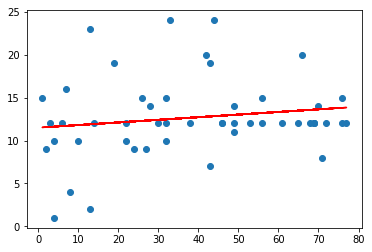

In [39]:
plt.scatter(X, Y)
plt.plot(X, Y_pred, color='red')
plt.show()